##### Copyright 2019 The TensorFlow Authors.

In [1]:
#@title Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
# https://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

# CycleGAN

<table class="tfo-notebook-buttons" align="left">
  <td>
    <a target="_blank" href="https://www.tensorflow.org/tutorials/generative/cyclegan"><img src="https://www.tensorflow.org/images/tf_logo_32px.png" />View on TensorFlow.org</a>
  </td>
  <td>
    <a target="_blank" href="https://colab.research.google.com/github/tensorflow/docs/blob/master/site/en/tutorials/generative/cyclegan.ipynb"><img src="https://www.tensorflow.org/images/colab_logo_32px.png" />Run in Google Colab</a>
  </td>
  <td>
    <a target="_blank" href="https://github.com/tensorflow/docs/blob/master/site/en/tutorials/generative/cyclegan.ipynb"><img src="https://www.tensorflow.org/images/GitHub-Mark-32px.png" />View source on GitHub</a>
  </td>
  <td>
    <a href="https://storage.googleapis.com/tensorflow_docs/docs/site/en/tutorials/generative/cyclegan.ipynb"><img src="https://www.tensorflow.org/images/download_logo_32px.png" />Download notebook</a>
  </td>
</table>

This notebook demonstrates unpaired image to image translation using conditional GAN's, as described in [Unpaired Image-to-Image Translation using Cycle-Consistent Adversarial Networks](https://arxiv.org/abs/1703.10593), also known as CycleGAN. The paper proposes a method that can capture the characteristics of one image domain and figure out how these characteristics could be translated into another image domain, all in the absence of any paired training examples. 

This notebook assumes you are familiar with Pix2Pix, which you can learn about in the [Pix2Pix tutorial](https://www.tensorflow.org/tutorials/generative/pix2pix). The code for CycleGAN is similar, the main difference is an additional loss function, and the use of unpaired training data.

CycleGAN uses a cycle consistency loss to enable training without the need for paired data. In other words, it can translate from one domain to another without a one-to-one mapping between the source and target domain. 

This opens up the possibility to do a lot of interesting tasks like photo-enhancement, image colorization, style transfer, etc. All you need is the source and the target dataset (which is simply a directory of images).

![Output Image 1](images/horse2zebra_1.png)
![Output Image 2](images/horse2zebra_2.png)

## Set up the input pipeline

Install the [tensorflow_examples](https://github.com/tensorflow/examples) package that enables importing of the generator and the discriminator.

In [1]:
!pip install -q git+https://github.com/tensorflow/examples.git

In [1]:
try:
  # %tensorflow_version only exists in Colab.
  %tensorflow_version 2.x
except Exception:
  pass
import tensorflow as tf
print(tf.__version__)


2.1.0-dev20191106


In [2]:
from __future__ import absolute_import, division, print_function, unicode_literals

import tensorflow_datasets as tfds
from tensorflow_examples.models.pix2pix import pix2pix

import os
import time
import matplotlib.pyplot as plt
from IPython.display import clear_output

tfds.disable_progress_bar()
AUTOTUNE = tf.data.experimental.AUTOTUNE

## Input Pipeline

This tutorial trains a model to translate from images of horses, to images of zebras. You can find this dataset and similar ones [here](https://www.tensorflow.org/datasets/datasets#cycle_gan). 

As mentioned in the [paper](https://arxiv.org/abs/1703.10593), apply random jittering and mirroring to the training dataset. These are some of the image augmentation techniques that avoids overfitting.

This is similar to what was done in [pix2pix](https://www.tensorflow.org/tutorials/generative/pix2pix#load_the_dataset)

* In random jittering, the image is resized to `286 x 286` and then randomly cropped to `256 x 256`.
* In random mirroring, the image is randomly flipped horizontally i.e left to right.

In [16]:
!ls -l 
#!mv /data/*.zip /data/road-scanner/networks/.data/

total 111864
drwxr-xr-x  2 root root     4096 Oct 21 01:17 __pycache__
-rw-r--r--  1 root root  1398561 Nov 13 03:41 attention.ipynb
-rw-r--r--  1 root root 27757394 Nov 27 21:43 cyclegan-daylight.ipynb
-rw-r--r--  1 root root 21135710 Nov 12 15:02 cyclegan.ipynb
-rw-r--r--  1 root root     2901 Oct 14 00:54 data_preparation.py
-rw-r--r--  1 root root 39837676 Nov 15 04:23 google_pix2pix.ipynb
-rw-r--r--  1 root root     4637 Oct 13 21:46 gradient_accumulation.py
drwxr-xr-x  3 root root     4096 Nov 27 21:40 nexet
-rw-r--r--  1 root root   781066 Oct 13 09:33 nexet_diffs.csv
-rw-r--r--  1 root root      756 Oct 14 02:08 params.py
-rw-r--r--  1 root root    14967 Nov 12 00:09 pix2pix.ipynb
drwxr-xr-x 12 root root     4096 Nov 12 00:00 pytorch-CycleGAN-and-pix2pix
-rw-r--r--  1 root root      775 Oct 13 21:46 reset.py
-rw-r--r--  1 root root  4461032 Oct 13 09:33 train.csv
-rw-r--r--  1 root root    13555 Oct 14 04:09 train.py
-rw-r--r--  1 root root 19086786 Oct 13 09:33 train_boxes.csv

In [15]:
!unzip "/data/road-scanner/networks/.data/nexet-original.zip"

Archive:  /data/road-scanner/networks/.data/nexet-original.zip
  inflating: nexet/nexet/desktop.ini  
  inflating: nexet/nexet/nexet_2017_1/._frame_1f4b4f109ee03ba8d52fa9a9d9caad37_64dda657a4c6eaa14c534dd17d3e29f5_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/000196c0-1985-457f-bcd2-e4df621de5fe.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/0012c298-4ec3-4604-a8f5-b828f1775ce6.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/00146c1b-7af9-4864-9066-9b32913a1c3f.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/001b630b-1e07-447a-9706-6c0f7aa3c811.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/0051904c-fc97-43ff-b9c9-14c009c1f6fa.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/005ff28d-8a8e-424a-9d1d-a297a87a5957.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/007108b5-a50b-4f88-aae1-c7397a6d2206.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/007c1782-671f-47e3-9cf1-98e4fb001367.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/00a7cf88-3b

  inflating: nexet/nexet/nexet_2017_1/0577056f-52ee-47d4-8c54-c8f00fad9ab6.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/057ea606-b68e-4a48-8169-41ae04df308f.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/05958a8a-df44-487d-b94c-d4b3cde07323.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/05ad65fb-7956-40b1-aa39-992822f2c6ce.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/05c2fb1b-cf57-44fd-af21-0ef3580f7b4b.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/05c929a2-2441-4bec-a290-703000d01c98.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/05dd07b3-8ce8-497e-90ee-f9028f709cc4.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/05dd91a8-fb38-49cd-acb5-c49120773719.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/05dec99b-152e-47b6-a5a8-105276a72f7e.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/06008e81-c3c5-4e48-b8e1-019a7e0be0b8.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/06059791-3474-43aa-9de5-d660dbe609d0.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/0a5ac9f0-338e-496c-9e64-409e862a18ab.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/0a61777a-36a8-4a74-bb4a-c37127e1a641.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/0a652e93-621a-4286-bfb7-4c4af659a248.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/0a69140e-43d9-488b-b8eb-240819ca3b02.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/0a714d31-5c23-4c1f-b71f-b6acaccce2b8.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/0a78121a-478c-4f65-89ef-58385185664a.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/0a84c0b1-ab31-4446-973c-cfecff366e7d.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/0a892753-cdef-4ccb-b99f-85312826ac04.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/0a901219-4d8f-49f0-83ea-30ed2e5f6a3d.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/0a946e9e-26d1-433f-b92b-252eed5e7455.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/0a9f5d21-d671-4c1d-9cbd-4b3f348e32f1.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/108f223a-d8e1-4747-b85c-bf793cc522d9.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/109a3274-3530-49ba-83ba-c0dcd6ec421d.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/10b0e5aa-daa4-4640-8392-e3cbf40d0807.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/10b520da-4371-42bb-8a21-e11e9ced9087.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/10b8ad97-ce57-486f-94a9-e41ea7a9d148.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/10bd8fb4-8cfd-45fd-bc40-4fb611898390.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/10ddc2ad-9021-4a47-b913-c74fb9babef0.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/110dfe4b-d7bf-4c2a-b5a2-82a4d8c18dd7.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/110eb33b-5a1b-4077-8e73-0c848b88b00e.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/1112996c-0bf8-49af-b768-d39b46f96085.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/11361be8-c790-4be0-a819-2daa4ad5e41d.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/16ce4382-0e89-4c69-9428-379c94fddc6d.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/1707c297-d359-41c2-9c80-0d7570a39ece.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/170dc4a3-7ec0-4ddc-aff7-360747c8be7d.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/1734a71f-46a8-426d-b3be-64f705c8b2cb.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/173e3772-ad97-4ee9-afe7-902373b63e02.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/1781a4db-c12f-47dd-8c28-4ddc0af43852.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/178bc179-7900-4636-b681-20eee1e996d6.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/178bfaa3-918d-4b08-a13a-9c46c912a041.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/1798a06b-6e71-4df0-b4ae-598ae8f897a7.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/1798c3d0-6066-414f-b277-95583ce5f2df.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/1798ce09-d5aa-4cf9-8eb2-344067968f32.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/1c725a7b-7c1e-4029-bb35-3f485c0c580d.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/1c78e29a-10a5-4e45-adcf-b8b5338c7674.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/1c833fc0-a041-4e40-a9f9-aa92cfdc6bd2.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/1c8c4406-95d5-4dd6-8cd7-8e7b3792204d.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/1c95bdf7-b1a1-4983-aed5-6b1e19d30f5b.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/1ca26dc7-0f48-43b5-97e9-86424b2df515.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/1cad7350-ed7e-49bc-852d-13813bd722d2.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/1cd14c73-8134-489d-85c3-3dcc9a6e0adf.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/1cdd7d19-ce43-461d-ba75-f263c368093f.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/1cdd8673-5988-4a0d-ba84-4c2f1ebe2490.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/1cf4a26d-4eaa-434a-b299-23ad399b512b.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/21b69e47-7bbd-4c1f-af47-e4fbbb357a90.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/21be371d-f522-41e3-970c-d86d1d3a90be.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/21c1df70-5e48-484f-a99c-aaab43bc731a.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/21c877e6-2f5a-49da-a639-d2b8a5033064.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/21cf5e1a-a400-4d7a-b441-ef3cdc91ad3c.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/21d126b6-6dbd-4371-889f-9f2815e9ecc5.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/21db5b60-7ae7-43b2-8ca7-f6712558147f.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/21deb3ef-ee7c-4e41-8730-b161a5146520.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/21deeb7c-61c8-4b32-8eea-cd8068394da2.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/21e7a553-5eef-471d-8a97-22ac1fc6d875.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/21f4ed4a-39d9-4251-a0dc-ed47941466c2.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/25eabeea-8d71-4e8d-95cb-a0545ce1c1da.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/25ebe473-470c-47f7-980f-c1158a80e1f2.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/25f1b268-562c-4f83-9c99-76d3807d4923.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/2601fefb-e7fe-41aa-986b-4f3f594fa84c.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/260543ee-73c7-4933-b5de-d815fde4e1a7.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/2605c03e-562c-45f4-ab27-d39bbb18d61b.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/26154992-6541-41de-ac42-e2cc0bbba4b5.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/261a2286-f18f-438f-9b55-5bbd98aeba76.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/2625eac6-88ba-42d8-896c-fe0b9f2ee5d8.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/2642f9c9-7ace-4ce4-b662-087c77cf304a.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/264426df-b544-4d74-9b57-1d8d90504d29.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/2b5751ef-c7db-406b-a331-a972776e55a5.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/2b58eea6-6100-4138-b14e-b61528d258ae.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/2b689fe2-e503-459c-8725-2e5652f284b1.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/2b878b56-711a-4a94-89eb-a85d628a57d2.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/2b9ef45f-71b5-4943-b6b9-ff7c78e74c67.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/2bac7773-7ffe-496c-befe-dd2d83732243.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/2bb05a8c-0b2e-4102-b5ec-89fce94a3d46.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/2bc284c5-011d-481b-a388-ad0bd90e3072.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/2be64d0e-e5bf-4787-a977-6442add3ae25.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/2be72f69-5c51-4dae-a417-34f15f9c1656.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/2bffbf48-54dc-48a7-a335-8ec7ac14a7a2.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/307908c8-e086-4afb-9c1a-c6daf1be10f1.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/30896039-0372-4343-ba1c-1fdb82c3031c.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/30949546-e295-44ee-ba08-96bba87be3d6.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/30a7e426-d66d-49c6-bbc7-a6811a44139e.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/30b2142a-0bf6-4745-819a-06dfb7a89099.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/30b3beaf-bde3-42a0-9882-da330e9846c2.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/30c45cde-bf7e-4e59-bfea-a02dd9ab5003.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/30d745c2-3d1b-4b5b-a9cf-15d346d1d496.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/30e3986a-190c-40ba-8d06-4f62e41c9a18.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/30ee7685-d32a-4272-8fc2-35f026133366.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/30f91436-c7bd-46b7-b3d2-6a1f33e36394.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/3648448a-7cd3-4d7e-85cd-2f1ce6f37bab.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/364c8cbb-2ff5-400a-a8ed-5e6570978f3d.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/365cc176-0697-43da-af6f-8ed932635dbc.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/3664388b-2dcf-4565-84f1-166c08b33632.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/36649721-8c6e-4237-9691-2454964cf723.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/36814a5d-ff08-491d-9a9e-47a6113e5419.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/368358bc-886d-4029-a723-70899c2b78ff.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/369f876b-6bc1-4f7f-8137-1ce84ed7f492.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/36ab9714-af4e-47bc-8238-9797eab6d256.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/36b8af09-6fcd-458e-892c-cd076c82f894.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/36e37a88-95a5-457d-9ef6-cb622d32b8e9.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/3bffc322-293f-4780-a3a4-32f4c1113feb.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/3c0f62ce-7759-4aef-9e41-0fd8ed8da66d.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/3c1210b8-6e9e-4fc5-a85a-94d6a87f672b.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/3c1e38cb-08c7-4fa6-8e8c-25a21cf1cafa.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/3c1fa509-5c42-4a5b-927b-74b61938d1d4.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/3c302c30-1fcd-4850-8b07-9a5ff1d35424.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/3c3c4ba7-3e2d-4a54-9502-fba1fbf2c34d.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/3c3fa82c-30a0-486a-95ec-af418d947d9f.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/3c4bf095-1c78-421b-8f9e-4c9a285e78e5.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/3c4da58e-4318-47cc-a92f-843c82cf50f6.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/3c6754cb-f959-493e-97c1-46fee405e283.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/40e9b77e-9b31-4fe6-8dbc-84b8bae925b1.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/40ef3576-d73d-46af-880e-05ff94a566fe.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/40f9f0d6-e6d9-4621-b75b-779b44756398.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/40ff4896-8e8c-4f0a-bd38-2cb38f958eea.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/41060dad-78a2-4f02-a168-e68fbaacff66.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/4108bec7-3b6d-49b9-8390-b303c1748d4e.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/410de856-7e5e-432f-b302-2e1692318a26.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/4111b11f-2f5d-46e1-940e-c7adbaf1bb1d.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/411599b9-f21d-4b9b-ad39-14e08ceac052.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/411bc939-9c2e-4977-945c-221768bab878.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/41722544-ef4a-44be-94a4-d552ccdddf83.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/465a0fc0-3bd7-4143-a94f-ac2ab923d22b.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/465a7dff-4534-48d9-b0e2-8a157b4003ce.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/468412e2-9450-4219-a272-9adcfc8f7037.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/4691008c-f6a6-4865-ad9b-6ae29ebb36d8.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/469af65e-fba2-4a4f-9d9a-acbc83f05858.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/46a13202-544e-4e15-9b10-c48940f58ea5.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/46be21f3-2ddb-499a-b20e-6c5ee8ca2795.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/46e4c510-4288-4b26-9337-613f6ec72c23.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/46e74357-e691-43f1-bf5f-331d441c61bd.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/46ef7b80-87a2-43e7-928b-54afe29a2932.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/4702c35c-3686-4fe6-895b-300d10880ab5.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/4c23038e-1ad8-4545-8266-17fe36d9e0fc.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/4c271639-1517-4d86-abbd-e80e8cf0aa62.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/4c2df2c9-ce33-4404-a35a-b83e4bf131bc.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/4c3466a5-9975-4924-9add-2d32ff10fa7b.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/4c3d39ad-46a3-45ad-9a06-a55736c399ab.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/4c57f6d8-fb90-4bf6-b731-520b858bbf4a.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/4c5eac17-9977-4325-baba-314f44bb9e63.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/4c6091e3-2885-42e2-8c31-9ef46e13979e.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/4c699073-7439-43b0-a5f5-b30d21cda7b8.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/4c69d644-419d-4903-b0f7-a71b20f1a7d1.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/4c6d44e6-4052-4d93-a95b-7bb5b0097aae.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/51bd8420-26a2-475b-821f-a162205ee817.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/51be426a-f75a-4a16-8aba-eefeb1bfd6ea.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/51c92d22-3696-4151-812f-29cf8da70b48.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/51cdfaff-68b8-41d7-b484-0bd84f9e2e7b.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/51ddcae5-da7f-4c74-9f7c-90c16df0efbd.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/51e173b1-2ec3-4222-9768-8bd27c735736.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/51e83ddf-f87d-4d15-8d66-880f0b5fb1cd.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/51fe2820-88f0-4b29-b990-e967aee98cfc.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/521c5ccb-b766-4820-8555-5ff7f512cf6d.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/5240bbb6-7a4a-4082-b738-de7c80d47efd.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/525584d1-1ff1-459a-8d12-3c90558f4e2b.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/581d2869-46e0-4b52-a3a0-b2817d3c6c9a.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/582126c8-6ec7-4132-9eed-1ef8b0e181cf.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/582a6f9f-90c2-45c7-a7f1-435623cb1225.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/5842ee17-0e02-4ff4-926e-101effe9e65b.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/58579373-f085-45ff-983f-172483fa7114.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/5860fc03-df4f-4034-913f-b10ef37b9ae8.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/58618c62-2dd5-48ee-a1e9-8ccd4dc11d63.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/587991c7-a4b6-49d9-9487-b2981a594f40.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/58825f1f-2735-48e5-bc85-f6b224dedf77.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/5889ccea-6af2-4171-8f8f-a984aa905cd9.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/588cda0f-5ea4-4419-a08b-c47455031242.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/5d6fc333-3ef6-4e6c-b8c5-308eeb25dcfe.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/5d8941e1-2ba9-4440-9936-35ec158051b5.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/5d913dff-f8e4-4999-845b-f4510f31dc66.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/5db0f277-d0e9-4a26-9818-799bd84c7c06.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/5db183e0-1dfd-4f55-a253-350f3793bb12.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/5db70079-63cd-4c1f-9e93-687a3b789925.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/5dbd807d-943a-432f-869d-92376110ec0f.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/5dc2bba9-a1a6-40c3-b901-e2b3aeff38e9.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/5dcbf0f1-c3b0-4e47-9041-a2c91668874e.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/5dcd2875-0da8-45f8-ae91-2fe0fa8ba5d0.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/5dd6f92a-d438-44cd-a02a-49c651d0e933.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/629f784b-2142-4340-baaf-ff6ca3304228.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/62a642f3-3efd-4f31-a865-8dcceab21239.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/62af2250-9ebe-45cf-adc5-388daa7f1b6e.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/62cfd397-0eee-4083-a006-b9e09f7a3b37.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/62ee208c-2bbd-4f4a-b32e-da9bd964f125.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/62f0f50f-2e91-4718-a561-8debcc2aef4b.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/63023e0a-604b-4ddf-aca8-8713da519a7b.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/6305a812-cce4-45e8-be13-1012438e6b0e.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/6307803a-f110-4038-b4bc-36f6b1d2f6df.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/6313ed31-46ec-457b-82a4-62204d82a4d0.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/6321304e-ea9f-4eca-bdff-4836710c1d69.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/687c15bd-6c7e-43b5-b64b-8ce6077577e2.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/689c98fc-a66b-4b27-9daf-3a7d7347b867.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/689fa23f-7228-4708-bd93-b32eb1199260.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/68a27e11-ec8a-4a1a-afeb-85f8ae388b30.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/68a98c34-57fa-42ee-97b9-43422662c674.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/68bf5ac7-597d-470b-8937-4989403cacef.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/68c72177-248f-4273-aa74-adc5b1012e41.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/68dc8ded-bd4b-479f-88f4-ce88d7ae021d.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/68ee24e7-dd43-4403-9ebf-0455e3e2f01c.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/68f4e949-72c9-4591-b96e-46eb2393a9c4.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/68f5ffa2-ea68-476c-8a70-1c7909028200.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/6e8cc175-abf6-47cb-b3a0-bcec93915c37.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/6ea8c1f2-abe0-423f-b89a-867f87c012c7.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/6eab900b-e479-4f07-8c32-bf1c1d7e1a8e.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/6eb4cfe5-9272-404a-be7c-8bcd046849b3.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/6eb6a83b-47a3-47a0-b8b7-940cd8340cda.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/6ecb2f92-86e1-4d17-9ff7-27933462e68c.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/6ecc9a64-8537-4d81-b5f6-ce52611f4ec2.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/6edcc145-8018-46d3-819e-3c1c852734f1.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/6f0345da-fbaa-4f7d-b7e0-28e39d727e3a.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/6f0e72bf-dad7-4fa7-ad2d-3f92eb81a25e.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/6f129728-6bf5-499c-9dab-8a3d8a8dcf04.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/73cf1c8c-2d62-42df-acd9-4641b7f4befb.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/73e53889-ea1c-4bcc-b008-194b4a799664.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/73eda613-ab4f-436d-9d98-e4c1d5d3cadd.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/741e527b-3451-4bc9-a401-98e33c43e1d7.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/7429dd40-01ba-41e6-8afe-ed50b2e6a080.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/743aa865-dc81-4e4e-8470-8256052b8cda.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/7447277c-185c-4f93-9161-3c435de6100b.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/744869e2-ab61-4fb0-8020-0d5365be415f.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/744d06d7-52a9-408b-bb78-0e4e8e14a8f7.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/746486f4-c07c-4d74-8ec4-17b55e2b67d5.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/746d6981-d7c6-42bb-a047-65defa993d37.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/7925fd31-c10f-4486-91f8-1931837f3df6.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/793e3895-7b2e-4c51-9403-85c2d590a405.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/7949bc1f-b052-498e-b4b7-9d0d0bc75c3b.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/794c84df-badd-4995-b714-ef9c5741f9e3.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/7958d503-260d-4336-9ab4-a7393fd70573.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/79651eb9-6d54-4ee0-b73b-abce8fc6bf58.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/7969fb02-7edb-4e19-a918-8ad39469ad3a.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/7976edf1-c264-4790-8b20-1aa26b4cf2ee.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/797e11d1-0707-499f-8f54-70ad5ebe8149.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/79874a85-aba8-4231-9252-6d10573bfed5.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/798e0356-f6ff-4ab1-a685-5e9dfca7a4ff.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/7e886597-150f-4dd1-99cb-2e619c21c1a4.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/7e8b1f30-95cf-41c5-8560-238c7474fd63.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/7e93431d-ac1a-47c1-95fd-10d5ded7a33c.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/7e93c389-2a5b-418c-bc3b-6e6f9177e9af.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/7e9680b0-2059-4972-a8e2-9388ef6b09cd.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/7e96e2bb-5662-432a-ab3f-d9beacd34e46.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/7eb871f7-53af-4e3e-b335-d8d91665441e.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/7ec8c200-d65f-4d52-9191-9bbf5da8221a.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/7ee0ea91-4093-40d9-9b66-6ce4c562aba1.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/7ee3a93b-7758-407a-bc33-2a7a158bbd4d.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/7ef71b3b-cc60-42ec-acad-4b9936602b7e.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/83f5144f-de62-4033-bc8c-be828085e8a1.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/8405bb0f-6007-46da-9d46-ac950d421454.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/84100bac-1960-4543-93d1-84ede11632fa.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/841b3349-d6fd-46dd-9f8d-79e2fac00295.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/844d4dde-f99d-48e5-a350-f8eddad924fe.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/84621115-4ded-4b31-b917-100dd0ee49f0.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/846ed16e-4b79-4d3d-8d73-f2d1cfbddce6.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/8474dd1a-792a-4ed5-9d20-d62f864ccf23.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/847663b7-3c59-4269-969d-77b2612c77d7.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/847cae4e-03c2-4145-8330-698339b5ea7b.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/84a899f9-e9c3-40a6-8e60-43ab2be7ea37.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/8a21f7d3-4044-42f2-874d-57759c1344b3.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/8a256953-cd54-4758-985b-af7d9a65cf2f.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/8a3dfd42-ef28-4339-bf92-b9b31e0e3a2e.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/8a643ef6-45fa-46bf-8a2b-9026dae120f8.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/8a68e16c-3367-4d47-85e2-a5879abbea20.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/8a9f5e27-a897-48b7-8020-e179c43e14c3.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/8aa10ce8-48b1-4798-b0df-1b0b10829b05.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/8aa8297b-d5b0-4a67-9f6d-8bc7ef6f097d.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/8aa84abd-8fb2-4190-b599-96f997781b09.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/8aaea0db-24c2-4e6b-8d7c-b2a52aa196a4.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/8aafce5b-0233-448f-8be7-bdeedd6c2d11.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/8fd52997-4d3a-4450-8036-49e0ccc6afbf.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/8fdf856a-2285-4b78-8c45-a2cfaf631e38.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/8fee03bf-c5a0-4146-b8e4-bfd2cefab02c.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/8ffbd655-2719-4df2-9ab2-6eb34b931b7d.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/8fffb1ea-7c68-4ed0-9cfb-f3ba9f03c773.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/9007bbc0-9f50-43c5-b420-2b989ed98d26.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/9017edfa-5700-4ddd-b8dd-cd5f64e70005.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/903caf6b-e420-4918-8ceb-b57896a113fe.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/905767d7-9b60-4e05-9a0f-8d0e190ca9c8.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/9059b137-fba9-4363-8610-d8c28f41fdf1.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/905c2103-45a6-4e85-b3e9-18eb7fab4698.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/95421824-7e1b-49e1-a553-978e14a02fa5.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/956765eb-4b2d-48c6-98b7-82798f7c7a80.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/956d1493-cd0c-45b1-ab0f-84760c334980.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/956d8c01-aa07-4845-aef5-2253d4f92f96.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/957441bf-1b16-4b16-b09b-6616a4895e72.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/95978041-9713-4c11-86d9-4e777bf0b7bb.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/95b5a00f-d85d-4077-bf99-5cb749a475d7.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/95b66bc2-0da2-4732-8b18-b0528c29d148.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/95c5bf57-136e-461a-a654-db4438b4b5ec.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/95dc8d99-f47e-4e02-acc4-ceebffc5261f.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/95dcdffd-46bf-4c00-9f81-77a267520226.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/9ae678d5-7445-44c5-857a-c904b59c8850.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/9af38375-b63f-48e5-bc01-248e60a2d683.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/9b005b54-df51-451f-af79-5d3ec52355a1.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/9b066f80-b5ce-49d1-930b-3485ba0c46c0.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/9b0df23d-a742-4a25-8554-1a65a3a9e197.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/9b0f94ce-f5c5-4265-84dc-80fec5c34a48.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/9b1418d6-affd-41cd-8649-50c587b3343a.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/9b1b41e1-2869-4c2d-8ba4-f0e7c76b15e1.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/9b245461-3a14-4184-a3f6-47a142784a43.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/9b2f27b2-ca96-4589-9d8f-eb917cecf711.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/9b39e2fc-3aa8-401a-9266-ba8f6e6f2c00.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/a0ec27b2-f1e3-4c76-b405-d1d1008e86f6.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/a0f69eea-96e2-45e3-983c-be81a5fb0fe0.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/a0f84f3d-0903-4aac-9bd3-2b29a2ca21cb.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/a0fa6ef1-d6cb-47a1-b332-6aa322292aee.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/a0fda6b1-1bc8-49b6-865a-a4d70b66d58b.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/a1058ca4-bb7a-449c-9992-472aceb65fdb.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/a109208c-41dd-4557-9e61-46824ba210f6.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/a10d4b80-5678-463e-8a9e-b610dfdc1d3d.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/a11e09b8-db6b-4075-ac7a-92082540300c.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/a133584e-92f7-46b9-a4f4-3b194e4a1339.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/a143c4db-6c02-47a7-90ad-f6beaee25924.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/a62e866a-22a4-464e-adc5-c08ee8122043.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/a63284dd-722d-40cd-aa74-c87a9e26c062.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/a637649d-fe90-4122-8114-1919ee6a6eb2.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/a652af2b-cfbf-46c2-a9d4-26964a04ed55.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/a653659c-823d-4933-9bca-da8b0f0d1538.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/a65366e3-c062-448e-bcc0-be2c9182c5e1.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/a658f6ef-97cf-45da-bc4f-cc82ad6af25f.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/a65b7b45-40b1-4383-a9b2-93f7f28949b6.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/a6608c8f-4aee-49dd-9fe5-567a1e1602f9.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/a6691a34-6068-4ff2-9085-0e1fd1c83dd9.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/a67a722d-b971-48db-9267-f0b4f833284d.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/ab31b884-fcce-4361-bcec-a589ea49197d.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ab3238c7-df19-4bb0-84ef-3348c404efb8.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ab4715da-1436-4f40-8f4b-b3e592c64323.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ab55b2aa-de6c-4765-9450-1ef1bbb85d6e.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ab5db00a-9a21-4f58-9bad-38d5c6682a1e.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ab6f0098-212d-4518-a1bd-631640014413.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ab72e26f-6ffa-45b0-981e-e985981178ab.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ab762274-4d88-4c6a-ba0b-804d39f00121.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ab80cafd-8409-4df3-a7e1-776741f698c5.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ab8f6a56-f96c-498a-b68a-d86a7037193b.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ab90488e-fd31-4870-998f-9d66d439a9e4.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/b056ff64-f2c5-485d-865c-a9c49e5fc92c.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/b0648dde-e1b5-41f4-9b6c-33a7f0350b2d.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/b070085d-cea1-45a0-b186-87f15d08f2f5.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/b074bfef-eb78-4143-8c05-59f95ba2208d.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/b085745e-06fc-4639-bfc6-89d178f6d5ae.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/b09092ba-f2b4-48d4-908b-ba6ff09b86cc.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/b092936b-1a96-44dc-ad42-db0a6ff49526.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/b099fcb0-3484-41d8-98c3-9f44678a46ef.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/b09f5546-e038-4b59-8402-b32b8cc9a91f.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/b0bc1e1a-d363-4a0e-a145-dbb03f8709a9.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/b0bfbdec-4878-490b-8d0c-bdf08e24b9d0.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/b585a183-e7e2-42ec-963e-1624da1ec886.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/b58c81d6-75ab-487f-b59e-febdbb3420f0.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/b59f7508-2d8b-40a9-83dc-40a99e3c8fcb.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/b5c5ce47-f92f-4cf8-840b-3cac2c94faaf.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/b5e3ea6d-9fbe-492c-9e80-d7a8a6553d65.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/b5f4ebf1-f092-4d35-9dba-b802cb9c4d43.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/b60ac3cf-54c3-4289-8317-25fa927fa347.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/b60d48a5-b57d-4daf-b0aa-29b1d5499c46.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/b611bb3c-22ff-49a3-866c-82a7a2a23440.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/b629acfe-a993-4da6-b53d-1b359d240e2e.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/b62aa9cc-d50b-44b1-95fc-993f15d1fada.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/ba41e21b-d71e-4547-95ad-681ce314a07f.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ba45e101-25da-4012-9ff7-6594944ed056.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ba4a21b4-6227-4cab-9051-dfb047e9894d.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ba635e7b-2423-4b99-aa74-c2db97924d32.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ba70af76-4d37-4482-be83-c8b253ecc43b.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ba85ee82-5236-4fd8-8a53-1e894de9c263.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ba868949-5d10-4aa2-9844-837feba9387a.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ba916e19-496b-402e-b78d-9ef692ae4c02.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ba9db47d-7609-4633-8015-70a6161c7bc5.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/baa456f5-0701-497e-9670-0314d0bfa29c.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/bad4e730-7e0a-4080-8e3a-9b7ba4a8d79b.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/bf905c81-7881-43a6-bce3-a258fdba2920.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/bf9d43a4-758a-41c7-b868-cbf18bc607cb.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/bfa4fb80-9b85-436b-8e28-940ee9215e6f.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/bfac0f89-403b-4eeb-afbd-ee6a1220c7a0.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/bfb2dd3b-960e-4f7d-a90c-9ee4fd75dc6f.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/bfbfbca4-a30a-4b09-8377-8cd583eccd2a.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/bfc96146-fb56-4fb6-a659-75864591c777.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/bfd49450-68a6-417b-9576-37b75af694b4.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/bff432b2-ec75-4fab-9786-c3b2062cbac3.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/c0295bdd-05f3-4abc-a2c0-2abd17a67d3a.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/c03008f8-52ff-404f-97d4-b98271cae226.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/c4ee15bd-9aa9-4e64-b096-2a8984caec16.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/c4fd0200-0f4f-4849-bff2-7aab755464d0.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/c5019c2d-4dd0-4f4f-b4d5-2a9bf5a0e7f4.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/c517e144-b5a1-4907-abac-5e5089376484.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/c5222d6b-c82d-41dc-99b0-b26c032bf070.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/c53f8313-752a-4396-8d9b-5e7a6bb33059.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/c54384b7-fda0-4a90-8a9f-1a6296837bdb.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/c55b3907-02d8-4598-8c03-b754f3ac1239.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/c563bb36-3249-4dd2-b9d5-7f0ced183e1e.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/c590f199-2fb5-427a-a7e1-f07b7a0cf46b.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/c5a9cd0a-7d54-4dde-bfb5-81f42e83dd78.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/ca5d5da4-7eb0-4323-b099-b191ea966a1e.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ca70f53c-888c-44b0-b93d-68e1d6822643.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ca795c6d-d649-4fc2-8df7-6b36be32c503.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ca8450e5-f3b0-4334-9777-40fd44892366.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ca87fa90-ea23-4554-9624-9e0148987e07.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ca9d1b20-826a-467a-880b-4185b3fb12fb.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/caa9cd92-6c8e-46c9-b356-426c44239b7d.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/caaa816a-7493-4b36-bd64-de67b638b480.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/cab29013-4529-4071-a6f3-e609866dbad8.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/cab7b098-d3b9-4656-bfda-d21ba991b51d.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/cac61cbf-71e3-4c00-b7d5-c9fd656fefcb.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/d00c5b1e-2d4c-4ead-aa55-88d4ddc54942.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/d0410d0b-d81a-4aa7-a0a5-8c444cd85e52.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/d04ab29b-939f-437a-bb75-4778f4b547b6.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/d04b9bae-83b5-41bf-8b86-0bdaf0665b15.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/d04e3d06-7c71-4801-b282-738f7e619841.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/d0592b73-1af9-47ab-9b75-c8f6b1bafb6b.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/d0608838-6aa5-4ce9-9a59-67189377e128.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/d0613a81-ca6b-4395-a71a-9efb25d888f2.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/d069d36d-27d9-4d14-bf0b-7664f8c3d5b6.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/d077c723-710e-497d-9ab5-a78d07776f00.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/d085c3ba-7840-4a7b-875e-cd9acbf3cbd1.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/d6210936-beb6-43cc-b468-a941d782addd.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/d6253578-4cb6-408b-8c40-4ab7d37632bb.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/d666a377-d813-4b3b-9d8d-e52150a18677.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/d66dc13f-d5fe-4600-86b1-41ed76b53d41.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/d686917a-c860-43c4-8638-a5669c185e33.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/d68d3810-cceb-46cf-adc1-190c31267761.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/d68f0274-b765-4b74-8b3a-d6361c6ceceb.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/d691f8f9-209f-49c2-af7e-89a34850c250.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/d69a5c27-59b4-4deb-b400-9313e7052480.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/d6a41fcd-47d5-46b3-bf0c-37531fc64fda.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/d6c9d20d-c8bc-4ccd-b5aa-8ac7430f675b.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/dbd779cc-2a6c-4a80-8d7a-0278e5c5bf59.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/dbd93bda-64f4-4712-b4a6-5cfb55d29593.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/dbff7a88-2872-43d1-b588-d016d03202de.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/dc175fc7-df1c-416e-ab11-c16079ab7ab5.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/dc269796-46c8-470a-be4c-a3442b5eb8b9.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/dc3c5ad3-5953-42f7-b106-49f2db0b6686.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/dc3c9fdc-077c-4a64-9ad4-55ce72b65a44.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/dc4039ea-044e-4c86-a2bd-4612bbc40053.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/dc51512b-7e5f-48a1-9ea6-4687a54d1646.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/dc6c1141-9df2-4cd5-828e-8907af88ae59.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/dc6f2515-775c-4a8a-bf0a-00001fdb1de7.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/e0edd583-10af-43ea-9c24-c67430cc7d90.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/e0f116be-048b-43e2-9948-7a54b431e1ac.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/e0f13db4-42e7-4038-b789-b9f0186d8278.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/e0f70208-9d83-4cd0-ac15-c8940f861bbb.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/e11c8c70-e1cc-4ce0-aa6d-ab8c75e1e5bd.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/e124d096-9ff9-403f-9d8c-be98bfb15b73.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/e1336989-2a29-48ea-b895-a85748192c28.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/e16211a9-3000-4938-8cfa-bd735ea68c2e.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/e17447d5-77e5-4669-a7bf-5c6c8d3b41f3.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/e17cebbe-cfd8-4ec5-86a3-3a089b3ec7b9.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/e194d80e-9f1c-4b78-a810-ac273275ecbb.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/e67f745f-37fb-411c-b7c5-c653476dbf0e.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/e682dd16-9553-4b1d-a9ec-fc5900288e57.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/e6870fe0-0ffc-408b-8a23-d28907afb30e.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/e68e02bc-6c4e-403f-93f6-5fa90b6ecda4.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/e6918809-c6c3-47ea-a83e-4148dc749d8c.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/e69e6275-2c54-4c1b-a6f9-3e7df3d06798.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/e6a1e6a7-a3b7-42ae-95e8-9cff65421991.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/e6a4266b-c65d-4269-9925-6e23807bfae4.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/e6cb6210-94fd-413b-98bc-ad9d945a5788.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/e6cba595-e3c8-43dd-8bc2-2c50b19342f2.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/e6d1ffd0-0a81-43ba-a5d6-cd585ef84f56.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/ec5d0bc5-2dd2-4e00-9400-402d38a14d9f.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ec6713be-f799-4463-858f-52a612df5220.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ec6797cc-ce02-4548-9ad8-63b9c98c0195.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ec8ca365-ac3f-4421-a1de-fa5a44543522.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ec95409f-ad68-43ec-ad6f-83188084590a.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ec9cd986-4d9c-4812-9972-d1beb07f8f63.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ecaa1803-3686-43d4-83f5-5d0821199d3c.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ecb84c8d-4a40-4eb8-9acf-6bc249a1477d.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/eccf4b6e-815e-4e67-8d61-9ed02e999074.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/ecebcb5a-299b-4124-9790-3f13ada71bc2.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/eced0dff-6315-4dbe-9d26-90f889ec4a05.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/f2099f5c-2fdc-4366-b2be-7f2de5b24078.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/f21008a3-e116-4d4f-8e28-2bea5fbe268d.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/f223f3ba-e55b-4200-83db-47c0fd256968.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/f22c12ad-7e0f-402c-9688-b0dc933bd69e.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/f22e35ea-bd3d-41ed-851e-ea51e1a66694.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/f2319484-33a2-4c06-8d81-8ebd3cc9ddbb.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/f248cb46-d46f-4dc1-8508-5ebb8875e8c8.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/f2608b2a-7541-4bf9-9442-262fb36bd29e.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/f27aa85a-76a1-4160-8cc1-34b02bb39b7e.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/f282d9cd-9848-455e-89b1-3dfa287281dc.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/f2830205-e551-4523-b53a-216f4052fb10.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/f80b62bf-8b88-468d-b3b4-780a4c371579.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/f82c6288-39d6-4095-8301-0dd6511deeb7.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/f83ed129-7756-4425-a5b5-3d74e8c59652.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/f854541b-bcaf-43cd-afb1-4e56830018f7.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/f855e977-8b82-42f4-b4e5-4eafde6b0c94.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/f857d970-c394-4666-8d42-c326f177b1ee.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/f859ffab-0cc4-472c-ba17-b1272f75c86d.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/f884b9b9-bb84-4a5d-9a27-12783bff02ec.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/f89bfe9b-1c23-4e1a-9878-2117430c154b.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/f8cb6373-e8a5-4c84-9107-88a1100816cc.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/f8d98e5f-1e9f-4aac-8a07-fedb1429bed5.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/fd5b3308-3013-46aa-b820-aa14ffe787a6.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/fd84898f-6945-4fe8-bf5b-ec11103c28a9.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/fd88eafc-29af-4aba-bc16-08a8ba545034.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/fd8b5699-b9ac-4e56-bbac-7c3c3b4bdcf2.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/fd8b5d7f-3100-45b8-acfe-4fbf2e7dbaad.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/fda2c625-c6b4-4517-9110-2724782fa790.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/fdb8e1a5-8897-469f-bdf0-2e30fc9cce7b.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/fdbd3639-ba0b-4816-9b44-7062736f7c9a.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/fdcf4961-5a60-455a-a012-78bc5c8de81c.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/fdd4b592-49f8-4a07-8039-c208f5ae56f1.mov-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/fe0d42d3-637f-4e14-bd66-92f30f346729.mov-0001.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/frame_001fac22939046c5cb149d45da4de881_3ab1bac372f5f6a44ccb28ac92f05e5e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_001fac22939046c5cb149d45da4de881_3eed76b9c22af918d443190f6c4fefde_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_001fac22939046c5cb149d45da4de881_682f1709147e167fe6325ebdb319dd27_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_001fac22939046c5cb149d45da4de881_7a0d135c12f4122eb096acbed2702f30_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_001fac22939046c5cb149d45da4de881_90ed97d5d3ed8e412dbbca227873ed2c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_001fac22939046c5cb149d45da4de881_90ed97d5d3ed8e412dbbca227873ed2c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_001fac22939046c5cb149d45da4de881_98c3f4f92d9f80857ec6bcff948deab9_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_001fac22939046c5cb149d45da4de881_a0208d17c5

  inflating: nexet/nexet/nexet_2017_1/frame_0090a3613b7d61f11bf126322930e23b_7b5b774277f97a24a907a8515f19c66d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0090a3613b7d61f11bf126322930e23b_9718ec0244a39e822dd7b4f653940f4d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0090a3613b7d61f11bf126322930e23b_d41bed7a4fe68f3b66609890b8072878_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0096c968-76b3-4cae-b11c-f1109a18139a_00008-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_009ce1b9a78bc784d67e2422550978cb_479a582d4ba01245543eea908a351305_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_009ce1b9a78bc784d67e2422550978cb_9be07941ed2b4c3b81a4889252be8c8c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_009ce1b9a78bc784d67e2422550978cb_a2c473239da3f58c96114761db93a043_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_009ce1b9a78bc784d67e2422550978cb_a2c473239da3f58c96114761db93a043_90000-1280_720.jpg

  inflating: nexet/nexet/nexet_2017_1/frame_01354666-5216-4ab5-9569-80b1c1ce9f39_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_013759e3-cefa-4935-ac4c-a16a8d0082c9_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_013c9298-9333-4ebc-9944-1754f641632c_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_013d454d-e4b1-46a3-b627-564f128529bf_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_013f681f-e8d6-4ffd-92ef-8ce9a8bbeea6_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_01423c6f-5ebc-4ca6-96eb-d3d496ba9bf1_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_014e4af6da6cb222348b98418d7989ee_2b9d2fa423a91e98f6ab628140a52b71_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_014e4af6da6cb222348b98418d7989ee_4a862da64bde63572c29dc692ce24e11_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_014e4af6da6cb222348b98418d7989ee_fe3522502fea346f8bebddadebdd6331_30000-1280_720.j

  inflating: nexet/nexet/nexet_2017_1/frame_01c1d202e3346cf66e90a530a3b472a0_997b1b04c5610d417532ff553e40220a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_01c1d202e3346cf66e90a530a3b472a0_9c551853c5f656fb4def93123dc54868_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_01c1d202e3346cf66e90a530a3b472a0_adaf52cfd9ad7bbc7f49bec7988963ad_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_01c1d202e3346cf66e90a530a3b472a0_b62afc5b09ab5344ec22fd8d87c73a98_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_01c1d202e3346cf66e90a530a3b472a0_ccc635dafda83d5a469fc0475a0a2fe8_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_01c1d202e3346cf66e90a530a3b472a0_d2a77cc6b830ae2b1933029fcd7490dd_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_01c1d202e3346cf66e90a530a3b472a0_d31163b1c6776d5d0d735005f60222aa_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_01c1d202e3346cf66e90a530a3b472a0_db84b714f9

  inflating: nexet/nexet/nexet_2017_1/frame_0208a3cf3499b79375411f814bbb5d36_a9105c398d09faeb3e802334e2163f3a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0208a3cf3499b79375411f814bbb5d36_aa09d3dcef6ed421dee92b79d1af14cb_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0208a3cf3499b79375411f814bbb5d36_d704a9721dca52006f9d7d5db6a84d68_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0208a3cf3499b79375411f814bbb5d36_dfe9e64d0c5c5390545bf97d302afb1f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0208a3cf3499b79375411f814bbb5d36_e6574f7297da7c1001cb27e1df051169_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_020cdbd4-2ac7-4b35-b19c-896e3df073ac_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_020cdbd4-2ac7-4b35-b19c-896e3df073ac_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_020cdbd4-2ac7-4b35-b19c-896e3df073ac_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_0241d733492cb3fa6067b1389b30a693_4690464d973971ab46f297ba6e213975_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0241d733492cb3fa6067b1389b30a693_4964abbf3b4761e437d88e98fad8d26c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_02463a2186d7882a69a55c0c4ef8c737_3aa3a2c32cb3293ddc523660f24654bb_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_02463a2186d7882a69a55c0c4ef8c737_87ea228ea15325690681fa4857b30059_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_02463a2186d7882a69a55c0c4ef8c737_d39c7988a1b976ddcb9d5009da011d00_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_02463a2186d7882a69a55c0c4ef8c737_d63dad35a3582ad6a659a6cc9d57652e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_02463a2186d7882a69a55c0c4ef8c737_ed5ab6b3ddc8f429380a96816100adb8_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_024eeb4a-1354-4d7d-8471-e6f57433d57a_00002-

  inflating: nexet/nexet/nexet_2017_1/frame_02bd9dbed089fe88420beccdc70b5219_14ce6c93c4451b038927c295222d598a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_02bd9dbed089fe88420beccdc70b5219_2214e58c7aae383f5747a03b99ff29cd_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_02bd9dbed089fe88420beccdc70b5219_2669b29b7aaac71645b5eb8eb898ce2c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_02bd9dbed089fe88420beccdc70b5219_3b4723f757ea9627c10d4db170aa0c4c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_02bd9dbed089fe88420beccdc70b5219_9be60d662a61f0c4b9378e62cc9da881_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_02bd9dbed089fe88420beccdc70b5219_aa298bc1759fc0b61baedea5d46dc216_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_02bd9dbed089fe88420beccdc70b5219_b0eec7d210c29cbd13569004d65be2c5_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_02bd9dbed089fe88420beccdc70b5219_b402d1dcadf73c

  inflating: nexet/nexet/nexet_2017_1/frame_03107471ea03d8eb6b7cbee0a2000939_3cda9a4b00951b865737a5b6efe09d95_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_03107471ea03d8eb6b7cbee0a2000939_4bd0860511f476a1a078d342205b885f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_03107471ea03d8eb6b7cbee0a2000939_8fd2ed3a401115f0e5dc2aa5b43da91d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_03107471ea03d8eb6b7cbee0a2000939_ad8ef9da4a82073d7cf7e2ff2c83153c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_03120e42-a05a-44e3-8760-573096e75c1d_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0312850f-74b1-4b83-a650-b9768d025d92_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_031c2d95-071b-4e03-aa3e-f662ce6206ad_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0322241a67ec54c43b3ce29a493397c1_2ca6b7f2f48fbd5bd139331482c9b53c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_035c4d0e4a8fa8f5a4219b02a349a69d_b5c3b34a38eb0a3c976ac25aacec08a2_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_035c4d0e4a8fa8f5a4219b02a349a69d_bfa63b1a43fdaa86e0d1e475172c1041_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_035c4d0e4a8fa8f5a4219b02a349a69d_c69bb591b560510078d24148e91818c7_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_035c4d0e4a8fa8f5a4219b02a349a69d_f71df1dd5d5408d95b56519ac8becac9_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_035c4d0e4a8fa8f5a4219b02a349a69d_fdacc88655331d5758ffadac70c12b90_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_035d800a-e887-435b-92f4-8c8bfe9f6507_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_03617d63d9650d72161ee6e46dd60585_23a195708dc32f1fc20c3d8628f001f1_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_03617d63d9650d72161ee6e46dd60585_24a6cecc65d04b828eab950d9b7fac40_90000-

  inflating: nexet/nexet/nexet_2017_1/frame_03c831a8f13b111fe05486633bb0e0bc_9242eed2a226cdcfc7750d0ffdebcd4e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_03c831a8f13b111fe05486633bb0e0bc_a394aeca5087b45e7eba518458dbcd17_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_03c831a8f13b111fe05486633bb0e0bc_b4e9258de86b6dd528eeb2aeca2a58c1_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_03c831a8f13b111fe05486633bb0e0bc_c1c803ee377e7e07c797fe4205d99eed_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_03c831a8f13b111fe05486633bb0e0bc_d8404dbb4bd217a31a86f6aafd90c3c6_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_03c831a8f13b111fe05486633bb0e0bc_e9780b961c18e3a443023b7eb3166eba_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_03c831a8f13b111fe05486633bb0e0bc_ea2315fdbcbcecd5f87df9798e77c277_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_03c831a8f13b111fe05486633bb0e0bc_efbbaff0b2

  inflating: nexet/nexet/nexet_2017_1/frame_044cde6c-9db0-4b15-88eb-a4b013292083_00008-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_045359f2-0b62-4626-853a-ca9da76a924f_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_04567b1741e2cb6cd8e4421cc1e63315_5e79677ad07c710f5b2149cbdc6378c2_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_04567b1741e2cb6cd8e4421cc1e63315_c6b087c6d50076d27454810f550e6a31_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_045a046a-4c44-4bb1-9421-fb7eabe73c43_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_045cf3cf-749d-4a1f-9249-937683bc84ca_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_045f15bf-cd08-44e4-91cb-b750107f2f8d_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_04659a80-a075-4e23-b9e2-b1747025023a_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_046a84b6-17b8-4fe6-b134-14c3d017becd_00002-1280_720.jpg  
  inflating: nexet/nexet

  inflating: nexet/nexet/nexet_2017_1/frame_04d7a729-1b59-4ef3-b27e-438b040be209_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_04d7a729-1b59-4ef3-b27e-438b040be209_00007-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_04d9ab7f03ac34457bc0869c10496b04_d509e210006d1d409a0583a5d5dc03d7_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_04d9ab7f03ac34457bc0869c10496b04_feb3f59b2144ba8015c53647f19424a3_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_04df6965-8e63-4af8-ac8e-69cca514dd5d_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_04e0a0b5-745f-47b1-93bc-56429c4e7500_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_04e1a9db-50a5-4a17-b883-b5909a8b1cd9_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_04e1a9db-50a5-4a17-b883-b5909a8b1cd9_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_04e1a9db-50a5-4a17-b883-b5909a8b1cd9_00007-1280_720.jpg  
  inflating: nexet/nexet

  inflating: nexet/nexet/nexet_2017_1/frame_055a227a9f2264618e8ad45cf3bc729d_be2c439f1486f7027cb1aca0191ccaf0_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_055a227a9f2264618e8ad45cf3bc729d_cc4bb29e608753f94c75883af58eead8_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_055a227a9f2264618e8ad45cf3bc729d_d47000ccbed0886ed1c8ca04f7a42cc7_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_055a227a9f2264618e8ad45cf3bc729d_d86d0022a3f59467b68c5d5344c0df70_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_055a227a9f2264618e8ad45cf3bc729d_e54857fd306c365bd158e285f02fd2e2_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_055a227a9f2264618e8ad45cf3bc729d_f33092f0f5f7af00d540067284a95ab6_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_056422da-7d23-461e-945a-1f199d5d852b_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_05653a78-f131-43f0-a684-1842c3f9d371_00003-1280_720.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/frame_05bf25e86870e1cc2bf5cb8aeb32f905_e39d1405ca46b61d98e2c9688d0bedc4_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_05bf25e86870e1cc2bf5cb8aeb32f905_e3fef83957a6bfc1b3224a35f45d3de6_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_05c3e17847ff03feac36c558ae4899f2_10bf5f7edad1d53ef9e4e78c21bb8631_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_05c3e17847ff03feac36c558ae4899f2_235df7e4f643443260a169bb3a15efe5_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_05c3e17847ff03feac36c558ae4899f2_41c2a52a2a4cac0d2d4351e717839005_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_05c3e17847ff03feac36c558ae4899f2_64f4ed555cb83308ef7c0af58f17408b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_05c3e17847ff03feac36c558ae4899f2_696317bbacc40901ff2969ce1e410fe4_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_05c3e17847ff03feac36c558ae4899f2_90f671c0be

  inflating: nexet/nexet/nexet_2017_1/frame_05f325ad1181838edd6a74f3164cb9f6_37bc3f5fe3ca504a9b2826042df16ffc_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_05f325ad1181838edd6a74f3164cb9f6_4b498b32fd46294e384c0095d773aa3b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_05f325ad1181838edd6a74f3164cb9f6_5a141d626f7cf56158b0629a635eaaa8_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_05f325ad1181838edd6a74f3164cb9f6_5a141d626f7cf56158b0629a635eaaa8_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_05f325ad1181838edd6a74f3164cb9f6_657d5668f41b05cbab807fbb224c7d31_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_05f325ad1181838edd6a74f3164cb9f6_6bec47fe6367a262ac91513483ea097e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_05f325ad1181838edd6a74f3164cb9f6_7a51fe6763b37455e4ee23ef7a335649_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_05f325ad1181838edd6a74f3164cb9f6_8a2b763aca472751769ab2

  inflating: nexet/nexet/nexet_2017_1/frame_064cde1b-4a3c-4e10-b4c3-8c4e92c38431_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_064d767a-3438-40f0-b417-9be389a14a51_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_06506975-6be9-4534-90ab-1e9f2b385d58_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0654af64-d1a4-482e-9915-996fd936770e_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_065592e7-3f5d-4d20-aec7-28d1aeb37206_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_065f76f1-9d35-4c1f-8a50-9be5c25f410d_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0661f06b6f79e81434b3ddf3f2dc7605_64b29574963b15e80a4e75a4c0003132_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0661f06b6f79e81434b3ddf3f2dc7605_c2bb0b7e49eea0f3478c2318a6ff3060_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_066220de01b93a823282fcb76dc97c47_2453e7f10bb8301ec0a9a61a552a5c5a_30000-1280_720.j

  inflating: nexet/nexet/nexet_2017_1/frame_06e3403fe8f9a1fd4802ce898d845b70_a7a0a7156a239772b89086f6309468b6_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_06e3403fe8f9a1fd4802ce898d845b70_b4d2174cd1dad7e51c25cdfa8cf89d0b_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_06e3403fe8f9a1fd4802ce898d845b70_cc07740def32996626733ec14a58935e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_06e3403fe8f9a1fd4802ce898d845b70_d5f6cc3514888a196d81c1748005cf3f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_06e3403fe8f9a1fd4802ce898d845b70_e7d807ee959a3d30a985b9297ae4c1e0_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_06e40276-90be-4daf-9797-099f65ad95ee_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_06ebc116bad8e96f2fdaa146fb808b6d_9924673e2da6e713b23039d1a83547a1_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_06ec23a3-fbfb-4ca9-8efe-4c4122245156_00001-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_0736a27ad849d0db3aadad7b439ca982_7515773142e9708d4fa9d59f0c515c04_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0736a27ad849d0db3aadad7b439ca982_bf21892300a7c1ebea836807c8054225_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_073d9324-6ed8-462e-b2a8-f1e0b32ae837_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_073d9324-6ed8-462e-b2a8-f1e0b32ae837_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_073e6270-2972-40c7-9fd6-537ff6779950_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_073e6270-2972-40c7-9fd6-537ff6779950_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_073e6270-2972-40c7-9fd6-537ff6779950_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_07438852-217d-4906-8f2d-19adf991b5d2_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_074812ca-b8e8-4127-82fe-22cd113daa12_00003-1280_720.jpg  
  inflating: nexet/nexet/nex

  inflating: nexet/nexet/nexet_2017_1/frame_079de6c8987f18c01110ebe5028ba8e1_61aa45cf608230cea79f32a2af06ad42_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_079de6c8987f18c01110ebe5028ba8e1_794f6f53293c38bbdec7f1e8f30de68a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_079de6c8987f18c01110ebe5028ba8e1_7da8d63049d956dc54a52bd8040cc6d5_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_079de6c8987f18c01110ebe5028ba8e1_8b2fe9f2f02455828971c96b08ef126e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_079de6c8987f18c01110ebe5028ba8e1_93a1f9626a457cdf0951487eddbda255_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_079de6c8987f18c01110ebe5028ba8e1_a22a349f959cbdb2251b91f94eb53c17_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_079de6c8987f18c01110ebe5028ba8e1_acf5b84883978436894f918058df8b18_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_079de6c8987f18c01110ebe5028ba8e1_c801469f90f3978c61

  inflating: nexet/nexet/nexet_2017_1/frame_080e9ada-b4f6-4bde-be0b-fcdc7d7c5012_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0811985d-210f-492b-9b3c-792efcd8ab14_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0811c9d014a9c85b4636ac44e1602077_1509be4066a5135937e03dfe03f7839b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0811c9d014a9c85b4636ac44e1602077_a342b94ba4fc535e315cb890d6e3ed8b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0811c9d014a9c85b4636ac44e1602077_c8b537977bc0b9145a2da9f13457740a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0811c9d014a9c85b4636ac44e1602077_fcdf37c5fbb598a89e0e98ca1877c559_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_08201016-72a7-4842-8430-fdc973d438b9_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_08201016-72a7-4842-8430-fdc973d438b9_00008-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_08201016-72a7-4842-8430-fdc973d4

  inflating: nexet/nexet/nexet_2017_1/frame_086bceed-1c78-46e9-a1f2-6fe6c85d5ed6_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_086bceed-1c78-46e9-a1f2-6fe6c85d5ed6_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_086e097e-e54a-4175-a786-c01264b7e988_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_086e3b6db7f2e2df324bcfd4191dabba_045d914e3db8a1d90095125f5dca2df9_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_086e3b6db7f2e2df324bcfd4191dabba_25b57a48551d04f69428f9a065accebc_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_086e3b6db7f2e2df324bcfd4191dabba_301ef802c586eb57841a45fda5ef4107_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_086e3b6db7f2e2df324bcfd4191dabba_48c6db1810d1b3fc4851b119daef090b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_086e3b6db7f2e2df324bcfd4191dabba_541caf919a4a6df38bf5499a6b503e88_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_086

  inflating: nexet/nexet/nexet_2017_1/frame_08a0df4be24c1afe62229c1ba3522f83_1e85eb218c67d9d4ec5f28e912f9434a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_08a0df4be24c1afe62229c1ba3522f83_1e85eb218c67d9d4ec5f28e912f9434a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_08a0df4be24c1afe62229c1ba3522f83_880158ceb0e63d06156b748b3b031012_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_08a0df4be24c1afe62229c1ba3522f83_b0f6f6add4dcc30fd0f05464cd38d9d8_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_08a0df4be24c1afe62229c1ba3522f83_f476d3821ece27b0440c5a2102bc450d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_08a6b2df-1bd5-4091-a283-a1f2abf01762_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_08a6b2df-1bd5-4091-a283-a1f2abf01762_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_08a77b52-92c8-48cc-9cd5-0658b2b325cf_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_08a

  inflating: nexet/nexet/nexet_2017_1/frame_08d674c60835cb73efa3d23374354990_527b762fd8a76c080873646fed9d2102_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_08d674c60835cb73efa3d23374354990_82f3027dd7120a5f2ea08167b04252f9_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_08d674c60835cb73efa3d23374354990_a176428a969b76cd7e517dfa9c9e2ea5_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_08d674c60835cb73efa3d23374354990_b0dbf1047c8a90f7d5b8b97add03b477_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_08d674c60835cb73efa3d23374354990_c9022c87e263fc0d907e34fbef9486e5_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_08d674c60835cb73efa3d23374354990_e49c060efcc6677649b3db87ed937fac_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_08d674c60835cb73efa3d23374354990_e58e49f524d0473d7a7386bd111ed42c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_08d674c60835cb73efa3d23374354990_ecf814

  inflating: nexet/nexet/nexet_2017_1/frame_09215266f47e3b59124130260615206c_4b2d22dcf762482f4f3ffd985c4dd344_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_09284e99-2ad5-451c-a941-d3247af57cc2_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_092985de-ba18-429a-a113-182f95f953c7_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_092b7ea2-f788-417e-bb7e-61ab33b30ac6_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_09381068e7761293a55286305fb55ae2_7e670f5bbfc1b17dd1ce19f73ded879c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_093a5118-7fe1-46dd-88fc-fe83dc8b5552_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0944e56f-7f99-4d62-81cc-62638ede074d_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_09479049-7352-421e-9cda-a7efed9729ae_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_094a140f-efde-4c3b-ab67-bb23bcabccc0_00002-1280_720.jpg  
  inflating: nexet/nexet/nex

  inflating: nexet/nexet/nexet_2017_1/frame_09892f6efa7a6f03bcb147ee5fb4b2c6_ea792a9cadf5ddf9260e3a49e082c48a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0989848b17d1a26c9beaa90291e58011_422fd22c0d219cdf4e34dbde7ecd59fb_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_098f1a19-007b-44d0-be31-85e2ea65bb7b_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0997f2a6-16d6-4873-ae61-75e3319991a7_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_09a161e2-9540-4260-b786-2441c50deb80_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_09a221d2ffc137c9d532e9d4cd535733_74be49ad776c3dd4a6539ebadc3648b6_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_09a46f0cd7fb498e25011602330c9e9d_b98206cfe5051760d8cc3fd786ebe457_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_09a46f0cd7fb498e25011602330c9e9d_c678b596017c09f8827dde4b0bd04cde_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_09e01b2e37274acca0f3df76bf1234b0_73f65fd6e8e1535c47f283facf73a959_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_09e01b2e37274acca0f3df76bf1234b0_78f7feca0bb52fb52f893c49e4a8e3be_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_09e01b2e37274acca0f3df76bf1234b0_78f7feca0bb52fb52f893c49e4a8e3be_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_09e01b2e37274acca0f3df76bf1234b0_7c47d2090d363a02b35d3a98ab83b21d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_09e01b2e37274acca0f3df76bf1234b0_8f0f7c5d0f4158ec392f5e88f6c192e5_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_09e01b2e37274acca0f3df76bf1234b0_91f136e413e3dac348bee932ff32c872_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_09e01b2e37274acca0f3df76bf1234b0_929a9aef742c9b853072f3a16508e9ef_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_09e01b2e37274acca0f3df76bf1234b0_9504244e8739bd

  inflating: nexet/nexet/nexet_2017_1/frame_0a1a7676de4e850743866705d047379a_a1382a9adb58498d374a5a0ebd73ce94_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0a1a7676de4e850743866705d047379a_d7b300efa6d292192c7dd67dfb4bf296_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0a1a7676de4e850743866705d047379a_d9ce0e05e88c6baf9800a65e1f0eed99_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0a1a7676de4e850743866705d047379a_f33c0b9c00fc2202c7fee4d9afefb660_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0a1a7676de4e850743866705d047379a_f4d63c2cba37cea2b5a32b25c7bce6e9_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0a241c34-4b84-4e5a-bae0-d45cd3782896_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0a25d55d-68e8-45db-928d-3e8f23468a31_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0a25d55d-68e8-45db-928d-3e8f23468a31_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_0ab5f9e6-d8a4-4249-9256-3d1ac3f8d3b6_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0ab60bbf-8b38-49e6-bb5f-be8f160b0f6e_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0ab60bbf-8b38-49e6-bb5f-be8f160b0f6e_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0ab895a9-7475-4b9d-bb81-565c8c832ae8_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0aba77087a22cc21e7a041e7c1153fe8_4feec8b82bc6bfbdda483a570b2e49a6_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0aba77087a22cc21e7a041e7c1153fe8_65e6be6c4439caef47a57050af4fc68a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0aba77087a22cc21e7a041e7c1153fe8_79f5fa5735f6d1481d1a2037c2962980_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0aba77087a22cc21e7a041e7c1153fe8_971fc3d86a3ddb6589b60c04e900d888_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0aba77087a22cc21e7a041e7c115

  inflating: nexet/nexet/nexet_2017_1/frame_0afc9c1b330114496f3a5db1178d5d38_e94fc1a7a35207b71e7ab97389c72273_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0afc9c1b330114496f3a5db1178d5d38_f13d000248727d492d94d4f102967c14_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0b004aa7-f9c9-4111-9916-71e03ff1a77f_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0b06a1c20049416c1b0fd6912f1fa741_71ade0e60f676aa55a20a80468642ce3_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0b0a984d4563e8266e2ee27a34d7b507_113398030d7688158150b1a7938742c6_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0b0a984d4563e8266e2ee27a34d7b507_1a180be5510ae84511a5d6256370020b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0b0a984d4563e8266e2ee27a34d7b507_3139cf95105e78b0ff2727d0ddea6e81_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0b0a984d4563e8266e2ee27a34d7b507_370a6b72510dc491ed6ae79f1582683a_90000-

  inflating: nexet/nexet/nexet_2017_1/frame_0b5fad11937654a4da6ddddf8f06f9f9_f544af9ff2de37afb7b173433628b165_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0b5fe6e3-ac4c-4f90-836f-abcd1c6235e0_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0b5fe6e3-ac4c-4f90-836f-abcd1c6235e0_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0b61a547-e39a-4394-b06f-3e6082d8ee7c_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0b65174ef1e8f78f7a1398db60d01b8a_226be37c5a9e77c5468d03ad33326f46_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0b65174ef1e8f78f7a1398db60d01b8a_3a46a572202128f1bdaba2b5b7f88c95_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0b65174ef1e8f78f7a1398db60d01b8a_5f23639d5d88b9473d3f84351b94f52f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0b65174ef1e8f78f7a1398db60d01b8a_709a80fe01b0670403052e591c1a2dfa_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0b6

  inflating: nexet/nexet/nexet_2017_1/frame_0bbf7b1efd82107d7351938387543ce5_397039e0daab24e68ac21365e1783288_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0bbf7b1efd82107d7351938387543ce5_397039e0daab24e68ac21365e1783288_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0bbf7b1efd82107d7351938387543ce5_3d3dcc590983c80288c7a2cadf43c2fa_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0bbf7b1efd82107d7351938387543ce5_460283e6cb717ead13c0c5e16d14883d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0bbf7b1efd82107d7351938387543ce5_55711856ea92f6f6263b51472f460051_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0bbf7b1efd82107d7351938387543ce5_59067c13fa0f6e32064bd33154e14936_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0bbf7b1efd82107d7351938387543ce5_641e3ab8a8fa43ae3061931727613c5a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0bbf7b1efd82107d7351938387543ce5_6869fa59c4

  inflating: nexet/nexet/nexet_2017_1/frame_0c113798962aad21461c3646cd728ef8_e17b12be893692a75d796a2308cd0fd1_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0c113cfc-b874-451c-a6d2-136134eac909_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0c11b81ceeb075b5671cd23907d08b7d_3022d3a5cd9e361d1967b20b76617581_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0c11b81ceeb075b5671cd23907d08b7d_5d06f7ab64ea4c4459b924f2a3435a22_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0c11b81ceeb075b5671cd23907d08b7d_5d06f7ab64ea4c4459b924f2a3435a22_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0c11b81ceeb075b5671cd23907d08b7d_704c3576b1b82c573e48ed1a71f0273a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0c11b81ceeb075b5671cd23907d08b7d_704c3576b1b82c573e48ed1a71f0273a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0c11b81ceeb075b5671cd23907d08b7d_87d12905ec458edde251fbe43ff72993_90000-1280_720

  inflating: nexet/nexet/nexet_2017_1/frame_0c867e7b-21e9-4fa0-ac39-184ddd5e6021_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0c8a7a98dfe83c680b859ff668afd561_131a8937a0b7d5aaefc96ade49d5705c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0c8a7a98dfe83c680b859ff668afd561_3530cd2049459656a9c9f9d0d5e75f88_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0c8a7a98dfe83c680b859ff668afd561_43469a575e8ec79d0a6827d1a5e67cc4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0c8a7a98dfe83c680b859ff668afd561_6d6893a7960a723c95c6d1b1c8bd48ef_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0c8a7a98dfe83c680b859ff668afd561_a2acabf3fdc04de0bd2e7a51c3cb92bc_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0c8a7a98dfe83c680b859ff668afd561_a36881ea93ceb4a3cbf59297ec352e7a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0c8a7a98dfe83c680b859ff668afd561_a8d19aacb8346f28b2b0024443a5d525_0-1280_720

  inflating: nexet/nexet/nexet_2017_1/frame_0cc2df5de90499b0aef0c0e653f42e84_d271a1ff63845a28fc45dadd3d5f64ce_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0cccbc3b-997c-442c-8154-7453af9bbaa0_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0cd03dc1-10a7-4aad-9c65-d450061c8999_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0cd0f98bf86f6834b5549cc2f94508d4_407b81b6a296c37e16553c9296f73247_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0cd0f98bf86f6834b5549cc2f94508d4_81e32963e74ba378817e328cf096c371_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0cd0f98bf86f6834b5549cc2f94508d4_8ef2aac237b00d3e48021a4ffbf0c228_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0cd23cbd-57c4-4598-978d-70c4b46b5401_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0cd69120-786d-44fc-becb-893583980248_00010-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0cdbbe95-ab49-4777-ad29-6fc8

  inflating: nexet/nexet/nexet_2017_1/frame_0d5584964f0a7c2fbd8cc32ed28c3eb1_fc569ba69e169a73410202d50c098b7f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0d5b7305-08ca-4d82-9aa2-8b50470a50bb_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0d5c63fa-b908-4dcc-8ec6-4ba7baa83b1e_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0d61416e8d6957064ab9fb17c04cb0ff_cdbde0be5743a1108599d6ac9ceabee1_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0d63cb74-6a31-40c3-8406-8fb893bf7096_101000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0d66d06f-9b69-42a2-98ae-48ac0d95819f_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0d67f884-c262-4a34-bd53-51a7122803ae_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0d69bc34-2425-4b7a-b0df-8341ed70e913_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0d6de066ee451fd5428ed30fab6d9842_09a64dcc46aa14d4331bcbc7bd7347bb_60000-1280_720.

  inflating: nexet/nexet/nexet_2017_1/frame_0daf7475affa4d8d3f40964f0aa8d48f_0ab9147d8ff7421ab5ca4b648f41ef33_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0daf7475affa4d8d3f40964f0aa8d48f_5cb878d0a9571c4b5b09abe0bde4f353_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0daf7475affa4d8d3f40964f0aa8d48f_81e826912816352866fd1a2273d09b5e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0daf7475affa4d8d3f40964f0aa8d48f_81e826912816352866fd1a2273d09b5e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0daf7475affa4d8d3f40964f0aa8d48f_969a9263dfbfc99c2dfe5ff681b0c7bb_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0db12c72-7026-4002-9d88-55fa13b96f07_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0db4d4a3b56ab294f87f40a4f33dc17c_a352d1606e3d97e67b04ea7331871427_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0db4d4a3b56ab294f87f40a4f33dc17c_e61a048dc780f215d3afbafad48f2ffe_60000-

  inflating: nexet/nexet/nexet_2017_1/frame_0dc21c172ebbaab8b129b6f36d10c397_ef12aba29fb72616cffa44ad0a4a0f53_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0dc5ab5b2eef7dc4eb1e905caee12c16_ad7f40a5d3812130612ba416531412bd_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0dc5ab5b2eef7dc4eb1e905caee12c16_bad092bb5ca6c01ea38a4966c141727c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0dc7b044-b1a4-44b6-b258-f1a660d467cc_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0dc90da30e5314d5a21d24aa7bdeede5_25f7ff609f50d39af4f8067a6e582695_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0dc90da30e5314d5a21d24aa7bdeede5_7410960ed459e93d042b6b0c0be1ec46_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0dc90da30e5314d5a21d24aa7bdeede5_8ed865f07e5c2016cd08f66f289eb42f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0dc90da30e5314d5a21d24aa7bdeede5_a6c5683a3e85bf518dfe65bdf6278198_90000-1280

  inflating: nexet/nexet/nexet_2017_1/frame_0dfe2a1ef92d326073d39b1210369fd6_af58af2658d48d9b8abadaecfa24cbdc_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0dfe2a1ef92d326073d39b1210369fd6_cc445be940bd691fcc2b300a57d9c834_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0dfe2a1ef92d326073d39b1210369fd6_cec6c0eecbba920d5b357e7799ffe1c6_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0dfe2a1ef92d326073d39b1210369fd6_d27f2f0ab5f7fc3a8491d51d75b395b0_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0dfe2a1ef92d326073d39b1210369fd6_f1bf817b14294c2a6ac717d11f1ccde0_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0dfe2a1ef92d326073d39b1210369fd6_f3ab374fd84d4a2219b4721fbe924fba_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0e02c350-baa9-4df9-857f-d78a459180f3_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0e0b85ea7dddd93cb7da113adff503c0_32fe0c1af9dca3ede6fe264bd987a8f8_90

  inflating: nexet/nexet/nexet_2017_1/frame_0e7e717f-d724-4451-bcce-a235cdeabb9b_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0e7e717f-d724-4451-bcce-a235cdeabb9b_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0e8611574fde12526a144ca18b834234_34590169f56730c62e71ab23eaebe627_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0e95d410-a059-4c30-a603-c8c98a745828_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0e9b07ad33e0601b4b48afaa8b4751c3_182b68ec375216a9d85f5fcc5ccff1c6_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0e9b07ad33e0601b4b48afaa8b4751c3_37eb2f3a5a8fcf209bd702ffbf5d1eb0_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0e9b07ad33e0601b4b48afaa8b4751c3_3ae2d83c45c71892597f1840f1c964cd_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0e9b07ad33e0601b4b48afaa8b4751c3_a7142bb128bfcda720b67231be3ddfb3_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0e9

  inflating: nexet/nexet/nexet_2017_1/frame_0ecd3f30797d9397c57c5c741e49de1b_aa433c39b4039017078a2cf83a747ffd_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0ecd3f30797d9397c57c5c741e49de1b_aff256855e02a872284570725f172ee7_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0ecd3f30797d9397c57c5c741e49de1b_c3206e81cf42f8508bd23f31af7cf24f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0ecd3f30797d9397c57c5c741e49de1b_cb052595c035a8d52b135ef42ec1ae3f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0ecd3f30797d9397c57c5c741e49de1b_cf631ee3856a71178623faaaba0f5df5_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0ecd3f30797d9397c57c5c741e49de1b_d4d49947e3b3fa2770bbb2188dc2f0a7_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0ecd3f30797d9397c57c5c741e49de1b_d7837a5c00652ce7b3c9cd2249bf6c91_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0ecd3f30797d9397c57c5c741e49de1b_fb9f72

  inflating: nexet/nexet/nexet_2017_1/frame_0f10e160f377dbac0163228ceaf3a477_b9ff7b8255f0bb5a08ef43b5096faa01_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0f115185-b122-475b-bfbd-b2e45d0a70d7_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0f177374-277b-4589-ac23-647828280d1a_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0f17fff7-c211-4ae8-bbfe-0d1d425a991d_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0f1e3187-a549-4042-a139-91f537e8021f_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0f1ea1ea-5928-460b-925a-08010ffbb455_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0f1eba85583e398e3efc6ac8eccf50ac_0828692d08728fb6a62ff62bd52aabf1_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0f1eba85583e398e3efc6ac8eccf50ac_17e27a63fe8aa448970204c4b0a2cc94_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0f1eba85583e398e3efc6ac8eccf50ac_2718fffb4bbde1e8a4725ad3

  inflating: nexet/nexet/nexet_2017_1/frame_0f74903d9209bd2478bdb85dc25349e3_3a75d7c3075cf8e660a31dd8fc2413b3_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0f74903d9209bd2478bdb85dc25349e3_428114a343b803c1e163fc71e6904f8b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0f74903d9209bd2478bdb85dc25349e3_44b7c4a2d03f359926a216284c16eb74_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0f74903d9209bd2478bdb85dc25349e3_507448d12875289e2f481f419aa9d7bd_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0f74903d9209bd2478bdb85dc25349e3_5dd089554fcfa86f962cf6a6bf88e536_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0f74903d9209bd2478bdb85dc25349e3_6c672579500c0ce65f072c9ddcde58b7_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0f74903d9209bd2478bdb85dc25349e3_7368d55427341e3b2a4d8f6ca29f5959_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0f74903d9209bd2478bdb85dc25349e3_74217685d7d601

  inflating: nexet/nexet/nexet_2017_1/frame_0f78cc66815f8622888755160946d188_b6516623df0508c4e848a0b3c8c818ca_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0f78cc66815f8622888755160946d188_bf2e6f0e20f21c91c778cdec71c54485_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0f78cc66815f8622888755160946d188_d0b0b1463c5dd69686135967bfdade7c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0f78cc66815f8622888755160946d188_d0b0b1463c5dd69686135967bfdade7c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0f78cc66815f8622888755160946d188_d58e3a8a710810e4ba707b9b037bc43c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0f78cc66815f8622888755160946d188_de61c3d358dc9bd8f0f606240d8f1227_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0f78cc66815f8622888755160946d188_e0cca3ee9ceaee5677f0395164c23d38_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0f78cc66815f8622888755160946d188_e278981c677338e219

  inflating: nexet/nexet/nexet_2017_1/frame_0fbc991b-fd82-4d3d-a992-c103f2915ef7_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0fc1e799-e3a0-493b-b274-5f0f7a14638e_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0fce2c2c-2259-40f6-911a-3711ade9384f_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0fd61aac-0358-4d5f-ae0e-559e72c8aacb_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0fd7ac40cbac3818d6ad5ce206fa1fc1_7f4f8b2ea722de154ddee31e32b43ad3_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0fd7ac40cbac3818d6ad5ce206fa1fc1_a0b8fcfd5c432b7665319087449f7ed7_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0fd990ebb8c97a5754a2ea1ada086457_11c7c8b08c0e00f27b417d5c22609edc_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0fd990ebb8c97a5754a2ea1ada086457_1bacffafdc201808a30eca0a04b49d5d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_0fd990ebb8c97a5754a2ea1a

  inflating: nexet/nexet/nexet_2017_1/frame_104053429c4056f9188c4c43865b810c_9dff8075c0c9105173d35407ad59113e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_104053429c4056f9188c4c43865b810c_aeb9e3dc2c016135713bd328ff687316_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_104053429c4056f9188c4c43865b810c_bb9530e79e234452736d24132139136e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_104053429c4056f9188c4c43865b810c_c4620d84fa834afab69182701469cb3b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_104053429c4056f9188c4c43865b810c_d8c3f1d88f1ae0281693c794d83561fb_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_104053429c4056f9188c4c43865b810c_f99db02b0d1551f727aa7483cc0287b2_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_104053429c4056f9188c4c43865b810c_f9bb99fd1593426f39a3448216ab4274_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_104053429c4056f9188c4c43865b810c_fc888e188299dbd1b6

  inflating: nexet/nexet/nexet_2017_1/frame_106cf1147b66457df845e807f01db0ad_b01bcf676971d6ec7d09d5a8facc55d9_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_106cf1147b66457df845e807f01db0ad_b538f626feb2520f408542bdc95be4fd_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_106cf1147b66457df845e807f01db0ad_c0e211861e63ce322a77fba12ea1434e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_106cf1147b66457df845e807f01db0ad_c7a0430005dee7edecdd2956fa9eb6b5_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_106cf1147b66457df845e807f01db0ad_c870df5c4a67d328fcb997edb1b50106_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_106cf1147b66457df845e807f01db0ad_cf7a57c28aa08636fd67c4e3a160a266_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_106cf1147b66457df845e807f01db0ad_d0ca1bd744b5ac51019c89e581593a48_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_106cf1147b66457df845e807f01db0ad_e232002126e923

  inflating: nexet/nexet/nexet_2017_1/frame_10c2f4e18f470086b47bb8e74fe02e88_befa9b25cef651a592074c7b24f4ec49_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_10c57896-2681-492d-aa34-526574074227_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_10c57896-2681-492d-aa34-526574074227_00011-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_10c57896-2681-492d-aa34-526574074227_00012-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_10c757d4-56ed-4406-bc46-d1f6aad861b9_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_10c8196ca679229270e20d3e04747672_4b4925cc07d51f7662ee065003082739_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_10c96009-896c-4056-a92f-96fcaf4dec0e_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_10c96009-896c-4056-a92f-96fcaf4dec0e_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_10cb44c7-3eb8-41aa-9c26-99b5a5ca4a34_00005-1280_720.jpg  
  inflating: nexet/nexet

  inflating: nexet/nexet/nexet_2017_1/frame_111cc715ff6c9b40f34eb7ed57a8f2f6_bd2a21158e1e17752043a7d5d1e5969f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_111e07b6-9993-4c8b-9544-b6f0d56dd519_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_111e07b6-9993-4c8b-9544-b6f0d56dd519_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_111e07b6-9993-4c8b-9544-b6f0d56dd519_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_111e07b6-9993-4c8b-9544-b6f0d56dd519_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_111f18aa-9dae-4b2b-bc42-d02dc41f2b71_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_112637d2-1245-4a66-a6c3-aa50acaf028f_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_112acee8d64762575fc32fce4224070e_9169d4980ad0f5ea583288abf6d84cb4_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_112c7843-3fb3-4981-855a-b63979299139_00000-1280_720.jpg  
  inflating: nexet/nexet/nex

  inflating: nexet/nexet/nexet_2017_1/frame_11ebc34ac39d14277ba152d6572a6a89_aec5331cb904c4077851e3451dcfbf53_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_11ebc34ac39d14277ba152d6572a6a89_b2c67922d94318294be5d7cacf63b006_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_11ebc34ac39d14277ba152d6572a6a89_b79619876328252e556efff861a3b716_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_11ebc34ac39d14277ba152d6572a6a89_b79619876328252e556efff861a3b716_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_11ebc34ac39d14277ba152d6572a6a89_cde06de8c4ebd48792011aac0ba07470_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_11ebc34ac39d14277ba152d6572a6a89_cf95685d42b21ec55b5b48c97dac6689_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_11ebc34ac39d14277ba152d6572a6a89_d426e91985dab6a5bc35deae7d545ea4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_11ebc34ac39d14277ba152d6572a6a89_d426e91985dab6

  inflating: nexet/nexet/nexet_2017_1/frame_12305483056d8f5d37bc6519b044f858_a980eacdab9f1d02de34d7ca05b24569_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_12305483056d8f5d37bc6519b044f858_ac21dfa100b3d5742ebc39c98b6e358e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_12305483056d8f5d37bc6519b044f858_b1dc0efc297973856326b95dec6a0627_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_12305483056d8f5d37bc6519b044f858_b2a65fddccf943b642a85a974f75ceae_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_12305483056d8f5d37bc6519b044f858_b4d0d616055eb9a8c2bba530c8edda00_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_12305483056d8f5d37bc6519b044f858_b72268f1dc0f085a9055ac3cf20b2360_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_12305483056d8f5d37bc6519b044f858_b7b7284f38f2456de4c8af8b90bd1496_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_12305483056d8f5d37bc6519b044f858_d1b23ec02f2e3fb0616694

  inflating: nexet/nexet/nexet_2017_1/frame_12637926fbcbb8a83f43f646f4ea3898_2e5080d6f9ac51bfabef80a8afe6f48b_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_12637926fbcbb8a83f43f646f4ea3898_34afc00cf09c83716756d7bdb4a0a6eb_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_12637926fbcbb8a83f43f646f4ea3898_39470d2fb2ac3fa256869387c56211a9_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_12637926fbcbb8a83f43f646f4ea3898_46bed0730d50ba11c24e7df6d1548e6e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_12637926fbcbb8a83f43f646f4ea3898_492cff39d98a101e9f73d7cc1b54602a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_12637926fbcbb8a83f43f646f4ea3898_49484987f31b163f201b4ede5ba86d24_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_12637926fbcbb8a83f43f646f4ea3898_5ad87548abce144e0028a99c8072890f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_12637926fbcbb8a83f43f646f4ea3898_60e15e11c2

  inflating: nexet/nexet/nexet_2017_1/frame_128107d9-621b-4a0e-8d1f-6c5737ef949d_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1281950f-647a-47d6-87ce-7a4154cca46e_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1281950f-647a-47d6-87ce-7a4154cca46e_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1288370c-7807-40e2-b2ae-5dc5df3e9eb1_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1288370c-7807-40e2-b2ae-5dc5df3e9eb1_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_128c240b-7f73-47b7-aea9-4b12bcc10cd2_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_128efc03085e7c6e6a87ccff955c2ecf_76f3e36c5080424311640c3a93903313_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_128efc03085e7c6e6a87ccff955c2ecf_8eceae7f6b70cc9ab143659e3952f626_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_128efc03085e7c6e6a87ccff955c2ecf_97b2658684db789e576dc41577aa1085_90000-1280_720.jpg  

  inflating: nexet/nexet/nexet_2017_1/frame_12cfee629a237f1071077556bcb75670_337881112cd9f65729861b4673a54fa8_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_12cfee629a237f1071077556bcb75670_52a8890357a5a8adfcb572cd79b36ea8_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_12cfee629a237f1071077556bcb75670_52a8890357a5a8adfcb572cd79b36ea8_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_12cfee629a237f1071077556bcb75670_5b6db2932f0753d99873e302cbeffee2_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_12cfee629a237f1071077556bcb75670_836580099ae51099798afb890175c033_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_12d68550-53c7-401a-87ba-631ba7b4a5ba_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_12d68b41370bbb91e9da8da5c2ae5c94_314599c22f608c85cb6bfe2cf5a75b3e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_12d68b41370bbb91e9da8da5c2ae5c94_48acc1fa631cf3abfb35b867198823e1_90000-1280

  inflating: nexet/nexet/nexet_2017_1/frame_12fd86cd951e5b9d5e97ad41d33dd309_bd4c744270965b8fd49f2ab9d0090ec1_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_12fd86cd951e5b9d5e97ad41d33dd309_fc4fd1cbfaa4f001fa378f1db66cd853_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_12febcc5-a557-4d32-85ea-7fc20d838f1c_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_13030b68-e20d-4623-b63c-8843159794a8_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_13030b68-e20d-4623-b63c-8843159794a8_00007-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_13030b68-e20d-4623-b63c-8843159794a8_00008-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_13030b68-e20d-4623-b63c-8843159794a8_00009-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1306b6ea-8f26-4319-93f6-af3b6572e2f3_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1306b6ea-8f26-4319-93f6-af3b6572e2f3_00003-1280_720.jpg  
  inflating: nexet/nexet/nex

  inflating: nexet/nexet/nexet_2017_1/frame_133c6772-b723-48ff-94d8-7e25720809a1_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_133c6772-b723-48ff-94d8-7e25720809a1_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_13403b7c-a343-4421-862d-a5e3abad66b1_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1340edd7-340b-450a-bc64-eacd6484533b_00007-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1341f07f5fae733bb7b4937e2ccd7c7a_6adf2df7b349610ee9db61dd9e98ca20_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1341f07f5fae733bb7b4937e2ccd7c7a_9129555d5a174c6a0a16c4b6b94a2d0b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1345d345b1c86beec4e9d47ca3d51904_d559e51600de2c6f48398b9636d9e314_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_134829dd-0eba-4f87-94d8-962217b259b2_1000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_134eff078035175fcfc8569e4a8cab38_187c9f520fffed7bec854142c

  inflating: nexet/nexet/nexet_2017_1/frame_138a20395a0152a30de3df67069a3df5_974cfcea4036740fa6ac132874847ddf_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_138a20395a0152a30de3df67069a3df5_9b6e6e8966bac0b58573ce3f8735c221_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_138a20395a0152a30de3df67069a3df5_a5480abd37c0433e994b5db786115fcd_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_138a20395a0152a30de3df67069a3df5_a8f10acb6d8a1ab6d5b505b729dd0155_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_138a20395a0152a30de3df67069a3df5_b13c3ae996b68d8d512a81b655c2943b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_138a20395a0152a30de3df67069a3df5_b1734f659cc58baa17910899da329582_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_138a20395a0152a30de3df67069a3df5_c8bca8f9229460afcf211db3b6ea13dd_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_138a20395a0152a30de3df67069a3df5_d17b4596c4155c2eb3

  inflating: nexet/nexet/nexet_2017_1/frame_13d812204d5debda73772e6d856af3d5_9657e499e24b9bdfff6f47ef06692e80_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_13d812204d5debda73772e6d856af3d5_b5af40a826135cfa2ab78037ac939c50_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_13d812204d5debda73772e6d856af3d5_bc2f81c3f7a0d77d44d4292f6004c595_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_13d812204d5debda73772e6d856af3d5_d5c756dd4b592addaecda8fa80ac3d19_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_13d812204d5debda73772e6d856af3d5_db64361098f44a9bf55540cd649c622e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_13d812204d5debda73772e6d856af3d5_f55c19cd4d8e4fa62d13d2c9ed8b2b17_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_13dd47f0-95ac-485d-87ff-e4ca0bcbc320_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_13dd926469fd7f8b602da147aa29ecac_e620a67343b4338c97cb450b08f95f61_60000-1280

  inflating: nexet/nexet/nexet_2017_1/frame_144f12327b64b826d999d20454235961_307d899372fa878f9b0bf7c17f380b28_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_144f12327b64b826d999d20454235961_97ed304ef3217bbb544608e488454ae9_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1453c321-9af1-4818-b58b-fb149a6ffdec_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1456d42d-395e-41f0-84bc-ef67a8072052_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_14598272-98cc-4609-9f89-3388e4c7817a_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_14598272-98cc-4609-9f89-3388e4c7817a_00010-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1459d7e6-c55e-448a-89ca-5fba04702f25_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_145a190e-9377-478e-8979-3f28d0e0ed81_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_145e762e-35eb-4628-8335-102aed3fd7ca_00003-1280_720.jpg  
  inflating: nexet/nexet

  inflating: nexet/nexet/nexet_2017_1/frame_14d96fa0ee511e1512a29dcd7cf29201_038dd09cfc60a7214228476f2ff094ec_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_14d96fa0ee511e1512a29dcd7cf29201_6e1f344c850e654d3bf7b416f990fbd3_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_14d96fa0ee511e1512a29dcd7cf29201_b5e2dfd4380bc7bccc2bcedae67e933f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_14d96fa0ee511e1512a29dcd7cf29201_dc93616a164855e60c91e1ce178cce0e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_14d96fa0ee511e1512a29dcd7cf29201_dd37662e4feddbeb900858b42ad20ca5_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_14d998b3947c04465f8e26b5664385dd_d942f1d69dc84d6194f56a52fe27d776_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_14d998b3947c04465f8e26b5664385dd_e2ac17eef0515d4cf43a8e6d3d247bd6_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_14e09e2e6d534e4c76ad22acf69a23c0_ae53786877

  inflating: nexet/nexet/nexet_2017_1/frame_15218a49-8a3e-4dd6-9c95-52124d270396_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1524ad3f41f23fb75ce0e60089ea10e8_011c4836b4077c3f29323670ad8cfc93_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1524ad3f41f23fb75ce0e60089ea10e8_34593e5e7b07ce628c27ec4504c952d4_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1524ad3f41f23fb75ce0e60089ea10e8_4e78b5bd5e9f9f46af6c6d5e3dbbea06_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1524ad3f41f23fb75ce0e60089ea10e8_51d57ad2502c029eda437682227bdeba_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1524ad3f41f23fb75ce0e60089ea10e8_7894e4fb27a81fcbcf47ea07c993975a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1524ad3f41f23fb75ce0e60089ea10e8_93881b91d3e2e578fa8c4102459b7fa7_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1524ad3f41f23fb75ce0e60089ea10e8_93b79a6142e9137ed5389fbf0ee3a1e5_0-

  inflating: nexet/nexet/nexet_2017_1/frame_158fc1688ea349b4037559e9b4578360_02e16ac6e7e18e8fd65d5d02ca8e844d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_158fc1688ea349b4037559e9b4578360_1e10d390ce48047389b0d12c935c297f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_158fc1688ea349b4037559e9b4578360_2ccfb1826157105ddefc7b1e75debc7f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_158fc1688ea349b4037559e9b4578360_2e262e74e7247947ce386e78be270be9_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_158fc1688ea349b4037559e9b4578360_4b49ba6ba692bbc07b1663f02c98e3fe_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_158fc1688ea349b4037559e9b4578360_6028c3210fdff2e2415faeb21d71871e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_158fc1688ea349b4037559e9b4578360_b974dd5f897e475988a272387c95df3c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_158fc1688ea349b4037559e9b4578360_c89b5a

  inflating: nexet/nexet/nexet_2017_1/frame_15993edddb1aa83df2b5d9722ede60fb_43a2a3e554698b4c317fa15397d88b8c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_15993edddb1aa83df2b5d9722ede60fb_493f384eb5e1fc79913d56893ea23d63_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_15993edddb1aa83df2b5d9722ede60fb_520d3f38ffbd6b78de1847f8f3a105ce_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_15993edddb1aa83df2b5d9722ede60fb_54f2eed87189c2238d058a6246be7c8f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_15993edddb1aa83df2b5d9722ede60fb_54f2eed87189c2238d058a6246be7c8f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_15993edddb1aa83df2b5d9722ede60fb_5fd177dfdf55d09e54951232c2ae369a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_15993edddb1aa83df2b5d9722ede60fb_66bec022e44a08d3a69466cf6761a6e4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_15993edddb1aa83df2b5d9722ede60fb_6ef61151ba65aa

  inflating: nexet/nexet/nexet_2017_1/frame_161038d982475bf0fa2ce866b612bfd2_46f4e7d199698cd4b5e31c7ba33be278_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_161038d982475bf0fa2ce866b612bfd2_84e1deadef5c3e7daecb0285fd410a66_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_161038d982475bf0fa2ce866b612bfd2_9e561d171f9aa2c687fd68cda6214732_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_161038d982475bf0fa2ce866b612bfd2_a10db025b6018bb8792689d62d3803d0_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_161038d982475bf0fa2ce866b612bfd2_da6b5f380393b9a3fba6252415c7b34b_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_161038d982475bf0fa2ce866b612bfd2_e05d3951a9e89c80da8c262dadfa9365_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_161038d982475bf0fa2ce866b612bfd2_f5973b2d1f9add37b635c7f8e2a18f21_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_161e3b888fc5a98158411d30f37e8c3d_532d15d123db066e66

  inflating: nexet/nexet/nexet_2017_1/frame_1681a51779e0931d5460d94565643b69_017bbd008f14ddf3d11fa4a0f7baa223_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1681a51779e0931d5460d94565643b69_1cf8e55cc786e75846d7e20126b08392_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1681a51779e0931d5460d94565643b69_23d344f9329997d7927ac13dee172fea_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1681a51779e0931d5460d94565643b69_538814b79067932bc7da22860eb2e41a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1681a51779e0931d5460d94565643b69_56c6c5c73b418c7d66773b7b713fc3e6_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1681a51779e0931d5460d94565643b69_6701b4dfcdc954f6a6bcf00d8e4c4f78_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1681a51779e0931d5460d94565643b69_6ec52e3df9fef195f5741297f23ef44f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1681a51779e0931d5460d94565643b69_828a1201426330

  inflating: nexet/nexet/nexet_2017_1/frame_16ecbe34cc1049cad4df23aa2141cf7f_d5e5aa856c439599af2b296c7a41cd71_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_16f0fe53-3db7-4840-ab5a-35b5cf1301e0_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_16f0fe53-3db7-4840-ab5a-35b5cf1301e0_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_16f2220cf7fe819eab177a520f6edaab_33be0836e7ca054da721fa2a1f4ccd02_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_16f2220cf7fe819eab177a520f6edaab_78cfdc5349c6c6ba1c2e8ae4559e622c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_16f2220cf7fe819eab177a520f6edaab_78f1941c11657401947f3bb979ca9e58_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_16f2220cf7fe819eab177a520f6edaab_a733ee874159c17654944213746c7d49_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_16f22a10-9b6f-4143-95b8-b109adfaafe8_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/f

  inflating: nexet/nexet/nexet_2017_1/frame_17526577a9d73fd9fe8ae52b376bbe1a_d5a7c42f35f64efbc95ef13347c89bc8_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1752fcbe-dc5e-46d4-b958-627e6d5f20d7_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1755617333c87b12981d2d681c6b6bf1_357e328315a43a639d716c88c5dc7b61_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1755617333c87b12981d2d681c6b6bf1_689f4833ad76d20b294f70d937108605_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_17572283-abde-4ced-9d6e-f6de5079599e_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_175af53462257f81acd3ec43d1a23e29_03104556298c877b7da170471b1dec9c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_175af53462257f81acd3ec43d1a23e29_23f6528bbc4ef702d1fd3e7f018ade6f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_175af53462257f81acd3ec43d1a23e29_44c3d10bb5921f7d4fb6569a39cdb503_60000-1280_720.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/frame_17d43c731779837495f7d4d7ca348e1e_14d0f0a3ce66aa852f751e9bba5e3613_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_17d43c731779837495f7d4d7ca348e1e_3ed1fec7fdad6b72d95e519335c54187_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_17d43c731779837495f7d4d7ca348e1e_45580ac6dd495c73927c079a80b03e20_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_17d43c731779837495f7d4d7ca348e1e_49d9e41266d8a61e3be2b72dbd822516_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_17d43c731779837495f7d4d7ca348e1e_50f0df84409f81476755583a49c1d856_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_17d43c731779837495f7d4d7ca348e1e_50f0df84409f81476755583a49c1d856_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_17d43c731779837495f7d4d7ca348e1e_56249604076914d913709e3811f4249b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_17d43c731779837495f7d4d7ca348e1e_5b0657a42c

  inflating: nexet/nexet/nexet_2017_1/frame_18380b59b24b9f4744cc9a36b7fdd8a2_2ae3a9992ab2a0d1e002db0e69133cce_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_18380b59b24b9f4744cc9a36b7fdd8a2_3394002a66a520d0525d87e442d1b012_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_18380b59b24b9f4744cc9a36b7fdd8a2_4ff4ccefe455343c8c95a94c8d1b3d7f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_18380b59b24b9f4744cc9a36b7fdd8a2_8bde8ba7ccb6c29fd5f5a0b12d0645bf_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_18380b59b24b9f4744cc9a36b7fdd8a2_bd9402cc4c5e5cf02ce7bbe03b1fe975_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_18380b59b24b9f4744cc9a36b7fdd8a2_cac9ea2898fe3ceae85cfcfe2126c6b9_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_18380b59b24b9f4744cc9a36b7fdd8a2_f034bbdafae970bd52b6bf9e8be824ab_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_183bef3c-876d-414d-975a-7afb98dd2a0d_00003-

  inflating: nexet/nexet/nexet_2017_1/frame_1882d94b2f7ec3f98c861a2c04a073ee_560212ea90a1125de19cafe9388e79a8_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_188453d554feceba42ddeabbc762f1fa_dba34285fa8e1441765cb91f4c8364d3_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_188b74ee1119d0c27e153f2c7b099174_0a1db386b2810c0448cf5d517b4df0a8_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_188b74ee1119d0c27e153f2c7b099174_0f98e0392c96f11c30fdb1a77d2b4022_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_188b74ee1119d0c27e153f2c7b099174_145b9167c33911856d900a14095f8196_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_188b74ee1119d0c27e153f2c7b099174_1e0219e726ca00792f79739787805607_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_188b74ee1119d0c27e153f2c7b099174_207b4afb0f5bddcbc6e4755639768581_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_188b74ee1119d0c27e153f2c7b099174_2b897ec035

  inflating: nexet/nexet/nexet_2017_1/frame_18ce0d17ef474770d7cbcad27826e1ed_e0a09bc495171be3001c7ea7686a9c71_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_18d58f7f-c789-4c1a-bb6d-3332faf7f791_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_18d6b33c-8c96-4737-9fd6-6870936cca73_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_18d772da-20e5-4787-90e8-b0e7525e0f42_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_18da64da-0bde-4be5-a785-720a4c89744d_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_18de713ea5ddb60c1f76acea02a4f73c_11b52de90b542cefe3f01db3ba0e1193_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_18de713ea5ddb60c1f76acea02a4f73c_b99618360496de22497f1abf682e81fb_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_18df57d8-2e6d-4c38-a056-487198559255_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_18e03eb6-92c1-4184-a583-89d5bb5adfe7_00002-1280_720.j

  inflating: nexet/nexet/nexet_2017_1/frame_197c7ec9d3ca0b06a62bae554aae7266_f5db44ee6b1d5a1f5a4e56494cc916db_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1982209804425369751f380af989d3d6_7296e14182ca2f82dc980370aaa1270f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1982209804425369751f380af989d3d6_b16aed72869ccfafdf58bb67c22ed442_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_19860a7ae9371cfd73cf4932d069460f_e1c1fde48766963a7a5ba2bf7a347d15_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_19875149-b86a-4573-9e18-aaad924579e4_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_198f0024ebcaa0b3b562c1816b8d7a81_12c03d2561da13477d2c21cbc8720a34_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_198f0024ebcaa0b3b562c1816b8d7a81_672fab7f386ddb50e358c9e63ec836b8_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_198f0024ebcaa0b3b562c1816b8d7a81_aa81c930fbebeb8e453aa5d3c3ddd6b1_60000-1280

  inflating: nexet/nexet/nexet_2017_1/frame_1a10251efc7c32c56fea02f1d359bc16_17de08608445f402595025cb14725880_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1a10251efc7c32c56fea02f1d359bc16_2220b4bdc16219305ee7c1fa8359478d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1a10251efc7c32c56fea02f1d359bc16_2b1b8f59a9d5548e69f2f5c3f7693c0b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1a10251efc7c32c56fea02f1d359bc16_304fd5e5d657092b26fe1bbccfd8f0b3_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1a10251efc7c32c56fea02f1d359bc16_31b38279d5c7ea310af7aa9d701f7665_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1a10251efc7c32c56fea02f1d359bc16_31fd7ee2d6f1e17d3432bbee0d8052b5_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1a10251efc7c32c56fea02f1d359bc16_3cf1a2e44b549fd3bd78085e29c8a675_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1a10251efc7c32c56fea02f1d359bc16_5e7fb9415554ba8740

  inflating: nexet/nexet/nexet_2017_1/frame_1a4b898b718cc85cc54aec65e142c70a_c8a803af3bbebeb257148c5d521f234d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1a4b898b718cc85cc54aec65e142c70a_ca30cb3e26da6ba91b69d2192bbfbe5c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1a526ed570183f872d24011d9799a2b0_1a39efea95d219b10b7fa64a7a18e5ef_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1a526ed570183f872d24011d9799a2b0_207467c9b720aea750e79ce4e3ca40cc_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1a526ed570183f872d24011d9799a2b0_342890b45ae8f624f9d9fc7f1ed92d20_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1a526ed570183f872d24011d9799a2b0_73af60287d4debea183f2ee3f8efb790_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1a526ed570183f872d24011d9799a2b0_83dec23b83596a80ad77f9f338d699ac_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1a526ed570183f872d24011d9799a2b0_9599f0b6addad3

  inflating: nexet/nexet/nexet_2017_1/frame_1a644cd085d2d070a4466355867b0a12_fef7aca55a1c90c7471eba0d60392bf8_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1a644cd085d2d070a4466355867b0a12_fff9ebfe97b1d03919f110dcdea170e1_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1a710324cb1bc00b3a1cf538778bb300_1a66fc04034843b90fdc32463f6195e7_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1a710324cb1bc00b3a1cf538778bb300_2705ec364b4ff58702ec7e549d0755fc_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1a710324cb1bc00b3a1cf538778bb300_5221bfabc920a157ce95b1f84af3e1d4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1a710324cb1bc00b3a1cf538778bb300_56745095a5fe33bfdba0a9c203c6fe14_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1a710324cb1bc00b3a1cf538778bb300_58b570f3427afb4f710c264c3011b9b8_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1a710324cb1bc00b3a1cf538778bb300_630c03de1ccada

  inflating: nexet/nexet/nexet_2017_1/frame_1ac805ab-256d-4ef1-9424-4d69e3d86c95_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1ac8c11d-2042-4d9e-84db-7a713ed1556d_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1ae59d9d8057087f34acd708b3d180d5_2e48a51ebdc2b375bf7dd98afe0b8b6a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1ae59d9d8057087f34acd708b3d180d5_64f8bf0147e856bce2c91ae8e5e14ea7_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1ae59d9d8057087f34acd708b3d180d5_64f8bf0147e856bce2c91ae8e5e14ea7_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1ae59d9d8057087f34acd708b3d180d5_70b25d605f2dd7129c9f07520fdbc8a2_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1ae59d9d8057087f34acd708b3d180d5_d76667c896dde84aecff6b0e3b374c63_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1ae59d9d8057087f34acd708b3d180d5_e7ce4c45134fe884f238f5fa57f3d0be_30000-1280_720.jpg  
  inflating: nexet

  inflating: nexet/nexet/nexet_2017_1/frame_1b27366ccb587fc42eed468929b3ed5d_faec8d6c0e44c8a914796292be272862_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1b28d7f1-fa3a-4f8c-b1a3-4d9515e40439_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1b2a0e94-6d64-429b-8c28-25e1a493d173_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1b2a63e9ede8180847666f1a18df2019_76624d5c76fc2c196c5b4f446796da53_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1b2a63e9ede8180847666f1a18df2019_f730f90c48bb1ef2a2fa5eb2d40ca616_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1b2a63e9ede8180847666f1a18df2019_fe14e731a6831d8dd4659d12f019eb42_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1b343774-2442-4d46-a092-ff809226abb1_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1b3643f25117225c305a8f72c4481176_0391c62862e6bbbb98ffcfda5adbeea2_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_1b9ab5f6ee96d242e3e2b5a6ea1cc837_bfc721575641cb6969cc3f923c3d4c24_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1b9ab5f6ee96d242e3e2b5a6ea1cc837_c468c76e83c510b4241dccae3ee7035b_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1b9ab5f6ee96d242e3e2b5a6ea1cc837_c7ec956c902c768775eae0cadbd507f0_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1b9ab5f6ee96d242e3e2b5a6ea1cc837_e236f230960790cf165fc54eeb5d24d9_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1b9ab5f6ee96d242e3e2b5a6ea1cc837_fe999db325f214ac30f6f95a73140aeb_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1b9fb369-2984-4143-a5d7-2095d6d09b69_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1ba4260097304e3151f1010a99ef4a44_2518bc279729dd75f8076116a652230e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1ba4260097304e3151f1010a99ef4a44_57105bb61830af419f845e66b1ec0447_0-1280

  inflating: nexet/nexet/nexet_2017_1/frame_1be16ced9327969bd89b8064bec2423f_b8a799aa78e1370b8bed4ef8b8e193ab_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1be16ced9327969bd89b8064bec2423f_dd85e6e87d0ef7cf38b0881201a0278c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1be16ced9327969bd89b8064bec2423f_e54d1ec21707f0ff89cc4d97c3c7ce5b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1be16ced9327969bd89b8064bec2423f_e9a95afac8683674cb1516d2af1af62b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1be16ced9327969bd89b8064bec2423f_edc7e335da846eb8e573cfa6a64b3c3c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1be16ced9327969bd89b8064bec2423f_fd0340df5b1eede9acc60c337ac2c9fc_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1be16ced9327969bd89b8064bec2423f_fd9e81d40a90dc6be2aff44fdb87e398_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1be7230b49d5811b84b3d95d63c77dc4_26f884c48ae49f

  inflating: nexet/nexet/nexet_2017_1/frame_1c2e2c98b4204ec1a6b844c75e9ad075_124b9c4f4993c69a0f8ca39a66cd0cbc_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1c2fff284a1dc647e10fd62bdf0f680b_79f94dc75b283e28b6a8752a82734b05_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1c2fff284a1dc647e10fd62bdf0f680b_8c5cc2a64d7675fa0f5f5c8fc13d903b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1c2fff284a1dc647e10fd62bdf0f680b_a3b100ddf0c559103e260371d66204d1_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1c2fff284a1dc647e10fd62bdf0f680b_af24dc8744c9a00dd84ce19bc320e2eb_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1c2fff284a1dc647e10fd62bdf0f680b_c16b8b89c52eee48f6373fcded6de32a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1c2fff284a1dc647e10fd62bdf0f680b_c57007fa33ed0e3eefc4668d4f97f332_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1c3d28ca-bcf2-4ebb-b5b9-f078882c34e9_00000-1280

  inflating: nexet/nexet/nexet_2017_1/frame_1ca0591b3f04b49bdb7b4dd8d8b4f968_d823d49426aa5d414e0548f5ac5ff588_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1ca0591b3f04b49bdb7b4dd8d8b4f968_ddf2dfd58b34ad0ddb192a4f84b7559e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1ca97917dd87f85ee4ced9ebd5c3aca0_24f54d7d1c405b42845977927bf26fdd_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1ca97917dd87f85ee4ced9ebd5c3aca0_9045a6175f7ce6fdd0f68daf0af24dba_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1caa8ccd-ef85-4cee-907e-5983d789cb8b_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1caaa3c0-4a0e-4cbd-b880-0107ddf41500_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1cad4962-4d45-4c7f-8866-901652138e25_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1cad4962-4d45-4c7f-8866-901652138e25_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1caf650e-b5fd-4989-81fa-a862a568fbe0

  inflating: nexet/nexet/nexet_2017_1/frame_1d70111e-ec26-4583-9ea8-a45365d6380a_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1d71a0c5a84e750656e83fee57c36e7a_31f2a16678db2309f61602256b4a4b3f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1d73fabc-e466-464f-bb6a-ab73a374f1ca_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1d7a7795-8726-4203-b445-045528c43eff_63000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1d7fe8ee-0a54-4623-94c2-19a75f7567c6_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1d7fe8ee-0a54-4623-94c2-19a75f7567c6_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1d8e4c90-dbf0-485f-bbd6-5b0d7f13319d_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1d94d3f6-d87d-4630-a4f8-a66b3f254a97_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1d94d3f6-d87d-4630-a4f8-a66b3f254a97_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1d9a25ea-

  inflating: nexet/nexet/nexet_2017_1/frame_1e1f08da23ac110fb29c39d2298ea672_04ffd1305e161d4e53574630ebfceb29_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1e1f08da23ac110fb29c39d2298ea672_578c1e5bc2d8051477f33746e2fc614f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1e1f08da23ac110fb29c39d2298ea672_78bdda4a4cc02eccde8c64ea14aea968_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1e1f08da23ac110fb29c39d2298ea672_98c312c78bc8fae8eb3c34d94be55909_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1e1f08da23ac110fb29c39d2298ea672_b75df6bf97b40be2ae6d4b3e7f997461_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1e1f08da23ac110fb29c39d2298ea672_ee11ccd70a0510d44c62f87d29b79635_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1e2271f1949f9689ff84518e9d45ed33_0fe8bc250955f4f1fff6bd7ad5a3bd78_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1e2271f1949f9689ff84518e9d45ed33_797e893a8b

  inflating: nexet/nexet/nexet_2017_1/frame_1e6b7328071183cb83efc6b8026d92b0_a306d81c7203c850cc054a2f392c2caf_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1e6b7328071183cb83efc6b8026d92b0_a7878b2c15eb98bc300030d6be04c95e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1e6b7328071183cb83efc6b8026d92b0_b402844e821bada6f0bdc6ae8ceb5bee_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1e6b7328071183cb83efc6b8026d92b0_d780800a080ade0095e094bcf4fcd435_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1e6b7328071183cb83efc6b8026d92b0_e0577c791779a520f9eff5c793617185_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1e74b83b-ff9f-4933-9513-b7206c254f56_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1e76f3a7f20d247138a82be3c812c050_0ea42b97e0951679a623340b7243fedc_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1e76f3a7f20d247138a82be3c812c050_35291bedb4d7b91b009f01165b2c0705_30000-1280

  inflating: nexet/nexet/nexet_2017_1/frame_1ef2d7ebfdf8eeb7c51eefb50625fd0d_1ba06a240321efec2e04e92624e2dabe_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1ef2d7ebfdf8eeb7c51eefb50625fd0d_32017cd4eeaea09fd8ce7c1775a6513c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1ef2d7ebfdf8eeb7c51eefb50625fd0d_569bd66233d4abffafa1ab30bcb3ff4e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1ef2d7ebfdf8eeb7c51eefb50625fd0d_600f003fe81172386b1628e05b085e0a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1ef2d7ebfdf8eeb7c51eefb50625fd0d_600f003fe81172386b1628e05b085e0a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1ef2d7ebfdf8eeb7c51eefb50625fd0d_60c391f24af3189bef7e466ead421cdd_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1ef2d7ebfdf8eeb7c51eefb50625fd0d_a777beae0b362cc022ba579ad7811aa0_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1ef2d7ebfdf8eeb7c51eefb50625fd0d_b4be5d59cf0596fdad

  inflating: nexet/nexet/nexet_2017_1/frame_1f5a8fb8-e597-4df3-8736-b7949a5ad2b1_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1f5a8fb8-e597-4df3-8736-b7949a5ad2b1_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1f5d07a26f624616038be9b00c2da5c1_ce642b9497472eb1f2a803b0cecf5f6b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1f61c882-74b0-4853-b561-7c44b801ea11_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1f63aa493477f4e551c82846bd9e69eb_285fa0f4fefbce462fa55c8118772f30_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1f63aa493477f4e551c82846bd9e69eb_3b45323f11630607d88f3c96fbe4cb88_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1f6505e4-866d-4b90-8c7b-f14dbb82d602_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1f700477-7318-4d93-b289-e64ea488e120_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1f76719974b8c5d5a8e93dd57833237a_12d9531819c16ac99639

  inflating: nexet/nexet/nexet_2017_1/frame_1fde9fd983d2f4937c7f62c4a61954e9_51fda0616ad20be5b87def80bda0a672_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1fde9fd983d2f4937c7f62c4a61954e9_6439ea287b9e40d3c9f511c1bda629f3_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1fde9fd983d2f4937c7f62c4a61954e9_6439ea287b9e40d3c9f511c1bda629f3_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1fe5c0bcede6793ef00e9fb70e3cc6df_054b30466d4f61cd50c4578bed38c323_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1fe5c0bcede6793ef00e9fb70e3cc6df_825c9520b49b5a7203b260a796745571_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1fea0e54-c157-4bea-bfd6-cd09d03b86fa_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1febe80e207fcfae70cc5eef8a226146_5a8fb9cfa2174cf1fd599fcfcab0e054_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_1febe80e207fcfae70cc5eef8a226146_81b74d1e794e5f2fbf936751d547d221_60000-1280

  inflating: nexet/nexet/nexet_2017_1/frame_2009e2c587fc5d4be451501004a1607c_beec39189970e5b877a8851860ce9902_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2009e2c587fc5d4be451501004a1607c_ccf6490a032a0ee193b1932b51a74a47_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2009e2c587fc5d4be451501004a1607c_e119396ba4fd8196255649948640903f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2009e2c587fc5d4be451501004a1607c_f2e0c300af1f124c676fcb8363af8e6b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2009e2c587fc5d4be451501004a1607c_f2e0c300af1f124c676fcb8363af8e6b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2009e2c587fc5d4be451501004a1607c_f3b021c80451e7457d97de817b6d1e25_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2009e2c587fc5d4be451501004a1607c_f3e32355327cb062c6348ebdba30d1b7_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_200a18163bffb9d9fff4efd18d042b39_412e423dca7e6a4a9a

  inflating: nexet/nexet/nexet_2017_1/frame_206adc30b6a510bc6bd8d0a560ba2f6a_979324cce52884603d8e8688ac64fab0_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_206adc30b6a510bc6bd8d0a560ba2f6a_f0c423ff25224334034879df4568df6b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_206adc30b6a510bc6bd8d0a560ba2f6a_fdcfe24c9eb9d57e96366ef41b98687e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_206c28df3870da04d15094c28d580427_145dcc1b309396a00d3dec9a8c1f2fe0_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_206c28df3870da04d15094c28d580427_27a8b15a83b210bf3cc8c2ebfe711c7f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_206c28df3870da04d15094c28d580427_5fcade4e2cde5091b74a4582ccad5d32_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_206c28df3870da04d15094c28d580427_a6d39926322227df2b0e2414b45565be_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_206c28df3870da04d15094c28d580427_ed8393b052

  inflating: nexet/nexet/nexet_2017_1/frame_20e52632-d0fb-4aad-ac84-0f625fb90441_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_20e90b1266a777efd58ccc008e2d2214_052c518f70b41c332dcaebe4ed9a1b7d_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_20e90b1266a777efd58ccc008e2d2214_26e4156a0ccdedbc93e0d2c9a24cda4e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_20e90b1266a777efd58ccc008e2d2214_26e4156a0ccdedbc93e0d2c9a24cda4e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_20e90b1266a777efd58ccc008e2d2214_51306753bb90852e7449391c91cb48c8_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_20e90b1266a777efd58ccc008e2d2214_5b48918956b805a6a776c04c0dba766d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_20e90b1266a777efd58ccc008e2d2214_6fa12d32ad28e8ce623ce47a8d291968_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_20e90b1266a777efd58ccc008e2d2214_79b57ee9dec67715d786b71649b849fa_30000-1280_720

  inflating: nexet/nexet/nexet_2017_1/frame_21392e8c15fb713aec24b1fcdd60cf2c_3249d7a8aeb62f1d5970eef36f5bebf5_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_21392e8c15fb713aec24b1fcdd60cf2c_47bcc477a45c049a39b895817728fd5a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_21392e8c15fb713aec24b1fcdd60cf2c_5502a8f6aa45db3d86e4ae5c22e710fb_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_21392e8c15fb713aec24b1fcdd60cf2c_5503a6a8555bad0d6cc5a804028f7d91_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_21392e8c15fb713aec24b1fcdd60cf2c_5835e6b3bf411dd77368f68a43b366b6_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_21392e8c15fb713aec24b1fcdd60cf2c_62c136733e9cb3cb3b4a3347e070626b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_21392e8c15fb713aec24b1fcdd60cf2c_75990532d995f905e7d4dc29d53a8384_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_21392e8c15fb713aec24b1fcdd60cf2c_7ac0d345c8fa0be701

  inflating: nexet/nexet/nexet_2017_1/frame_215ec6a4-90af-4aa8-a1af-94b735e7b2dc_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_216855e2-85ce-4e30-ad87-c905732f0aa3_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_216920be-69c5-4b7a-8d93-c0914289b85a_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2169cb5bd97453c1d198e66db26d1dc7_1353a5742b28df036388ddb929a71f4c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2169cb5bd97453c1d198e66db26d1dc7_1dc0f360c4da05244fa971c74dd85796_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2169cb5bd97453c1d198e66db26d1dc7_68ed5eac8f3098465736c572168b1c06_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2169cb5bd97453c1d198e66db26d1dc7_9a63aada0ef6d2feb7048136f4172f18_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_216cf05f-c30e-4392-8dbc-c41126bd0855_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_216d67b4-5dc5-4ebc-98e0-

  inflating: nexet/nexet/nexet_2017_1/frame_21b1ce45-4785-4f26-890f-0342dad33ac7_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_21b23e55-a532-47fe-9e65-287d0e143210_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_21b23e55-a532-47fe-9e65-287d0e143210_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_21b3ddd8d10a97bdea4704bcdfd0224f_4a0b1cb7eb0120e20e1622b21802e645_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_21b4065b-d9e3-41cb-bd1a-23908299f075_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_21b6a3d754b8bee5d052abd18c12afc3_187f5d899db49f8408f1b79d1a93c534_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_21b6a3d754b8bee5d052abd18c12afc3_228e23c479db347673363bcb8f75c490_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_21b6a3d754b8bee5d052abd18c12afc3_7e84b85978ec617fe0a61f67cb1b1995_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_21b7c7d4-996c-4682-a6f0-

  inflating: nexet/nexet/nexet_2017_1/frame_220b3a71-ed9f-4460-916d-0691789bd558_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_220f1646-0ea1-4154-9e7c-02bc8de2f67e_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_220fb948-7e57-4341-ab70-4b3b9e200673_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_221bdb92-1051-472f-95db-359e81754fca_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_221d23bc-04a1-4975-b288-a736bcf26e33_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_221deb0cca865cd11ee1d76c7fdff47a_04e4729320becc8dc6caaf1df467912a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_221deb0cca865cd11ee1d76c7fdff47a_0f2f0ed01fd002c654caef3d5e514bcc_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_221deb0cca865cd11ee1d76c7fdff47a_3848af978ab421816d51f077d71d8d79_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_221deb0cca865cd11ee1d76c7fdff47a_92997c50b91248c83b956d23

  inflating: nexet/nexet/nexet_2017_1/frame_22733e68551ccbd830ff6a24b9f6d0f0_c76e2ebd02d30cdfb11b996e02fb324d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_22733e68551ccbd830ff6a24b9f6d0f0_dedec4b3203594dfe95988090badb0d4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_22733e68551ccbd830ff6a24b9f6d0f0_ea2ffc10962db72dbcbaeea5e480c45b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2276e308880fab64267de73a39c178e8_e333989b4852c85a925a8fbf4507c9ae_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_22784008b5585b3915098823981c5fbc_59b56a738838d041ac6771304e2842fb_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_22784008b5585b3915098823981c5fbc_fa08e3b441930b5b7043164eb782df2a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2279478dbe95cd157c15cf035a33a283_434d3ccf41af0ab9fcc4d2efff81a872_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2279478dbe95cd157c15cf035a33a283_698474036ae21d770f

  inflating: nexet/nexet/nexet_2017_1/frame_22b7275c5a3d7119fadf95371450167d_5597ca7491ac1ea0c6f8d2945173ebf1_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_22b7275c5a3d7119fadf95371450167d_6147366a14a94e65bc22b19365474a90_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_22b7275c5a3d7119fadf95371450167d_7e3dd53ccd722d43f29922f654ac3d57_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_22b7275c5a3d7119fadf95371450167d_8cc0ce48c2d8184641f457ec2f5d6548_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_22b7c183bcf8ac7c07cba75ca6531682_c470035c23f6ea0c6a544d1e1b7e45aa_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_22bb1a54-82ca-4545-92c9-034fc82de927_00007-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_22bc52d1-3637-4bf5-b170-c40d787edeb5_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_22bedccc1fe3896aa169a1fba5e1d591_2481d56247b8f7d615c6ce369f96677b_0-1280_720.jpg  
  inflating: nexet

  inflating: nexet/nexet/nexet_2017_1/frame_234e9a78edf5b34677afa8720348867e_118fcd98f612df9108a5b729e64fa123_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_234e9a78edf5b34677afa8720348867e_27688014a198262b64789d11a21fdb8c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_234e9a78edf5b34677afa8720348867e_2f57614fdc85f45bcca26fa19e5aa956_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_234e9a78edf5b34677afa8720348867e_3ad83b593e4e79046158c73f12aa271e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_234e9a78edf5b34677afa8720348867e_52086d6d140d34ab040618ea7cbab036_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_234e9a78edf5b34677afa8720348867e_72cb852c2a150c7064c19db5d3e6245a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_234e9a78edf5b34677afa8720348867e_92c7fd80f84634e00f81d2cf19b82cac_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_234e9a78edf5b34677afa8720348867e_ae837d228eb06b166846703e35

  inflating: nexet/nexet/nexet_2017_1/frame_23980f8b-2e34-4243-991d-082760c15e60_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_239ed2b6aceca97fe28ef7e87a162801_03aceaeade8a203782f810f03bf5b022_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_239ed2b6aceca97fe28ef7e87a162801_18faa2bdfc45113442ad5597ae76d2f0_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_239ed2b6aceca97fe28ef7e87a162801_6135465d65ccc567ac5bed5980ddbc4c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_239ed2b6aceca97fe28ef7e87a162801_9570bc4f9b0bb97bca39156941aa3822_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_239ed2b6aceca97fe28ef7e87a162801_9aab1fce61e222319139652cdba37cc6_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_239ed2b6aceca97fe28ef7e87a162801_9f0ad51689cbfda934db120332339cfd_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_239ed2b6aceca97fe28ef7e87a162801_a623b8ea31ae0e991485c1d8543b955b_0-1280

  inflating: nexet/nexet/nexet_2017_1/frame_23fb53c95943d7962823acd66c1695fe_b1fc2dbf1388e7be372694ad8e323417_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_23fb53c95943d7962823acd66c1695fe_cfde9c4729968b96bfa2f66b95fa120b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_23fb53c95943d7962823acd66c1695fe_e06bb1e8bfecdc013acdd8e2a9a1054e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_23fdfe61065eb05f3188857a5b8ccfb0_01b8a45d6c24aaf373da077e223a3b67_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_23fdfe61065eb05f3188857a5b8ccfb0_20f1bb8eabddd12ad4278ce7e3f327a0_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_23fdfe61065eb05f3188857a5b8ccfb0_20f1bb8eabddd12ad4278ce7e3f327a0_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_23fdfe61065eb05f3188857a5b8ccfb0_3646750b10f598ca4c61b5579330aa38_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_23fdfe61065eb05f3188857a5b8ccfb0_574764ad52

  inflating: nexet/nexet/nexet_2017_1/frame_2445bc0c-e605-498b-bb23-ac28545b7cc9_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2449934f44cf13e1f8d93146e0603a8f_0416d1b0d68f734cb4e3ff361a8098d4_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2449934f44cf13e1f8d93146e0603a8f_05feccae2c39f3c3958dc8febfcee7e1_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2449934f44cf13e1f8d93146e0603a8f_127bd5b81f8610a5d4b7ec234d8b6035_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2449934f44cf13e1f8d93146e0603a8f_1fc8addd1084f041605bf5fd5af25e9c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2449934f44cf13e1f8d93146e0603a8f_380fbf47e18854ba72e0b2b2b0a2584a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2449934f44cf13e1f8d93146e0603a8f_39a65ea0bcfd2f2ec20b9ba8e1c1fc2e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2449934f44cf13e1f8d93146e0603a8f_4ba3e98a7aa45177a6688ab095c8c564_0-

  inflating: nexet/nexet/nexet_2017_1/frame_2490a30d651344915bb98ac263199561_67bc831da01edb6ab0526c1c4c694180_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2490a30d651344915bb98ac263199561_68687eaa5cac0bf968a7b9b4957172a0_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2490a30d651344915bb98ac263199561_729c0f28daa27a7fe0eec40862c585f0_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2490a30d651344915bb98ac263199561_7695ef9ba5975957c5cc4435a2fcf24a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2490a30d651344915bb98ac263199561_827afc8d5f4b2c30352e9ccd49f33735_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2490a30d651344915bb98ac263199561_9e9d44c5b675956996e561c93db068d0_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2490a30d651344915bb98ac263199561_9f12e3a641be98325091694f2d91379f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2490a30d651344915bb98ac263199561_af296610f9

  inflating: nexet/nexet/nexet_2017_1/frame_251c58ec-023d-4816-a452-431c0d4c16cc_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_25241209b15966fb6cc5f00a7cd6abec_52f0eeb03b2bfd1717517d5519018f0a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_25241209b15966fb6cc5f00a7cd6abec_a1e10576a60b59a1397629304b11a2b8_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_252d41d5-a138-4228-baab-06aee3f65ed1_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_252d41d5-a138-4228-baab-06aee3f65ed1_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_252e63f1-24fc-4960-a9bb-7ea2fcf80d9f_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_252f5642-7ffc-4888-8378-db66897d7e57_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_253236db-0f10-40f4-809d-59b7641d797b_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_25332cbb607c054cb93cf1be7daf088d_0034b163f7f54e082a07a93bbeff21bc_90000-1280_720.jpg  

  inflating: nexet/nexet/nexet_2017_1/frame_25917e18-2257-448e-b407-ce1e4f66e70a_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_25917e18-2257-448e-b407-ce1e4f66e70a_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_25a11ba43b0f1adc11bd7429e2b17ec7_80f1d4fb44d41732820d88439c7ba0eb_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_25a180b9f43a80ddb4c72e527de61e0e_52bff47a1adbd32211df6679efb465e4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_25a180b9f43a80ddb4c72e527de61e0e_71083fdea3cc9929ff9c21710d4c9c0f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_25a3e403-0757-4acf-84a9-02a334699d77_110000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_25a4000301675b7d3c948733d8a9fe8d_d769ef14bcc1e5a73de397655c06c4f5_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_25aa9d0a-8588-42a1-a19e-90f5a1527b40_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_25b280847177df6fd5fc60f63ba0bcd

  inflating: nexet/nexet/nexet_2017_1/frame_25e297415524a7043542f2ff9c1085d1_eedeff28a4c4f6ca0d28e911cac492f5_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_25e297415524a7043542f2ff9c1085d1_f1a63c7881e5f40f325f798934d16d74_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_25e297415524a7043542f2ff9c1085d1_f318d01110e9e4502a8dcda50d38ce25_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_25e297415524a7043542f2ff9c1085d1_f406cc3cd7c98286690d1626989b3def_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_25eb5a33-346b-4116-8373-ec40a8c9bb5d_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_25f35bf3763580c7378dfaf93de0c964_19d950a41f677c7b7d2bc76b26df5ebc_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_25f35bf3763580c7378dfaf93de0c964_7c20e3c875c3ffa989985f54062bb93c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_25f35bf3763580c7378dfaf93de0c964_9276c0cb7b60a8a5658b3e3b2680f1dd_90000-1280

  inflating: nexet/nexet/nexet_2017_1/frame_26443ccedea8928b20d42c7137bb3b62_4c5fbdd018fa7d4ce56dca7b7d87291e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_26443ccedea8928b20d42c7137bb3b62_5c828d47d007218a219500456944c5d4_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_26443ccedea8928b20d42c7137bb3b62_6b2907ff39ac90cef43f65a8038a07b3_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_26443ccedea8928b20d42c7137bb3b62_7097cae0e6f720aab23a4c15cbdc5d25_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_26443ccedea8928b20d42c7137bb3b62_9c57cff07c9c772ae106091cf47d5495_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_26443ccedea8928b20d42c7137bb3b62_9cb04ef637022f7dce1d1afc11795243_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_26443ccedea8928b20d42c7137bb3b62_a1dba019a86e9025508e607fb108165d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_26443ccedea8928b20d42c7137bb3b62_ab0530

  inflating: nexet/nexet/nexet_2017_1/frame_26989c6765e438bd3f882897d7c0469e_b4e190917596eef5beaa955f3f324d12_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_26989c6765e438bd3f882897d7c0469e_e43bf52d17e72deb68ccd713fd1713d5_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_26989c6765e438bd3f882897d7c0469e_f872131510665b76dfdc54c9f7d77c36_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_26989c6765e438bd3f882897d7c0469e_f872131510665b76dfdc54c9f7d77c36_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_26989c6765e438bd3f882897d7c0469e_fa0ac489b99f03fe8e9d16c050c569e4_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_269c5a7e985ce99c7113f49526c22bb6_bc3042d97443471694c899d875649e3f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_269e282f255777235c512e7e482b9674_11b0cf26dac496d1c5e9fdbef58143b1_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_26a7492378ab01dd40a09390b95f51f8_58db096fd9

  inflating: nexet/nexet/nexet_2017_1/frame_274ed0a7-1b47-48e8-ae6c-cd6dc413ee54_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_275001d1-bcb2-490a-92e5-08ff370cd5aa_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2750ff7fdfbfcda316802cf7ea15c09d_04c1f8b23a01e09456af150cc34565b1_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2750ff7fdfbfcda316802cf7ea15c09d_30b0812ff831999e6842adfe2438b3a6_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2750ff7fdfbfcda316802cf7ea15c09d_3f183836f03b3bc95f20bd5a7af79ca9_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2750ff7fdfbfcda316802cf7ea15c09d_44b66876f440968cf13f80bd355d356b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2750ff7fdfbfcda316802cf7ea15c09d_73650985cbfb6c010cd3090348a19144_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2750ff7fdfbfcda316802cf7ea15c09d_73650985cbfb6c010cd3090348a19144_30000-1280_720.jpg  
  inflating: nexet/nex

  inflating: nexet/nexet/nexet_2017_1/frame_27a64aed5221cdc7f8a1d7b8cb6a3d38_e043ef1db6001c91491a862eb115f8f4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_27a64aed5221cdc7f8a1d7b8cb6a3d38_e043ef1db6001c91491a862eb115f8f4_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_27a64aed5221cdc7f8a1d7b8cb6a3d38_e712ad8bb6648c8b52970669599c3e1e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_27a64aed5221cdc7f8a1d7b8cb6a3d38_f7cfe0cad1c03d82680353b6e1f6d78f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_27a73255-c46b-451f-8e9e-d7cc28625583_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_27a8b256-20d6-47af-8397-92ba7cdbbc21_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_27a9f108-9885-44ff-8dc8-196d0577c55d_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_27aa8385-2b4a-4cbc-ab46-db548a5d960d_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_27ad57e1-ee96-459c-abfe-a0ec

  inflating: nexet/nexet/nexet_2017_1/frame_27d6140c2e2303282f2c13840f2ceb08_d948bb80b1dfd091fd465daa9dc1c4fc_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_27d6140c2e2303282f2c13840f2ceb08_e6fe48f80bdbf5bfddc6632502b768c6_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_27d6140c2e2303282f2c13840f2ceb08_ee269e92e404f3e4626626b0fe5e9524_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_27d6140c2e2303282f2c13840f2ceb08_eea41961095b95a3267b8313e6616cc2_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_27d6140c2e2303282f2c13840f2ceb08_f41c07fde66329919925340bd65ed0a1_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_27d6140c2e2303282f2c13840f2ceb08_f447408e822122ebe8c85008a5758a52_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_27d6140c2e2303282f2c13840f2ceb08_f6bca2eeda1b69bb8c176d416d1b1db9_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_27d6808c04b7a99cebd95fa90d80371f_f0af0aaa4b112a8073

  inflating: nexet/nexet/nexet_2017_1/frame_283e03f9e1a985150b4c6bb2cc2535f6_fca7b4eb4d7acf067e19dbc88f0b1433_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_284046d2-2498-410d-9251-f9e852e304f9_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_284542de-1b72-41c9-8df8-e8c508ac5739_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_284beb25-76f6-426d-af6a-da778c3465ae_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_284eca3e-2598-4e30-be29-cabd0b50b76f_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_284ffe1554e033f680556f06c980b28d_1a85f07750b2082ff1e84eb2134efdca_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_284ffe1554e033f680556f06c980b28d_5f444335fe058ff3222f3da6a293b75c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_284ffe1554e033f680556f06c980b28d_a03641682e28588bc410a373f1cf45b1_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_284ffe1554e033f680556f06

  inflating: nexet/nexet/nexet_2017_1/frame_28b59fcc-0a6e-43ff-8b35-338f4e886917_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_28b836b52c7f23caadddd6d17a21b8a8_d814e4c2286dce214eea421beb208dcd_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_28bcddbd-e0b7-4685-8f57-23024e208d49_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_28bdf14a-e435-4c76-bd6f-aca1cff549eb_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_28c26e37-ec13-4cb5-af1c-055f7684d5b4_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_28c44e43628f33778945423e53d475a0_3eae5152f5d3e7d34dbdde6a19d47818_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_28c44e43628f33778945423e53d475a0_5f175bb95bbff9c96d3cbe05c9c7da81_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_28c44e43628f33778945423e53d475a0_d4926a5c890b40f4e6d66f4c0017ed5e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_28c44e43628f33778945423e53d4

  inflating: nexet/nexet/nexet_2017_1/frame_28fee5cdb31a634a8db6e5667fb865a0_3a6fb15664de814c30ea0416c383dc27_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_28fee5cdb31a634a8db6e5667fb865a0_422238138a0604e73441da2b3b2432b6_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_28fee5cdb31a634a8db6e5667fb865a0_56d872d2c4c9afd791443cbbac001812_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_28fee5cdb31a634a8db6e5667fb865a0_678f5ad0eead0ce271689b7435d65042_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_28fee5cdb31a634a8db6e5667fb865a0_a92d0218e20d21ae096257a45b6b07bc_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_28fee5cdb31a634a8db6e5667fb865a0_c2d13d0e8117010fd18958e7a89c9077_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_29087eab-68bf-44a4-86c2-ca99ec70ebe9_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_290fba028d493e18dd0bb7a953ac4467_286da159ed2dd58d54f7b86929a4d0e4_60

  inflating: nexet/nexet/nexet_2017_1/frame_29a80fb6dc14e9e97d769b312ec840a4_4c22c1ba1ba2d6a70ae751d8f5f06287_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_29a80fb6dc14e9e97d769b312ec840a4_4e935c070af427eafc61f4c2eb610df3_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_29a80fb6dc14e9e97d769b312ec840a4_6abc6ea6a7e5244d1709812ded7bc0fe_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_29a80fb6dc14e9e97d769b312ec840a4_7730ca9b65fe6aa7dd230316992502c3_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_29a80fb6dc14e9e97d769b312ec840a4_7b69bbae4c6b8b80365733e01cb3a3b7_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_29a80fb6dc14e9e97d769b312ec840a4_81fccdaadefb45d53ddb9354717f0cb2_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_29a80fb6dc14e9e97d769b312ec840a4_8958f807af99962e2d7a916e7d8c88ef_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_29a80fb6dc14e9e97d769b312ec840a4_954a0de99b

  inflating: nexet/nexet/nexet_2017_1/frame_2a227f986d9a4998d02236b5f1b69ef2_8d0534f1be3ad2e8c4e074c0863fd2a1_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2a227f986d9a4998d02236b5f1b69ef2_a10c198ef03bc9eb5226dd0ae80d153f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2a227f986d9a4998d02236b5f1b69ef2_bd2c8f29cf73b3daa02969ba3c1fa888_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2a22af11dbfbac154f91912a95744665_1610faad33609ae6d7d7f2bc3755935b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2a22af11dbfbac154f91912a95744665_5625233d31b1298f6653f4d71f802af5_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2a22af11dbfbac154f91912a95744665_6322112469e260acf49a191f560bef32_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2a22af11dbfbac154f91912a95744665_c180d2fff3a12961c78efa23fc9c241d_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2a22af11dbfbac154f91912a95744665_cbc27af138b953b5e1

  inflating: nexet/nexet/nexet_2017_1/frame_2ae7c5427200d119fe931956d3f7185a_096b3dcb73523a8ec66d70717e972758_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2ae7c5427200d119fe931956d3f7185a_b30b7d7dd8f266d802b31715c3fd43cf_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2ae8aba9-91e4-4aef-88b8-f2f8db3f9fc7_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2aeb2709b9bff17960535a7555298848_f0eba8d7f5f6649f73084cb1bfc94731_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2aeb2709b9bff17960535a7555298848_f0eba8d7f5f6649f73084cb1bfc94731_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2aee15a74ca321134e620a8b547e379e_32bb393960b8b072d193e6984ea6022d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2aee15a74ca321134e620a8b547e379e_5f5e0af26eeb59b5fdeb317bc32e1228_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2aee15a74ca321134e620a8b547e379e_d4b7b4c7100bf58670abffbab7d7ec0a_30000-1280_720

  inflating: nexet/nexet/nexet_2017_1/frame_2b53260cd8cca7b5cfca87a518e907c6_2439f5109a65499fe6f29a9577ac37fb_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2b53260cd8cca7b5cfca87a518e907c6_2f5a7d82855d2cea4eba6409be6736c0_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2b53260cd8cca7b5cfca87a518e907c6_3e6754efbd8f34a3b9eca9712c4af564_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2b53260cd8cca7b5cfca87a518e907c6_5446d41bcffd951b5ded6022d678febd_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2b53260cd8cca7b5cfca87a518e907c6_6e1971c1b6e5de72e6b0d9e6e70ace17_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2b53260cd8cca7b5cfca87a518e907c6_a7768b0bff779f811fa58125a6368d7b_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2b53260cd8cca7b5cfca87a518e907c6_b56cfcdfb24200c00a7f32ab8b4a1cc6_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2b53260cd8cca7b5cfca87a518e907c6_c68a0bd5955f02

  inflating: nexet/nexet/nexet_2017_1/frame_2badd12e-a8e6-4d8b-8825-bf8f1be50354_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2bae56ef-11a9-4e56-a599-1d1b6ab13e28_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2bb0216a-e58e-4f8d-befa-73d0b300fb78_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2bbafce1662e0d59af6fddb32224198c_58b15591998d092dbff7538f15e0468a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2bbafce1662e0d59af6fddb32224198c_58b15591998d092dbff7538f15e0468a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2bbafce1662e0d59af6fddb32224198c_8ecc612cc3ba04fbbe8ccfb752a25695_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2bbafce1662e0d59af6fddb32224198c_c28486758224adff27a7d3e47393b24d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2bbafce1662e0d59af6fddb32224198c_c3daa7e7fb2f38a8e2ffe64c66db6e1c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_2be236815842a1108ca562226697269e_cc0d2e8d6c69e7b85cbe5590efb8c891_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2be236815842a1108ca562226697269e_d7ac41a38b8f9d9bde7ed3108d01c62e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2be236815842a1108ca562226697269e_fc3d7abd21704adab09b633da16b8e94_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2be26ea8-a60d-4f8d-a89b-18bdf1b6ef51_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2be9f741799ef9d83fbc9838691314ca_7190a767547aa08fb8ca19612e9b1271_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2be9f741799ef9d83fbc9838691314ca_8952ab69a6bf9a0b659503ff907d9d31_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2be9f741799ef9d83fbc9838691314ca_a609f1bd0426ca31408a6f8b89ea7abe_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2be9f741799ef9d83fbc9838691314ca_e1b60edd030a533c0d8d976019bdb595_30000-

  inflating: nexet/nexet/nexet_2017_1/frame_2c953840d927c42a09c687b830412f0f_b4c2360ff11b9fc9bc7f414dba0e3548_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2c953840d927c42a09c687b830412f0f_c04414567ec53400d9dccfaaa597e4fa_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2c968687f4098fdd77a77ced962021e4_3cc73d2db82bcf2792a977e77745a0a0_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2c968687f4098fdd77a77ced962021e4_4aede9997f5fd2d11d430e8edff834a8_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2c968687f4098fdd77a77ced962021e4_73bd6ce1204e966d96decc2c7d895006_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2c968687f4098fdd77a77ced962021e4_88e5ee381491b8ef16aeb1d3e2f39b05_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2c968687f4098fdd77a77ced962021e4_929aa663b06e3f150aefab367107331a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2c968687f4098fdd77a77ced962021e4_9c61108f6d0fc12ea2

  inflating: nexet/nexet/nexet_2017_1/frame_2cf2b29c-4e45-4a3e-8ad2-2415bf4808bb_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2cfa84a1-0505-4e1d-8086-1c53aca8f37d_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2cfb8883-1266-4efa-a066-fc1060272153_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2cfd0732ee5bd3656c4b40f3cde7d837_04254abe551dc38f1f29943fd3439f3a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2cfd0732ee5bd3656c4b40f3cde7d837_320ff8afcd138dd18529619b65891530_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2cfd0732ee5bd3656c4b40f3cde7d837_65c37dd239b94ddd868958c40924ac34_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2cfd0732ee5bd3656c4b40f3cde7d837_65c37dd239b94ddd868958c40924ac34_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2cfd0732ee5bd3656c4b40f3cde7d837_7346d726b5c52ad6b7b15498590e8a17_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_2d5a0768-ee08-45b7-b094-eaa855de84d6_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2d5b88cc-6e53-45ce-9f1b-e0413f76a67e_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2d5f49ba-9107-425f-a8d3-a8e81275d2cf_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2d5f49ba-9107-425f-a8d3-a8e81275d2cf_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2d5fbd9f-7dfa-4a1b-8324-482478dc985b_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2d5fbd9f-7dfa-4a1b-8324-482478dc985b_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2d640762-27b6-4c28-9c02-ecc0d51cc20f_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2d679edd-42f6-4129-a90f-18d22e64a4fe_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2d6e92487a2f25e32b2099661cc4a64e_2a24d763c5ffa10b0d158b9f385f6b2c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2d6e92487a2f2

  inflating: nexet/nexet/nexet_2017_1/frame_2dc12bd09b5bd32569c87bf650938030_05ca967a058208b7503477576a3e341f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2dc12bd09b5bd32569c87bf650938030_267bd2643539047b2d5b1b96249e34a7_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2dc12bd09b5bd32569c87bf650938030_297004a1c8814fcfa8539e5315d4e31d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2dc12bd09b5bd32569c87bf650938030_29994cf72033262e5e1e24604c70b1eb_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2dc12bd09b5bd32569c87bf650938030_3d7ecdbc0f4c36ebd9cf8cd494a1d581_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2dc12bd09b5bd32569c87bf650938030_615431c6fcceba78aa4a710d72ef6882_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2dc12bd09b5bd32569c87bf650938030_66f797db773278c2d5fee08ef45cfb51_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2dc12bd09b5bd32569c87bf650938030_72f6c63ce7e159

  inflating: nexet/nexet/nexet_2017_1/frame_2df72d1d026f98bc2f8e40ae253f4e82_27c7963e727cc53b593fa6ad680cecd2_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2df72d1d026f98bc2f8e40ae253f4e82_409478878c96c655393c4e5aa6e3a9e3_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2df72d1d026f98bc2f8e40ae253f4e82_5bb6f43c0b65daf5adf13483f5507d39_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2df72d1d026f98bc2f8e40ae253f4e82_e3a7a02d759833fe559ff0356972165f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2df7ed849a445a3a47b9ddfcf2609fba_6fded82f09f385a1c57d218c69dde051_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2df7ed849a445a3a47b9ddfcf2609fba_cd119e3192eb2542a3109674d1b120b5_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2df7ed849a445a3a47b9ddfcf2609fba_df8e41c462e88a5cf7af894294a91dcd_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2dfdb0d5-161e-44cf-a496-f38d2776bb69_00002-1280_720

  inflating: nexet/nexet/nexet_2017_1/frame_2e93ac492ff3d8794640d63af9065988_34483e75c7f11d3b2d9b546a9aacf03c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2e93ac492ff3d8794640d63af9065988_383124d9d17e6ebc88ce91391c8831fb_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2e93ac492ff3d8794640d63af9065988_3c9092537e7cf60b86ed596b8dd73c2b_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2e93ac492ff3d8794640d63af9065988_497a417787ce963a4800b8c887385914_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2e93ac492ff3d8794640d63af9065988_7651108c6617397b8baee7173f0d95a5_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2e93ac492ff3d8794640d63af9065988_7a1d8bf66ebe9c973ac94ec097f99bcf_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2e93ac492ff3d8794640d63af9065988_9725b59ffc5a871446aad8a72c04e918_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2e93ac492ff3d8794640d63af9065988_ab31c2

  inflating: nexet/nexet/nexet_2017_1/frame_2ed2586c531966e0d80ad62dcddd08af_eb9b3322f9c9bc0ab97df4f267c9ffb4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2ed2586c531966e0d80ad62dcddd08af_ed629f2ce9680b80afe103de166f72c7_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2ed2586c531966e0d80ad62dcddd08af_ed629f2ce9680b80afe103de166f72c7_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2ed2586c531966e0d80ad62dcddd08af_f2b2c2f13e407aecc430f86f2f5a76bf_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2ed2586c531966e0d80ad62dcddd08af_f98ab9562d410814f47d570992467ce1_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2ed709b565c74764efc1a5eb90290dd6_126af74d4ddc78719b12f9eca4594b5b_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2ed709b565c74764efc1a5eb90290dd6_246b5e30b93d5d14d1bfdbe835e516ed_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2ed709b565c74764efc1a5eb90290dd6_3e5e875812bcb3

  inflating: nexet/nexet/nexet_2017_1/frame_2faa6a3c208f67771335dd0945faa917_3e8758cba18d0ac49b4686798d1a3e0a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2faa6a3c208f67771335dd0945faa917_6af7ac1d8b9521cac0116674c1f6ae81_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2faa6a3c208f67771335dd0945faa917_7fa3e337da72dfbab563def21b4b7ade_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2faa6a3c208f67771335dd0945faa917_9fb065e3cad5c985384ce5c737b69d79_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2faa6a3c208f67771335dd0945faa917_ae8921bf8b733d05fa961be4b0be604c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2faa6a3c208f67771335dd0945faa917_d312b0599d8ab244293cfad5e33ea461_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2faa6a3c208f67771335dd0945faa917_d3c30e0e77daf7754a5f2b5a832af3c5_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_2faa6a3c208f67771335dd0945faa917_fc4f141e8c5cee

  inflating: nexet/nexet/nexet_2017_1/frame_3013052dbf384223ff0ed045e2f01ac9_491fb89455fc6601459c324d35c15b16_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3013052dbf384223ff0ed045e2f01ac9_5583959babb3913b1e81f326c6e1e825_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3013052dbf384223ff0ed045e2f01ac9_69b629d17f307ae2be692ba3a0d89a72_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3013052dbf384223ff0ed045e2f01ac9_6e21961c0b556c6c08add1f0e3ca254b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3013052dbf384223ff0ed045e2f01ac9_d952299e31f588b8f0bb11a06404ccd9_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3013052dbf384223ff0ed045e2f01ac9_db622f11f99c2c0ceb944635ee2f3026_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3013052dbf384223ff0ed045e2f01ac9_dcdbbf7969eb13a988d896cb2399efed_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3013052dbf384223ff0ed045e2f01ac9_f10b65052f1959bd5c0b48fd1e

  inflating: nexet/nexet/nexet_2017_1/frame_30322d761ffb6b41ce8292f4e0b28f5a_f5d559a50b1a6eaa9c0cb2a1f80e1777_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_30322d761ffb6b41ce8292f4e0b28f5a_fc4dd6ab1d38e26a760e625a77006302_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_303ae66a-2d2c-4bf1-ac63-bbed368826e9_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_303ae66a-2d2c-4bf1-ac63-bbed368826e9_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_304659b0c41872b6d773c499ae94f92e_1124bba40050bf915ac9708b55e66e65_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_304659b0c41872b6d773c499ae94f92e_fbcaa78abced06cbc1083e6469a54fc1_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_305ee3e346116678b06a845e8bb31bb7_1d4e5a1446c71558494c4cd5d6bac282_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_30616d7092c165ff0282ccb3e2372882_78305b2b2881c132837334a7a279c4f3_30000-1280_720.jpg  
  inflating: nexet

  inflating: nexet/nexet/nexet_2017_1/frame_30d21e7dccdd0b594ca86d525e4b0881_45dfa669e52343456b47e779686f315b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_30d21e7dccdd0b594ca86d525e4b0881_7d7e282ffb88a110eac97191e76c1648_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_30d21e7dccdd0b594ca86d525e4b0881_856b01bf39e750b6188fcbbf2df98098_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_30d21e7dccdd0b594ca86d525e4b0881_943b64a77346bcee3c84b4aa0bbff751_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_30d21e7dccdd0b594ca86d525e4b0881_ad72690fd549acbc491aabf394d06701_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_30d21e7dccdd0b594ca86d525e4b0881_d52ec9dbeea8c7871867d58ddc91621f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_30d21e7dccdd0b594ca86d525e4b0881_f4afb647374b8e4c604081cb62248ffb_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_30d21e7dccdd0b594ca86d525e4b0881_f6c1b85b51

  inflating: nexet/nexet/nexet_2017_1/frame_3135c9d26b2c5c112f8494d0e729fe1d_134493cf11b8caac7057320ab22c2eec_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3135c9d26b2c5c112f8494d0e729fe1d_372eb32c77b90d88e1f3f997a1dff154_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3135c9d26b2c5c112f8494d0e729fe1d_4ba210997228ca36be856bd6767e96b6_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3135c9d26b2c5c112f8494d0e729fe1d_630a60a6e6476a4543fc52bb6c920c38_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3135c9d26b2c5c112f8494d0e729fe1d_725e47eae893132421bb9e8a4ff39178_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3135c9d26b2c5c112f8494d0e729fe1d_d4a2ebe55ab19bff3e46bcb78d4073da_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3135c9d26b2c5c112f8494d0e729fe1d_e358cecfe5f0bcb92e740542046fdbeb_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_313996cdf668504850d5a04ccca672b6_0450d26a1c1904af3d

  inflating: nexet/nexet/nexet_2017_1/frame_31ab5ca15118100f2e270b98225891a0_161087fa8ad073d2ff5d32a57c2541d7_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_31ab5ca15118100f2e270b98225891a0_701413b2e2e2e6dee9c6f74cb6f7b863_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_31ab5ca15118100f2e270b98225891a0_78b3d09048408ec862f751d653481dfb_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_31ab5ca15118100f2e270b98225891a0_aaa3a231a59fceec59dddf3679181f7a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_31ab5ca15118100f2e270b98225891a0_ce2a83625fa18a19751adbe4b5d19c7d_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_31ab5ca15118100f2e270b98225891a0_ceab7457cd2fc3de6235f89097087e7b_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_31ab5ca15118100f2e270b98225891a0_f372611c2e611f7183a4ee61f4d148fa_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_31af5b00-c6c9-4d51-98d1-fccd601174d5_00000-1280_720.jpg

  inflating: nexet/nexet/nexet_2017_1/frame_31f05147-d5cf-4865-8e32-e0733e421a4d_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_31f0b160-3b4f-4fdb-b150-c8eedde08d8b_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_31f2edfb-d2e4-42eb-a739-8e5bdfab7826_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_31f2edfb-d2e4-42eb-a739-8e5bdfab7826_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_31f2edfb-d2e4-42eb-a739-8e5bdfab7826_00007-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_31f2edfb-d2e4-42eb-a739-8e5bdfab7826_00009-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_31f74f3b-761c-4f20-a36a-3391d7c3e5f0_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_31f9cb740b62b074c9e28f5e214898fa_0af0d7cff8ccb1e993467f59de355d3c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_31f9cb740b62b074c9e28f5e214898fa_0da16e242bbd420db2f65e758b47de64_30000-1280_720.jpg  
  inflating: nexet/nexet

  inflating: nexet/nexet/nexet_2017_1/frame_323d78bb7e58d36cc26cd74de7ec7b59_f765aab4b89996a7ac1270355a6a3b6b_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_323e396c08002c76a10118776f2ffa07_8dbfb295f844ad2ed06989c586e66382_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_323fcdb8f241e1d46e2045deefc5eb26_2051ff8a2e5593db8f6cf9209fb5b844_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_323fcdb8f241e1d46e2045deefc5eb26_2051ff8a2e5593db8f6cf9209fb5b844_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_323fcdb8f241e1d46e2045deefc5eb26_20bb0ca301280c366df13316893389dc_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_323fcdb8f241e1d46e2045deefc5eb26_24ef0501b252ed4324869c090d710aa4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_323fcdb8f241e1d46e2045deefc5eb26_24ef0501b252ed4324869c090d710aa4_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_323fcdb8f241e1d46e2045deefc5eb26_405848f8a5b4c591e5

  inflating: nexet/nexet/nexet_2017_1/frame_325e294882dcf49ab8e13de273493484_a848dd7d5d74ae3d04f5c7f203be43d8_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_325e294882dcf49ab8e13de273493484_ab82a646eb35c3c8b3f918714bfbdde7_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_325e294882dcf49ab8e13de273493484_ac3f4b40000902a1c142a5789af780a0_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_325e294882dcf49ab8e13de273493484_ac82705466d45fce09d7ac631519b70b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_325e294882dcf49ab8e13de273493484_adbce8eae7a46836585d425da05ccfd2_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_325e294882dcf49ab8e13de273493484_af18cd7115bc9cffce28e10ccb657dfb_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_325e294882dcf49ab8e13de273493484_b5b079a27d324e531e4a9999ffc534e6_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_325e294882dcf49ab8e13de273493484_be24da09b6a0fc

  inflating: nexet/nexet/nexet_2017_1/frame_32c3eba3401799bc8d90fda33d34fdfe_9302ae0eaea23386aec28c9225776898_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_32c3eba3401799bc8d90fda33d34fdfe_9302ae0eaea23386aec28c9225776898_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_32c3eba3401799bc8d90fda33d34fdfe_936b6706cba1da38db2ec56ed0e2b519_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_32c3eba3401799bc8d90fda33d34fdfe_9a33729b21e4bcd385487200e0225316_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_32c3eba3401799bc8d90fda33d34fdfe_9d6950ef93f5fc01b54e533252373026_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_32c3eba3401799bc8d90fda33d34fdfe_9e6c9a94608a6e8493dade44954d129c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_32c3eba3401799bc8d90fda33d34fdfe_a83d7c4dc178655d23ecc7aeee1ac471_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_32c3eba3401799bc8d90fda33d34fdfe_cae6a77911a2ff

  inflating: nexet/nexet/nexet_2017_1/frame_33050d24236d743056881fac244023a9_67d3366f615a6011f4396b8b14c173d2_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_33050d24236d743056881fac244023a9_6fd6ac9ffac9f5c0128de31509bb43a7_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_33050d24236d743056881fac244023a9_7a2af9243f4b4d47be6ed5ff827877f5_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_33050d24236d743056881fac244023a9_7d6174abe6bd0c1ea7b8efbbb112a740_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_33050d24236d743056881fac244023a9_86d16c213e11744cd67f7087cc04b932_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_33050d24236d743056881fac244023a9_9a055853396e25c87d7544a47b705584_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_33050d24236d743056881fac244023a9_b5064c745b9916ac22f8a1d58b3a8611_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_33050d24236d743056881fac244023a9_bce5337595

  inflating: nexet/nexet/nexet_2017_1/frame_3339d28ab498229370e5decba486a097_98921e51ca86f70af62d321c4bc0007e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3339d28ab498229370e5decba486a097_b871cdc70c73a308873d1745f088337d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3339d28ab498229370e5decba486a097_be5bb4cadfd9ae2ce4a8dcf31cc7aedd_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3346b22cb32c4bdd6a57880f92e00e1f_122131a90fedc7fcb4e122a34879f8db_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3346b22cb32c4bdd6a57880f92e00e1f_31277ceb65b2ee02d5f99b285d08f7ce_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3346b22cb32c4bdd6a57880f92e00e1f_f61b2513f06b48d8df652cf4a4c9017f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3347a8cd-89f2-4b88-9ae4-9d40a46ef5a8_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3348a058c4e2f0f996b95e8361555b24_7d311ec301d3d079752307a015646fd7_90000-1280

  inflating: nexet/nexet/nexet_2017_1/frame_33dc2069595fc1f7b6be44525e6f33ae_77810ea24794f22af852ac9f758f0ff8_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_33e0defdd0c2d97ba5d410330b4c91e9_000cab8e6465c3c8e1388b4447992b56_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_33e0defdd0c2d97ba5d410330b4c91e9_122e81ccc48fd33e44967591e0660d2c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_33e0defdd0c2d97ba5d410330b4c91e9_1aacd67b6399c6f42233ff4f23c851ff_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_33e0defdd0c2d97ba5d410330b4c91e9_2c4cddf22cbcf926322c32ac3c7a9fd9_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_33e0defdd0c2d97ba5d410330b4c91e9_50d0524e09f180241f3a3b0dcb36e03e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_33e0defdd0c2d97ba5d410330b4c91e9_6875dd64010fe9b36a2046c74c7768f8_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_33e0defdd0c2d97ba5d410330b4c91e9_ad1d0fb50f90b0

  inflating: nexet/nexet/nexet_2017_1/frame_34687bb87a9616024b77cf5ffbef3f39_56874984e8173870a49da7a1d2d9c5ad_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_34687bb87a9616024b77cf5ffbef3f39_5b811eeef02e7a4f1269672e69956805_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_34687bb87a9616024b77cf5ffbef3f39_79b2a3bdffbe1b505e85399f799c33ae_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_34687bb87a9616024b77cf5ffbef3f39_83b4bc1110ed26bdf4a23168ddda9ff1_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_34687bb87a9616024b77cf5ffbef3f39_920647243eeeb9db2beab01ed488bf70_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_34687bb87a9616024b77cf5ffbef3f39_9a0d847f0c506c48ad780bada7a85eea_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_34687bb87a9616024b77cf5ffbef3f39_a51c95ccdb76075ffaa2875bd4726acc_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_34687bb87a9616024b77cf5ffbef3f39_b4f90e

  inflating: nexet/nexet/nexet_2017_1/frame_34c2d471112a8cf816d9fb4dfe8f19d8_0c7690a55bb201aff0c36184f002671d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_34c2d471112a8cf816d9fb4dfe8f19d8_0c7690a55bb201aff0c36184f002671d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_34c2d471112a8cf816d9fb4dfe8f19d8_2a061584865efba89e1d700901fedd5a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_34c2d471112a8cf816d9fb4dfe8f19d8_2a2fe53fcfc7016d13c33fc94bcfe4ca_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_34c2d471112a8cf816d9fb4dfe8f19d8_2e52ebce6487408970b56c6cd2fe3a51_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_34c2d471112a8cf816d9fb4dfe8f19d8_355c59c4b445190c99e66416a06c4910_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_34c2d471112a8cf816d9fb4dfe8f19d8_c7e35557ab8e393ff6009374849094a9_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_34c2d471112a8cf816d9fb4dfe8f19d8_e2cc791ec5

  inflating: nexet/nexet/nexet_2017_1/frame_3526b85a-76f1-48c3-924a-57e3ad89cb05_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_352769e3-92fe-4cff-b40c-f6a66830f56c_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3527f774-35cf-4022-b723-7fa7f548753d_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_352a70bc-adec-4f93-8bd4-541640188899_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_352b4592-7a33-4de7-b12b-5037cc95b4fe_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_352b4592-7a33-4de7-b12b-5037cc95b4fe_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3530a26588d4ecd6b3c4b9312a2f18ed_330eedda3958ed3903339bb3038644fd_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3530a26588d4ecd6b3c4b9312a2f18ed_41560e225e63ce8e3987f4edcfc21fac_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3530a26588d4ecd6b3c4b9312a2f18ed_6b3382639fe987493776c109c500a3cf_0-1280_720.jpg  
  infla

  inflating: nexet/nexet/nexet_2017_1/frame_354a082860009a3d42717bdbceb7c59d_90920dbfd1f100f2a9bd00244aefbf14_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_354a082860009a3d42717bdbceb7c59d_9c0e83817e682b24062e764e39c76044_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_354a082860009a3d42717bdbceb7c59d_a3b4f49283eff37bf77c4b832854b55e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_354a082860009a3d42717bdbceb7c59d_acda774a166d406a7e986fef9b864ae0_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_354a082860009a3d42717bdbceb7c59d_e1e9bc5f0b21c52f8692384f79d938a4_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_354b42ef-0e09-42a0-91fa-b31c5dd63cc9_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_354c539295dcda96cd403df3a210386b_14dcfbea4d329ae26941160bfeed6ba6_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_354c539295dcda96cd403df3a210386b_2fd0ef7b352c76a58c5586894f3c402e_0-1280

  inflating: nexet/nexet/nexet_2017_1/frame_358f32f4-5f07-4be4-a233-3b8b9f67409e_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_358f32f4-5f07-4be4-a233-3b8b9f67409e_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_358f3e6b0a7ee1609e49c871f8a580a6_f8dd9f69f350d661ced57fb07e41e4a4_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_359178a7-e254-428e-bd89-3d79943990d2_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_35925147e6f28cc4d42e8af2e5f68e9f_1b9a239faaea1650d937fd8865506d48_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_35925147e6f28cc4d42e8af2e5f68e9f_30395ec08315233e3c8ef22530eb3688_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_35925147e6f28cc4d42e8af2e5f68e9f_d08cf103ae35e91922cf3a91aa83e43e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_35925ec3-f848-4966-87b4-7bb2da5bbf69_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3594c31d506ba86f7eee674c1927

  inflating: nexet/nexet/nexet_2017_1/frame_35da21f0177e0aa8dc83f414b4a22d96_5d5b97b2ba428ac47690223472e96fc2_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_35da21f0177e0aa8dc83f414b4a22d96_81ce06a379fb320a59360344815cacec_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_35da21f0177e0aa8dc83f414b4a22d96_8587e5b83bf23a2477215c5f403ee2f8_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_35da21f0177e0aa8dc83f414b4a22d96_8ff5f35579a1363ab8819a19345b7035_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_35da21f0177e0aa8dc83f414b4a22d96_90993e10246d55764bb2558d7d5494ee_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_35da21f0177e0aa8dc83f414b4a22d96_afbebdc7bc09c1da0c54220e1cecca41_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_35da21f0177e0aa8dc83f414b4a22d96_b5cf4545187018cd77853e03e26019a6_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_35da21f0177e0aa8dc83f414b4a22d96_c960a1df99

  inflating: nexet/nexet/nexet_2017_1/frame_360d1c78d5de9a2df778f70904117f17_28cd9d1c1a0f2432e28c17697e6fea2b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_360d1c78d5de9a2df778f70904117f17_2c1ec29724e241b5d45490ee9ade06aa_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_360d1c78d5de9a2df778f70904117f17_92c4347bedee3181e5eeec45701155ca_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_360d1c78d5de9a2df778f70904117f17_a1ddffaa16150aa4b79b9bf5cbdfa67d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_360d1c78d5de9a2df778f70904117f17_aa2ef002fcc81adaddb500c92c052d60_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_360d1c78d5de9a2df778f70904117f17_ad56ee509e0dcd83897ee7f3e79cfea3_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_360d1c78d5de9a2df778f70904117f17_b0fc58ff65d14ae43705f45a5ebe5b3b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_360d1c78d5de9a2df778f70904117f17_b14e818f6c40c5de7d

  inflating: nexet/nexet/nexet_2017_1/frame_3648d3c927089d31f8769af89aa3b7f6_2b20ccb663f6743b40533d0bfef60a99_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3648d3c927089d31f8769af89aa3b7f6_2b20ccb663f6743b40533d0bfef60a99_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3648d3c927089d31f8769af89aa3b7f6_5589844f37e7d09b23b6f356fe900e40_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3648d3c927089d31f8769af89aa3b7f6_a45ad0462edfac80179f0a18286ba922_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3648d3c927089d31f8769af89aa3b7f6_ac78282cc80a2875579ca02b55aba86c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3648d3c927089d31f8769af89aa3b7f6_aed9d9b404f8c313814677fcb3ebf73e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3648d3c927089d31f8769af89aa3b7f6_d4db466b9d93152d94c56b8e9aed0f29_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3648d3c927089d31f8769af89aa3b7f6_e7c95026a12dab

  inflating: nexet/nexet/nexet_2017_1/frame_36c43b2a41a289b1ab268f76d94ed87a_1e038c5d12c9e238602b69eca1a3d920_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_36c43b2a41a289b1ab268f76d94ed87a_27a23804c18026a5ec60fda3a248e6cc_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_36c43b2a41a289b1ab268f76d94ed87a_4e9904239340ca5f1d7ca92323f3871a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_36c43b2a41a289b1ab268f76d94ed87a_695fc1534ce624024168058f277e08de_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_36c43b2a41a289b1ab268f76d94ed87a_a31ffb4a04fa6c1fd89d70e5d49cec21_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_36c43b2a41a289b1ab268f76d94ed87a_a31ffb4a04fa6c1fd89d70e5d49cec21_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_36cb0a518079a1c066255a7b773041bc_364955744b8c8e6fb06f5dde8cfc86e9_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_36cc7bf2ffe6ae0ff7158594ba1d2e4f_4135585d44

  inflating: nexet/nexet/nexet_2017_1/frame_371e45289c9b7f9540f139caa37126bb_40605626e36baae97abae249a83d65db_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_371e45289c9b7f9540f139caa37126bb_410018760962e0914a8d7d31738661dc_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_371e45289c9b7f9540f139caa37126bb_443328ca2a3612dc9f242d9883c929da_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_371e45289c9b7f9540f139caa37126bb_5f1c3ef6501a35b5a6fc33239b5a31b0_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_371e45289c9b7f9540f139caa37126bb_73a2ea896319c125a465ceff071181bb_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_371e45289c9b7f9540f139caa37126bb_9f543c1495c6273bd4a0b1ad28e661d3_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_371e45289c9b7f9540f139caa37126bb_9f543c1495c6273bd4a0b1ad28e661d3_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_371e45289c9b7f9540f139caa37126bb_aa985644fc

  inflating: nexet/nexet/nexet_2017_1/frame_3744b1600441986faa9ef53d936edf80_923de7b3d087aac5add7c92ad8ae0953_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3744b1600441986faa9ef53d936edf80_a0405ea6af9caaca39bb2c517a152631_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3746ef094a8a75630dd393d40c543ee1_121e709d1c79f8251151c811132c797f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3746ef094a8a75630dd393d40c543ee1_958b8ced8523f51a2c73ba846ac02efb_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_374c333b-0b2e-4725-952c-a53bc262a6fe_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_374c333b-0b2e-4725-952c-a53bc262a6fe_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_374fc494-6ac4-4a19-a49c-4a5cdc442ad2_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3761bf3c-8511-493e-a551-21cde42c6a46_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_37640d74-b0ca-4739-824c-11be

  inflating: nexet/nexet/nexet_2017_1/frame_3800c7b215bb72f86fe78b6194ee6ece_857e52fc2a633b93ed962602906a57d8_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3800c7b215bb72f86fe78b6194ee6ece_a30508ff1462fca97a34de3a654346da_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3800c7b215bb72f86fe78b6194ee6ece_a3b9f26f6afb5675e1bc65c6e55849f2_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3800c7b215bb72f86fe78b6194ee6ece_b42f60af5e2ecb2c6a6a2455a9f37c27_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3800c7b215bb72f86fe78b6194ee6ece_b9cfdfd49c667c7a37a1fe9042d839a3_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3800c7b215bb72f86fe78b6194ee6ece_ce4fbd35a3bfba825d6aa9f1d49b27d0_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3800c7b215bb72f86fe78b6194ee6ece_e0fa68b53054b92dda425b8c85e5f0b1_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3800c7b215bb72f86fe78b6194ee6ece_f528385ea44f74

  inflating: nexet/nexet/nexet_2017_1/frame_389f0c8c91f67f9aef5201f07dbf4df3_d51451766787c9dcdc3dc6de7a1a7959_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_389f0c8c91f67f9aef5201f07dbf4df3_db493083c33c8fd05af4da84d74d3162_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_389f0c8c91f67f9aef5201f07dbf4df3_df6356a38e8dd96d1fb0b5e6f2a4fd2b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_38a0bc18-2883-46b3-87cb-7ab0c4f6ef31_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_38a6b33d8ffb0d85ee12df8637b9a61f_099c354b95c712938fe8ebfcda355d1a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_38a6b33d8ffb0d85ee12df8637b9a61f_532226b6e39e9d5e6351f7469b598746_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_38a6b33d8ffb0d85ee12df8637b9a61f_9afe18dacf1fc7281edea5727885dbdd_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_38a6b33d8ffb0d85ee12df8637b9a61f_a9e92d77362bf68711dfc33ab805e3c1_60000-1280

  inflating: nexet/nexet/nexet_2017_1/frame_38f21c2eb4b3f937cd77215891675828_74ef91481e186bfb6942870d8d3ae5e9_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_38f21c2eb4b3f937cd77215891675828_7c495b8e7d26fc8c4ef98e762ab12f51_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_38f21c2eb4b3f937cd77215891675828_828fc63ff0d0d79cc0eca06031ecbe49_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_38f21c2eb4b3f937cd77215891675828_833e110a4685f626390ce6a6b25f0ba1_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_38f21c2eb4b3f937cd77215891675828_96389027d91bfbabaf9e2a17f63be9e2_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_38f21c2eb4b3f937cd77215891675828_98af4076e9e20cdda4ef2e0438004ea3_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_38f21c2eb4b3f937cd77215891675828_9bf0cdcc7245e75d31b6f9f8a1a8bbaa_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_38f21c2eb4b3f937cd77215891675828_a3be02

  inflating: nexet/nexet/nexet_2017_1/frame_392d909c5e339b3ef1c4eedd4a4c4e21_e5c641699864aa6143685f98a1205cb9_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_392d909c5e339b3ef1c4eedd4a4c4e21_fe643faba4e13f518fb35826f0fa6dd3_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3930984f-c0b4-44f0-8086-2d01ae89bed5_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_39322e344a0c34f122b0061184ebbfb0_3094020597101bd9429c4ed36e656035_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3934ba8e-5f13-4c09-81b4-2b56978d6903_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3936688d-b085-43f5-ba6f-df649055639f_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3936688d-b085-43f5-ba6f-df649055639f_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3936688d-b085-43f5-ba6f-df649055639f_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3936688d-b085-43f5-ba6f-df649055639f_00004-1280_720.jpg  

  inflating: nexet/nexet/nexet_2017_1/frame_39bd9912a14db159d4ab0287499b3cdd_ade76fb040fd0914cb1feafc0f3b62c6_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_39c2adda-07a1-442b-a1ca-80740bc7cb28_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_39c6630d-fee6-4cd2-98a3-cac5db7cdea2_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_39c99f71-3aba-4472-957e-71c518c22db8_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_39d10974-6a5c-4ebd-a0ef-dde39c4ab22b_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_39d10974-6a5c-4ebd-a0ef-dde39c4ab22b_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_39d99353-5d92-4038-baa4-7a7d11ba7fb1_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_39db0bee-9f32-461a-aab0-95a15c35295f_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_39e431bdb993608cbf610275a06bdc00_566f78a0f8ebdb18c2eab199bc9eecff_90000-1280_720.jpg  
  inflating: nexet/nexet/nex

  inflating: nexet/nexet/nexet_2017_1/frame_3a6258baa55908892756a665323301b7_882e67aecec2cb2a8334da75c39fe5e1_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3a6258baa55908892756a665323301b7_96aae374fb9ebfecdc5ee1d9fa980715_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3a6258baa55908892756a665323301b7_de1e970beca3d34717ef75cebbeecbd9_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3a6258baa55908892756a665323301b7_ed477ea6594a1f025123ca19bea803cd_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3a6258baa55908892756a665323301b7_f85a3440e8696c8796f20bddf9922e7a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3a6497d6-4a87-48c6-b762-ebc5fa155401_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3a684e5f-7dbc-4ae1-b901-ef4158234fc0_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3a7047009c07b717b42d65a54eb80b99_186b0d3fe209135ddd510e764dfc08cb_30000-1280_720.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/frame_3aad33f5-8279-4c66-ab44-13eaf2b25cab_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3aae3282-722a-48f9-b926-840f35579f4d_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3aaffa74-0dfb-4abf-a3b1-82c07fdd03eb_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3ab0af8cfc8cc3889c9bd2fbf1cf84d9_105014c92336797e8883443cabf02570_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3ab0af8cfc8cc3889c9bd2fbf1cf84d9_b34248699e691adc91be9619cb155b4a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3ab21d5c48cee1950949265ba61988ff_1ee22e527183fc5dae40434246e8b7a2_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3ab21d5c48cee1950949265ba61988ff_267625afa7b9193059ef574859a56391_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3ab21d5c48cee1950949265ba61988ff_334f0a2f0c58d67e8d1d35d3057ed11a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/f

  inflating: nexet/nexet/nexet_2017_1/frame_3ad9eeb4-2a8e-46c7-8a91-c4f8e0bb3b92_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3adbb599f186ae4aafe72f31f28da468_21d34b2ab05a82d2c341a4fdbf85b954_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3adbb599f186ae4aafe72f31f28da468_a9137708c004af4e6f3bc8b3488b6d31_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3ae33094ebc3c81cf30165e20719e2c7_060b5992d1f6f854916ea199145a58fc_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3af07c3c-a786-4384-bdf7-78b5587e13fb_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3af17cba-836b-489f-8259-cd7a5a98b76c_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3af295a0ed56abc5d95c09ec13edfdb5_09cc0d10d6502e595f7fb419c55872e6_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3af295a0ed56abc5d95c09ec13edfdb5_0a2efcb1c2d4381921f09fcde62bcc20_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/f

  inflating: nexet/nexet/nexet_2017_1/frame_3b37a891-66de-4b08-82b9-13842e23e007_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3b3ad850-70d9-4fda-a456-c15935f3fff3_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3b3f589ddbffe4bfea3b7f6ae7d0991f_0b150ecd4975a4e195f6b7d7c09a918b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3b3f589ddbffe4bfea3b7f6ae7d0991f_0da42138aac2e995440a62102ffdbff0_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3b3f589ddbffe4bfea3b7f6ae7d0991f_cc04357b133fa0e344f9815f32b2e52e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3b3f589ddbffe4bfea3b7f6ae7d0991f_fedf626d3a04b21675d0c773b28e0d9f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3b42155c-5c26-4fb4-83e1-b40f124ed249_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3b438436-dd26-4179-87f9-fa24b419e001_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3b4b6b73-608c-4006-a5b7-443a0975

  inflating: nexet/nexet/nexet_2017_1/frame_3ba98021a2c38149d1a7a0419ea5c67c_fd71a9c6fe3b9f5738732d86bd973b1a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3bae2868dfa6c5d600e568f0f9244508_0de794ffa318fe67fadf9b91785780d0_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3bae2868dfa6c5d600e568f0f9244508_14e2e4c260dde826ec00807028446b9c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3bae2868dfa6c5d600e568f0f9244508_24285f6543c8738d80e066bd0dd233ea_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3bae2868dfa6c5d600e568f0f9244508_45c116f8940701cb46899f860f947c5e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3bae2868dfa6c5d600e568f0f9244508_4f2d0f696bfb70b147709f8e089ba0fa_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3bae2868dfa6c5d600e568f0f9244508_4fb9a8fe8ebaeffc1f4a9c70df838516_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3bae2868dfa6c5d600e568f0f9244508_663379

  inflating: nexet/nexet/nexet_2017_1/frame_3bf8f069-f268-4ca6-9718-ebb71893194a_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3bfb37bad50f7908b09a6703a9c30ca4_51d3be2981f984f77c69f6aa5300a35a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3bfb37bad50f7908b09a6703a9c30ca4_bc14b9570850f15ae274ccd1c560673f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3c0547ba-a76b-476c-95b4-5635730a526e_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3c06187a-cabc-4773-912b-1629d1b28df6_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3c07221cb70171df4f3ee96eabbf262d_1b84ff33c8666c646986e01fdd8a9912_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3c07221cb70171df4f3ee96eabbf262d_3a0a2d6a3ea320b650a6b5c9b5a32a37_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3c0756191a34e5ab84b5ed30a2871c79_55cd97183c68dab271cd110fb89542ea_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_3c5b4018b237e7b1b1b1a89e61b953db_d7882d470683ca61e6cc21770de5a090_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3c5b4018b237e7b1b1b1a89e61b953db_e719e10fe2e97d4691bf153e0759762a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3c5b4018b237e7b1b1b1a89e61b953db_e9efd2ca99597d3c1f9cac0f0e44df5d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3c5b4018b237e7b1b1b1a89e61b953db_ecea7b44f94ef3fae8fad06f8213d3d6_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3c5d5904dfa68decf4dad001f64b8072_cc0e23ba0431c1a53f7ed0da6acaed1a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3c6d2e77767c7003b7bd84785e93a510_2ff76dfcb78d5369f2307988cde3d487_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3c6d2e77767c7003b7bd84785e93a510_896b30a5be0a98b9eca1280d9677fec4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3c6d2e77767c7003b7bd84785e93a510_c0f5599b2f2c26ce9c

  inflating: nexet/nexet/nexet_2017_1/frame_3d1b1c0911320088a8c3ed6cadb3e9bc_cb6e21c12ca7ef166556d2b6045aa341_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3d200b05c6e5ad92878ede0a90fdf0b1_09c7f3604d75053eae80dc4d40f73e9f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3d200b05c6e5ad92878ede0a90fdf0b1_09c7f3604d75053eae80dc4d40f73e9f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3d200b05c6e5ad92878ede0a90fdf0b1_4538a99e871fa3446707df2e8aa74f63_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3d200b05c6e5ad92878ede0a90fdf0b1_4fc3c39e0e7e54af75275d9e5f100f14_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3d200b05c6e5ad92878ede0a90fdf0b1_8e5371ae1cb908d7effbe2ac200b0347_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3d200b05c6e5ad92878ede0a90fdf0b1_b1a023cb00834ab42cdd97968d2877a6_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3d200b05c6e5ad92878ede0a90fdf0b1_b5e60518231b72

  inflating: nexet/nexet/nexet_2017_1/frame_3dc5b23bce586ce279b2b966da8b72ab_b2568d7c41544bc2184c1019b34ad0c8_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3dc5b23bce586ce279b2b966da8b72ab_b6e1bae795336e0d0198cb6889341a29_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3dc9ccdf7a18320d36ab13bf01efcb1c_6f5747c7ecff175e0ddc77b4d766d62e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3dc9ccdf7a18320d36ab13bf01efcb1c_f3dc047f39a39c37160e81b0e70b2170_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3dccf812-69ae-48d2-9964-d2c4e6e7ab83_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3dcd45ca9629f63a1e9912e8acebce09_10c55e0a980813301450eaf918babe97_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3dcd45ca9629f63a1e9912e8acebce09_3e78d6113c27fbb61d86020d27220d5b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3dcd45ca9629f63a1e9912e8acebce09_3e78d6113c27fbb61d86020d27220d5b_30000-1280

  inflating: nexet/nexet/nexet_2017_1/frame_3dcf5562439ffca80dcbf61dbb256997_fec330e0e84474c90f90391bb6d1aad3_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3dcf5562439ffca80dcbf61dbb256997_ff663ffedf77afafdbe95d230609a355_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3dd481e9184a39284c9ad0b3d4789073_2945fbfb899352fa7f701776eee70d8e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3dd481e9184a39284c9ad0b3d4789073_d927b07ff2d34287d12340a9674d5db5_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3dd481e9184a39284c9ad0b3d4789073_ffb7b07582d4b921b5b0fd8bf9c43464_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3dd50832-e7b6-4823-b0d8-083224052eb8_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3dd50832-e7b6-4823-b0d8-083224052eb8_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3dd50832-e7b6-4823-b0d8-083224052eb8_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3dd

  inflating: nexet/nexet/nexet_2017_1/frame_3e119d73b6f34bf24564854f9dec4bb0_3d3876663052d5129123bd449ecb22c2_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3e119d73b6f34bf24564854f9dec4bb0_470e2d22ade71fce2095f267bacd4b2f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3e119d73b6f34bf24564854f9dec4bb0_4f9297d6214140aa368843b9b3c67b56_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3e119d73b6f34bf24564854f9dec4bb0_4f9297d6214140aa368843b9b3c67b56_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3e119d73b6f34bf24564854f9dec4bb0_4fc678602994d1ae5f6d9338bcb8e61d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3e119d73b6f34bf24564854f9dec4bb0_4fc678602994d1ae5f6d9338bcb8e61d_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3e119d73b6f34bf24564854f9dec4bb0_5c95feacc30aea28e93b77e5eed70d60_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3e119d73b6f34bf24564854f9dec4bb0_5dd1a9a0af3028

  inflating: nexet/nexet/nexet_2017_1/frame_3e57c74833aee49e1c4ec7e427efc683_6ff4edd3eb89f916ad6b1b2d7d18dd65_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3e57c74833aee49e1c4ec7e427efc683_d69a8df357265f3d9ef923bceee63f45_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3e67fdb4dea8c32ddff1ac5a5ca4bf92_0f530e08476d572224b4b9bd4f34087c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3e67fdb4dea8c32ddff1ac5a5ca4bf92_23ea81fc764bbdc9382b637de92656e8_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3e67fdb4dea8c32ddff1ac5a5ca4bf92_48c1576d9046b7c26e1fb106ae754d80_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3e67fdb4dea8c32ddff1ac5a5ca4bf92_889b0df4ce1f8a9d59a2500705365084_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3e6909bf3ea1ee56c6593d0d905f4651_1076c9f7cef15c851520a5e8993c3116_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3e6909bf3ea1ee56c6593d0d905f4651_b2cf79

  inflating: nexet/nexet/nexet_2017_1/frame_3e8f12fa5f7ebfb5d2ab927dc5f4b8e6_66eea00c7770b7a602262e6741533d71_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3e90e96c88255ed88fb36f23a5eafab4_07578dcef642f70d10e7478001845d5d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3e90e96c88255ed88fb36f23a5eafab4_356594adb759841d182234e1b2586f0f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3e90e96c88255ed88fb36f23a5eafab4_5dd4694b01d647bf223d2b479804ae86_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3e90e96c88255ed88fb36f23a5eafab4_bfa8c15e1eebefa82482b05bfaeb0348_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3e90e96c88255ed88fb36f23a5eafab4_e18b76b2c5d4c3a8cfb37c0c3651b639_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3e92a427-2b8c-4d46-b26b-36f5e9aab0c4_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3e9b8ec2-bccd-4634-900c-3c22b7cb8fda_00000-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_3ed7315b0782561420974a49622843de_b07b0675a85baa88e2d860441b9e56a2_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3ed7315b0782561420974a49622843de_ba0ffabb9fa5379f70501972d8d0b9f7_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3ed7315b0782561420974a49622843de_c3b69ad8c3243e77ec6a4f56f6fc88ec_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3ed7315b0782561420974a49622843de_f4fe68806a4e23a12106a2c73148537b_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3edee99efd0e3a4266192c8725532dd7_9cc5ac054d36ad2b3bba41795f9126f2_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3ef25036-8119-41bd-bb1a-dc3ac818cf6c_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3ef3f6b2-3263-4f44-9c20-eacb41c56f8b_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3ef881e6-7fe7-4a2a-a3bd-fbfc87ee2187_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/f

  inflating: nexet/nexet/nexet_2017_1/frame_3f551f2e055e127be93889efea76d8f6_b253fe4b20cc62bcd5526596492ad7a1_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3f551f2e055e127be93889efea76d8f6_b892dac2d6dccadb35db54a1c6e4d44d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3f551f2e055e127be93889efea76d8f6_c903deeb48c2c47009c5035947b7ef52_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3f57b0a57cb039f8a03027adeefbee45_18384b80d245e21286a7011a900d8784_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3f57b0a57cb039f8a03027adeefbee45_6c513c706f056fe872564cb8e51a17d9_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3f57c082-3cdc-4741-9200-f9012dbc59ac_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3f5c8ffe-363a-4607-af4d-69e888822216_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3f5eea97-02ac-48f7-b477-98c93e57e9d7_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/f

  inflating: nexet/nexet/nexet_2017_1/frame_3fa799ec81e6830907ff1a13969a98df_eb7587fa516cc6772b22896cf214965c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3fa799ec81e6830907ff1a13969a98df_f64c38e1bb269becb61ff7100f775aa7_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3fa799ec81e6830907ff1a13969a98df_fdf0fd398d6397a5a896db61bde869b8_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3fa7eb26dc803a9480bc42130889c36a_156eb09cf0dcfc4b52fd072adea59d0e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3fa7eb26dc803a9480bc42130889c36a_281688b07a888c2d5a75848146e7a2d0_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3fa7eb26dc803a9480bc42130889c36a_2b935ebbc7e57ab9207399a859a58aed_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3fa7eb26dc803a9480bc42130889c36a_3574752caefed2c390b2e3a290e1fafc_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_3fa7eb26dc803a9480bc42130889c36a_589c0c3b6f

  inflating: nexet/nexet/nexet_2017_1/frame_400edf66ec6b5b113c4f11924fd0e89f_5cfe2a74d302f035571a246c6620ea76_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_401560a54c3aacf38c9d060c90abebc1_71028ef1c253e90649d1a99fc2129713_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_401560a54c3aacf38c9d060c90abebc1_767f79e78be450288958859032df98e3_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4019439f-2644-45b9-9708-bff0c2941e48_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_401d344a-f280-4641-b710-589fedb0bfd6_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_401d344a-f280-4641-b710-589fedb0bfd6_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_401d344a-f280-4641-b710-589fedb0bfd6_00008-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_401d344a-f280-4641-b710-589fedb0bfd6_00009-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_401e562a-f93d-4774-bd8b-4b093ef42018_00002-1280_720.j

  inflating: nexet/nexet/nexet_2017_1/frame_4094452c0a25bbeed1873c2ebe81263d_92f05a7b910494651df0eddc4fcade97_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4094452c0a25bbeed1873c2ebe81263d_952dcfe9c03746f6168b8e2106a12186_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4094452c0a25bbeed1873c2ebe81263d_af1de90db9a3fa13d5bbb82ac697056b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4094452c0a25bbeed1873c2ebe81263d_e8c98eb007f130225ae66298ddc9f190_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4094684b-ef30-4b57-a1bf-df1703324be6_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_409753de44dad3a71dbe11005392c203_cb2e97e0d5a191b32d47ef4d6fefc32c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_409869c1-e2ba-4fa0-b307-b1325451f992_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_409869c1-e2ba-4fa0-b307-b1325451f992_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_41201c54-1af9-4f41-ba61-b1a6100f16e5_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4121bdfb6f4d34e7dc73697aaa3eb250_0da91a5eba9f569b4be4d9f35c40770c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4121bdfb6f4d34e7dc73697aaa3eb250_1854c70752209f5d95a4f7f1ac624dae_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4121bdfb6f4d34e7dc73697aaa3eb250_1854c70752209f5d95a4f7f1ac624dae_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4121bdfb6f4d34e7dc73697aaa3eb250_2860efd6795048303a4f130434d22333_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4121bdfb6f4d34e7dc73697aaa3eb250_58b4a2e60816ce269744414b5592cb9a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_41291b5c-ffa3-407c-a939-c7ffcd4abd75_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_412ae8965bffd91ef7d831b567889813_2e78bc37574ccc04bccf6985e7396518_30000-1280_720.jpg  
  inflating: nexet

  inflating: nexet/nexet/nexet_2017_1/frame_417cf6b4-5fbe-413d-a59c-cba7d8a80232_00008-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_41810349-d657-486b-b063-3804c372472b_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_418276db-aa46-45a6-afcd-6c2ad76ac296_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4186906884a90e951340c54d605042d9_1c8ab50085d0ff1a659445d4185a1c65_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4186906884a90e951340c54d605042d9_241d4687823469ba4298891d855d4546_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4186906884a90e951340c54d605042d9_371468d54442e4f080dfab9255108483_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4186906884a90e951340c54d605042d9_52c51a21ec33db3ccf52f190bade688a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4186906884a90e951340c54d605042d9_600c982b772d83f55dfc3b21b141e64a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4186906

  inflating: nexet/nexet/nexet_2017_1/frame_41a85e478e5398ef4f02632410db966c_7c5f4d0c5584faf595989a85c6b8ad41_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_41a85e478e5398ef4f02632410db966c_7c5f4d0c5584faf595989a85c6b8ad41_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_41a85e478e5398ef4f02632410db966c_8c5dc2ce330d717d39f3a79986290013_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_41a85e478e5398ef4f02632410db966c_936a6bc2fd270c12b34249cafa9d2231_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_41a85e478e5398ef4f02632410db966c_953f52ff995953652d14d86cb0419a01_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_41a85e478e5398ef4f02632410db966c_acef0c158626a92523d4c1d42ab00535_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_41a85e478e5398ef4f02632410db966c_b250fbeed78133b33c0889445318e985_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_41a85e478e5398ef4f02632410db966c_b833a6ea34

  inflating: nexet/nexet/nexet_2017_1/frame_41d220a35b01208da585e0e301ba5dee_cd7c2ce0d26f7a6faba6cd3e5b95235e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_41d27110b9b8d2117d2ce5dc9b122a6b_07390ffaf3918c260277c99df556d13e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_41d27110b9b8d2117d2ce5dc9b122a6b_0d3cdc96ecf85f4dcaf4f2201dac3abb_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_41d27110b9b8d2117d2ce5dc9b122a6b_11df8e19eec7d66528d6dbd38e469f55_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_41d27110b9b8d2117d2ce5dc9b122a6b_27deba0e36cdc840a384296fa5b6e9c5_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_41d27110b9b8d2117d2ce5dc9b122a6b_2d40ed9dc953322797006c419c901a18_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_41d27110b9b8d2117d2ce5dc9b122a6b_3042a97a2a04acf4f50c77b15fb76355_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_41d27110b9b8d2117d2ce5dc9b122a6b_3a1a0f82cd

  inflating: nexet/nexet/nexet_2017_1/frame_421cb78a0c6812cae494f7fc56ad6329_4271b6e20b057a4149f847b24d8086e1_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_421cb78a0c6812cae494f7fc56ad6329_442758eee14333c20e9808188541d18a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_421cb78a0c6812cae494f7fc56ad6329_4572817cb1514bb05fecf01a8bba8b69_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_421cb78a0c6812cae494f7fc56ad6329_45e30c45c921df3ea3880cd4c5dfe05b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_421cb78a0c6812cae494f7fc56ad6329_4a85da6105b46807917013a3500c66dc_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_421cb78a0c6812cae494f7fc56ad6329_4a85da6105b46807917013a3500c66dc_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_421cb78a0c6812cae494f7fc56ad6329_59f6a4ed094402ddd92d069d2122bf2f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_421cb78a0c6812cae494f7fc56ad6329_5bef2549b19a68

  inflating: nexet/nexet/nexet_2017_1/frame_422ddd84-7817-421c-9ae1-b000ed4c39f5_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_42301c19459c33e36c149879b6418a7e_301c69a79593cf0011dcd012a8f1b804_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_42306695-31ee-4672-8fb7-f66692bc797a_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_42381339f648931b04919737febefab1_03f932b80cd868398909a5d67e982e93_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_42381339f648931b04919737febefab1_30d7351e8f42177ff0de1a510ec2a585_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_42381339f648931b04919737febefab1_44a03f48b8d8459fb90e1b3c46951946_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_42381339f648931b04919737febefab1_4b8b4aee4aa199ec1cf106ec6352589f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_42381339f648931b04919737febefab1_51166fea78e3a8d661869e203229d4c2_30000-1280_720.jpg  
  inflating: nexet

  inflating: nexet/nexet/nexet_2017_1/frame_42802c66c5e632f60c93d986d8f29a2d_7aaed15d6c663910a26bec93b41be6b3_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_42802c66c5e632f60c93d986d8f29a2d_86db3285db52a171847432636b6f7a80_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_42802c66c5e632f60c93d986d8f29a2d_8d66dfc4288ef9abf29aedc53551b15e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_42802c66c5e632f60c93d986d8f29a2d_8f541d6e61d144298a16a397b5e439f5_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_42802c66c5e632f60c93d986d8f29a2d_9210948bd84015b61a4ba8ab6eae7e67_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_42802c66c5e632f60c93d986d8f29a2d_984fd477476aec646d727bef1c357be3_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_42802c66c5e632f60c93d986d8f29a2d_9de660692687c7090583a572a39eb9a3_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_42802c66c5e632f60c93d986d8f29a2d_a07411cc4b7775922f

  inflating: nexet/nexet/nexet_2017_1/frame_429971523b4f3b2ac4a898707698501c_53837388a54e6229636ed4749a5ddbbf_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_429971523b4f3b2ac4a898707698501c_bbd6b427b564a9f9698fe6de39e34b52_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_429971523b4f3b2ac4a898707698501c_dbd8922e7f8e80939e50cbaab8ef8536_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_429971523b4f3b2ac4a898707698501c_e0d4503bbc158e4c35773eae8cc98dec_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_429971523b4f3b2ac4a898707698501c_e82bcb95e9de540aaf89bf1d138320f6_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_429971523b4f3b2ac4a898707698501c_e9c9abe9cccb423eac3557b168e81185_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_429971523b4f3b2ac4a898707698501c_ebf2bfd3709080272a18a402207a9028_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_429971523b4f3b2ac4a898707698501c_ebf2bfd3709080

  inflating: nexet/nexet/nexet_2017_1/frame_4303864fa695ad28cc4810eaac6b157f_a4a02ec7c9329baa1ebe9c9dff0fbb9a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4303864fa695ad28cc4810eaac6b157f_b7d3d7e1f7477b0a2b1eb492960078fd_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4303864fa695ad28cc4810eaac6b157f_b832da230f4936c8fe18a31269b2d2dc_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4303864fa695ad28cc4810eaac6b157f_b8c7516f50c7fa82b24ca727e64dd2ef_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4303864fa695ad28cc4810eaac6b157f_b9da4d0888a13678ee4a41af04d1010d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4303864fa695ad28cc4810eaac6b157f_bb372082aed79f4f42be80d13fd21d6f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4303864fa695ad28cc4810eaac6b157f_bdd4a182084c5e7ab77174a3a2b5a425_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4303864fa695ad28cc4810eaac6b157f_c9fdcc9065b52a5fa0806d

  inflating: nexet/nexet/nexet_2017_1/frame_4363fb20c0d6106e568670292d2d8e2c_4b1299f3e7abff292ca66eb60e6a5a25_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4363fb20c0d6106e568670292d2d8e2c_8765ac7b567859063c07cab05db1fe78_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4363fb20c0d6106e568670292d2d8e2c_c2c11b8de56a5b39e3ccff5b20b731e1_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4363fb20c0d6106e568670292d2d8e2c_eca1a086e9df3bc43de31ef287935166_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_43658c65-51f6-418a-8507-a9d90a1c087b_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_436b6d2f-a341-4f81-9691-f6a867d689c4_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_436bab13-96e6-4d8b-acca-776e8584abe0_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_436cbc7f-80a9-4a3d-8e95-afc169d5b385_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_436da3f12120cfe8091a15ead581

  inflating: nexet/nexet/nexet_2017_1/frame_43d22503-4e8f-4016-a2a1-9023a59fde2d_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_43d22503-4e8f-4016-a2a1-9023a59fde2d_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_43d22503-4e8f-4016-a2a1-9023a59fde2d_00008-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_43d22503-4e8f-4016-a2a1-9023a59fde2d_00009-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_43d3ab79-7f4a-46a5-8b78-10387703a1ff_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_43dc2108-f869-4bf3-944c-816dcf72e872_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_43dd76e0b30a61fbb372c31bb5f2aedc_1ffaaca5bec0c23580ffd890670bf3a2_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_43dd76e0b30a61fbb372c31bb5f2aedc_441d1fd6ee7e084a995c7349f41dfe6c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_43dd76e0b30a61fbb372c31bb5f2aedc_653fd29705235d59b489ad0cbdc1bb2f_30000-1280_720.j

  inflating: nexet/nexet/nexet_2017_1/frame_445340fc-a8a0-4684-8874-b23d5d0480cd_00010-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4453e66ebd76077fb71d5a17c9b7e7d5_013318051038dc644b40c9a2e7499b1f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4453e66ebd76077fb71d5a17c9b7e7d5_065e955a2cf3f0e09075c4ea1da70c09_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4453e66ebd76077fb71d5a17c9b7e7d5_07b5a8f03b6251299d0120e038badd21_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4453e66ebd76077fb71d5a17c9b7e7d5_0e5099d9ca8f2c0f951da986f875a04f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4453e66ebd76077fb71d5a17c9b7e7d5_193cfe9ab4e12eb167ac76df8f004909_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4453e66ebd76077fb71d5a17c9b7e7d5_1a0e8c5bb54ad8bfdaea7ae66c0eb623_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4453e66ebd76077fb71d5a17c9b7e7d5_2e1472f4b4b6fefc4dd0c9e7f40b9bd9_90

  inflating: nexet/nexet/nexet_2017_1/frame_44b72ec6ee0c3bbeca2005a2cb123697_c44ed111650426df11abfb8f4522caf9_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_44b72ec6ee0c3bbeca2005a2cb123697_cd7fbda5a7358499208e687ff30e8ea2_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_44b72ec6ee0c3bbeca2005a2cb123697_d08b2a0d797e8b9349b197688bcab5f5_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_44be503941936ffe8658cbb2b7dc02ae_c794cbce4f66766355e742509e35e643_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_44bea56805603be1fd37e1458677b661_02f96e4958f074eea2abad87f993d823_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_44bea56805603be1fd37e1458677b661_275d2f656715484d23c4152edea03d44_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_44bea56805603be1fd37e1458677b661_86d4867b019a4448a8b826efbeb88272_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_44bea56805603be1fd37e1458677b661_a942b12fc8a752

  inflating: nexet/nexet/nexet_2017_1/frame_45309cfd0cded72e4e18c22b283b716d_988adb0cc6f085df2f422abf985eac23_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_45309cfd0cded72e4e18c22b283b716d_d80f5d78dec5955f08fd6b86fd6ad186_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4530a9dc-a9e5-4a9c-b225-5d5c00bdbb3a_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4530a9dc-a9e5-4a9c-b225-5d5c00bdbb3a_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4532a5d49f83d4b4e65b600ee54148fc_2004bb2c50b6dc6492fb733b92b7a132_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4532a5d49f83d4b4e65b600ee54148fc_2ac4ec76631505c6df5305c3ebe600fb_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4532a5d49f83d4b4e65b600ee54148fc_313bce085f6181651d940d20ccb735e0_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4532a5d49f83d4b4e65b600ee54148fc_cb1153e8b99551d61218a182b289e05d_30000-1280_720.jpg  
  inflating: nexet/nex

  inflating: nexet/nexet/nexet_2017_1/frame_459c23424e508f1bfa49a05a29ef7d67_6cb9dcf4ebae4f127e37b8301130ecb1_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_459c2501-2406-4bb9-9764-252aa55b52a4_00019-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_459c2501-2406-4bb9-9764-252aa55b52a4_00022-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_45a6d1a43813012ab3447c35a02a2ca2_7ce5cfa63b7552a2985f4bbf3b637393_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_45a6d1a43813012ab3447c35a02a2ca2_b4b7869744fa7cd6c512f774c72e0782_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_45a6d1a43813012ab3447c35a02a2ca2_c183b14fa765d401073f58ee4ee23771_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_45a6d1a43813012ab3447c35a02a2ca2_e12db0abcf858f533530e7d5ca529282_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_45a6d1a43813012ab3447c35a02a2ca2_f5e94daf9093ded53cfef32cec5dc7bb_30000-1280_720.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/frame_4612285c4a8d111a3d95f09df3b75ab0_bc51f938775f9e9468bb02c006833fd5_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4612285c4a8d111a3d95f09df3b75ab0_e0ea946c58cc84a3c8ba377bc8273a9b_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4612285c4a8d111a3d95f09df3b75ab0_e76a163bab0aba2af699c525c73bb39d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_46181d63cba9a3321ee037e34aff3880_324067a188165d12d80e85a1eab4b8b3_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_46181d63cba9a3321ee037e34aff3880_4e0611863b2cac6060f5a5ab55f1d1b9_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_46181d63cba9a3321ee037e34aff3880_74f04f9086ecec6ab715e65bc1648019_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_46181d63cba9a3321ee037e34aff3880_9211b490f00cf642416f885309549439_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4620d9bb-71d7-437d-bd6e-c04cff6ccb4a_00000-1280_720

  inflating: nexet/nexet/nexet_2017_1/frame_4649da0d3a73cc5e7803aab40a60c435_625c2df889c5955adbb64fc787dc4239_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4649da0d3a73cc5e7803aab40a60c435_7811c4852b21fcdecd6a793b3c057113_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4649da0d3a73cc5e7803aab40a60c435_a8018c2ff1ec353d2fdeda50ac1690d7_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4649da0d3a73cc5e7803aab40a60c435_b7c8a201872dbb3746afd048f11157f1_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4649da0d3a73cc5e7803aab40a60c435_ba3ecff323b2abb54d34e0b8519ea39c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4649da0d3a73cc5e7803aab40a60c435_bfcc71bf5e37bfc418905bc32bc6e940_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4649da0d3a73cc5e7803aab40a60c435_cd4671adc63616f264833249cd6896e4_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4649da0d3a73cc5e7803aab40a60c435_dad8ca95690707

  inflating: nexet/nexet/nexet_2017_1/frame_468c75f2-84a9-4fdc-8f73-eb416c965c67_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_469081bb36bf179d7203aa0aa31f6f4d_ede1a0b7abed4550501fe65456af6912_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4691f9f0008ecc774d0cdd74bfa4e1d9_278425ad2d5ffd403e598a412bc73d56_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4691f9f0008ecc774d0cdd74bfa4e1d9_278425ad2d5ffd403e598a412bc73d56_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4691f9f0008ecc774d0cdd74bfa4e1d9_688917febd3fc6f1fe4a03d948d59d1b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4691f9f0008ecc774d0cdd74bfa4e1d9_6d8c31dcc9e0be26f0744e97d0aad1a0_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4691f9f0008ecc774d0cdd74bfa4e1d9_96ae4042c842f90e05264c15190543d1_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4691f9f0008ecc774d0cdd74bfa4e1d9_a2329239b966da44af535c5934595509_30000-1280

  inflating: nexet/nexet/nexet_2017_1/frame_46d5948804b17be1d5989b26b49a67eb_faec5d5364acfbf1548e8d50f1eac861_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_46d5948804b17be1d5989b26b49a67eb_fb0cdcf541c0d8883b4d87bb718950ed_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_46d8ce01-8249-4869-ba9d-1c3ea988d064_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_46dcaad0a16d7770c5d4da9d24f4094d_3593f823bfc4c9be29f1f8cb7e79054e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_46dcaad0a16d7770c5d4da9d24f4094d_b5d4c5c85f8322bed08507fabbcf6365_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_46dd8bf00003fefe3390b1df1c335d7d_e065b3514044396210e2bfa73eb8d94a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_46e89f52ddaa28c96ce4148f64ad49e9_09ee1c1323f76e49ffb796d8ee87b87d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_46e9fbf8-1b13-4513-9971-03c8817bf6e7_00000-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_471b8e6a-2f93-44a9-89e9-2a37b96bbd3d_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_471bfe79-5032-411f-9534-0169bb4a6ecb_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4720bf2430709f89287619ff0c50d713_024b489b7f38fa5fb22a7e929a6637e3_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4720bf2430709f89287619ff0c50d713_3fba730ab982445e0564e63650bee435_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4720bf2430709f89287619ff0c50d713_9c5eb6cedba06048aa75607d03f4eed1_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_47218dea-033a-4fb1-b9ac-e1fe226afd5d_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_47285d2c6572ee340cac969838f7a303_0e17b8adc5b4dc2917f9a4c7be63fe8f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_47285d2c6572ee340cac969838f7a303_1028132ffdf36d76f7b41d3012edefcf_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_47285d2

  inflating: nexet/nexet/nexet_2017_1/frame_47d557c4b8a83bcf3848cc896a4f4bcd_65946ece05a5ac3604b68afbc4f089d7_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_47d557c4b8a83bcf3848cc896a4f4bcd_c606ac71988311cfb7afd55ba72e388d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_47d557c4b8a83bcf3848cc896a4f4bcd_d0094d29492980d5f9f008b35cfb44cb_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_47d557c4b8a83bcf3848cc896a4f4bcd_de3f3f6060dfa73e92ecefa255690525_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_47dc4d49e3fb79126e19700f48777fbf_105757687d583aa6821b0c834c908a45_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_47dc4d49e3fb79126e19700f48777fbf_105757687d583aa6821b0c834c908a45_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_47dc4d49e3fb79126e19700f48777fbf_37ffd11a72bf83e543120ec853b202ae_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_47dc4d49e3fb79126e19700f48777fbf_3fe43ade854d09

  inflating: nexet/nexet/nexet_2017_1/frame_48489a0b6476d1f69a3e125006ac03cc_25683d8641af1085b6294f18b97369f2_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_48489a0b6476d1f69a3e125006ac03cc_25683d8641af1085b6294f18b97369f2_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_484a7728-4ece-4a72-b9f5-e2beede87d91_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_484e3e76-c123-434c-9c0f-a63f742670c7_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_48530cdb6ca527855914c569ba2282d5_3cb723a0714ed5cb30236141c1a3a620_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_485409f8-57c2-4b71-a840-a418bc028063_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_48557a9de7a89fde1ac03a24aaf61dcc_1fb0b26d554620874c7a1b9465483384_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_48557a9de7a89fde1ac03a24aaf61dcc_2462eff0114b507405ba5259a102078b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_48a73048f214c6c837b7bbc9f2989d60_e9a47421e9960e04f2e78c510f79c69e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_48aabbb90b0e744aeaee088ce97244c6_3fd10030d1d2905634d073738bafeaf9_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_48aabbb90b0e744aeaee088ce97244c6_6f8e9466815c6bbf324c61baa9afdf5d_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_48aabbb90b0e744aeaee088ce97244c6_acdb55ed9c23b932c32967ba91bc7e2d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_48aabbb90b0e744aeaee088ce97244c6_aea7f09a6ccd5b10c2007206080f04fb_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_48aabbb90b0e744aeaee088ce97244c6_ccf57a404f72a07a2437c2460bc05ee9_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_48aabbb90b0e744aeaee088ce97244c6_e789524573adffed491a60e784a29fb4_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_48acfe70-d513-4862-a899-5c7848932317_00

  inflating: nexet/nexet/nexet_2017_1/frame_48d65259745d3daa56ff0e587e982b21_b68092a4c4b3b9cce5a8fc5a25579a83_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_48d65259745d3daa56ff0e587e982b21_bc4cbcd9ba348615fc3c9558b3aa2a77_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_48d65259745d3daa56ff0e587e982b21_bc78c1cb6556802471730fd9804842a8_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_48d65259745d3daa56ff0e587e982b21_e21c50bbebc328372aa1ffcf39c5965a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_48d65259745d3daa56ff0e587e982b21_e4774f8b563a497b22b68a21934d4ffd_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_48d65259745d3daa56ff0e587e982b21_fa3b40e7aeb7ff71422ebd9093cdb48c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_48d65259745d3daa56ff0e587e982b21_fd566eddabd243f8673197ae03d4afc9_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_48d65259745d3daa56ff0e587e982b21_fd7e3634794f93

  inflating: nexet/nexet/nexet_2017_1/frame_4943c2e9-9434-4889-b005-9ce83b18467b_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4944f23fb15da2500b446b596faba6f3_28c9f57053074c62adaf7e5369865d4f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4944f23fb15da2500b446b596faba6f3_3a65e5691595773a7b0c4e92467fc9b3_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_49459bfe-632e-437b-9c5b-724db27d3c81_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_494f6894-2e42-4e3e-a046-6092baba89c7_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_49520705ef8bc7ed1f4463c242b075e6_077abf45997b4031c269159e4eda946b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_49520705ef8bc7ed1f4463c242b075e6_07ab5986e89af1a2a2cb74dbf739423f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_49520705ef8bc7ed1f4463c242b075e6_12201d68bc74f54a4860f89770e3bfaf_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_495

  inflating: nexet/nexet/nexet_2017_1/frame_49831246-9ba2-422f-86da-5add09c4e652_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4991e99a-0733-4fe7-9986-71137d2fdd76_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_499247b3-6576-4437-b1b1-7ab9441f4ac7_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_499d56e4a5ef0c85e7c8e7e0b651e91d_4acddbd0124537128d3b43753da4f440_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_499d56e4a5ef0c85e7c8e7e0b651e91d_c8c0a5a86ae91fae0bb923d7ef733ac6_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_499f99470816195024c29fbf76a298b8_a451a0e7032391c62516cedc65d4e089_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_49a3933a-568a-419c-b33b-035c90f57860_38999-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_49a6dcf4-10ca-4f13-bf40-84747ed8f10a_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_49ac1bc8a6a0ce6a06c57e0da77f05e2_d1c6cfe63fa08fbb8712

  inflating: nexet/nexet/nexet_2017_1/frame_49f73b59abc4f2e5946c896e34bac1f7_b313aa1af438a276b7330beb6341e630_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_49f73b59abc4f2e5946c896e34bac1f7_b313aa1af438a276b7330beb6341e630_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_49fa5ce9-7725-4f8d-b4d9-4ecde65d9810_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_49fa5ce9-7725-4f8d-b4d9-4ecde65d9810_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_49fedcabff0da5979a86b926a75a2c06_846875ad51e8c58a2c944d80c1ee7583_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4a008c92-ba93-4f55-92f6-558ea3c2ab51_00007-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4a03f92a361678c5714128fea7f51539_1ab8abc287e73c6047e2f05d90b25cea_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4a03f92a361678c5714128fea7f51539_a545df025ffa76cd760d07a623a88225_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4a0

  inflating: nexet/nexet/nexet_2017_1/frame_4a434abf523d8ce1816c78f7d6d7e2d0_a4369110da28e779e26be3a39948c4cb_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4a434abf523d8ce1816c78f7d6d7e2d0_b64784315ae7cee6517bd398c715a078_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4a434abf523d8ce1816c78f7d6d7e2d0_c63934303bea0891be6889e1e7720fd4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4a434abf523d8ce1816c78f7d6d7e2d0_cd07b5fa33a7c1474e6c22a8d7f25f65_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4a47797a-e312-42de-b3f5-df1f1632c99c_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4a4f92bea536b33c2b51d670ba7db6a5_17c1e500bfb00567ba1d3077d37da9fe_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4a58f91d-b51c-442f-a51b-de1816926a1b_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4a64adcf-db06-40b2-8294-074952d4965a_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4a6b664

  inflating: nexet/nexet/nexet_2017_1/frame_4b184b0b-d989-40fb-bee6-4cad8df672cf_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4b1faea087bf104d9bc7d9aedd8db0bc_0b946416c1430aee68802b9e4c5ec510_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4b1faea087bf104d9bc7d9aedd8db0bc_19808443dec01275dec9fe49fdbc556a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4b1faea087bf104d9bc7d9aedd8db0bc_2579c57e13bec9322365b793ba0e7e61_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4b1faea087bf104d9bc7d9aedd8db0bc_25930e3e5c52a7f8b0bf93d65c7e1598_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4b1faea087bf104d9bc7d9aedd8db0bc_33432285709128cd857cd18400ce2ab7_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4b1faea087bf104d9bc7d9aedd8db0bc_38e6d0d741e9eaaffa9644c792a4a891_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4b1faea087bf104d9bc7d9aedd8db0bc_4abad850fca8c396eec5a98c8e7e23b3_0-1280

  inflating: nexet/nexet/nexet_2017_1/frame_4b757d725babf9a6cdb7f5817f6e8835_c42c917f85dbd75c26b357744bc88282_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4b757d725babf9a6cdb7f5817f6e8835_eda4b2d1245171669492a07734c9375f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4b757d725babf9a6cdb7f5817f6e8835_ee8eac46dcf6014834a8a2c95ddbdef3_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4b757d725babf9a6cdb7f5817f6e8835_ef05c6b7b3cbdd771b24110c5e593d98_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4b757d725babf9a6cdb7f5817f6e8835_ff4b826c6455c17e3b08b5f9f0a7e1f8_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4b7693c2-ebbc-4bc2-8392-ff943823f8a5_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4b7693c2-ebbc-4bc2-8392-ff943823f8a5_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4b79b5d78f3ab76441da48b87d947916_1de19868751261627d86770393e09420_60000-1280_720.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/frame_4ba4184401c9753e92c12efb0ea96f06_eb1886126a41cc2fc06bf1ffeb462907_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4baabbc6-6c67-4e76-b106-4f4d7ef307bd_00000-720_1280.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4bb11a2b-c65d-4383-bc92-a4668dd39b58_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4bb632e4-239f-4cf0-82be-d45d4a7509cf_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4bbdd9ea-56a6-40d2-9373-70f8ae777c41_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4bc0b486-3506-40ef-a7eb-1a922dcab9d1_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4bc66b70904c3c1d93c706aaba8f2819_1d1215f20ec48333ae693615db0b7e09_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4bc66b70904c3c1d93c706aaba8f2819_41da6425fa9d92024899aeb54ebf3b3a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4bc66b70904c3c1d93c706aaba8f2819_65763a4a96238a0b040aaa21

  inflating: nexet/nexet/nexet_2017_1/frame_4c55058333776b04f47ebae9eb7c0091_d3ee5e370e98b79443bd9b11e1d8c6e3_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4c55376f-6625-47bd-8147-532267a6dd65_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4c55376f-6625-47bd-8147-532267a6dd65_00008-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4c57e28c-114f-48b5-92a2-7fd76017d967_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4c5e3089-e5fd-4bab-ab67-c3625a89de46_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4c6959df4204a7361d9638211ead414a_4953bb0ed3b4c1265fae1d03a69784af_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4c6959df4204a7361d9638211ead414a_b8df52180174fe604db3f7ac343a9d53_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4c6a29c9-5c5e-443f-b2d0-a1755f7d2c73_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4c71c180-ff98-49c0-8735-90dc998cdd39_00000-1280_720.jpg  

  inflating: nexet/nexet/nexet_2017_1/frame_4ce527a9-8638-4a72-a438-412acd05acd0_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4ce64530108b637faa927ba70ce6d7ac_9655cdac53084936ddb9f4ec4b2777a0_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4ce64530108b637faa927ba70ce6d7ac_970d26903da18fe8e08312ce8189a6ff_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4cecacc25d2a75f68cf86c11a6e15db4_c72f23f913ee326e0970dc157c577d04_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4cf2405fd5dee3277e4003ae7680c582_0d6dfb98a1b3babe339804cfbabd68e3_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4cf2405fd5dee3277e4003ae7680c582_177c9ab3634a5c24225579d97d31560a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4d058fdeee7a717889cd72fa8792c478_9c7ebe48072fe0a343e51c1b514538b0_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4d05cc59-594d-416b-ba61-86ce4639c767_00001-1280_720.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/frame_4d78dff5-edd3-480e-b494-5f603b9dcb73_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4d7c22ed-95a6-4303-9923-59e8e46dab52_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4d7cb01f-e4d0-4782-8e2f-5c6dce98a9dc_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4d86357b-379a-4b50-8842-fb6862942afc_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4d90d96c359eef3915a3e94f4d743c42_21941acd370d47f1038c0bfbf744cbe5_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4d90d96c359eef3915a3e94f4d743c42_7231284c6c90b7d8a336260ca8680a5c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4d90d96c359eef3915a3e94f4d743c42_e2220ebc951d5fb5922387cd5b42b902_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4d90d96c359eef3915a3e94f4d743c42_e470929136eef34ac69fc5069eb2a080_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4d949967903358e0a6ea44b1ae98

  inflating: nexet/nexet/nexet_2017_1/frame_4dd8ea1268faec73eacb4ff41bf6e738_5baf63bf808bcf0e5f1b4da18bb91a25_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4dd8ea1268faec73eacb4ff41bf6e738_60bdd4068b1f2022658c613738cfe634_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4dd8ea1268faec73eacb4ff41bf6e738_6fc51073c0871cb08898ab159424603c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4dd8ea1268faec73eacb4ff41bf6e738_775c86d119426783010f9b0d52d96bf0_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4dd8ea1268faec73eacb4ff41bf6e738_84ade37d16223b4a4dd1162f524a862a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4dd8ea1268faec73eacb4ff41bf6e738_bc611e00afe0f2a10644bc03378aeb07_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4dd8ea1268faec73eacb4ff41bf6e738_bc611e00afe0f2a10644bc03378aeb07_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4dd8ea1268faec73eacb4ff41bf6e738_f2e5b6f32d

  inflating: nexet/nexet/nexet_2017_1/frame_4e222d2887b3cce1c8fdc8feb41058c7_b4c998e06b0ea7af2bacae9ccb687a33_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4e222d2887b3cce1c8fdc8feb41058c7_d5fafaba1aab7a976716b13759599759_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4e222d2887b3cce1c8fdc8feb41058c7_eebd9ffb7ab220db84509224432a8f04_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4e3ba86c60ae303cb1f91ca63ada4955_0db95d736e64dda2e39cd5cde49173a3_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4e3ba86c60ae303cb1f91ca63ada4955_29f19330266f49224aa644fb28f5f7ad_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4e3ba86c60ae303cb1f91ca63ada4955_4ef963ef01f796a1fa8589f16eadf5c5_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4e3ba86c60ae303cb1f91ca63ada4955_74710827ec141f2fcd8c952cd5af5b04_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4e3ba86c60ae303cb1f91ca63ada4955_9301a500264eb2

  inflating: nexet/nexet/nexet_2017_1/frame_4e925e79ca81d78cdadbc531ffc7c62b_9e00bb9fee9a812996feb11138278541_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4e925e79ca81d78cdadbc531ffc7c62b_bdf53cf138ad3146f0d9eb1893de414b_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4e925e79ca81d78cdadbc531ffc7c62b_c3033bd8daaa5d08f6e72000b899f7bf_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4e925e79ca81d78cdadbc531ffc7c62b_ea774c111d819916c1efbafeafae6200_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4e925e79ca81d78cdadbc531ffc7c62b_fc1b7d957cfd039e5cfd1dcab7b80383_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4e945aec-4a28-48a8-ac5d-f5414ac8fd61_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4e94e360-e5d5-4360-b1d0-1b1ca4658ccc_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4e94e360-e5d5-4360-b1d0-1b1ca4658ccc_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_4eac74a65cfafd7c262e8f6069a90f0a_3485803508dcf6acca22379d72333384_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4eac74a65cfafd7c262e8f6069a90f0a_34ee3b6669b259d567da739d98290d5b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4eac74a65cfafd7c262e8f6069a90f0a_3c11dc8c708d2e9d7f781922f717a658_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4eac74a65cfafd7c262e8f6069a90f0a_94af0bcbd490207208e6e6bcc7af31a2_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4eac74a65cfafd7c262e8f6069a90f0a_a7a6b42025ab3d7a2d9532ab02db5367_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4eac74a65cfafd7c262e8f6069a90f0a_a7dbb2f76785b05ca543ed6b3d5fd445_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4eac74a65cfafd7c262e8f6069a90f0a_ab5cc0982b22c3b0a4888deac7dd3c4f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4eac74a65cfafd7c262e8f6069a90f0a_acd6bf27166df9

  inflating: nexet/nexet/nexet_2017_1/frame_4f1d5dd6-621e-42de-ac75-bd744593db49_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4f1e5747e34dae8470b600aff3da86fd_0fbf54a1d827631b4788973dd7aa2b8e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4f1e5747e34dae8470b600aff3da86fd_2996c12af7474f1459653fa8059aeb4b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4f1e5747e34dae8470b600aff3da86fd_37d053d00f2e03cb871c8baf6f031c65_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4f1e5747e34dae8470b600aff3da86fd_50725311cdd2eac5f839de5eb92dd25f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4f1e5747e34dae8470b600aff3da86fd_510cee9e30bdcd4f18276f4da8c966fd_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4f1e5747e34dae8470b600aff3da86fd_51a12ae505b8fea3e92d0240db059ed5_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4f1e5747e34dae8470b600aff3da86fd_53badf6ff6b59bb8da80432874c3bd71_90000-

  inflating: nexet/nexet/nexet_2017_1/frame_4f83478c03a6b8a06f9377cd18911b08_f6caa8bee534c6fc6afa7df3da92e544_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4f8666a9c074b6257f3c370ce4dcb210_003a196bb68ba3c1aaccfd69baef989a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4f8666a9c074b6257f3c370ce4dcb210_074592baee2087210b48f49090f1a591_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4f8666a9c074b6257f3c370ce4dcb210_0dee4cc62b45ad481dbf1c02b22e4fa6_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4f8666a9c074b6257f3c370ce4dcb210_0f6e963f7b2c3d61846cb1cec70b8f89_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4f8666a9c074b6257f3c370ce4dcb210_1a20192870275cf161e82aad7aef84c6_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4f8666a9c074b6257f3c370ce4dcb210_3917fd0633384e6a3cc2ee311505ec27_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4f8666a9c074b6257f3c370ce4dcb210_3e157bc9603b8f32f4

  inflating: nexet/nexet/nexet_2017_1/frame_4fc1547c-a9f5-4b77-b13d-b20fcb45e94d_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4fc15fdd-19f6-4a99-8d99-0b9f5989e4bb_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4fc15fdd-19f6-4a99-8d99-0b9f5989e4bb_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4fc1ea686b16466655393fcb6d92fc3d_3d7f844bf06a325b93eb3cac1b588619_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4fc1ea686b16466655393fcb6d92fc3d_419b88d45fe7d9811e158a21b2e453e9_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4fc1ea686b16466655393fcb6d92fc3d_86fd101b987e53ad3a4ba6f21b7bd64e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4fc1ea686b16466655393fcb6d92fc3d_a7dff063d040bc55720b9e0c3e80e10a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_4fc1ea686b16466655393fcb6d92fc3d_b5844af0784efcd03c20defad4c82b5d_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_50169d1146ba4c4ceb286f07a3487181_91e7c09c0c98be30da22b3a25af7b9ef_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_50169d1146ba4c4ceb286f07a3487181_a2d5eb8b65e128f0a31212f5d4182d17_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_50169d1146ba4c4ceb286f07a3487181_c7c0192ec0a2a271a7841e28b4495414_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_50169d1146ba4c4ceb286f07a3487181_d50dfd7ecb07ced56823ce7099ca077d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5025248d-5ca7-4e70-88e1-bc8ced108abe_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5028c386-dec6-4d41-8d7f-bbea25810bf9_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_502947ab-fbdd-4573-b253-0c8a76e97765_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_502bb897-47a2-49c0-bfa1-cf86da16a70e_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_502d9241339886a33b111894125b

  inflating: nexet/nexet/nexet_2017_1/frame_50b0d9f2-b4cc-42e7-9580-bf39b6727df2_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_50b58b7fa8f42d10ce35efb0a2aa8790_5ae2f5deb0ef35bbf04d0b6cc946aa0e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_50bc5988f42020beab228e7b19af52ff_3d444bd2820cd47e8cf08a7c9fdf4d6b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_50bc5988f42020beab228e7b19af52ff_484419a70c9e9e612419380f62e509c1_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_50bc5988f42020beab228e7b19af52ff_5146c7f3722100029e47a612a25a31c7_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_50bc5988f42020beab228e7b19af52ff_79aa0a651ba68ef75dc7f13af94a950b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_50bc5988f42020beab228e7b19af52ff_a3e2ea58fd62bdb8b4571932cb49365f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_50bc5988f42020beab228e7b19af52ff_a445a93c0d36e891e60ebae73679cfff_60000-

  inflating: nexet/nexet/nexet_2017_1/frame_51221af1ba11bd462fa972cab0a39ce4_11120b7bc03fab2b7dfb77531e4e51cc_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_51221af1ba11bd462fa972cab0a39ce4_7510d7c7c62ea382752c571f146c1a5d_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_51221af1ba11bd462fa972cab0a39ce4_a84ae43914319c252542c481779b37b5_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5127716e-0e4c-4e12-9e58-d6df1aacf4fa_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_512b2c06c2a3768a1918d4f6a67c4e11_6b3659d78f2fa422f4fa23ad86f65f5c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_512b2c06c2a3768a1918d4f6a67c4e11_83378eee8101a506c9b28cda1e8f51f1_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_512b2c06c2a3768a1918d4f6a67c4e11_d9a6d201f6f2c37c3926faa42c5831be_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_512b2c06c2a3768a1918d4f6a67c4e11_e5c44cc5a7b1fb0ab057cb8b088868a9_0-

  inflating: nexet/nexet/nexet_2017_1/frame_517e576b-ced3-4cf7-9fd0-143ca131638b_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_51823bde13946d6c8f3abe8e4ba65133_9e9c5ed3bee36138c16dbdfd9475b33c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_51823bde13946d6c8f3abe8e4ba65133_a9d4b53401f0ffe0523cb1cd665c5e08_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_51823bde13946d6c8f3abe8e4ba65133_d0f980d08f6db7ac554f86cd5a8d7134_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5186680a-cbb0-4826-b629-95f8cf389713_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_518eafaf48b76bc1ba0f7c7b1c442e24_020260a15de8f79e2a23784241dad6dc_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_518eafaf48b76bc1ba0f7c7b1c442e24_3645e9907efe484e2ba34f0b420f7f7a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_518eafaf48b76bc1ba0f7c7b1c442e24_47a11b838285e9b5acb95c7cd91eaf35_90000-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_51b3016b-77ec-41dc-975a-c521ba69a595_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_51bcd63a-c2b4-4d91-8323-76976ade6422_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_51bd14c1-0a92-40e3-9b7b-bca305925e75_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_51c429c3-db1d-466c-88c3-971ebf06218b_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_51c760b1d6d30bfcdec25ad7b5712237_0e7069442aa3b4c5901cfc4787e716ff_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_51c760b1d6d30bfcdec25ad7b5712237_a70c3b67ef8734a072cb717ac2b6e3ea_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_51c760b1d6d30bfcdec25ad7b5712237_e124a659e7866b8e9cc0360b653ab696_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_51c760b1d6d30bfcdec25ad7b5712237_f9fa8c0c242526a87474badca788c0ae_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_51c8afcf2264181f552852d43d205c02

  inflating: nexet/nexet/nexet_2017_1/frame_52023fb1c912ee39bd7f83e9a3819a34_0150db132518e4288541b207b1cac2fa_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52023fb1c912ee39bd7f83e9a3819a34_17d3a6afc809ed0eed0f26ad422cb874_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52023fb1c912ee39bd7f83e9a3819a34_184e34b1b4873c1d1f8549b2ea577be2_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52023fb1c912ee39bd7f83e9a3819a34_2cca3833f1c4258fb9a69768b28de38c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52023fb1c912ee39bd7f83e9a3819a34_367d045588155408f185aca20b4175cd_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52023fb1c912ee39bd7f83e9a3819a34_3c51973a95806703c428115146d76da2_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52023fb1c912ee39bd7f83e9a3819a34_41ef189a30b1c2a724b403cafc6c2e74_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52023fb1c912ee39bd7f83e9a3819a34_52af5571af281c

  inflating: nexet/nexet/nexet_2017_1/frame_524fa0ff-e9c7-447d-9662-35e1ed4d8364_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52578d3241b2d3dfc0d2aa848eb0ce8c_0818033d936d102f00ef2678baaa1676_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52578d3241b2d3dfc0d2aa848eb0ce8c_12329bb852c18d46a88f2398144f5712_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52578d3241b2d3dfc0d2aa848eb0ce8c_37933539ffab22cd383804926eafcf22_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52578d3241b2d3dfc0d2aa848eb0ce8c_49d420b5374a1d45401c50bf65d27dc9_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52578d3241b2d3dfc0d2aa848eb0ce8c_49e312728a3764bb089a062a5d796bae_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52578d3241b2d3dfc0d2aa848eb0ce8c_80dce6fe2a0ecfca7bac7f3d175337ef_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52578d3241b2d3dfc0d2aa848eb0ce8c_95181f4a7d3e993c0c038f4e44713a4b_30

  inflating: nexet/nexet/nexet_2017_1/frame_52914530-3f81-424e-af2c-2c7e562e7b64_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_529ee95c-40fd-4e62-9fd4-61d0ee94d682_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52a12a7b6adcd995702e09cb8d62f326_3b919833556ac39757062c4f472d7585_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52a12a7b6adcd995702e09cb8d62f326_5f53951314022fedcf93b3e3c81feadb_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52a12a7b6adcd995702e09cb8d62f326_ec1d9924f260fde0ca13a765634400d2_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52a77dc4-1641-483e-8709-9e7828261d9b_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52aa0fb8-21df-4fbe-afd6-e2cc7f2d31e2_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52ae31ad4a7bc3195c74a48f6e44d31a_4ba3ea2fc2039ff74d3fe56efd0e252d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52ae31ad4a7bc3195c74a48f6e44

  inflating: nexet/nexet/nexet_2017_1/frame_52fde2f0ac948a4e785d2d851ee0c7cc_54e122fd11bbb139533850e991852801_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52fde2f0ac948a4e785d2d851ee0c7cc_590d9305a6c630c34eaa3b1bee316904_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52fde2f0ac948a4e785d2d851ee0c7cc_7585bf304ae5cd260fa5d818b5061a35_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52fde2f0ac948a4e785d2d851ee0c7cc_768ea79e673896de212def5f9cc69f85_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52fde2f0ac948a4e785d2d851ee0c7cc_8d50cf2cf99f5d88328bd7809cd92a30_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52fde2f0ac948a4e785d2d851ee0c7cc_8f2fb3694b0656efbd70ce965a511d1f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52fde2f0ac948a4e785d2d851ee0c7cc_90beb49f2e5c95f3f2a75fbc3c3f7c9e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_52fde2f0ac948a4e785d2d851ee0c7cc_926506b4e8d47c

  inflating: nexet/nexet/nexet_2017_1/frame_53274c1f-6208-40c4-b30a-0fa1fb417576_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_532daa3d-06a7-427b-a4d7-73c9982f31e5_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_532e72e3-57c1-4418-b4be-50c008716081_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_53382a4c51c37cebbf13d15dfc0a3b29_5e55c28198a20a5d011aa4b75477a1d4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_53382a4c51c37cebbf13d15dfc0a3b29_6e0ce5a9444e28bd099a7ca7575b3f43_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_53382a4c51c37cebbf13d15dfc0a3b29_8f21d8026d1b7aae6c7a8f5b8f9846f2_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_53382a4c51c37cebbf13d15dfc0a3b29_a798921db08c273d7c6ee1199661aa29_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_53382a4c51c37cebbf13d15dfc0a3b29_c7f22b264f03fc9c7b4a13290a4a13b6_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_53acacaf-457f-4435-8b95-be1ca795a99b_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_53acacaf-457f-4435-8b95-be1ca795a99b_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_53acacaf-457f-4435-8b95-be1ca795a99b_00009-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_53acb29b-833b-4705-bbf8-77a61ffe8363_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_53af5f9d8d3b2a7354cb66dd992faec4_26e9945c826bb8d7b332ac58393626d0_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_53af5f9d8d3b2a7354cb66dd992faec4_36b2b0d8909cff58e28c058deb016301_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_53af5f9d8d3b2a7354cb66dd992faec4_652d70e8f777034ab64fd7fac63f9f9e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_53af5f9d8d3b2a7354cb66dd992faec4_8be763d802a00053597eb0b33711f5dc_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_53af5f9d8d3b2a7354cb66dd992faec4

  inflating: nexet/nexet/nexet_2017_1/frame_5408f1ea-58e3-436e-bd52-88cd4f7ba910_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_540e97f8-1f63-49a5-aabc-eab1b38bc005_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5414b004-c98f-4818-965d-8730c7833b0a_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_541a1031-596c-4886-9aba-ee3f9d3cf0bc_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_541c53c4-7431-4b90-961f-f3187ef3dff3_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5420fdf3-c004-4354-a7cc-245e4e0c722e_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_542196374f40a0dd7e18186b63aecce0_05824c36db1bd6a33dcce66493b2ffcd_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_542196374f40a0dd7e18186b63aecce0_b693f7404adbe6d32eca7281418a01e7_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5423df65-b24f-4cc4-8838-49be6a9fc3be_00004-1280_720.jpg  
  inflating: nexet/nexet

  inflating: nexet/nexet/nexet_2017_1/frame_54e883b11904c8dddebb529fed367653_9cf4b14af5f37a52539a7d2da8a7b5e4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_54e883b11904c8dddebb529fed367653_af926b87c5253c64df3f55575e5b89d6_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_54e883b11904c8dddebb529fed367653_c083c94dccf0370f7e3e92fbc182a443_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_54e883b11904c8dddebb529fed367653_d41193984fa1b62deaa1e90bd791ac4c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_54e9b2b2-1563-4a61-afc5-7706ad1a7d87_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_54ee180c-63ad-4842-99cb-591b5d1873b0_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_54f1e67a-a55c-4658-82c8-e7b945a2d93a_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_54f6f775a9071d2d2294c2e967c90172_5f7171b81f44862f0952a06a846343d7_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_54f

  inflating: nexet/nexet/nexet_2017_1/frame_5521e02e592334a5848aff07cc5a446b_403ae755ebfc9da1c8a20ebdcb0bab98_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5521e02e592334a5848aff07cc5a446b_4af7587a5d95d0c48f3e7320760d7678_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5521e02e592334a5848aff07cc5a446b_4e439fc7f318d70dcabfd7e66738b4af_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5521e02e592334a5848aff07cc5a446b_7623495e9ac15cbdbffcd92f0081cb46_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5521e02e592334a5848aff07cc5a446b_95c5248088d2f7f9d45ee50658310be6_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5521e02e592334a5848aff07cc5a446b_d604b1988c0f7a4d71298be4e53410b0_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5521e02e592334a5848aff07cc5a446b_daf85bc930fe45fce272859d780b2a2d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_55250433-1563-44b5-9f47-9219d8895d9f_00000-1280_720.jpg

  inflating: nexet/nexet/nexet_2017_1/frame_55ae1b0f27d9b624bf1add8851ef4eab_0d9a15ad17d646177270394496cab811_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_55ae1b0f27d9b624bf1add8851ef4eab_17265af48a7520a5d21dae8bb7cc9649_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_55ae1b0f27d9b624bf1add8851ef4eab_20f5abf09d9ae02136127df5eedf8229_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_55ae1b0f27d9b624bf1add8851ef4eab_242afd4bd6e8be8746c28527ebf24339_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_55ae1b0f27d9b624bf1add8851ef4eab_27588613a5dc2ece81ed3dc612b0f652_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_55ae1b0f27d9b624bf1add8851ef4eab_2a4aeb4335791945c1726dfae985dfa3_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_55ae1b0f27d9b624bf1add8851ef4eab_39bb452e294a3228c7883f73c3772107_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_55ae1b0f27d9b624bf1add8851ef4eab_5039cae7a6

  inflating: nexet/nexet/nexet_2017_1/frame_55d2b0b9-9280-4474-a16b-4c4688ef9849_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_55d39f72577872b751a36a1bb7f0a69f_20b395d5b607e1c7d38322dd2f0990f5_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_55d39f72577872b751a36a1bb7f0a69f_39fc2589f1f2b31d4ef4008c6b0ddbf3_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_55d4079f-330e-4b7a-a3b8-cd11619c7abe_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_55d4079f-330e-4b7a-a3b8-cd11619c7abe_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_55d67a87-6817-468c-9850-e9ef18fa0ca7_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_55e441c7-2704-468f-bfcb-28f2e06a17b5_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_55e52d57d952af1e71e761100cda2e70_7f8c4690cdb6beb0b02b90a924ffb83a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_55e52d57d952af1e71e761100cda2e70_87529d6012f341f0a3ba776c580268b0

  inflating: nexet/nexet/nexet_2017_1/frame_5638276d5c3aa8d9e212b36d10be10c0_5a3ac92520a54d16419d3541a4d3d0e4_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5638276d5c3aa8d9e212b36d10be10c0_bcbf6791f127f0ace51683bd92e462b5_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_56397c74-fb0e-45f9-a1f2-673850e7f409_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_563ac736-312f-48f4-99dd-a385b1fcf7ca_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_563e1f23f629c782ac3cfd63494df596_a354b1341c6a776d1f6cdfcb3f6ed856_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_563e1f23f629c782ac3cfd63494df596_ce3eb48e3bfab6a2c82961577e3057f9_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_563e2b4dc94b249db461251a3c83f6a2_03f752840cbf94d9824a32acc5efeb6b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_563e2b4dc94b249db461251a3c83f6a2_03f752840cbf94d9824a32acc5efeb6b_90000-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_567e7115-6303-49ab-8a08-52ee457b4f59_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5680bbef783c926c99e8c5353a1ca4d4_05726e179fe7ce385bb50a6dc3463d7b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5680bbef783c926c99e8c5353a1ca4d4_0f7cc88c78cfd5a120fca775f9909837_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5680bbef783c926c99e8c5353a1ca4d4_2eecce062d5b6cafcbbc1f9aa26fef7d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5680bbef783c926c99e8c5353a1ca4d4_39b18d9c8d1f5f60e9357c13ec140908_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5680bbef783c926c99e8c5353a1ca4d4_4b2fefaba3714146383cc1a3183eac47_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5680bbef783c926c99e8c5353a1ca4d4_56eb143b62bf91010a7601bdc2afe6c7_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5680bbef783c926c99e8c5353a1ca4d4_593b9f93181d1c0a08f7c7ced243850b_30000-1280

  inflating: nexet/nexet/nexet_2017_1/frame_56bc48c2-e5dc-4efc-a80f-d3b777122ecf_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_56bc48c2-e5dc-4efc-a80f-d3b777122ecf_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_56c3bfa8756cd6f7501951128bb390e8_13e5f0ea3172de6b80fc115f813a62ba_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_56c3bfa8756cd6f7501951128bb390e8_7103012e390dfa33abb075aa3553f9cf_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_56c3bfa8756cd6f7501951128bb390e8_ae1ebbb744551c4dad75024b27b4710e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_56c3bfa8756cd6f7501951128bb390e8_c1dfc1ac6339f10f0ddfac07a637511e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_56c3bfa8756cd6f7501951128bb390e8_c97a7e6563fbdd0b906ea24df184b8e8_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_56c5b5149c64df01a961fc0001bd2f4d_fffc46cb2d988277b3049a7b42c0653c_90000-1280_720.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/frame_56f8cb5144b9f3566e7e743c441e0579_b887cee4a2c9f0b12de330a3837d40f0_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_56f8cb5144b9f3566e7e743c441e0579_c1b764a14cd855f72af872d05b053004_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_56f8cb5144b9f3566e7e743c441e0579_c9e11b7627cf8198d779b74d3729c1f9_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_56f8cb5144b9f3566e7e743c441e0579_d2c67bd698298c5b663cdad376734d99_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_56f8cb5144b9f3566e7e743c441e0579_d2e4c000e4c8bb0734849cbc2cbab8b9_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_56f8cb5144b9f3566e7e743c441e0579_d6a2607eb2684bca4c352d93e40ee4a9_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_56f8cb5144b9f3566e7e743c441e0579_db819589039b5be16ed6f4f7810caa6e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_56f8cb5144b9f3566e7e743c441e0579_de3d1d194dd11d

  inflating: nexet/nexet/nexet_2017_1/frame_575983513392dc25cdb07142030e126f_d2820115ea4391aae7e26ca522db7c28_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5762bc6e-1056-46cd-9e78-6d329f315473_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_576b5c02ec9bb8ab0d50b924779c0af5_0ae04435acbcc053880e508f4a17b466_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_576b5c02ec9bb8ab0d50b924779c0af5_2af12235202c3b92c78c6ba5b5762ce5_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_576b5c02ec9bb8ab0d50b924779c0af5_70a1388a874f57ee3a1129e0ea5c4005_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_576b5c02ec9bb8ab0d50b924779c0af5_cf8840946adb669fee96d8fa8967ce4b_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_576b5c02ec9bb8ab0d50b924779c0af5_d52175d085e3e0f07d599e0ac6900cd1_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_576b5c02ec9bb8ab0d50b924779c0af5_df0f2d5bbab75e11f489c31b80a2ae0d_0-1280

  inflating: nexet/nexet/nexet_2017_1/frame_580d8047-0e68-4840-ab28-7d4db0f61cbd_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5810742c-b1ba-47cf-b960-81ff8a090530_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_58108670-ca67-407d-8cdc-22c69f901f29_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5811db67c12968c9afd2247efc35aabc_0c30bc5dbef1feacf08a510606d3a33a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5811db67c12968c9afd2247efc35aabc_3f0af01a8ba321d21016c669d2b353f5_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5818be2ec98d0ba228dbf1b36a706d92_747da7cff6e5c9e4c834f3862a7534b4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5818be2ec98d0ba228dbf1b36a706d92_a9cc2b2071b7c8ab44ea3f0d2386ffdc_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5818be2ec98d0ba228dbf1b36a706d92_a9e417f6dd2281515ccbaa8fdf16eeaf_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_581

  inflating: nexet/nexet/nexet_2017_1/frame_58649bb4-56d9-48b8-a1b8-de918a31e5dc_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_58649bb4-56d9-48b8-a1b8-de918a31e5dc_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_58649bb4-56d9-48b8-a1b8-de918a31e5dc_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_58649bb4-56d9-48b8-a1b8-de918a31e5dc_00009-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_58649dd0-4a79-4083-8fdc-b99b66f32443_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5867f761-5802-4d51-971f-fdeddf620405_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_587196f8-ff72-407c-b22d-9a5117c904fd_00001-720_1280.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_588793c10d492e7a521290b5069a655e_14e9a9efefde7dfaad85d15994b77dc2_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_588793c10d492e7a521290b5069a655e_3ab8d74b212ede776f554c61c713faba_30000-1280_720.jpg  
  inflating: nexet/nexet/nex

  inflating: nexet/nexet/nexet_2017_1/frame_5904770ec7f923b0041adb5311ef1bb0_53672893bc69c341ce7d1f61ad2e793e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5904770ec7f923b0041adb5311ef1bb0_55aeee1f773e54c2f6a0924d876d5ffe_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5904770ec7f923b0041adb5311ef1bb0_9fc22172aee0a830cacbf55284603b67_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5904770ec7f923b0041adb5311ef1bb0_b11a7db0f6f2fd10161768622ea34399_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5904770ec7f923b0041adb5311ef1bb0_b427062ddec79fcd48410750e923390e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5904770ec7f923b0041adb5311ef1bb0_b87496667d145d2870749800a23862fa_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5906faed097feaa07e8c736f2d55b75a_b6d9284f5d978afb5f049e2a3f3c3ddc_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_590a4ed7-9549-4b54-827f-4e5cd9fe08c3_00000-

  inflating: nexet/nexet/nexet_2017_1/frame_59672860c5b6613a2ec5b76a0ac6590e_99b5b4145fd96a6a48c5deb773add492_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_59672860c5b6613a2ec5b76a0ac6590e_a0501c4dbb7c617666bb827f71962a2a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_59672860c5b6613a2ec5b76a0ac6590e_be869f7baa203f25ed6efa4b1e2764c6_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_59672860c5b6613a2ec5b76a0ac6590e_be869f7baa203f25ed6efa4b1e2764c6_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_59672860c5b6613a2ec5b76a0ac6590e_e153fb46af804da5ed0d1ba954737550_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_59672860c5b6613a2ec5b76a0ac6590e_ed9d48558345587f892d3c5183fb8224_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5968e25d-d216-417e-8aa0-608ed99452ff_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_596a19c6-c84b-45b9-9592-772ec9475e16_00000-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_599d9962-8287-42d8-bd1a-519a2d431aa7_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_59a26e71-3c4a-4986-aa1c-9641d800d452_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_59ab243f444007e7abf604e6917ae96f_359606a7cd6e38bc3ccaef3c08ed40b6_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_59af19f3-6b5a-4fc7-aff8-a065f2d8b8c0_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_59af19f3-6b5a-4fc7-aff8-a065f2d8b8c0_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_59af9730a846ad63991a55a418f0a52a_7b595624293ba3cd9026b6d5a382a58d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_59af9730a846ad63991a55a418f0a52a_de6899e7c4a42957cb92329266e97313_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_59b49307d887ba5ed569a1bfc82628de_3eac034630792aa7d93461c0f9fcdd9e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_59b49307d887ba5ed569a1bfc82628de

  inflating: nexet/nexet/nexet_2017_1/frame_59fef22985f99302a25615a727ef2f6d_be7b2ee8b7a16e5f177ede9033f2ece0_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5a00e010-2d81-46bf-b9c2-14a893e8d519_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5a00e010-2d81-46bf-b9c2-14a893e8d519_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5a00e010-2d81-46bf-b9c2-14a893e8d519_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5a00e010-2d81-46bf-b9c2-14a893e8d519_00007-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5a00e010-2d81-46bf-b9c2-14a893e8d519_00008-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5a014662-88c8-475d-88ca-340da194abf9_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5a031c0d-262e-4947-9623-c9fe1214579f_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5a05919f-9bd2-45ba-ab63-d647432271b1_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5a07031b3fb74

  inflating: nexet/nexet/nexet_2017_1/frame_5a2c7891-72e6-44de-8d97-847b64da5cc1_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5a2e56f6-b1d5-47b8-9833-490c3e2ec19c_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5a3133b9-3fe6-411f-8459-eff7452e768b_40000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5a37c88cd85840e1b794c65bfec6d591_5595167cc2517e056da0c19e46018c4b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5a37c88cd85840e1b794c65bfec6d591_7e0f177a510b2628e45cff46f21c86e8_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5a3a0438-8de2-4645-af77-c79afaa5ff09_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5a3a0438-8de2-4645-af77-c79afaa5ff09_00016-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5a3f9797a599a3e0db97f4bfb6a162e2_1f034bf42ec7b1fa717ffd3d6b6135ea_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5a3f9797a599a3e0db97f4bfb6a162e2_21029de7cfa5625c6ae9787aa5b8

  inflating: nexet/nexet/nexet_2017_1/frame_5a9fdc4095a05f7c7d4c80911530a102_10688e1968b8490e3a9ae56ab96e439f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5a9fdc4095a05f7c7d4c80911530a102_10688e1968b8490e3a9ae56ab96e439f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5a9fdc4095a05f7c7d4c80911530a102_19f1fff53d633bb1f644f63d084afc3f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5a9fdc4095a05f7c7d4c80911530a102_3fb777846415e91da7726397d76713f6_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5a9fdc4095a05f7c7d4c80911530a102_4b727be4fe72cf192cf749088300c3b8_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5a9fdc4095a05f7c7d4c80911530a102_571db42db21e449afbd80435c4136ed2_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5a9fdc4095a05f7c7d4c80911530a102_5d076f89436396cfc29bccffa1ca2ffe_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5a9fdc4095a05f7c7d4c80911530a102_5f46afacba

  inflating: nexet/nexet/nexet_2017_1/frame_5ab7cb845fb7e0a0f805828ba0ad6406_a8d0f0da7e73403fea58bea9d1a67c05_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5ab7cb845fb7e0a0f805828ba0ad6406_aba7511c4ef78b05bd01f2494870d45c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5ab7cb845fb7e0a0f805828ba0ad6406_abcb8760d5758f6cc5a64f37dd1986c1_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5ab7cb845fb7e0a0f805828ba0ad6406_af1845c21cc548add6ce3dcefc28a3f5_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5ab7cb845fb7e0a0f805828ba0ad6406_af1896fea452fcc98197cfb41e515917_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5ab7cb845fb7e0a0f805828ba0ad6406_aff6decbe8b86907d33595184bef643c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5ab7cb845fb7e0a0f805828ba0ad6406_b25afea75737aefa87b0221c0acb2ae5_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5ab7cb845fb7e0a0f805828ba0ad6406_b4274fd67912aba721

  inflating: nexet/nexet/nexet_2017_1/frame_5ad1039cb2ee7b4ce607774b3002f92c_a9f809489a1bb5d4fe1516e250649db8_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5ad1039cb2ee7b4ce607774b3002f92c_b15170a2519878cb9272e55f30dbd01b_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5ad1039cb2ee7b4ce607774b3002f92c_e52ab23642746823e04f1645ed5dd53f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5ad1039cb2ee7b4ce607774b3002f92c_fe9c3c81a36ebdd7f0663c2be27f8464_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5ad5496908fd6a9d66b9ea72a297974f_713e7b273898aec0b1f9cb16e99c4a2f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5ad5496908fd6a9d66b9ea72a297974f_c2509466f1e0de74548ba5f30e046b8f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5ad75128-5b37-4c92-961f-29a318e0abc6_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5ade3b36-fb92-415b-8a9b-d1ad92c7b444_00001-1280_720.jpg  
  inflating: nexet

  inflating: nexet/nexet/nexet_2017_1/frame_5b332c33-af59-48a9-93b0-349b44e3f11e_00011-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5b35529ae520d1690b170775ae39bf75_01d2f8cee5b513c390cc9fa092bd9c44_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5b35529ae520d1690b170775ae39bf75_39174b7441aff5571c53af2628a0e1df_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5b35529ae520d1690b170775ae39bf75_3f87fd536cecb9a5fcadb801386d8964_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5b38350b-21ed-4d22-9a55-d478d5d3f42b_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5b3e8c48-b344-4741-82c1-3b53c515dbb3_00010-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5b42a9ee0463d11a7628b476f26ab915_0bd8bb3d045d59dd4eafa864f3a54524_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5b42fc12ba2d26d7c418b0cc4db78d1e_0df6565e188bd070ad84c77bf73ef6af_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/f

  inflating: nexet/nexet/nexet_2017_1/frame_5b619a44d063593707ddea8b48822799_8073ceeeaad8cc6858dfbb5379543584_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5b619a44d063593707ddea8b48822799_81560ac23a7304074b7d58f007e65725_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5b619a44d063593707ddea8b48822799_87a5c1c8a6a23da8468d5eb0ee7b651d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5b619a44d063593707ddea8b48822799_87a5c1c8a6a23da8468d5eb0ee7b651d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5b619a44d063593707ddea8b48822799_8a801066b7e4ccd976796f9f2145e036_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5b619a44d063593707ddea8b48822799_8c3a66b0f363d6d74f8087da2ede3880_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5b619a44d063593707ddea8b48822799_8e6166688d05b249bde7469f964fc128_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5b619a44d063593707ddea8b48822799_9832d566d1

  inflating: nexet/nexet/nexet_2017_1/frame_5baf39fd0a894b103550baac9a39cc25_34e8dd3459b7f3389243c1a11cff33f0_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5baf39fd0a894b103550baac9a39cc25_365168b0af4875307fa3e488e01bb9c6_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5baf39fd0a894b103550baac9a39cc25_390f3f4d5bbf9588dda1f236f633d256_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5baf39fd0a894b103550baac9a39cc25_4eaf7d77ee3defba654dde4d3c4b67e2_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5baf39fd0a894b103550baac9a39cc25_5da9fec2fc973e392f9568650a1bd8dd_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5baf39fd0a894b103550baac9a39cc25_6010792c8fb661752e683ec51a769a8b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5baf39fd0a894b103550baac9a39cc25_67e945bd03db844a7cf0ece5e2ef4951_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5baf39fd0a894b103550baac9a39cc25_87fa2674bc

  inflating: nexet/nexet/nexet_2017_1/frame_5bdca02f4fac3a64a9dab016b32ea81f_a6f0fe9b157e8035e3e5d1cefa113c6f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5bdca02f4fac3a64a9dab016b32ea81f_b67d70bf3aacfc2bbf7daaa91f459c06_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5bdca02f4fac3a64a9dab016b32ea81f_b89e9df08af0cc96fe1bf69774256234_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5bdca02f4fac3a64a9dab016b32ea81f_cd198b8afe23c5954b3e3c4054728171_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5bdca02f4fac3a64a9dab016b32ea81f_ea0321509b7c796f7f2c7521e5ae93b4_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5bdca02f4fac3a64a9dab016b32ea81f_f54b4f8d41b8329c7c5666562642b5a1_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5bddd1553ce9414dc0c23c4558536438_04f949eafe520dadf9e7eb89d5b09322_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5bddd1553ce9414dc0c23c4558536438_224df4cd41

  inflating: nexet/nexet/nexet_2017_1/frame_5c4152d2cfec714d43d1d9706d412005_21b385ed4701da01ebe8b84f7b3cd572_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5c4152d2cfec714d43d1d9706d412005_5938c81629f02194f32adfd3d883ce5b_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5c4152d2cfec714d43d1d9706d412005_963c2d995a942fde3a14440350f02ffc_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5c4152d2cfec714d43d1d9706d412005_9cf43a39901d3ef1ac99fb0b677cd09c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5c4152d2cfec714d43d1d9706d412005_a9fedc2983abf5c98c9004de9ba826db_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5c4152d2cfec714d43d1d9706d412005_dfd19065401368b1670c0162f237cd49_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5c452ae5-c427-4175-b5e5-b5e844270111_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5c4d49d6-0a39-46b4-9c22-5c7176b74857_00000-1280_720.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/frame_5c82e393fd88dda17fd68cff206ef8e8_f557ccbe7a4dc44f834dc446804009c8_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5c834bf3-4c48-478c-84cd-4d24594ff9f6_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5c8e871d55c2e29fb458cf51451dfaf7_3b918e63aa00db8860888a91ed506b2c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5c8e871d55c2e29fb458cf51451dfaf7_8d59cade2ece8fe2c3c787d909bc8355_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5c8e871d55c2e29fb458cf51451dfaf7_9d5339a86f8faea8daefae43d7922417_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5c8e871d55c2e29fb458cf51451dfaf7_b8ce97d8488eafdb6190e9d9dfcc20ce_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5c8e871d55c2e29fb458cf51451dfaf7_b8ce97d8488eafdb6190e9d9dfcc20ce_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5c8e871d55c2e29fb458cf51451dfaf7_e763a9feb42f558a93220f57c4aee551_0-1280_720

  inflating: nexet/nexet/nexet_2017_1/frame_5ce695facb7177cb2cf0a63514cce4f5_b752c5a5313943527149498ff27a81bd_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5ce695facb7177cb2cf0a63514cce4f5_ccaaf730c607703cdcb8a799aeadec59_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5ceaaba2-e22d-4813-886c-106bc83e1faa_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5ceaaba2-e22d-4813-886c-106bc83e1faa_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5ceaaba2-e22d-4813-886c-106bc83e1faa_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5ceaaba2-e22d-4813-886c-106bc83e1faa_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5cecf6b8ead737d935501f331589ef39_d5c28339387531f9dc988c97c1425c09_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5cf95c958e86b5cd56104b7bd9abd708_076625495e4ef2586c24c7f2f79fbcca_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5cf95c958e86b5cd56104b7b

  inflating: nexet/nexet/nexet_2017_1/frame_5d460af57dbc32115c1129b1097a18c8_e5d0a272449a5635c299f7e5815b61b2_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5d460af57dbc32115c1129b1097a18c8_e5d0a272449a5635c299f7e5815b61b2_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5d460af57dbc32115c1129b1097a18c8_ebd2b5ce5fbf3ffd5ef06e1ce25b343a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5d460af57dbc32115c1129b1097a18c8_f26ab1fc7918184c68749690cfdc7b64_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5d460af57dbc32115c1129b1097a18c8_f335e96eda5914875d9603595769e9d4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5d460af57dbc32115c1129b1097a18c8_f895842d16eeaf98313528b7f4c706b8_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5d460af57dbc32115c1129b1097a18c8_fc18a462ea5b39b86e455370b4f5dff1_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5d46fc48-54ce-422e-a05f-5c47170a39ba_00001-1280_720

  inflating: nexet/nexet/nexet_2017_1/frame_5d80937e7d8a05a49271bd2db7b6f979_0e394a837a60df9a7e3df562a9faa5ad_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5d80937e7d8a05a49271bd2db7b6f979_0ea957a399d549a39c3d0913ce1a3264_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5d80937e7d8a05a49271bd2db7b6f979_34b4bce6b2c30116640049cd93a76624_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5d80937e7d8a05a49271bd2db7b6f979_46314cac2ebd00508fc5d733710ce66b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5d80937e7d8a05a49271bd2db7b6f979_50ca26c4c10582bfa5619a40719714fd_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5d80937e7d8a05a49271bd2db7b6f979_606e0237d76d9ec86fa96aa3136dc8d5_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5d80937e7d8a05a49271bd2db7b6f979_92d738104426e893896b911c558a9eed_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5d80937e7d8a05a49271bd2db7b6f979_bc93fc1764

  inflating: nexet/nexet/nexet_2017_1/frame_5dd905e4-3384-406b-816e-a844ab15c776_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5de56a80-77dc-4ae0-bbc8-5a04e0915f23_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5de7420b8e8a2c0445df506824f2c4b9_a46117cbb87cd68db784f93f4680aa5a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5de983d1-3deb-4f44-b990-1967e465c584_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5ded83e8aed2c56e005dc995259fab77_1876d62aca6dd85499392d1b25122d25_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5ded83e8aed2c56e005dc995259fab77_1dc63e8f76c112275ffd4023be8b6dc1_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5ded83e8aed2c56e005dc995259fab77_42273de4ec3ea01eb4d0935ae982ed61_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5ded83e8aed2c56e005dc995259fab77_741f8967714e26e27fa77a14fa3f7e49_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_5e5cd227-5426-404a-ab54-98b06f6d22f5_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5e5f9b8e-5697-480a-8836-7d7e81244424_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5e5fd4d8-0057-4ccf-b5d2-d9275cda3a17_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5e64d0b5-88c8-45dc-bcd5-3325e6919d07_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5e669d57-6f9c-4e9b-adbb-86b1ff2cc795_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5e67cfb4-a5f4-4fa6-a18e-73fb53e21945_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5e68184f9ba2bca8641748546c09e2b7_41b28c4f31d35b2af2d68e25c5dfb344_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5e6b7f773eb9f53fa2166f3cef099522_160e4ff3fd632e32425a88af75ddad1f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5e6b7f773eb9f53fa2166f3cef099522_1d434e3b9857cc2b5ad84529a56c306e_90000-1280_720.jpg  

  inflating: nexet/nexet/nexet_2017_1/frame_5f235ade9a6d2449dd9d7cbcbe3173fc_5d00f04182150e0a7b40f60ea0ac9249_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5f235ade9a6d2449dd9d7cbcbe3173fc_60a0707082555cca55e9eb0c96638ebe_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5f235ade9a6d2449dd9d7cbcbe3173fc_7997f74415d0c134c0b1ade22778879b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5f235ee2-7610-4076-aa49-874b83022bf9_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5f252a78-8757-46b3-8a49-8d82473c3382_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5f2b16fd-bf5e-4dbf-a160-401b381d9243_00000-720_1280.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5f2c810a-ec17-4d24-badf-d16dabe5e39e_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5f31d6fa-8da5-4a29-94f7-a148b6517525_00001-720_1280.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5f35821537c884ab9c978b054f221071_0d236039a91d1ed8f11b14e75342

  inflating: nexet/nexet/nexet_2017_1/frame_5f71f6c1334b0b2ae7a479fe05dfa239_946efd198c994d53fca449cabaf1eef7_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5f71f6c1334b0b2ae7a479fe05dfa239_9d20cef43adae015115a6cc234c1ef81_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5f71f6c1334b0b2ae7a479fe05dfa239_a301c634205e3810e26c255178795678_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5f71f6c1334b0b2ae7a479fe05dfa239_ac1b50b50cfa554ae1e9e1a48b0d7edc_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5f71f6c1334b0b2ae7a479fe05dfa239_c85ad15b0a30917e83578f8991f89bb8_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5f71f6c1334b0b2ae7a479fe05dfa239_c93ee8de20bd5958d28068cb75cbb63e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5f71f6c1334b0b2ae7a479fe05dfa239_d5ddf5e84bcc1951f0ae26b602e03cc5_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5f71f6c1334b0b2ae7a479fe05dfa239_d8432a9b7155522077

  inflating: nexet/nexet/nexet_2017_1/frame_5fe61a1b399032b8a032c17d536adbdf_3dc095669d5b1280128ecd6bf6c1a89d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5fe61a1b399032b8a032c17d536adbdf_7b72765e72582b8a6487e179ba27acdc_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5fe61a1b399032b8a032c17d536adbdf_b3b4ccf919ca1de19f6997f34b4d8f93_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5fe61a1b399032b8a032c17d536adbdf_c67d84dd204f2705315f491efd8e6758_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5fe61a1b399032b8a032c17d536adbdf_ced9c044f5a326016889332672a6d7b6_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5fe61a1b399032b8a032c17d536adbdf_d3ad616098f0a11efeec969f32d9d106_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5fe61a1b399032b8a032c17d536adbdf_d6d946d0ffb35afa091d380207562b64_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_5fe61a1b399032b8a032c17d536adbdf_e4ea1960c97378

  inflating: nexet/nexet/nexet_2017_1/frame_6067df70b9c40ed8d364098d93825e17_a72304a2a7ddc255c9308a94dea3aeb9_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6067df70b9c40ed8d364098d93825e17_af460ca887c829d569e6d1370ea6d22f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6067df70b9c40ed8d364098d93825e17_b14a3d004a7378209e025e4b6b097288_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6067df70b9c40ed8d364098d93825e17_dc8d1dfca1bb9166466863b89836e3b4_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6067df70b9c40ed8d364098d93825e17_ee9489eebcc2f88ee2c1d61dfe6d1aad_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6067df70b9c40ed8d364098d93825e17_f2c47516904840a00582a8e2e8bd4ec8_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6067df70b9c40ed8d364098d93825e17_f9ea9ade73e0c01eb7f9f761fc48e51b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_606f41cffea179f08f7bbbcf8d04b6fc_5952d6b7b65c72ce3d

  inflating: nexet/nexet/nexet_2017_1/frame_60ed79d74fdfda9415401854c7204df3_330075b6aad0dcf531bad7dc17b39fd9_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_60ed79d74fdfda9415401854c7204df3_410313609018d16bb4f076d510797e51_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_60ed79d74fdfda9415401854c7204df3_779c5aec0021cd204356be7394052fd5_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_60ed79d74fdfda9415401854c7204df3_7977fc3f6b5d49dc15103e2a7e86ac83_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_60ed79d74fdfda9415401854c7204df3_7977fc3f6b5d49dc15103e2a7e86ac83_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_60ed79d74fdfda9415401854c7204df3_9b6e2c25a37eefa1be277a79ae09459b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_60ed79d74fdfda9415401854c7204df3_caea4031e1ea38f563442b1dae39b4ba_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_60ed79d74fdfda9415401854c7204df3_e4ccac235a81e2

  inflating: nexet/nexet/nexet_2017_1/frame_615653d0eeb4665b09aa5d9ffefe642a_0446251bb12c73a439ffef41f68a96ce_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_615653d0eeb4665b09aa5d9ffefe642a_0517007bec90295910b83fc2d84f8c04_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_615653d0eeb4665b09aa5d9ffefe642a_06007c6ae5ad1a7582dbd196d43aecad_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_615653d0eeb4665b09aa5d9ffefe642a_0692b8b90cc0895eefe3b1502bab35a9_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_615653d0eeb4665b09aa5d9ffefe642a_06e3ca620967fc477240f0b6e4eaacd0_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_615653d0eeb4665b09aa5d9ffefe642a_07c2c745d30b0c15cff8ff2204b9d4e4_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_615653d0eeb4665b09aa5d9ffefe642a_08680060e1bbd406c71fa84553e038a4_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_615653d0eeb4665b09aa5d9ffefe642a_090340d5b32cbb

  inflating: nexet/nexet/nexet_2017_1/frame_615653d0eeb4665b09aa5d9ffefe642a_961516b19c498ee705229133c7eb3db3_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_615653d0eeb4665b09aa5d9ffefe642a_964e8fff00017ae3a9f91297f1717e0f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_615653d0eeb4665b09aa5d9ffefe642a_982e7265d8676f7fb3e28e447523e2e4_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_615653d0eeb4665b09aa5d9ffefe642a_9a866e8d6ad9a83bf404d7a501eb53bc_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_615653d0eeb4665b09aa5d9ffefe642a_9c21cd00c88ca1bf0e1956ae17dbb761_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_615653d0eeb4665b09aa5d9ffefe642a_9c2f16c55ee4f3cdc01c37bb06141c28_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_615653d0eeb4665b09aa5d9ffefe642a_9ec68042884f48359a8fca1a18be0c1d_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_615653d0eeb4665b09aa5d9ffefe642a_9f1e92ef9e

  inflating: nexet/nexet/nexet_2017_1/frame_617fb72439a9c8c2becb7c519629d5bc_607dbfaf8bee7c906834702422945e56_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_617fb72439a9c8c2becb7c519629d5bc_844d34c84474916327c9960016aeed95_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_617fb72439a9c8c2becb7c519629d5bc_844d34c84474916327c9960016aeed95_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_617fb72439a9c8c2becb7c519629d5bc_8e2455f02953c989b5acd3e85bb943c7_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_617fb72439a9c8c2becb7c519629d5bc_ab261cfec410833a974ee62363d46827_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_617fb72439a9c8c2becb7c519629d5bc_ad1a99240807e03ae83845cb55af0f31_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_617fb72439a9c8c2becb7c519629d5bc_eeab170b99a30389c6c056469b933be0_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6186dd0b-0983-45fd-9a5b-35088fd22ca5_00001-1280_720

  inflating: nexet/nexet/nexet_2017_1/frame_62333377fe6edcc10b2047a9f4a0a2fc_e125b4e7c0832f8e5785356bf2ff1b9c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_62333377fe6edcc10b2047a9f4a0a2fc_e24b4aeecd28c6c1bb015f2a38230027_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_62333377fe6edcc10b2047a9f4a0a2fc_eb2306e1d77b17bd52628e033cb0c652_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_62333377fe6edcc10b2047a9f4a0a2fc_f1a08fa0d834692763db591dc5bc9536_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_62372b81-4d9e-4945-af6c-8ff98e65b7c0_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6237b18c-1bae-40f8-97a6-909055f4d5d7_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_623b4752-3417-45fe-bf5f-a256957771e7_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_623e8566-5457-4f90-a22d-56f17e455505_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_623ecd9f0b8b4830f3f422e15aa0

  inflating: nexet/nexet/nexet_2017_1/frame_62e26615d2da02a4fe65af49cdbecabb_eb9f79e4a146ec8920214969d3cd163a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_62e3b29b1733515fa63c8e5823cbef14_201364bef7052ba0c9dd09d53ad03e09_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_62e3b29b1733515fa63c8e5823cbef14_420e8c47501355e3739c5ba0683199a0_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_62e3b29b1733515fa63c8e5823cbef14_673b7cf150306d9fe5792b9de002658d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_62e3b29b1733515fa63c8e5823cbef14_68a7baa0eb14d81986bc5d65efe4980e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_62e3b29b1733515fa63c8e5823cbef14_6c64e6657089d4be203c5ca70b01ede4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_62e3b29b1733515fa63c8e5823cbef14_6e39a1cbb49d0afa8c4fb1c7b27d2e45_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_62e3b29b1733515fa63c8e5823cbef14_6e39a1cbb49d0a

  inflating: nexet/nexet/nexet_2017_1/frame_6349633c33866819fd5d8cebadee69f4_f2cc153f73efefcd00aee4eab3a3ddc2_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6350fb07eb218c6d86bf5ecbb4ab1c0b_f8a05ca9d879a22f6a8eb7e3be12e6f1_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6351679d27aa6e53fa3953e6cc888856_16958fdb062e7dc8bf3c100c0c6342ac_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6351679d27aa6e53fa3953e6cc888856_16958fdb062e7dc8bf3c100c0c6342ac_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6351679d27aa6e53fa3953e6cc888856_2b743919adb89e9f8bbb37997e62f0fa_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6351679d27aa6e53fa3953e6cc888856_2ffb9b50573a2cd78fd84de1a6e73525_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6351679d27aa6e53fa3953e6cc888856_4d9067275b7424f2ef8e57620db70c71_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6351679d27aa6e53fa3953e6cc888856_b0250a0e95

  inflating: nexet/nexet/nexet_2017_1/frame_63cab9e86006a4e8fd45f1afad319de7_7a45ddf30618a736805bd14618cb11b2_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_63cab9e86006a4e8fd45f1afad319de7_a980dc4bcd06e5b146b305f69cb8b629_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_63cab9e86006a4e8fd45f1afad319de7_b0ee05c83aabe2e3b3edb934378295d8_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_63cab9e86006a4e8fd45f1afad319de7_da6d7424de8f815f28091eebedac2ad7_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_63d0ea727f44d339584102d106cbeaee_0f8e25e58d840039d16082a77ac137f3_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_63d0ea727f44d339584102d106cbeaee_1fd8e66e4752181d6906c3c50604af6d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_63d0ea727f44d339584102d106cbeaee_dfe25779a73944ce591f8d8b4700a32a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_63d100d362eef8e68406cbf8b7371864_070da076cb

  inflating: nexet/nexet/nexet_2017_1/frame_63fb10c49129d36b148245abd5103ffa_dd6307866449f643cc2cab11fb798ffa_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_63fb510f-a629-4025-a33d-3ee6b32a438c_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_63fdd92717e5371fa1ca347b8d5a7a58_00ed950c2a066f484790b668ee3e8d0d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_63fdd92717e5371fa1ca347b8d5a7a58_00ed950c2a066f484790b668ee3e8d0d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_63fdd92717e5371fa1ca347b8d5a7a58_0212112bfd8c9727423e4543609d31f2_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_63fdd92717e5371fa1ca347b8d5a7a58_10acf91dc13e58d3b604b5ea69981cfc_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_63fdd92717e5371fa1ca347b8d5a7a58_111de51516dfdb4ed0d35e71ea860f0e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_63fdd92717e5371fa1ca347b8d5a7a58_1793858fcab8cfb5c851782aa7341766_30000-

  inflating: nexet/nexet/nexet_2017_1/frame_647d764f4e1a1b2dfd06906b775bd0a6_7303062fe2959115731bb3609a5ad7df_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_647d764f4e1a1b2dfd06906b775bd0a6_8144f54fa3a470139dc3a5125a2a7932_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_647d764f4e1a1b2dfd06906b775bd0a6_818a5b1a249f01c39d94396b9f3c0653_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_647d764f4e1a1b2dfd06906b775bd0a6_a4b3580e38693f0dfa0c05932975e995_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_647d764f4e1a1b2dfd06906b775bd0a6_f486ff7e0596807bcfd3c2785e8d1873_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_64810914-f7fb-46eb-ba6c-c4a369ffbe26_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_64827da3f643c53827d50d07b3dafa48_3c7b09321306c8df5cbf1efeb59189d3_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_64827da3f643c53827d50d07b3dafa48_c40beee573e215e879bfa7a88c5b26ca_0-

  inflating: nexet/nexet/nexet_2017_1/frame_64cbf70f-aa3a-4538-a48b-b503010f88db_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_64cef132-31d7-4b8b-8927-2bafe745cda5_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_64d5d953-b128-41c6-8d32-b1efc9cf5522_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_64d64b2ac19a9725354e75425284f373_387a745c59d8f825674cace77dc6f47a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_64d64b2ac19a9725354e75425284f373_cee1e9967347b114bc5f9c2a1528c941_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_64dcdcd8d49d7000bedad4dd95fa2fb0_523f58d80734c3ad8ca47422a8bcf991_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_64dcdcd8d49d7000bedad4dd95fa2fb0_8123fbe90af37584b11cd69d76927b1d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_64dee179-309e-4d6c-97d5-147735988a7a_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_64df6387-2f64-40c3-8981-

  inflating: nexet/nexet/nexet_2017_1/frame_65463d54-e0c4-47ab-b2d3-a43f854b7e79_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6546ea6f-f352-44a4-9c76-25988144c03c_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_654e4a3a318db56eb6fe17e60ecabdd5_22e2ef99e41dc3235200f5b09885a69f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_654ee9f4f85f48bd14176c52c283d5f6_011ec7da8dbbc8b2f6f45ed71e2f2ac5_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_654ee9f4f85f48bd14176c52c283d5f6_0607b6179e0d4809056b9e50e50b9a4d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_654ee9f4f85f48bd14176c52c283d5f6_130c281e57b34882b8b8cff5121df908_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_654ee9f4f85f48bd14176c52c283d5f6_2d8858f55df738525d8d3033278e33a4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_654ee9f4f85f48bd14176c52c283d5f6_39f2476e664e50394d867c7a5e86c442_30000-1280_720.jpg  
  inflating: nexet/nex

  inflating: nexet/nexet/nexet_2017_1/frame_657b9292-0f33-4fac-940b-0804ea6f8ef6_00008-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6581ced9d65f99fdccf951c122442b81_df337c5666eaae87b80652e6dd59be60_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_658354f66c9c94417129835418052200_c9c7daaf6d7f39efe391f23dd1de9fe1_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_658d41dd-f39f-4531-9db1-6088a6e360d2_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_658e3bcf9c5d9808c6b4b404bfcac9ac_0ee8ee8859074110e3a7ac0404931de6_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_658e3bcf9c5d9808c6b4b404bfcac9ac_15743fca2455b26f45e10c337d2427eb_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_658e3bcf9c5d9808c6b4b404bfcac9ac_247c81b2fca3cf5d3df04b820a26e256_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_658e3bcf9c5d9808c6b4b404bfcac9ac_31dccdddad3ce6f31975ba02d98847fe_30000-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_65d063ba-fc51-4e35-81bf-edb97f8a9443_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_65d063ba-fc51-4e35-81bf-edb97f8a9443_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_65d293f7-c9e6-41d7-ad55-03a5a933f11d_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_65d293f7-c9e6-41d7-ad55-03a5a933f11d_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_65d293f7-c9e6-41d7-ad55-03a5a933f11d_00007-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_65d293f7-c9e6-41d7-ad55-03a5a933f11d_00010-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_65d33880e41374763d0231338ce9b627_027bee0476867d8f490760638f791d1f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_65d33880e41374763d0231338ce9b627_03b924fb0f001d76e6a07c211e965321_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_65d33880e41374763d0231338ce9b627_1b8c8e2b5344416caf53b20db4270b9c_30000-1280_720.jpg  

  inflating: nexet/nexet/nexet_2017_1/frame_66673e2c03a85b528ecb9d9fb0ebc40a_ac6bc3703920abeddf9c9fba4eef27db_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_66673e2c03a85b528ecb9d9fb0ebc40a_af34d49ca18babf10161277bcbf6b4c5_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_66673e2c03a85b528ecb9d9fb0ebc40a_af34d49ca18babf10161277bcbf6b4c5_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_66685a36-7088-4381-852c-0b1f14cb2740_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_66685a36-7088-4381-852c-0b1f14cb2740_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_66685a36-7088-4381-852c-0b1f14cb2740_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_66685a36-7088-4381-852c-0b1f14cb2740_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_666acc41-4ef3-4358-b450-2a863a3fd749_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_666d6cefb2c82b0098b233b3591df07f_af8fad90e02bdc377c79825a

  inflating: nexet/nexet/nexet_2017_1/frame_66dab5d761f5078d227ab9043fdb8091_295ea9d91c2c5843aa02057698ef5f2f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_66dab5d761f5078d227ab9043fdb8091_396aa9746b1c1f67c9a81f6658bf7586_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_66dab5d761f5078d227ab9043fdb8091_58c1bfd3f1a60e603a089d0f4ef6490d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_66dab5d761f5078d227ab9043fdb8091_58c1bfd3f1a60e603a089d0f4ef6490d_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_66dab5d761f5078d227ab9043fdb8091_5d5e0986cdd742d20eac9790c511cb63_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_66dab5d761f5078d227ab9043fdb8091_5d5e0986cdd742d20eac9790c511cb63_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_66dab5d761f5078d227ab9043fdb8091_76ea022ab18cb405f9a74371537e75a2_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_66dab5d761f5078d227ab9043fdb8091_82b9bc37ce6886f438

  inflating: nexet/nexet/nexet_2017_1/frame_6711c4c7ca1d31a0c869a4501070e00e_7ec7cd0b7b7323d465aae63b21312371_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6711c4c7ca1d31a0c869a4501070e00e_a26099003771264e8a6042be6373e828_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6711c4c7ca1d31a0c869a4501070e00e_a7ad55d9cb3eb16ee5d8cb8396db4511_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6711c4c7ca1d31a0c869a4501070e00e_c13e0d1a696ed8dfdfd033ca885e7b70_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6711c4c7ca1d31a0c869a4501070e00e_f17c0ddc9dd444bcbef4e2b1fe79b97f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6711c4c7ca1d31a0c869a4501070e00e_f47d096c9fafd9122d5b54731918a48d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_67166bf4-1d1d-4660-b45b-7ecc0e81cd2e_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_67169ba7-99f3-4780-9e3c-a65b30d467c2_00000-1280_720.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/frame_676c2b27777dea0afa216e082342d3b4_77301495e10dc7a5b5352c0582523116_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_676c2b27777dea0afa216e082342d3b4_a11ce559f5b98b4eb70cb94cca7012a4_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_676c2b27777dea0afa216e082342d3b4_ad50f1232ad806d264e0e0d4b495a138_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_676c2b27777dea0afa216e082342d3b4_c963b581982dec1eff34aba64c31e517_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_676c2b27777dea0afa216e082342d3b4_e70d2c22a7ee22609acf8b6caaae1fc9_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_676c2b27777dea0afa216e082342d3b4_ff5d6bf656e5b425cdf9615841947844_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_676ddc37-2171-4251-b803-837d10325732_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_676e9e52-b55f-4f82-9b3d-74dc447a0ed5_00000-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_67ca2d8aaef099df75717b0c5dab1d7a_3faa654d641cfdc37d6ad100e0873605_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_67ca2d8aaef099df75717b0c5dab1d7a_4419d344a0082af7f632435a973ce233_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_67ca2d8aaef099df75717b0c5dab1d7a_48c91d3dcbae7f4f3349f86ac7cdfb0e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_67ca2d8aaef099df75717b0c5dab1d7a_6f3701a73d6ab1fb4d303cf2f477da20_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_67ca2d8aaef099df75717b0c5dab1d7a_97825784a2ed4090bf2009691017a188_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_67ca2d8aaef099df75717b0c5dab1d7a_9c1df50137bfebefcff741f134f2f920_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_67ca2d8aaef099df75717b0c5dab1d7a_b2490bbe354629070579b0ff2e1b2b56_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_67ca2d8aaef099df75717b0c5dab1d7a_baa1706fd3d095

  inflating: nexet/nexet/nexet_2017_1/frame_683e3293cf3c2dfcdae7afa654d966b9_80ebfe8d7b7d2c94df16bf3671885e1d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_683e3293cf3c2dfcdae7afa654d966b9_8422c67301a5b6664940c331ecf7efb4_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_683e3293cf3c2dfcdae7afa654d966b9_8b15a64e2bbf25d09943c9daaeac0bbc_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_683e3293cf3c2dfcdae7afa654d966b9_93955a3101326dad06e05fa7020922b8_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_683e3293cf3c2dfcdae7afa654d966b9_bc8e0a7b2481c72e6613791f0b3c88aa_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_683e3293cf3c2dfcdae7afa654d966b9_cb2e18a3935481588d44e42843511d08_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_683e3293cf3c2dfcdae7afa654d966b9_fb78d6b72db9b44ba7db1cbe31c5faf8_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_683fba32-5bdf-4e25-a2ce-8182fa4a35f8_00

  inflating: nexet/nexet/nexet_2017_1/frame_6885ed1383c8bb33602edf424364a25c_90333913cb676831aecaf1a76d5870a3_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6885ed1383c8bb33602edf424364a25c_9520a04040906c1d5d80af589d3dc846_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6885ed1383c8bb33602edf424364a25c_c51c3e9c4441968e3b21657c6fc7bbb6_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_688ef7ed5c21cb5c718268fc63bb9db5_5d8c917372dfdcf87c1ecb414f9c8ccd_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6894f3f4-43d3-47c3-9ce8-d49a04043959_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_689d2260-e41b-47a2-a6e1-4c7622ee274c_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_68a27513-5af7-4009-8315-b2b6d8d962c9_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_68b1e78ad64a2e4fd8020d4dfcc37609_7b9c03fe0a37498d3ead2d283bb522ce_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_68b

  inflating: nexet/nexet/nexet_2017_1/frame_6957d0288fd06786a8248c4eff1aa2e0_2281957fe328ff0119e7cfb970a8bfe1_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6957d0288fd06786a8248c4eff1aa2e0_414c38d038a41b072837a3dc01d6d70d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6957d0288fd06786a8248c4eff1aa2e0_5bc68f0c94b0ab3f06f08eb0122306ec_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6957d0288fd06786a8248c4eff1aa2e0_9f0c0b0b82421729a295e884aa6ed570_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6957d0288fd06786a8248c4eff1aa2e0_b03881d24154706db96b44cb4d3e1989_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6957d0288fd06786a8248c4eff1aa2e0_be983a5a6d43d18bee04a2808af98c0c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6957d0288fd06786a8248c4eff1aa2e0_c214f10b300e00c3278bcaf0467a3dad_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_695b9d44-8ce1-43b7-9b63-78bc7356d339_00000-1280

  inflating: nexet/nexet/nexet_2017_1/frame_69b32ecdc55155f37839f040deba9a8a_2b7fb050f6a9b8dcb6418e090c171054_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_69b32ecdc55155f37839f040deba9a8a_85719f844afa5ae41a61976412fdeae4_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_69b32ecdc55155f37839f040deba9a8a_b0d2791d2f0fa9a04d5e1b67fbfe3315_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_69b32ecdc55155f37839f040deba9a8a_c91b71a8f27d326026ce5f3ca38bb652_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_69b35cd742541ccbbb94dff2fc8946da_becb39fa9d521b965e0e744f44d9b077_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_69b35cd742541ccbbb94dff2fc8946da_e9ff95ecf1ac25f635b80458f1e9206e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_69b35cd742541ccbbb94dff2fc8946da_ee7f443959cae4e462385f9db3b0ce51_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_69b6cd18-118f-436d-9ce0-2b24a7c27fee_00000-

  inflating: nexet/nexet/nexet_2017_1/frame_69f8c027d3e3e621d04e5fb290bef689_bb5eafa8605758bb54944103ef95f95a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_69f8c027d3e3e621d04e5fb290bef689_c77902d91b405307bcf0952fec037f4b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_69f8c027d3e3e621d04e5fb290bef689_d7d9389eff3c86e361bcbc16aad98927_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_69f8c027d3e3e621d04e5fb290bef689_ed9227ad84c2a2a68b75a4186d3938fa_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6a070039-47e4-4b3c-a365-92e3fad7bdcb_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6a070039-47e4-4b3c-a365-92e3fad7bdcb_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6a070039-47e4-4b3c-a365-92e3fad7bdcb_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6a0cafaa-c509-4ab0-9a84-7823e6cfbdbe_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6a0cafaa-c509-4ab0-9a84-7823e6cf

  inflating: nexet/nexet/nexet_2017_1/frame_6a6b5182d3a15a9d9e0f9d21924031f8_ea2fc885eacdd9e02a533c1219cc5bd5_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6a6b5182d3a15a9d9e0f9d21924031f8_ece90ceb1eac3041860006ece5b15afe_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6a6b5182d3a15a9d9e0f9d21924031f8_f90b073b65ddd735ae045e3d2b6a6c2a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6a6d4935-c70e-4467-8657-09d789e85387_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6a6e9f03-3fc6-4ee6-8b07-f0a917803fa6_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6a6e9f03-3fc6-4ee6-8b07-f0a917803fa6_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6a71c668-615f-4a32-a59c-b84f6bf3ab4a_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6a76ccae-cc60-4483-a530-fc733865f109_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6a7e56ce-2b19-41f3-827a-7202399b3e4b_00000-1280_720.jpg  

  inflating: nexet/nexet/nexet_2017_1/frame_6af1d7759bf8fb16f6e21a7a5c4971c2_83c76cc40274a4309393de3e94ab154a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6af1d7759bf8fb16f6e21a7a5c4971c2_9667ee7e096dda9ab46a6ad4fd05e490_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6af1d7759bf8fb16f6e21a7a5c4971c2_9ea345d33cdea246287424f492341f0d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6af1d7759bf8fb16f6e21a7a5c4971c2_c3e9c9fdc23eb81a519658e01cd7594f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6af1d7759bf8fb16f6e21a7a5c4971c2_f5ae4d8c97c8df8a61bc00481282dbd0_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6af1d7759bf8fb16f6e21a7a5c4971c2_fba441937519b2bd0b04f99f58dcfc3c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6af57c43be2d1daeeaff56aab6326d92_045a260d49fa25c267ac45f33aa0c344_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6af57c43be2d1daeeaff56aab6326d92_1873a9

  inflating: nexet/nexet/nexet_2017_1/frame_6b32b5c50a3ac0ba543a54d06ba715fa_7edcfefa5d5917a9870a97706c38358d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6b32b5c50a3ac0ba543a54d06ba715fa_9dd0903487163831cfc614d23212f907_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6b32b5c50a3ac0ba543a54d06ba715fa_da6757b160a34c481cbbd99b0ff50144_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6b32b5c50a3ac0ba543a54d06ba715fa_f6a24e0592dfd11296c0a9516362a555_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6b32b5c50a3ac0ba543a54d06ba715fa_f6a24e0592dfd11296c0a9516362a555_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6b349524-cd5d-427c-bcf1-ec3132581b93_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6b363bb76b8a610a578e05811ee7b802_3cb5ab314caa3098c94f60e369fabe6f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6b37bb8eff9bca61a50b8113a8a7fa9c_2846d07099b7edbefc5a3413d9379d6b_30000-1280

  inflating: nexet/nexet/nexet_2017_1/frame_6b661c44287acf2284aa3b615f5c54e3_6b701dc14ad617ec63eb6d367b4f43b3_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6b661c44287acf2284aa3b615f5c54e3_a23dd241d52b3f0ce22e783a40b2d425_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6b661c44287acf2284aa3b615f5c54e3_c32ff2d3511a4375ecf3f98135248f78_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6b661c44287acf2284aa3b615f5c54e3_c75edea023c8b2ceca12d8a70f41acd2_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6b661c44287acf2284aa3b615f5c54e3_cb06be6f81b992e4169e821a601f15b8_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6b661c44287acf2284aa3b615f5c54e3_d8dfcdb19a45d988adb55aa9c2e73ed3_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6b666b81-d9be-40d1-b0da-6d63e7b179e1_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6b6aa009-a1b1-43f2-a651-7ad3145fb7a7_00002-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_6ba2746666d3e5076abc9753e16fc4da_428f0c8abf72a895642bb317d84ac990_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6ba2746666d3e5076abc9753e16fc4da_4e05fc3060db8a24291a9287fa0c9407_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6ba2746666d3e5076abc9753e16fc4da_5a93c81354249b842f0fe2f2e47630cf_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6ba2746666d3e5076abc9753e16fc4da_5a93c81354249b842f0fe2f2e47630cf_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6ba2746666d3e5076abc9753e16fc4da_6f8e438b4e3399aa2d0103bfb522685c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6ba2746666d3e5076abc9753e16fc4da_8c6ee2b01932f5ffa56bf5ed7703340a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6ba2746666d3e5076abc9753e16fc4da_8c6ee2b01932f5ffa56bf5ed7703340a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6ba2746666d3e5076abc9753e16fc4da_d5d718e48eed59

  inflating: nexet/nexet/nexet_2017_1/frame_6c1af1e72463db9b470bdb9d7e352fad_1dbf0a470fb4abfa1a7949dd5194bf11_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6c1af1e72463db9b470bdb9d7e352fad_795a7ef7aeb517dd2e993d58199b0e1d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6c1af1e72463db9b470bdb9d7e352fad_e745239c12901c6b766594bbb8d48a3f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6c1f8994-377c-422b-a8b0-f9d48a631cf5_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6c20e823-628e-4ade-a850-2ff5579e0d3c_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6c25990e-e0c2-4abe-a5f2-b0b0b26939d3_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6c29a5d3e587915d8deca540347c0064_0a8c70b7baae4192acd8b3e468a84a2b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6c29a5d3e587915d8deca540347c0064_2c1209483249ac97cafda4b16caaf217_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_6c9129b1a193453e139e7189fb38f1fb_5e1af05f86f0f1fa22c5fb3ea4dcb7cd_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6c9129b1a193453e139e7189fb38f1fb_916acec330092db148f56bdaa30a7009_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6c9129b1a193453e139e7189fb38f1fb_9d103ea0f7b07447546e6e405478e8eb_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6c9129b1a193453e139e7189fb38f1fb_ed0db4382b70b85837550149f4f40ed2_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6c9129b1a193453e139e7189fb38f1fb_ed0db4382b70b85837550149f4f40ed2_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6c938db8-a671-4dd2-becf-576b706d10ca_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6c94aeba-421a-4f1b-80b9-bd6a99b12804_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6c94aeba-421a-4f1b-80b9-bd6a99b12804_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6c9

  inflating: nexet/nexet/nexet_2017_1/frame_6cb0c361488fd82ac13b9148a25e8ea8_4d025b7756cbb9f8a78345b18d5690b3_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6cb0c361488fd82ac13b9148a25e8ea8_6aee9237df362c5277ee38e2aac5cf60_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6cb0c361488fd82ac13b9148a25e8ea8_71eafae2d9f5392a8dfeebcddece807e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6cb0c361488fd82ac13b9148a25e8ea8_77cc27df1e10c49fd7d843200692e29c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6cb0c361488fd82ac13b9148a25e8ea8_79153af1c51372e938a6669ba6a32f06_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6cb0c361488fd82ac13b9148a25e8ea8_84881183ffb7c432bd8502a37268038c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6cb0c361488fd82ac13b9148a25e8ea8_84881183ffb7c432bd8502a37268038c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6cb0c361488fd82ac13b9148a25e8ea8_892def57053343

  inflating: nexet/nexet/nexet_2017_1/frame_6cc4fab965cfdb5a3d973b836fc76edf_3407e4e6479e286e72426062c8cc7b2b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6cc4fab965cfdb5a3d973b836fc76edf_3ee28984f00bc08eceae99006f17ef5a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6cc4fab965cfdb5a3d973b836fc76edf_dc376a4f229a990d1cad18d6d7cab220_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6cc4fab965cfdb5a3d973b836fc76edf_f1ee18ea718025d5e6750b5cca3ba846_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6cc4fab965cfdb5a3d973b836fc76edf_f5defe00cf88dd2ea3cf32ddef7a0194_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6cc924d3a2af85f603ac95a5569cca02_174e5e89e0c000ceea6cad6bed776c1f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6cc924d3a2af85f603ac95a5569cca02_b132265af1ea5ae268ff0dc2f70acc67_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6cc924d3a2af85f603ac95a5569cca02_f58b839f6abdf6

  inflating: nexet/nexet/nexet_2017_1/frame_6cd052f7f9b40dabd1dcb4085b84559b_ca910eec0d9d346bbedac4d9db93b958_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6cd052f7f9b40dabd1dcb4085b84559b_ccb0344faad981c631f2bd4e10834fa3_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6cd052f7f9b40dabd1dcb4085b84559b_ce2eed495603fadf4083a869195b3488_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6cd052f7f9b40dabd1dcb4085b84559b_e012bceb15f9e158d22328907033d5a3_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6cd052f7f9b40dabd1dcb4085b84559b_e0e8d00cb3b5f3fa9f7ca3eae6c7ffd3_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6cd052f7f9b40dabd1dcb4085b84559b_e1fd9c8067e5ac7336dcb8fa9bcbbded_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6cd052f7f9b40dabd1dcb4085b84559b_e22b9946cb08b6cae63955450bdd8cd9_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6cd052f7f9b40dabd1dcb4085b84559b_e22b9946cb08b6

  inflating: nexet/nexet/nexet_2017_1/frame_6d3ff24e37d3b7e8527616a0ad26c6a4_07a27c2ac4a3f3bb5d056a515be50731_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6d3ff24e37d3b7e8527616a0ad26c6a4_15286e769329df6d52b7c1414346ef58_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6d3ff24e37d3b7e8527616a0ad26c6a4_16a99de08c94a0b2e8c41d524af09c2b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6d3ff24e37d3b7e8527616a0ad26c6a4_17ed1a6f6b4d489b5d30096b72dfaa4d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6d3ff24e37d3b7e8527616a0ad26c6a4_21c53a50dea2702ebbecc741c5ca07a9_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6d3ff24e37d3b7e8527616a0ad26c6a4_27bde4ba3b50f3b4e02849cc56f94a0c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6d3ff24e37d3b7e8527616a0ad26c6a4_28467d640aa462cf08ab05874f238b36_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6d3ff24e37d3b7e8527616a0ad26c6a4_2edd19aaff3d29692e1529b4e2

  inflating: nexet/nexet/nexet_2017_1/frame_6d4fcce1505ddab23ec8354916465912_6c4d3ced212a6786e5fe5e331f11941f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6d4fcce1505ddab23ec8354916465912_6ed599e4a034b1b967d4d65bd061bb77_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6d4fcce1505ddab23ec8354916465912_7ad87287ff5da97f0bb4fc3e20096f93_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6d4fcce1505ddab23ec8354916465912_8331b42b958db4b771d68b381d688bd3_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6d4fcce1505ddab23ec8354916465912_95d6f4199fca04821f45e0ac9a0584a4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6d4fcce1505ddab23ec8354916465912_a21780539fa8c21fec2cd77b2563ca20_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6d4fcce1505ddab23ec8354916465912_ac3aff074142c5a58c0a7b315f5b5833_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6d4fcce1505ddab23ec8354916465912_b9d19b8f2c

  inflating: nexet/nexet/nexet_2017_1/frame_6d85eb44c6e966f4332ee1cd3f326915_e773a8006249139a206386c888ae85f3_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6d8693125dc0f62842179484c5b1c820_64713fd9e121f9a1d7d9e273e537c44c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6d9fad64-41f0-418f-a554-fae9c64dfb18_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6da0352d7353847f97193d22a510e341_28aaabf3da817a3ca4b47e2f6a38ca5a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6da0352d7353847f97193d22a510e341_295e9a21037eb99c2e41b07b4a0d7668_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6da0352d7353847f97193d22a510e341_60460db8e39f357b13af17c08f0fdc88_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6da0352d7353847f97193d22a510e341_67fe744331d60e09851945d05f5793d2_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6da1435d-8b8b-495b-a6bf-fe3d5a79f305_00005-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_6e3aaf800145ddb5c7b0e7494ec2d482_65fd64c1808d4a993d77ff1ae74df4f8_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6e3aaf800145ddb5c7b0e7494ec2d482_aa9dfb1fddbb55939be9cb84a4fb8ce8_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6e43270b-c588-476f-be60-78cf6577fe91_00000-720_1280.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6e45da96-7d96-4647-99a6-0632617e36c8_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6e4a8916-5c1e-4d88-8c24-b7cdb0fcc4cf_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6e4a8916-5c1e-4d88-8c24-b7cdb0fcc4cf_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6e4a8916-5c1e-4d88-8c24-b7cdb0fcc4cf_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6e4ce31d71de16b1efa61073912e5b29_2e394671bca386fdb80bb73ebf843d67_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6e4ce31d71de16b1efa61073912e5b29_9da7e82f3e710c29a4fb

  inflating: nexet/nexet/nexet_2017_1/frame_6e92396a7c3f6343fad5cf39cdfa4f31_889fded42f809d8d735b51e9cc6fed72_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6e92396a7c3f6343fad5cf39cdfa4f31_a71fb90d417ee7be5f1579b712c57970_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6e962ab9-0ef6-4601-a55e-5aa8cf33a9f5_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6e96374a7106b95a36220f60ef9b9d62_06b00df8fbde2e1979e3d6a3a4f222c6_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6e96374a7106b95a36220f60ef9b9d62_12d5d03b915eab5c3ad75bce6fc5cf8d_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6e96374a7106b95a36220f60ef9b9d62_2261c3e62da1396d4be38afbd6f021e3_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6e96374a7106b95a36220f60ef9b9d62_3aad7e1f78def70d328fed7be6087918_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6e96374a7106b95a36220f60ef9b9d62_581e4134591c14f621e575b5af90b8cc_90000-1280_720

  inflating: nexet/nexet/nexet_2017_1/frame_6ef355beb236eda6c1d942f8b7e80afb_59f1bc513c91999cdb455e242e2d387b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6ef355beb236eda6c1d942f8b7e80afb_616baa0886f4b6239708291fbbb2345f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6ef355beb236eda6c1d942f8b7e80afb_65b462b440dc3e73ee24c243a8c3c45c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6ef355beb236eda6c1d942f8b7e80afb_722e7a6fba1238623b3086dadac59150_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6ef355beb236eda6c1d942f8b7e80afb_8888ce77ab5e4c5443e0417ab6d4d087_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6ef355beb236eda6c1d942f8b7e80afb_941ed248d407b347195055273c4691f7_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6ef355beb236eda6c1d942f8b7e80afb_9bf4bd37f7b425efbcbfe3a905bd9788_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6ef355beb236eda6c1d942f8b7e80afb_9bf4bd37f7b425efbcbfe3

  inflating: nexet/nexet/nexet_2017_1/frame_6f6753e83a2d8132c6d4d93b8eadf1ff_04286e6e4434256eebf014078820b02a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6f6753e83a2d8132c6d4d93b8eadf1ff_0984b8cf5f05e50576d4b98dbde610dc_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6f6753e83a2d8132c6d4d93b8eadf1ff_0ff85098a0fca32fb444b74637d7ad70_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6f6753e83a2d8132c6d4d93b8eadf1ff_12df79fc9f0d5e18c513a456d1f538ab_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6f6753e83a2d8132c6d4d93b8eadf1ff_1706d5e5192c1e65fdab8e6b0f91bf5b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6f6753e83a2d8132c6d4d93b8eadf1ff_25ba3269e1bd17ca8ed64009df81e88c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6f6753e83a2d8132c6d4d93b8eadf1ff_3108bb6b253fab53448988c76f5814b0_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6f6753e83a2d8132c6d4d93b8eadf1ff_3c758a903e

  inflating: nexet/nexet/nexet_2017_1/frame_6f7fbc6198d54fd0fe0c95a9f8166e68_434fd001a674f3cbc8c4b755742ab0a5_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6f7fbc6198d54fd0fe0c95a9f8166e68_bb317c53f1814639347c27dd39c24a85_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6f7fbc6198d54fd0fe0c95a9f8166e68_fc62e51d9a0894e42c5c01c0420598fa_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6f834f0c-9c35-4681-88a3-e621bc04dabb_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6f95f36a473d020b9a59feaec74f912d_d3c60eae9137621969300f63f3d1e4ca_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6f95f36a473d020b9a59feaec74f912d_d51fb575e51ed1de638fc0c12cd6bb0f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6f9727a2-57fb-4bf3-9a26-e2b7865993af_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6f9727a2-57fb-4bf3-9a26-e2b7865993af_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_6fd06446-fed9-40e1-abbd-5a67f631363a_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6fd4b7f8-289c-441c-afa6-f52e9141f4d1_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6fd94816-bd91-473b-a9d8-e5a418eafea9_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6fdb2877d868400a7e5837429abd48ab_01d5c16f6e2b05ffcf0d473f9b769295_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6fdb2877d868400a7e5837429abd48ab_031355347a0d8d114ba34dbb5922a26e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6fdb2877d868400a7e5837429abd48ab_0335f216f2d77940b102b3f04f6c5fbc_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6fdb2877d868400a7e5837429abd48ab_0463fb60b4ba81b03cc3a68d5b98c19d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6fdb2877d868400a7e5837429abd48ab_0542e2a7a9b4a7766e73f975afe33f61_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_6fd

  inflating: nexet/nexet/nexet_2017_1/frame_702f5472f80e59afa0cc40e56e510370_830d4d4ae170485b6dfe36a45be092cf_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_702f5472f80e59afa0cc40e56e510370_86e551e9f10a40c360f75a4ea227c7e6_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_702f5472f80e59afa0cc40e56e510370_89b5d48e572d83b22b71eab0e30797bd_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_702f5472f80e59afa0cc40e56e510370_b2a73723bf152ac4e055ed6e76dc0a24_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_702f5472f80e59afa0cc40e56e510370_bf53940023a4c927e23191f984779c80_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_702f5472f80e59afa0cc40e56e510370_e74a2bbb5507b2f6bf632c6a7b65b43e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7039100f623551b18e5716f360a84126_249820d442f72fa0f9f624ea50148527_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7039100f623551b18e5716f360a84126_b474b9b6c0fc367708

  inflating: nexet/nexet/nexet_2017_1/frame_705ddb8848c35d2e186e38dee0a388a5_f3e656774601ad64880e122f00d37933_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_705ddb8848c35d2e186e38dee0a388a5_f9b54c5e2f853cbdbfd464d853e22bcc_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_70645feee11f6c44d8d65b0542d07944_71f9b71ce98eab0129d9543274163c74_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_70645feee11f6c44d8d65b0542d07944_95f4a7f61be0df1b4169fdbf58cf817b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_70645feee11f6c44d8d65b0542d07944_cfc70be2e6461a82dfd0c045ec093ce1_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7069be21b47f32861fc2c7d1cb5ec27c_0347567fb998b711b376b16f9614948b_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7069be21b47f32861fc2c7d1cb5ec27c_03a442ece57abd15c98478d0418bcd38_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7069be21b47f32861fc2c7d1cb5ec27c_0e9e532651

  inflating: nexet/nexet/nexet_2017_1/frame_70b8c10d5f4d7eb102b10f9b4e768de2_1671a3943c63cc138b3375014fae3087_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_70b8c10d5f4d7eb102b10f9b4e768de2_186766b14c9dc054dd41409e664af254_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_70b8c10d5f4d7eb102b10f9b4e768de2_186766b14c9dc054dd41409e664af254_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_70b8c10d5f4d7eb102b10f9b4e768de2_789e18cf9ee0f6570051b7ec314519a4_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_70bc4b40bb074a0af817e91222b07e5a_02d46d631a9ce6c837fca114a1709908_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_70bc4b40bb074a0af817e91222b07e5a_0b99754bdfbd55e33ad5432911797d8a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_70bc4b40bb074a0af817e91222b07e5a_310e8782275dab5200ed2042ff710bb4_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_70bc4b40bb074a0af817e91222b07e5a_4d0095974f

  inflating: nexet/nexet/nexet_2017_1/frame_712ccce1-8085-431f-a9ce-4bc07941294a_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7133694044a93a2b9af6dd0cef3e38be_50db167548056df90bf4887706e6e24a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7133694044a93a2b9af6dd0cef3e38be_93aa1d5ed6ebfb62f7336c5b379cdd53_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7133694044a93a2b9af6dd0cef3e38be_9716733d2e68f522dc12bf3e5fdb50c0_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7133694044a93a2b9af6dd0cef3e38be_9716733d2e68f522dc12bf3e5fdb50c0_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7138fe94f22d0c8c4cd4bba6ced12799_622c5aa57285c22ef3ee0f1926d44a42_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7138fe94f22d0c8c4cd4bba6ced12799_9b97b3ca13c5db20f1d899f4ebf1637c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7141c3e1-2f79-47ad-b0fe-76788316f68a_00001-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_717e8353af3f07970ef83460a29dda9b_d5a474c7711b02e81644115cb1b4a076_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_717e8353af3f07970ef83460a29dda9b_d6cd7bdaadb4b1f43885f9bf551e402d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_717e8353af3f07970ef83460a29dda9b_dce256e468be388eeb6ed5f9302bce9d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_717e8353af3f07970ef83460a29dda9b_e89610e5223076f4147b1d708e4dad11_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_717e8353af3f07970ef83460a29dda9b_eb591cf54dca48e709296abb1fb55904_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_717e8353af3f07970ef83460a29dda9b_f339d4fc2a2022302ad89663a557f16f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_717e8353af3f07970ef83460a29dda9b_f884b9774b90a716fb7fd8fef07c1a53_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_717e8353af3f07970ef83460a29dda9b_fca1e3

  inflating: nexet/nexet/nexet_2017_1/frame_71ca7bf744d37902768a8854c95af913_10fbfa52013379d19d7f3c35cf6ace50_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_71ca7bf744d37902768a8854c95af913_6298238e849ec6fe37c632edfa1f5c89_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_71ca7bf744d37902768a8854c95af913_7a7e6497328f6fb3b7bd198413a0ff7e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_71ca7bf744d37902768a8854c95af913_9b8f5f3fa3550ad5ad7ce1cde3f9593d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_71ca7bf744d37902768a8854c95af913_ef53b481c2ce25fd77828129f8ebae92_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_71ca7bf744d37902768a8854c95af913_f3b85c3df50dd2da997083eccecc800b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_71cd450d2b1101026a245fa831b75357_eecb474632d3f84da44ecfc64d306769_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_71ce3b2a-b215-43dc-9f51-8bbb99453492_7000-1280_720.

  inflating: nexet/nexet/nexet_2017_1/frame_723f173d-e2a6-4815-94f9-f56197b3c38e_00010-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_72465493-a61d-4480-b1ba-34ea6ac678e2_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_72465493-a61d-4480-b1ba-34ea6ac678e2_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_724a6910ac954dea5d4ed2c02aeeb227_40b510a777f11e11a86923e8102b9329_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_724a6910ac954dea5d4ed2c02aeeb227_f046e407792635044023d08b52290699_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_724c6d51-1dc8-4d01-a095-719246f080f2_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_724d58a3c17677f5a95b35b05c4859bd_57d9d5a89a255c072338e5003829aaf5_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_724d58a3c17677f5a95b35b05c4859bd_8cd2c69ae2583d30f1aa5db109df3bd8_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_724d58a3c17677f5a95b35b05c48

  inflating: nexet/nexet/nexet_2017_1/frame_72f352d0d476fe5da528fd296adbb4ab_72427a58ff89b8782c3566be35515521_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_72f352d0d476fe5da528fd296adbb4ab_7675d90ceeaf73bc86a35e4c7f7c1410_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_72f352d0d476fe5da528fd296adbb4ab_a01765f645c4559907b9878332026e6e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_72f352d0d476fe5da528fd296adbb4ab_a3d440a85cd6e82dedf12fa7f2fc1d48_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_72f352d0d476fe5da528fd296adbb4ab_b940db6c5ee1cbb17b1836c1ae3ef4e1_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_72f352d0d476fe5da528fd296adbb4ab_d2fc119770fb30f0fea4585d87c3d442_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_72f352d0d476fe5da528fd296adbb4ab_e2f8ce778bae7bae3dfbac0446e1c5c8_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_72f352d0d476fe5da528fd296adbb4ab_eea028744155d3

  inflating: nexet/nexet/nexet_2017_1/frame_732715dda90bb34e819f703b872d2b8b_034b38c0e5835dcf266ba9ae268f517c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_732715dda90bb34e819f703b872d2b8b_0e3ac6d96c8247282f0f9df14b74c887_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_732715dda90bb34e819f703b872d2b8b_a5b0e26e9644f1f6e2a8aaf5582cad31_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_732715dda90bb34e819f703b872d2b8b_d2807b20052360f67ca6cf7a79917d53_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_732e517c-7848-4a4a-8de6-bf40dc83ee9d_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_732f3485-538f-4705-b811-2624de547ac8_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_733523f8-1835-4066-a075-579ee18aada7_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_733593c3-16c5-41aa-80e1-cf6e64784144_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7338a985-bd31-4337-b432-

  inflating: nexet/nexet/nexet_2017_1/frame_7394fef2-3a43-46de-b0e2-6a8415aa647e_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_739a8800-4c49-45e9-ac4e-4ddec5b72492_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_739ee7b7dc3b136e08c4ea1b40e45574_1fe5935a237d621ccf4c46684dfa94ca_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_739ee7b7dc3b136e08c4ea1b40e45574_42d1ba5cf013e39dd2d324db857f3f96_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_739ee7b7dc3b136e08c4ea1b40e45574_5615ab9e5e4eec2dadb46a02cc0a915d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_739ee7b7dc3b136e08c4ea1b40e45574_71943d66bc6f2c63ad1cb6d67819c665_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_739ee7b7dc3b136e08c4ea1b40e45574_81b5f7a10ebcbad53baa7ff99fcd9fbd_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_739ee7b7dc3b136e08c4ea1b40e45574_bad702574fd4082f3566647ce23f8c7a_60000-1280_720.jpg  
  inflating: nexet

  inflating: nexet/nexet/nexet_2017_1/frame_73c348388c0a6d5939182452c54aaf2f_c7f1a1ae14d319024831854f5395d908_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_73c348388c0a6d5939182452c54aaf2f_f00900c371fdbf8cf9d29ec1ca7c4c80_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_73ca5d94-def7-4707-b2e5-04d5ac980364_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_73d5067f-71d4-414b-bdcc-b6b510c32dc7_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_73dd348557800f4a257498d06a399bec_0726d624338961d2e5f9b74f5cff4235_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_73dd348557800f4a257498d06a399bec_1b9002559cdd799a462a860f54cf2113_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_73dd348557800f4a257498d06a399bec_230551086f8df8e75129d0896db8f8a1_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_73dd348557800f4a257498d06a399bec_32a5a979add2958559d2eb81e1d113eb_90000-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_7465ad63-c6e7-4ea0-a0f6-66b0b1e91314_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7465ad63-c6e7-4ea0-a0f6-66b0b1e91314_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_74711eea-3d93-4804-bf4a-e6ad8b972665_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_747125be-3cbc-40f3-9041-3c557726732a_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7472f867-43e6-4c93-8608-b9175e5b07fb_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_74799fa0332f1df5a99226b5442a6c16_a50a0ff44a6d2809dcc46f3a2af043a3_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7482ad59-627e-44e9-a6ce-38225d37688c_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_74841b502a36b5fa2be816ec74136f8c_8e4ba7890466c5536b7480d47b6eedc1_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7489093eafa737797c53f87859faccba_066527df6caf48dc702063eff837bb96_0-1280_720.jpg  

  inflating: nexet/nexet/nexet_2017_1/frame_74d298b1f7507fecfc7a5ae0804a4d28_3636cd74bc301f093e23858bd2d8f664_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_74d298b1f7507fecfc7a5ae0804a4d28_4182bd0020f5abb1219a10e31fca35cb_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_74d298b1f7507fecfc7a5ae0804a4d28_53f00d05a22998fe3fefaf87658c825e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_74d298b1f7507fecfc7a5ae0804a4d28_54f2f184966394da4725bff5ef500b0a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_74d298b1f7507fecfc7a5ae0804a4d28_cc1e5f385be19c8913051bd9a673973c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_74dc98fe-a7a9-441b-b5bf-67cb3f0b091a_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_74e1011d6f52888733ed7e94b4cd4b85_348950764b63dcc405dc195031b26567_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_74e1011d6f52888733ed7e94b4cd4b85_f5ccbe391bf92701de118a526467a384_60000-1280

  inflating: nexet/nexet/nexet_2017_1/frame_750621f24f0c74b78103473fabb6471a_f91fb162ddf4c62f325d6f4b2be5f2c3_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_75065502-9980-443f-959f-e8dbf4d4f6cc_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_75081f4c6856fdeefe445d6ae43ac935_161433bfc809b7521ad6d195851e17c8_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_75081f4c6856fdeefe445d6ae43ac935_22b6edb93b560a6246295d1fdd514b6a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_750b508cc6fd73c23e2eae3ea205d85c_3fd2e4bd02f30bf75ca8f06c9fb364b1_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_750b508cc6fd73c23e2eae3ea205d85c_531f9febf09d6769785cf0efddf5d23b_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_750b508cc6fd73c23e2eae3ea205d85c_8f5d8e260e358da653f476f7b60d7689_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_750b508cc6fd73c23e2eae3ea205d85c_9e58ae7c116f959570d2df51bae1172d_0-1280_720

  inflating: nexet/nexet/nexet_2017_1/frame_753f48ffc129e7c58f3a3f6d40f5accf_4553f367e7c9b83509beceb3be132ae8_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_753f48ffc129e7c58f3a3f6d40f5accf_4e61251efb969fcc31b2cb2caa7abc1f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_753f48ffc129e7c58f3a3f6d40f5accf_58fe4f56ffe39f90a9e1f391ffe836c8_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_753f48ffc129e7c58f3a3f6d40f5accf_5d8f462d9d1631d651892ca5a7a08b6d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_753f48ffc129e7c58f3a3f6d40f5accf_991509a7052ee5a56897c258d81499bb_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_753f48ffc129e7c58f3a3f6d40f5accf_a3200540e275243090809936a93de1a4_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_753f48ffc129e7c58f3a3f6d40f5accf_a7330bc444693e9c4b461156f16b54f6_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_753f48ffc129e7c58f3a3f6d40f5accf_b87d12013b

  inflating: nexet/nexet/nexet_2017_1/frame_75bafa190bb1fce70088b077d9b18603_3a39be090127bb7726de37c966798243_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_75bafa190bb1fce70088b077d9b18603_4aa3af6f147c773d5c8fd8283f9047b2_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_75bafa190bb1fce70088b077d9b18603_630041552ef32a7890431b3e6dc303db_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_75bafa190bb1fce70088b077d9b18603_bcc2decaae8d2f5bf224f378919ce95a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_75bafa190bb1fce70088b077d9b18603_ec1a1f1f098b8c6bc07df3da9fe9012e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_75bc9f58-cbe9-467f-96d6-6870375ac688_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_75c35ceda3e882b16e512a7df42949c7_be1cbe3e1ee001d8064fb391320adf98_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_75c5310c-bbbd-45cc-a5dd-bbd5d3270763_00007-1280_720.jpg  
  inflating: nexet

  inflating: nexet/nexet/nexet_2017_1/frame_7602fab23b0c982fd99d05025931abf5_04c7f51dae60c7b3ddff21921db78626_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7602fab23b0c982fd99d05025931abf5_a64bd5a38d69924fcf95938828a92c9f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7602fab23b0c982fd99d05025931abf5_af16bda57a7f99d47b90fd0f428b4bdf_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7609aea2-431d-4fc8-b941-b5798cd8c93f_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_760a5db4-a465-4dca-95d6-4b13c6740c27_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_76186a9f-953b-4166-ba97-8075bc0a03ef_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7618b782535ac6326e06b15c20dcc988_05aa4291379c9e6e3d3802c9b6e12973_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7618b782535ac6326e06b15c20dcc988_0f0880f7c648c5c8e9ee76913db34005_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_761

  inflating: nexet/nexet/nexet_2017_1/frame_7638c4506574448f565290123109ea6b_f665b6cf9226679832377efdefaec98f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_763f22325a9e8689cde752dbf79ae8fe_0fa34ce683fbd0d306aa2f0ca3a1775a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_763f22325a9e8689cde752dbf79ae8fe_1ee70b5c22204c531be6f5e93bdf2715_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_763f22325a9e8689cde752dbf79ae8fe_cc79773370f60ce5a7cdd9b876f9ae29_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_764316a4-4b75-4c24-a35f-c6f1c36be065_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_764316a4-4b75-4c24-a35f-c6f1c36be065_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_764927c9bb704bd8325fe1551a3a4bd9_20b6469f99cef9299f58461b4df9fdc6_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_764927c9bb704bd8325fe1551a3a4bd9_23cc135755e07987339a96c5061bb69a_30000-1280_720.jpg  
  inflating: nexet

  inflating: nexet/nexet/nexet_2017_1/frame_76c90f79-eaf0-46ed-a6a3-94902faee177_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_76cba15755c9a090b8154285b0a4414f_3ae7881c2a702db70c0e8f08bd8a1c54_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_76cba15755c9a090b8154285b0a4414f_51716fc8acabddfc4194271cf2f0ee77_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_76cba15755c9a090b8154285b0a4414f_54457dd88eabeb61244b6c1159a8d873_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_76cba15755c9a090b8154285b0a4414f_76aaecc512fd2bc6b840a3bf46482cd8_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_76cba15755c9a090b8154285b0a4414f_833dd9eac196536c6bca3a89dca1f3e7_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_76cba15755c9a090b8154285b0a4414f_93da70b4545e9018377f8d9bd1456a45_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_76cba15755c9a090b8154285b0a4414f_93da70b4545e9018377f8d9bd1456a45_30000-1280_720

  inflating: nexet/nexet/nexet_2017_1/frame_76e7879c9c71f2e4c51b3fb1e64535c8_e4794d348ab0700b749d366bb11bed70_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_76e7879c9c71f2e4c51b3fb1e64535c8_edd50c57e2dce68e2d84ff02dc2009a2_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_76e7879c9c71f2e4c51b3fb1e64535c8_f1dbf50f230b065997d593b500f2fb1e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_76ec9ffeb05218ee994f30832a8f9308_9e4347f88ccb388fde4ed7327a2f0124_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_76ec9ffeb05218ee994f30832a8f9308_f35d6777fdcb60ddea943a5adf4b1715_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_76ecb803-91bd-4f26-b5da-b28f378919ec_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_76efb170-424d-4dff-8126-9cab7f51281e_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_76f1f593-8301-46a1-ad10-aab74cab3889_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_77563936ec34fc7f79c3af51e5975aa2_9c25337cc8eae1ba993983eda2eb6cc3_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_77563936ec34fc7f79c3af51e5975aa2_aa30aebd1bf969b67ab8876978927e59_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_77563936ec34fc7f79c3af51e5975aa2_c05c5c46bb536ba7f506fa221c2f4e4e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_77563936ec34fc7f79c3af51e5975aa2_c0edb5c5f2fa0351cb90125076802020_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_77563936ec34fc7f79c3af51e5975aa2_ea633e62571f784665d5e34883360c49_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_775e9b41-f286-43eb-a015-bad5a972e5fa_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_776165ab-d313-40dd-88cb-9daa89d682db_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7767a2eaac1f38e39cc004b2472de881_0e3216247fc21aec6a9f77d4d6e081c4_90000-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_77a29acd57b227093686f6ec995bef21_2bbc9d0e5534bcd5ce495755d21b78b3_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_77a4810f9fcb165ff1987c83af0ebb32_0dccf6f8415b1b87f9e699d722cdd65d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_77a4810f9fcb165ff1987c83af0ebb32_3123fc207b5c0905132c2a69c597d92d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_77a4810f9fcb165ff1987c83af0ebb32_4d49ea4d9064315af1a7bc1750b9abb5_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_77a4810f9fcb165ff1987c83af0ebb32_56402148be4522d2984e646e54588f5b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_77a4810f9fcb165ff1987c83af0ebb32_5ff7996be3340b81efe8f665e3ff8ac4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_77a4810f9fcb165ff1987c83af0ebb32_7d594d4a280c63e21593599f45c1e59a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_77a4810f9fcb165ff1987c83af0ebb32_b531a6ffde

  inflating: nexet/nexet/nexet_2017_1/frame_77ff6805eaf752f1b20cf084b6eae1a0_d447b9a049b8b4e74a7aeb983faebdea_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_77ff6805eaf752f1b20cf084b6eae1a0_e3e63b7b4794121e4b11caca93e79ec1_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_77ff6805eaf752f1b20cf084b6eae1a0_f22d634c2acb0769c62f511b80c47bc3_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_780327d3-fa0f-4867-9c78-b2571d367f9c_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7803ddd6-47f4-4bd8-8d3b-9500dd405040_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7807f70c85e5aaa79f0f1f6806784ea3_2b1e139b7bac0cadab9294f07a2e9e28_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7807f70c85e5aaa79f0f1f6806784ea3_2b1e139b7bac0cadab9294f07a2e9e28_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7807f70c85e5aaa79f0f1f6806784ea3_5c65a6cd82c76bdc43febf6e6c4a3576_60000-1280_720.jpg  
  inflating: nexet/nex

  inflating: nexet/nexet/nexet_2017_1/frame_7876288c-7afb-4d2f-bc4d-1fc58eb5c99a_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7879987b1a59a98154c0bf8299081363_0a53ba0bbe227e14c3711e502513a5b1_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7879987b1a59a98154c0bf8299081363_2328ebaf3c61d4b4edb61db341e5d45e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7879987b1a59a98154c0bf8299081363_6e09f5d5d133b25b639a3a8e4a46de9e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7879987b1a59a98154c0bf8299081363_709c2533cef14ab9330dc4885b0629de_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7879987b1a59a98154c0bf8299081363_70d9dd74c2b884918dbba6adcd282605_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7879987b1a59a98154c0bf8299081363_a725f7bc78353d5026cea405a9fd8df9_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7879987b1a59a98154c0bf8299081363_a725f7bc78353d5026cea405a9fd8df9_90000-1280_720

  inflating: nexet/nexet/nexet_2017_1/frame_78cd640a2ac7f8de269c1827bc982263_fa7090bb6cf4816c38f1a1bcc387d0d6_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_78cde0c3-0fad-4f28-bbbc-a728822dd153_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_78ce3ea183ed0d22efb645151480ce83_5a7cb164e4387026e2205e892805ca6e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_78ce3ea183ed0d22efb645151480ce83_88446e9b6687d88b6fd179f6b083face_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_78ce3ea183ed0d22efb645151480ce83_b5d034a2119be760c32a005867e7ed28_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_78ce3ea183ed0d22efb645151480ce83_c1af9c390c6c452411a6bd2e8ad6fe2b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_78ce3ea183ed0d22efb645151480ce83_dd92db32b131f981f6d70f13e76ee1b3_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_78ce3ea183ed0d22efb645151480ce83_f38405a23e18c9bd12ebdeff1d9d3f7a_0-1280

  inflating: nexet/nexet/nexet_2017_1/frame_795178b8-1b82-4fe9-b1d2-3e3ade00b975_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_795689b5-8156-465e-8321-1450c67c6fb8_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_795689b5-8156-465e-8321-1450c67c6fb8_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7956d9701e5c07b876450f876bb3ab04_688a99b90f3f07a91e711ea5883858f2_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7956d9701e5c07b876450f876bb3ab04_e9455ad862c9a4b9d4ec74ad45eff2e5_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7956d9701e5c07b876450f876bb3ab04_f7677f97b40e2cd43c488b5ecc22b990_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_795dbead06ee7c52bf01fd416f588363_439c32c2c5a244049ba358cbe69c244b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_795dbead06ee7c52bf01fd416f588363_694c0a6be1907fb1a0321c6018d3adad_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_79c3d56a2c6f118a827837dc6a0cc365_93549e935dc47381d72589b0700362db_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_79c3d56a2c6f118a827837dc6a0cc365_95f992449c2063c9c9f540459cb39f34_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_79c3d56a2c6f118a827837dc6a0cc365_a90773a093632385fa506fc6d8d4f476_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_79c3d56a2c6f118a827837dc6a0cc365_d101c9eb3265a077a65876f66d6e85c7_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_79c3d56a2c6f118a827837dc6a0cc365_d4ec4a792fdf9519932bc41ba22720c1_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_79c3d56a2c6f118a827837dc6a0cc365_e4a382deff9a0abffa9ad08a6a70971b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_79c4d5d4-9b40-4260-ac9c-72ba4d60c0cd_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_79c598a287557d2a80271a064b4748c2_6135593efea2824f78054c3b1cd15073_90000-1280

  inflating: nexet/nexet/nexet_2017_1/frame_7a1a6c2f07aec2978931077aa8e98dd2_371a5db061d55453f4382ab29dc5e20f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7a1a6c2f07aec2978931077aa8e98dd2_4f6bd425d7d44e387d9b2a79a41cb830_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7a1a6c2f07aec2978931077aa8e98dd2_5cec3343dbb4e0671c6de90bdc185bc5_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7a1a6c2f07aec2978931077aa8e98dd2_63b264eb284c4d59cfe40f9e10f48e3e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7a1a6c2f07aec2978931077aa8e98dd2_7403de09945aad91f538c655718c95f0_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7a1a6c2f07aec2978931077aa8e98dd2_8f92ea932c841be02e44306fc95af47a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7a1a6c2f07aec2978931077aa8e98dd2_a4463ac67a956c59cecd26710909d9ec_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7a1a6c2f07aec2978931077aa8e98dd2_a5cdc0

  inflating: nexet/nexet/nexet_2017_1/frame_7a7455411aa768ff406c99093339859e_c3998e2f049a1d33e2d4f60b9fd88367_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7a74f60d74cf838926aee6703e79c2d2_277bbf883774f3a90280af178014004d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7a74f60d74cf838926aee6703e79c2d2_6ab7c4b22fac5da4e6796cc902e211b7_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7a74f60d74cf838926aee6703e79c2d2_6ef5c717b24cf4cdf3c128368870df87_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7a74f60d74cf838926aee6703e79c2d2_8b42d64c7d7ca1fa4344d5c1febd7297_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7a760b5f346e903d46ce5a38196fd621_0ffe6aa07bdba023dc634c64db8cda0a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7a760b5f346e903d46ce5a38196fd621_2be8fa50bbf990dd0b9dc059446ad0e7_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7a760b5f346e903d46ce5a38196fd621_4f313b67e4a22d

  inflating: nexet/nexet/nexet_2017_1/frame_7ae0106aec3a8e2376091a8d3064b2e7_c0c1e3221472be1890ba097797f70845_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7ae0106aec3a8e2376091a8d3064b2e7_cbc2665aef6bbde100d23ffaf84bea4a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7ae0106aec3a8e2376091a8d3064b2e7_e2b89ffc6d09f856cd426749d2106cc1_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7ae0106aec3a8e2376091a8d3064b2e7_e2b89ffc6d09f856cd426749d2106cc1_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7ae6f816-aee6-47bb-a457-fac6962ccdc4_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7aea331f-49b9-4d61-a661-7782f6039b55_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7aea331f-49b9-4d61-a661-7782f6039b55_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7aea331f-49b9-4d61-a661-7782f6039b55_00014-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7aeb5a8d-2b6a-4167-853c-b8f442de

  inflating: nexet/nexet/nexet_2017_1/frame_7b38e84a19ce12468a150a0b8f25ecc3_578b1ff6b69d378977f055a2707c79c8_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7b38e84a19ce12468a150a0b8f25ecc3_6e4af857a010faa79b6d16f7913bfabb_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7b38e84a19ce12468a150a0b8f25ecc3_72cd2c62b73868d59dedb2662e683541_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7b3a9e90-7843-4519-92b3-c2ae2c602395_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7b3f3fc9-454f-4ee1-9257-620a15b1ad7b_51000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7b411c7b-9a9b-4c1f-9f2f-9699da2ed188_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7b42e046-1c1e-4070-81e9-a6c0dc36583b_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7b47af15616d58f280c9ed454047b66d_30d258898e3d718e5044f68a30cb23da_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7b47af15616d58f280c9ed454047

  inflating: nexet/nexet/nexet_2017_1/frame_7bd216df0e366682fb2a3eb10deb0e63_0546f070b9d5e326ee88ece4ae1594ce_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7bd216df0e366682fb2a3eb10deb0e63_30e32e611047f238b94d742326083f5c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7bd216df0e366682fb2a3eb10deb0e63_36848f2b4ca56e9e01b05a37f70e5a11_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7bd216df0e366682fb2a3eb10deb0e63_37296649250b11762eb234ba1038d1ad_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7bd216df0e366682fb2a3eb10deb0e63_40a853f873ea9cbdb2a7f35c11c3390c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7bd216df0e366682fb2a3eb10deb0e63_4ee063c039dffbbb7f8eef39266b0f87_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7bd216df0e366682fb2a3eb10deb0e63_518176d3b459a988d8dfb71905a44e08_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7bd216df0e366682fb2a3eb10deb0e63_55a3cc55138004

  inflating: nexet/nexet/nexet_2017_1/frame_7c111ad926da2619db1c4dca388eec5d_337ffcfd04eb56a58797a3ff249805c7_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7c111ad926da2619db1c4dca388eec5d_3f64f2e4e3482db27b047223174ee6b8_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7c111ad926da2619db1c4dca388eec5d_4a3e8f11d6769eabc62645a5b0336575_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7c111ad926da2619db1c4dca388eec5d_55877103005f7b19eea6677dd38b2edc_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7c111ad926da2619db1c4dca388eec5d_5e806607e8a74a3314f884f2e09655a1_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7c111ad926da2619db1c4dca388eec5d_64a0b5b3d72979adab5a64f5992fa3b4_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7c111ad926da2619db1c4dca388eec5d_708b92d0b06a480dfc48222d1607c82e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7c111ad926da2619db1c4dca388eec5d_7a3f011528

  inflating: nexet/nexet/nexet_2017_1/frame_7c96b8032d3467ecaa89f33efcbb5b79_5ff486df8eb8c581b60f8f3150164bf9_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7c96b8032d3467ecaa89f33efcbb5b79_68c74a9052ddfa973040d9a0cb819907_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7c96b8032d3467ecaa89f33efcbb5b79_91e26654bfaed2f1c675f87a9af219cf_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7c96b8032d3467ecaa89f33efcbb5b79_91e26654bfaed2f1c675f87a9af219cf_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7c96b8032d3467ecaa89f33efcbb5b79_9a4d494772ece84b3e40ff1550f39adc_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7c96b8032d3467ecaa89f33efcbb5b79_b8c8a47ddb797f99994661c6473f00f6_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7c96b8032d3467ecaa89f33efcbb5b79_bb3f79454eef40453182eca88fb07923_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7c96b8032d3467ecaa89f33efcbb5b79_f079998141893e177e

  inflating: nexet/nexet/nexet_2017_1/frame_7d0e5a21cd6d9ba6bf00afa7a716c014_6e5a56502ffa27a945a89c74517d2aaa_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7d0e5a21cd6d9ba6bf00afa7a716c014_7399e84ce3606122620fca3c77e4dae3_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7d0e5a21cd6d9ba6bf00afa7a716c014_7cbfb85d69d4797d1f21f3104228f47d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7d0e5a21cd6d9ba6bf00afa7a716c014_a0cb22255cfda1311b737ab38dd894e4_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7d0e5a21cd6d9ba6bf00afa7a716c014_b12a56b9eb51a0936561d85e535ac70b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7d0e5a21cd6d9ba6bf00afa7a716c014_bf5d9317555f4adbdc6c68b90603f7aa_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7d0e5a21cd6d9ba6bf00afa7a716c014_d03ff63f379c06c1b81cfa9ed9fcb88a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7d0e5a21cd6d9ba6bf00afa7a716c014_d86e2b74312489

  inflating: nexet/nexet/nexet_2017_1/frame_7d7f2060-3c06-449f-915b-fc9c155900ab_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7d93b76e-7fce-4e8a-9538-a304d15e6206_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7d9541cd-7fa6-4e27-a5fc-331230d467e5_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7d9541cd-7fa6-4e27-a5fc-331230d467e5_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7d97987e0e95a412484f8e81adbe71b8_0f92eb4cedfedfd51b6f534bff5b4f06_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7d97987e0e95a412484f8e81adbe71b8_2180a6d6fdf094d2958d86d326063caf_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7d97987e0e95a412484f8e81adbe71b8_33532707e8cf6b77f81da638e7a9ed76_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7d97987e0e95a412484f8e81adbe71b8_34e79159051d0f0c7bdb7148b401e9fe_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7d97987e0e95a412484f8e81adbe

  inflating: nexet/nexet/nexet_2017_1/frame_7e0178010c071c552eef4f895a1439a8_a9f5ec7cd739cb7e7f941aea62f499ec_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7e0178010c071c552eef4f895a1439a8_aa0a217e95cb5a6fa00151fc5aac1edc_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7e0178010c071c552eef4f895a1439a8_cd4c0f8a9b9811d5a8362a7451f318b5_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7e0178010c071c552eef4f895a1439a8_f63d6cea98c908801ae62d0ddc5678ad_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7e0178010c071c552eef4f895a1439a8_f6e80745d8092b813f9b8fec3072410e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7e0178010c071c552eef4f895a1439a8_f84f7b56624bc02ca2984a5a776fc14e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7e0179fc6efb8cca06119fd7d4271f97_a6b74a7808baf341f28082b8c65456d6_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7e09219e-ba10-4a7e-803d-db4d19df11d0_00004-

  inflating: nexet/nexet/nexet_2017_1/frame_7e4c65f7d1d4577b142b71a150fd70d7_908d37624e4cc9d75f7aef4de9b11865_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7e4c65f7d1d4577b142b71a150fd70d7_90b2a1aa53e0614fb07db8aa88e6bb4e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7e4c65f7d1d4577b142b71a150fd70d7_a1a5cb8611924a1167d4198ba7675a4a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7e4c65f7d1d4577b142b71a150fd70d7_a6b05bdaade0d419440cc43a8af7d9f1_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7e4c65f7d1d4577b142b71a150fd70d7_a70437840a6893c1ccc65bbf4451c35c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7e4c65f7d1d4577b142b71a150fd70d7_ca0f6593dbff966065d88db93f25b96b_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7e4c65f7d1d4577b142b71a150fd70d7_ce337ffb8a3bd5a1cb56dba364fbfc9a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7e4c65f7d1d4577b142b71a150fd70d7_d65706d740

  inflating: nexet/nexet/nexet_2017_1/frame_7eca7df855886436961b6c5967bd80d2_7943d4d70f8447c5b001977af2a930d0_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7eca7df855886436961b6c5967bd80d2_881b90fd7a3061b6c71621dbc3174329_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7eca7df855886436961b6c5967bd80d2_94016a35b30378512f1eb081f0f0533e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7eca7df855886436961b6c5967bd80d2_c31f5183eccdfe2b0fc09a1996438ca8_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7eca7df855886436961b6c5967bd80d2_ef2e8b018f6ee76c8c8895fa902a20db_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7ed2ca7f-f224-4a75-b860-71449ed28e40_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7ed2ca7f-f224-4a75-b860-71449ed28e40_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7ed36fdb-cca5-434e-b601-27bcffb48e83_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_7f503e2ebc6b1967ce4b38706ae8bda3_ace1d24738aaf765a5cacf3c5bfee286_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7f5d2dade8e7dde0d3052b39361aa7b4_ecb38f5b3f5b9125334cab36009ca435_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7f69e27a5834f55d9a66205fa8735909_5fd8d62ac41a9152fcf9e063c9deb390_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7f69e27a5834f55d9a66205fa8735909_a1b6d0f65988ea2953bd1d742f7917e9_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7f69e27a5834f55d9a66205fa8735909_fa61ea8aca3e011410d53f6b0c77a8a5_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7f6fcd51-526f-4460-bea9-cf17a807cdf9_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7f72b8319f5feeab14f4008cd59f2281_43a4225840edc0b6490f2d4de21582dd_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7f72b8319f5feeab14f4008cd59f2281_77078253adac2f5977a920c2bb9cac49_90

  inflating: nexet/nexet/nexet_2017_1/frame_7fec997d-1044-4758-b1ef-41fc281cf101_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7fedfce5-bc01-4dff-b720-36c734558be1_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7feebe9d2b451c79c9a176a189db2bb4_b61c2cfad0ece1a7017404f6b2578d0f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7fef7ebc-2d73-46c9-936a-0dff42895bdf_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7fefce9c-8a9c-4c49-a7fd-38852b586592_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7ff372e2-e535-4c64-a46e-81693578975a_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7ff51bad-bc12-4a19-8fe5-22caf12fca88_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7ff51bad-bc12-4a19-8fe5-22caf12fca88_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_7ff6f5ee231e90e35f5f322908565d27_c2a176915472cdb3cb2d55ce79b5f10f_0-1280_720.jpg  
  inflating: nexet/nexet/nex

  inflating: nexet/nexet/nexet_2017_1/frame_804b12fdbf5e05b899d3eb3f7883dc26_e34f92dedaf2485578f9d50464e4f7c5_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_805027398a678e87f8f23ed635397ae8_3e3a7251be55e47cdfa15aba64f74484_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_805027398a678e87f8f23ed635397ae8_709e072dbe40db7438b42a464167b917_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8051f53e-5ec5-454d-b8f3-b28992bb59d7_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_80527f0e18d1803c75830eef8a131cec_95efdb46ddac07b30079db4935b82bdd_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_80527f0e18d1803c75830eef8a131cec_9833c30734f4ce9083d2c08db56dd89c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8053bfebefd262b78be0bbe63be7bab4_4666b5c120e8f2f4323070631f0482ab_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8053bfebefd262b78be0bbe63be7bab4_6885962f771926c37336bf57a438fd40_0-1280_720.jpg

  inflating: nexet/nexet/nexet_2017_1/frame_80c3194c-0141-499f-ac47-5f5b07e899d8_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_80c3194c-0141-499f-ac47-5f5b07e899d8_00011-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_80c358b6-3c80-4c70-acc2-f260835b264a_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_80c95432-6fbf-4a7e-a0e6-4769fd49af74_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_80cddffbbb4e9dfe589e2860175c751e_ae9a2b03eb491edeeffbd4c7d5497a0f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_80dc934c-f6a5-498b-8c59-fd5cf649c0df_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_80e21d90-420f-49c1-8b2e-da1e5dded011_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_80e37bd1-b42b-439a-a9aa-0a424b9a0b53_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_80e6884b8da2d223e03d5b83897e52d2_e884d8836b8f0b4533a8f61dee63f029_0-1280_720.jpg  
  inflating: nexet/nexet/nex

  inflating: nexet/nexet/nexet_2017_1/frame_81554efab765bfc74b69d4f53f10977d_ed211a181fccc849b1c3a54aed8f5668_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_81554efab765bfc74b69d4f53f10977d_f5e696d6ccb2aeac9f80b75f108ee1ee_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_81557a84-f780-4391-bb01-ec18ba94e7cd_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_81570286-aa57-4d94-9463-cce41284a28e_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_81589647-52d8-4003-a629-28cf9515c9d9_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_815a5715859562a9f74d0db0604c5949_39065c803e0849d04fc5344a9b112748_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_815a5715859562a9f74d0db0604c5949_4b9b216974aceecb88db7e122e53e167_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_815a5715859562a9f74d0db0604c5949_c84abef7a18d752f5504b89f7b9ebcb6_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_81e9d75b658561b603dcbed25d78e1a2_ce4c49bda5596e1fa1f05e719cf8e5c5_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_81e9d75b658561b603dcbed25d78e1a2_d89641d1bea2d8e49cff3c5723f50b9e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_81e9d75b658561b603dcbed25d78e1a2_df5b027e7b1e4d4465712d9231f14b6f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_81e9d75b658561b603dcbed25d78e1a2_e094663a61115bb899df94b1849234b3_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_81f6d3d0-b947-4966-b762-9cbe416d4df1_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_820086ec32954172d75cfba1157a9bbd_0686fa554ae5eb1dda7373d8a7ddf4cb_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_820086ec32954172d75cfba1157a9bbd_d724668ebfbee0df1c357e70e064a6e7_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_82014cf4e8b79f031f4e3d36f940296a_91f16eadf941f94c4c5651d42f2597a8_30000-1280_720

  inflating: nexet/nexet/nexet_2017_1/frame_82861d98ad8bc5fc5b306e39fbba9b69_296cec7d22cb3e36806daf1a8daf70bb_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_82861d98ad8bc5fc5b306e39fbba9b69_2f38127368c1ef69f5dadc70ec77a2e6_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_82861d98ad8bc5fc5b306e39fbba9b69_32a8e56766a8ad029fac1bbc0f48f034_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_82861d98ad8bc5fc5b306e39fbba9b69_32a8e56766a8ad029fac1bbc0f48f034_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_82861d98ad8bc5fc5b306e39fbba9b69_34fda5dc02ebc5ebe8ee775bbd3d1602_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_82861d98ad8bc5fc5b306e39fbba9b69_3f5dd98a374e0d0037660021b1e1f2d0_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_82861d98ad8bc5fc5b306e39fbba9b69_6fdac7b4536e34cee622e8eeb93a2fe9_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_82861d98ad8bc5fc5b306e39fbba9b69_7ec53e122262bff3e4

  inflating: nexet/nexet/nexet_2017_1/frame_82baa643-5f45-4aee-9258-d34f2732e477_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_82bc00b14140c6ab161921bfb9abbab5_47882202c28515789ba1ab7451ca8399_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_82bc00b14140c6ab161921bfb9abbab5_672be8d2b15bfcd62e53cb40365ffd83_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_82bc00b14140c6ab161921bfb9abbab5_913f37d8773995270c08f35343927cbd_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_82bc00b14140c6ab161921bfb9abbab5_f8e34990611d4bfb2da4f2245c3d421c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_82bd0ff9-0be6-4f2b-a30f-90c3d7087679_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_82bd0ff9-0be6-4f2b-a30f-90c3d7087679_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_82be9b3d-471c-442c-967f-7cbe6f6f5445_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_82c0022e-1976-48c9-a4d0-6cd2

  inflating: nexet/nexet/nexet_2017_1/frame_82f3e14d630b137e1632662f79e07a95_becf9d1476a307b59efa870f04bcbe5f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_82f3e14d630b137e1632662f79e07a95_becf9d1476a307b59efa870f04bcbe5f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_82f505f2-ac61-4b5d-92bb-f92429e0c7c5_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_82f53416-03c0-467e-888a-cc3b191a50a9_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_82f77491c159a435a3c6191eb7e9c1e3_10e83fd258e47f3b0ec16bca43b2ec95_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_82f77491c159a435a3c6191eb7e9c1e3_5c9e06d35b390215a197e6440a03c36a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_82f77491c159a435a3c6191eb7e9c1e3_626426fe83e97cc5fe060ddd04f2d1ec_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_82f77491c159a435a3c6191eb7e9c1e3_944f99c7271e3b897528fe069416baed_0-1280_720.jpg  
  inflating: nexet/nexet/n

  inflating: nexet/nexet/nexet_2017_1/frame_833688cfe738f022ad7e06ccbb245144_cb292a88e67754b6f03f24945501933a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_833767d00c6ba35dc2df7611f288b9e6_2db1147e51c24e5cfb09d43fe15cfccc_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_833767d00c6ba35dc2df7611f288b9e6_3510e7d643d46c6a44db378b17746914_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_833767d00c6ba35dc2df7611f288b9e6_b9ac12d13bb964056abf64f249cde69e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_833767d00c6ba35dc2df7611f288b9e6_f8e84cdea2b612980d59c33538b7ad56_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_833858a4-b1bc-4752-aad3-2c1e68bcec7b_12000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_833aadb1e82182f5c4acb51c45f0b384_1b3a429786b47b9293bd42a7b10af7ab_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_833aadb1e82182f5c4acb51c45f0b384_c2206507161d27a3996d878b20f571e9_90

  inflating: nexet/nexet/nexet_2017_1/frame_83a3cd7f-8683-46a1-b521-cec9280dfcdb_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_83a41bee-ed2a-445f-ba4e-73209f17d7c1_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_83a751a1c530a997afcdcda3b654e6a0_0b05e9403e064c2b83be32acc69b7138_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_83a751a1c530a997afcdcda3b654e6a0_4fb451e396419ecd269559c4c2e04b4c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_83a751a1c530a997afcdcda3b654e6a0_93e9e686ded858f20b28cf3a794c0f55_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_83a751a1c530a997afcdcda3b654e6a0_bb2d9defa220d6031733842520ff5513_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_83a751a1c530a997afcdcda3b654e6a0_bb68556f94c2c96b45472bf5f876aaf7_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_83b39cf1-b1b5-4558-9dd8-6db0583d1422_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_8421ae9449dbffe0118189265144c4a9_d917f9f1a21d7d48f1d8e128d88116c5_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8421ae9449dbffe0118189265144c4a9_ecdc832050a82255cfb7e9c0e4de84bb_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8421ae9449dbffe0118189265144c4a9_fa991f6a73529ada971ec6cb8006b994_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_84229f19-96aa-46e5-b420-62cf1636c390_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_842afe0ac3d194a5e672c65c494179e4_12a5673fd771ad8964dc008bd6aa0be4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_842afe0ac3d194a5e672c65c494179e4_3fe36e9468e98129f4fc0b0dbb8158f4_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_842afe0ac3d194a5e672c65c494179e4_8d4fa905fc0cb41d50a41152e76a0ea4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_842afe0ac3d194a5e672c65c494179e4_a4a1591a98c1b11ae2051b11af98c53c_90000-1280_720

  inflating: nexet/nexet/nexet_2017_1/frame_8489cf95e57772e76f7db29038dbca28_4e92597fcc6c09d6ce6b95956514a076_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8489cf95e57772e76f7db29038dbca28_7b98d373d26c3fc44c2efd525a7e3e2c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8489cf95e57772e76f7db29038dbca28_7f6e0bfcac3a701764fc37d8b8c95b58_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8489cf95e57772e76f7db29038dbca28_a54ecb247e36fa520e521161282e6db7_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8489cf95e57772e76f7db29038dbca28_c027ca259a736bba199c35a5776ab35f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8489cf95e57772e76f7db29038dbca28_c9a57b6b83e3f39904f2306d4de5a537_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8489cf95e57772e76f7db29038dbca28_e4d60d86f2b50803c74fd9237430942d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8489cf95e57772e76f7db29038dbca28_f570bc

  inflating: nexet/nexet/nexet_2017_1/frame_84d2666d243c94a5cd63d81a204d2ae6_a1766b1a27b94575634f5b782b11b052_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_84d2666d243c94a5cd63d81a204d2ae6_b517276c1c582d99ad010e00b0f67082_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_84d2666d243c94a5cd63d81a204d2ae6_b93e69f1aee47a3787e4359fa277df74_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_84d2666d243c94a5cd63d81a204d2ae6_ce0c402f773eaa702c50eba48d616f2e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_84d2666d243c94a5cd63d81a204d2ae6_d7c97ee979ed3dc710304cfaae3ffad8_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_84da4260570dcea25c8b9663da77475a_1ffa845ebd8ea68190a10589c7ed4760_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_84da4260570dcea25c8b9663da77475a_9c94cfdb639ff65e120b028a2429f2ca_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_84db8dd8-5ee9-47aa-abd6-e4f98496be2f_00000-1280_720

  inflating: nexet/nexet/nexet_2017_1/frame_84fec15af446405066957d5f3b37b9f3_1ca90b70953d285a47fd993df1b056c2_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_84fec15af446405066957d5f3b37b9f3_22c2fc6e9fb2e495c3c3be39628bd59d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_84fec15af446405066957d5f3b37b9f3_23d8b10250378c0b0b696fcc2d7b39fe_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_84fec15af446405066957d5f3b37b9f3_23d8b10250378c0b0b696fcc2d7b39fe_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_84fec15af446405066957d5f3b37b9f3_26dbf477dcb1671b6c19e237679e54c1_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_84fec15af446405066957d5f3b37b9f3_2c0084bab1850ac1bb9f731d4f46b73d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_84fec15af446405066957d5f3b37b9f3_2fafa113ed24c1278226de79ff49f5ee_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_84fec15af446405066957d5f3b37b9f3_3a764c5e08a48f

  inflating: nexet/nexet/nexet_2017_1/frame_8518cf5bc654d47b7128717bfbcc8d40_42029c7f5e9db6ecc8c5bad60ded1ccf_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8518cf5bc654d47b7128717bfbcc8d40_42186e460dbd8fbe2db2e2e562c373bc_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8518cf5bc654d47b7128717bfbcc8d40_5c2a457dd92a0117b942b194e811711c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8518cf5bc654d47b7128717bfbcc8d40_5e5aa2795d492827df4a113f4633acc9_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8518cf5bc654d47b7128717bfbcc8d40_6cdffb605c887576d43f95db3827621a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8518cf5bc654d47b7128717bfbcc8d40_d73a0aa963f79300ff5c567fdf981d24_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8518cf5bc654d47b7128717bfbcc8d40_e173daad0119f01f6bd76c7b0367689e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8518cf5bc654d47b7128717bfbcc8d40_ff8e2a5b20ba66

  inflating: nexet/nexet/nexet_2017_1/frame_85655778d87c1b675a80c84018168ece_fd77e0009d4ff3506ee05f9d3739bc88_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8566ae787624b1b998e4d0fdfbafbec6_151f83f3aed4273ed6da0a9723101c14_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8566ae787624b1b998e4d0fdfbafbec6_1b9a9632468280e3c55e818ec777bbe8_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8566ae787624b1b998e4d0fdfbafbec6_6179bd7b6168670ea8c6d353c6ba5fed_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8566ae787624b1b998e4d0fdfbafbec6_bcc1b76df6d4e5a8d6831f00158e43de_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8566ae787624b1b998e4d0fdfbafbec6_c51edda6683b887ea7fe5b736bf78d10_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8566ae787624b1b998e4d0fdfbafbec6_d77d64f4e8c6b01ae78b32b73f22d503_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_856d5ec6-b9c0-4e4a-a67b-9a61de34bbdb_00

  inflating: nexet/nexet/nexet_2017_1/frame_85dd9c625b6c304852c3318e3e3b49d9_adada113a3f63298f121640257bb095b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_85dd9c625b6c304852c3318e3e3b49d9_b3197e5794bfa4e565fc8ce8728a7c62_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_85dea7d9-7a1c-4d2e-88e5-9d6906d6b1ac_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_85e57c78-5454-460c-ae24-5a5e8293f1c5_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_85e972c2-5d46-4737-af7a-3a5ed124fbb3_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_85f963bd-22ee-419c-ac81-8d8df4aacade_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_86035791f28b3a0e9aede058fde0ede2_006e4a485bef99f62fb2e82cf961daeb_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_86035791f28b3a0e9aede058fde0ede2_03c78fc4ca1e9366c9c19d63c03b9d5d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_86035791f28b3a0e9aede058fde0

  inflating: nexet/nexet/nexet_2017_1/frame_86035791f28b3a0e9aede058fde0ede2_ce66c6f95c7022f8a785692d481ba8ab_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_86035791f28b3a0e9aede058fde0ede2_d15fba1f2014568345d6b6c0c9967f66_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_86035791f28b3a0e9aede058fde0ede2_d1bff74ab6a7aa6b2fbb39e993c69e47_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_86035791f28b3a0e9aede058fde0ede2_d3c767f9406789a82e0500c535e6e5e0_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_86035791f28b3a0e9aede058fde0ede2_d500d384b52942aa9a2e3b417b2b0d66_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_86035791f28b3a0e9aede058fde0ede2_d595e997855f06a5deccca2e2c5b2f1e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_86035791f28b3a0e9aede058fde0ede2_d7c6db0fbde26a11047b24f8aa9a8de7_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_86035791f28b3a0e9aede058fde0ede2_db0405eafc754258e00708

  inflating: nexet/nexet/nexet_2017_1/frame_862963dd-cad7-471a-97db-739b538d1945_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_862963dd-cad7-471a-97db-739b538d1945_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_862963dd-cad7-471a-97db-739b538d1945_00010-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_862a8581a9400506c2d92c05563cb612_15ea22e864b030196bea896bc97ba9e3_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_86322844-0431-4b66-9e9d-8a5291cff5b7_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_86382502-bfb2-4109-89a4-7009752e94e2_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_863e0bb2-67b4-4867-a2b6-690a235d0aa9_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_863e98d0-61dc-4cd0-922e-688adfeda1c3_00008-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_863f2499-6dc0-47b2-a706-2cd717ed7a5d_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_864880a0-

  inflating: nexet/nexet/nexet_2017_1/frame_86fecab25743e0c388c04691a4d34715_457e0a99f567de2568ec19c7de451119_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_86fecab25743e0c388c04691a4d34715_cc16b71a00b5ee34d242db6712a3d0b0_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_86fecab25743e0c388c04691a4d34715_f5ddb4dfac3e76d1ed8ab7b12e24e8e3_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_870a4dac-c2e4-4330-bff4-10928f34274f_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_870a686e-d2cc-44ac-88e5-be57a3d18587_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8710bb14ff2419f6fdd6ee3d0009779f_004dc7baaee6d7c33a48ae2f70a304a7_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8710bb14ff2419f6fdd6ee3d0009779f_3c5fe4128b82ea5ef14919f9b60d7cc1_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8710bb14ff2419f6fdd6ee3d0009779f_526449cf0bd93de0426c2ffb1c72d405_90000-1280_720.jpg  
  inflating: nexet

  inflating: nexet/nexet/nexet_2017_1/frame_874b390a-23ee-4450-8066-e52ddf5b258e_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_874b96c9e4b946428703d3ca8574e132_3f17f1dce30a8519fc9a3c02b3f3db8a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_874b96c9e4b946428703d3ca8574e132_855a92cb9a3f39363ef8b9e3ee44e72e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_874b96c9e4b946428703d3ca8574e132_8ddfa126100496d134ee0431f4144f3c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_874b96c9e4b946428703d3ca8574e132_a298eb7729dac51a0ed0c66169dcc0a9_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_874b96c9e4b946428703d3ca8574e132_ccaed409f90c6b2edf1c7b7d7ded7a57_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_874b96c9e4b946428703d3ca8574e132_e9c8a9d1df64f7e4a02fc8dc0a31a284_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_874ecdbb-0942-47fd-ad34-cc11c536e980_00000-1280_720.jpg  
  inflating: nexet

  inflating: nexet/nexet/nexet_2017_1/frame_87d1eb4d-abd1-4ee1-a843-a60e4d443b94_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_87d1eb4d-abd1-4ee1-a843-a60e4d443b94_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_87d3582f-ec46-4924-96c6-7fb407881677_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_87d3582f-ec46-4924-96c6-7fb407881677_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_87d3582f-ec46-4924-96c6-7fb407881677_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_87d3a133-43a8-4031-a3be-7aa0f76db99f_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_87d4ded0885258a401de8a744db88d9b_08dca1350c097fa3757ba461130bee47_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_87d4ded0885258a401de8a744db88d9b_77382f2ea2fb86cdead2e4dbd3b40948_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_87d4ded0885258a401de8a744db88d9b_7cadfd58d1951d817bdb6f49d97d5179_0-1280_720.jpg  

  inflating: nexet/nexet/nexet_2017_1/frame_8859f01a-7cb7-4b20-bee2-a2f22c697e3f_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_885f31f4f3f5504c005ab69538ac42df_1b3e87223a96b36d3a496bf9414f061f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_88608769fd62e4080760a27d9d13a5d3_0ebc44dabd8fafa6693a33b32a85bb28_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_88608769fd62e4080760a27d9d13a5d3_23c20ac372f568cb0c33633ad6fd5cea_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_88608769fd62e4080760a27d9d13a5d3_5b2c3b33e9bdd3272668ca4e21e7498d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_88608769fd62e4080760a27d9d13a5d3_6148d3128ac670741f53a3ee2347e18b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_88608769fd62e4080760a27d9d13a5d3_78913862e1ed1d8c3cac5b7795e3288f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_88608769fd62e4080760a27d9d13a5d3_7b723e97cdeaf48bfc6758be44af38a8_0-1280_720

  inflating: nexet/nexet/nexet_2017_1/frame_88c1f47951f4e2d57cb585efe3700c80_b44c2582f9a57796740dc8cf7aee2a08_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_88c3a059-bb34-4963-b1a0-7fd599e2d641_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_88ce3500030e44ee330dd71f3b968fca_87e82979f36d312dc59d6e94294ad5ec_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_88ce3500030e44ee330dd71f3b968fca_d071049d7814b3bc29d97086a87e2549_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_88ce3500030e44ee330dd71f3b968fca_d48893aa628e586aede71ca57d51fc1c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_88d23df0-0dcb-4345-8dfe-05b8765ae243_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_88d4cfab6beee2666388d9a5522013cf_49e686248c22ca8f061b967be36458da_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_88d4cfab6beee2666388d9a5522013cf_65c91e89774e8b511754b430aba1d8e8_90000-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_89465c5c242139dc9f2bbedfba9513d8_b395d5e3f525a75e3eabed4239227caa_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_89557357-ef02-4cbc-aaab-209a3783ba7a_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8959c4b0-dcab-410a-a6ea-ded6b4867c2f_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_895ad7df-adca-4a65-95d7-627e69806f98_00007-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_895d5522-ddb4-4ca3-9af1-1b0a3a11c8ce_00007-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_895f1afea845a90365c6f7c245d01baa_0410ee505afda8395a6ebb65fbb7a32e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_89655806-3006-4f48-9c2f-61cc5dfb348f_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_896c01c5-8fa7-4932-bce1-e1364caa7b29_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_896ccdbd-8126-4045-b082-79f4f6db788b_00000-1280_720.jpg  
  inflating: nexet/nexet/nex

  inflating: nexet/nexet/nexet_2017_1/frame_89a42370f2154499f6a685a962865153_71f0109b96e8412fa68a91befb0b18da_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_89a42370f2154499f6a685a962865153_85385f605320bb31615d2e5428cc67a0_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_89a42370f2154499f6a685a962865153_926a63b3a680d1e2ce2f9cc1924b22fd_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_89a42370f2154499f6a685a962865153_942b9e78ec0727104c6f20eb3ecd90ed_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_89a42370f2154499f6a685a962865153_aa0ddfa90ba7bc9d75d3b251e24295bd_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_89a42370f2154499f6a685a962865153_aa0ddfa90ba7bc9d75d3b251e24295bd_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_89a42370f2154499f6a685a962865153_b62f760c8c3b01fbc9480c1ed105c944_120000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_89a42370f2154499f6a685a962865153_b62f760c8c3b0

  inflating: nexet/nexet/nexet_2017_1/frame_89d9323e27d93359555f55815ed5f9af_cb2723ff95cb144b26a7fca7b434bb6a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_89d9323e27d93359555f55815ed5f9af_ebf0d3bcdb05feef3ab39ab46385938d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_89d9323e27d93359555f55815ed5f9af_f7a4f8d8efab375b74ff9c3f27d278f5_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_89deb2ea539b94fd11e15aec12de2f50_547d0c7b5427e68a65ae487d00e0e09d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_89df6d2a-77e4-436e-aadc-c1f386dbd5b9_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_89e084186c28e9964cd2e521f9965b8c_8eae12279e497fd36e8e1fc7e9d4b51f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_89e084186c28e9964cd2e521f9965b8c_beefb6135ff0058f0be8c11f9daebf47_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_89e518f911f10a879cc2428921e99ab7_13808f5b8e13a4531f7a54cca6203b97_0-1280

  inflating: nexet/nexet/nexet_2017_1/frame_8a593ad433cb24acde0bccf62d7d8c91_d6cebd266ef8cfe1c209686422b695d9_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8a5b1823ebe5db347ccf5799eb88a36c_a81007cc602aa71c814f18c1bb130963_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8a5dc79a-0965-4a8b-a50d-e973a9edbf30_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8a667f578bef109240efc7ac405f419f_2c1b7245d58e9ae3ef87dbd3ac9c503e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8a667f578bef109240efc7ac405f419f_2ff6a4b0968dff5a6fec13d7da2b031b_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8a667f578bef109240efc7ac405f419f_413be0ddd92e9296fd77ca279e3dfe98_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8a667f578bef109240efc7ac405f419f_4708d4c31b1e2b31992dce7a7a4bff0c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8a667f578bef109240efc7ac405f419f_8bd8b5823b7c0a1f4ba1fccca108fc1e_60

  inflating: nexet/nexet/nexet_2017_1/frame_8acc0c25faa061a8e814fc4f0fc99dfd_770e426886f08b20c231534a9a0567f2_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8acc0c25faa061a8e814fc4f0fc99dfd_828713a9033a2e5b8d978a8c8a67749c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8acc0c25faa061a8e814fc4f0fc99dfd_d671ac0e4d22e9bad7db383edc1d4b9c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8acc0c25faa061a8e814fc4f0fc99dfd_dc6f3bd2ea0023f6c81cadd333b14e2c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8acc0c25faa061a8e814fc4f0fc99dfd_e3ed834e5287b13cddb5de1d643da21a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8acc17bab4b43b357939ae311cc8c816_748cdf8c98d2c425b25dba426381327e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8acc17bab4b43b357939ae311cc8c816_852ac3aa4a627006fe0948cc27a2c42b_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8acc17bab4b43b357939ae311cc8c816_8ab3c169ab

  inflating: nexet/nexet/nexet_2017_1/frame_8b3388f00b60466ad2fbbea7ba96e65c_c682b8592fba2472e6636f4093037118_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8b3388f00b60466ad2fbbea7ba96e65c_c95e8c63e3aa077048138a6a54239927_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8b3388f00b60466ad2fbbea7ba96e65c_e19354c9480415acc596ba92487ee3e0_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8b3515ab2c4ec697f9f28cec8488b69a_ab21fac81426dc6488eed70d8467f2c3_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8b3515ab2c4ec697f9f28cec8488b69a_e721dfb417fd32a292d010a14bb1adae_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8b37ac8c92e6937000fb64164bbb97e0_0e74693b5745140f184e6193a3dfcf4d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8b37ac8c92e6937000fb64164bbb97e0_267c3fec0d56934f007abb7987953cb9_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8b37ac8c92e6937000fb64164bbb97e0_36b56fa9e90e51

  inflating: nexet/nexet/nexet_2017_1/frame_8b8d2e39-9bd1-45b1-bcd5-c63ce2122315_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8b98f64bb9ef79b06ae797ced33be2d6_2dda1fcfa106fa9e60fff2d3d2a7ea93_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8b98f64bb9ef79b06ae797ced33be2d6_3f80a8e598ccdad9ed908d2ac8db9d6c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8b98f64bb9ef79b06ae797ced33be2d6_ddbfdb97479112be33ca528df283969c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8b98f64bb9ef79b06ae797ced33be2d6_ec5e8e89a84f689df009d5e3847cb289_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8b997454-92a8-41ad-b63a-9a338dd132a8_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8ba0b1b37609bef27b674c9c6f384fa0_08992156056cdf55ceca17ef75564c5c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8ba0b1b37609bef27b674c9c6f384fa0_0cb58f7d0400b3c699ca2ccf3dfa2d04_90000-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_8c0628564bfcea4b85f5c7603bf822ac_dd11c7939f2583855cfc7c97aefbdeef_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8c0628564bfcea4b85f5c7603bf822ac_eb7a5f1380783e9fdcae109eb282e598_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8c0628564bfcea4b85f5c7603bf822ac_f2c89cced43f3c6ded66431e443cc798_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8c0628564bfcea4b85f5c7603bf822ac_f9a23781668247978248a686853fbd1e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8c072543-e41e-49bb-9126-43dd9c2211fd_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8c08a4344785a3ac0de835090bf0225b_44057757e4c1c75a14fff1aa9f6b8d8b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8c08a4344785a3ac0de835090bf0225b_556ab5fb1006ae7fc9db5ad389951213_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8c08a4344785a3ac0de835090bf0225b_887ae2274b3f48c8b2493635a33e6353_0-

  inflating: nexet/nexet/nexet_2017_1/frame_8c4e1402-db8d-4b88-a80d-646a2519aba9_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8c508ae814694e0a5be226e3af29cf64_e1af57157d76108149cec47d1959e501_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8c53c5fd-5c39-4cec-ba1d-8dbf38661aae_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8c5d4f31d640838b26e4a8bc2676c7d2_0263512a0d8d08f40bb58712a102494e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8c5d4f31d640838b26e4a8bc2676c7d2_1676c29add1b7d2fbf3ef5ce41854c12_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8c5d4f31d640838b26e4a8bc2676c7d2_2fbf84ac5fc0628501e246d91035f75e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8c5d4f31d640838b26e4a8bc2676c7d2_56a993b39b7a38fd5a9b2e6d478b3244_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8c5d4f31d640838b26e4a8bc2676c7d2_6ee75165889de84e61ad06818e5fec51_30000-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_8c98dac9-54ed-4080-8390-705f66bccc28_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8c9b5e601c8a58457009164978c25583_0b1e5e36890ae1fe66c04a4f78e8d2fd_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8c9b5e601c8a58457009164978c25583_397427b681591c42f0330ea9cd135d54_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8c9b5e601c8a58457009164978c25583_830f426c656e0ec7489788f8578870b7_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8c9b5e601c8a58457009164978c25583_c4e64e0911a029c8599b95baa2a0a53e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8c9ffad6eb3702bbca1364cdc4f36bb8_017933fa9c71189a2f815ce5f10ccfce_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8c9ffad6eb3702bbca1364cdc4f36bb8_06f366c0e5eec1dbb0f2f720a484ed04_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8c9ffad6eb3702bbca1364cdc4f36bb8_0f037233a9fd40a63efa5708c6a1d25a_30000-

  inflating: nexet/nexet/nexet_2017_1/frame_8cfc9e5311c55d3edd3f67a22d9fc21c_22ebd958416c4eaa15a8ebf687302825_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8cfc9e5311c55d3edd3f67a22d9fc21c_2de72b4c33c1ebeb591c24adf3abd57d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8cfc9e5311c55d3edd3f67a22d9fc21c_2de72b4c33c1ebeb591c24adf3abd57d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8cfc9e5311c55d3edd3f67a22d9fc21c_327208850cf1f592c5d1aea3bebf5bbd_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8cfc9e5311c55d3edd3f67a22d9fc21c_511497ee9b2c027c9f29a1c65f5848be_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8cfc9e5311c55d3edd3f67a22d9fc21c_583eca0190cebb73965950cc58351d56_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8cfc9e5311c55d3edd3f67a22d9fc21c_5b14eeca5f6f441e4e7cdaf86b593aeb_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8cfc9e5311c55d3edd3f67a22d9fc21c_6ddf5736674ddf

  inflating: nexet/nexet/nexet_2017_1/frame_8d30f2f80319e27e6eed359c0740d0fb_84dd03219731f420908fb62f6265ea81_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8d401f9f-7d97-4278-948d-dc25deefc3a9_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8d418700f0f45002041611d3773cac7f_bdb42b5e7960fcb88a7dc86bb3cf7b8e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8d418700f0f45002041611d3773cac7f_c092e28a3e47b411e1183b4ba8870e9f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8d43cdf9-f99c-4c26-9fae-f47d3fbede95_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8d43cdf9-f99c-4c26-9fae-f47d3fbede95_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8d43cdf9-f99c-4c26-9fae-f47d3fbede95_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8d4993715c2c904ae780381f131e259c_07180d099297b7fa30755ebecd614728_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8d4993715c2c904ae780381f131e

  inflating: nexet/nexet/nexet_2017_1/frame_8deba661fb51b6102305c09fbc2df650_60c773a00cd4b656227a22655272d45c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8deba661fb51b6102305c09fbc2df650_8e27d1a31b9485b206c8e664864e6b2b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8deba661fb51b6102305c09fbc2df650_e7a307ce4adcfbc23609f77ae1450c27_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8deba661fb51b6102305c09fbc2df650_e7a73a7c2c50116cf714739cbe9d1f82_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8deba661fb51b6102305c09fbc2df650_f34c4db19aeff82cbd51e44e9a4c1270_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8dec2523127873c0879a44874c733ae4_e85222e17ff00e7d1ab6a80de87797fb_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8ded12f7f6a7082488ed5a3cb6e1bb73_05421cee56bce1c6c1eda5ba6ec2b761_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8ded12f7f6a7082488ed5a3cb6e1bb73_0f2565b701d59c

  inflating: nexet/nexet/nexet_2017_1/frame_8e1c1559-0ca2-4c56-95ef-7bc2576b66bb_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8e1c1559-0ca2-4c56-95ef-7bc2576b66bb_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8e1cd89c-4870-410b-a182-36b9f1d1d3b8_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8e1d91e8-b0f8-4d17-baaf-3881c3af1a11_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8e1ef6f8-869c-4713-940a-fd56bead093b_00007-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8e1ff55f-5192-4e4f-8165-504434461974_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8e202234-22cf-420c-bcee-84352eddc0df_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8e22e1063dce1ba307b89f7560b8c08b_a6a479f415a3a3962185b071356d1e25_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8e23a711-3b70-43a2-b888-9db3252e7d1d_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8e2873fd-

  inflating: nexet/nexet/nexet_2017_1/frame_8e9b879419ef5e8b062b1dd1f1deecdf_86f34238c3c381143760af8df81409bd_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8e9b879419ef5e8b062b1dd1f1deecdf_8a2a4f0d643bf4916c47e0192543aca6_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8e9b879419ef5e8b062b1dd1f1deecdf_a806606312f9f58e6e2c5416c279a2b5_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8e9b879419ef5e8b062b1dd1f1deecdf_aa0efc3853b8a6aecee4a62899a8b54f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8e9b879419ef5e8b062b1dd1f1deecdf_b63646d500635953a377efee26796ea4_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8e9b879419ef5e8b062b1dd1f1deecdf_f1262a14a2fb96f2f63360cfaf4f476f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8e9d5580-1005-4f5c-8276-ec5377a3d18c_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8ea0dca4-8d99-44d9-86d8-442a4c1f9a39_00002-1280_720.jpg  
  inflating: nexet

  inflating: nexet/nexet/nexet_2017_1/frame_8f425e8494bca22a4dba22a33dcedaf1_1b8f0295775d3ae64145f8b894983136_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8f425e8494bca22a4dba22a33dcedaf1_249635ad4e452fdbb19c34657c52a87e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8f425e8494bca22a4dba22a33dcedaf1_333031e42a6f79ede2ab9b5e042acbc6_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8f425e8494bca22a4dba22a33dcedaf1_4fccdd9b0c86a9f51ae4ec3d0ca80681_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8f425e8494bca22a4dba22a33dcedaf1_a9de795713dd81f0e42de0950e1e029c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8f425e8494bca22a4dba22a33dcedaf1_ca60b10d504f9a4e9571a0a5c7a7fc06_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8f44a86b-2d6a-47da-9073-6e9e6ffa0001_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8f48304f5c1bda7ba3e889463020f785_43d0d56f8cf114f61568f1bf5e7640c9_0-1280_720

  inflating: nexet/nexet/nexet_2017_1/frame_8fb98d2a-854f-4d14-a664-c4b77407c387_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8fb98d2a-854f-4d14-a664-c4b77407c387_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8fbaa751-a6b6-45e3-bd30-2b6a4add4fab_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8fbb14e9e2d9fbfb4e85c8f7f13cd4b0_01a4cc26bf1d93149011296ce8ecef3b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8fbb14e9e2d9fbfb4e85c8f7f13cd4b0_0e23145c06bdda43cc22a56ea0158881_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8fbb14e9e2d9fbfb4e85c8f7f13cd4b0_1b7bdc8a7af420a3e020f1f174bc620f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8fbb14e9e2d9fbfb4e85c8f7f13cd4b0_28718a694e41b7eb1be74c4be24024bc_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8fbb14e9e2d9fbfb4e85c8f7f13cd4b0_2eda863078409cbdd671f0623f4c3483_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8fbb14e

  inflating: nexet/nexet/nexet_2017_1/frame_8fdffa464185563aa2fd9f4c552b6172_9c2cc59104938b98ddd842276793203e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8fdffa464185563aa2fd9f4c552b6172_b20a6fd3eb50ee8d8c026d6c014a9826_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8fdffa464185563aa2fd9f4c552b6172_b665872f8539132293d1a2e55689b2ef_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8fdffa464185563aa2fd9f4c552b6172_b80ece40f229d590ebedbb635ae8b22a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8fdffa464185563aa2fd9f4c552b6172_bdb8cf4ec63f005e81afb5dd26983fdc_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8fdffa464185563aa2fd9f4c552b6172_c3a1d9bea28077602acaf6d801c691bd_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8fdffa464185563aa2fd9f4c552b6172_c55ce1b4fc98a3a5033c0aa9d1fa515c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_8fdffa464185563aa2fd9f4c552b6172_c5f37c0140

  inflating: nexet/nexet/nexet_2017_1/frame_90373d4599828a1f4652e9a4d1976430_51f6b0323a9fd1e2af857b52b1d1d2b9_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_90373d4599828a1f4652e9a4d1976430_5d2599efbbb5c2b3c4b28ca5ae84c971_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_90373d4599828a1f4652e9a4d1976430_700f3bc4f30fe7fac69ea75a31af1f27_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_90373d4599828a1f4652e9a4d1976430_700f3bc4f30fe7fac69ea75a31af1f27_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_90373d4599828a1f4652e9a4d1976430_8063d202f76567ed3b6c452075f2d9c8_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_90373d4599828a1f4652e9a4d1976430_9c93a72a82d845d885f8049842a95131_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_90373d4599828a1f4652e9a4d1976430_b68865e1cc75dab907c1c12721fbdc3d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_90373d4599828a1f4652e9a4d1976430_b68865e1cc75dab907c1c1

  inflating: nexet/nexet/nexet_2017_1/frame_90799feaeef4989d6eb60e00f7c93b73_6e92e5509c39bd1278a006654d3039ee_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_90799feaeef4989d6eb60e00f7c93b73_8ef1d3e4deed427f43f3137bfbb12eca_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_90799feaeef4989d6eb60e00f7c93b73_92c7cc5d9faa36c8ecff05e0b454181b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_90799feaeef4989d6eb60e00f7c93b73_935513ef3657f769895fdf974a00bb71_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_90799feaeef4989d6eb60e00f7c93b73_9f19a94f6b1d04c1bfa169af0bc4fe0a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_90799feaeef4989d6eb60e00f7c93b73_afa2b0974e19134dd4fda83bf77aba19_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_90799feaeef4989d6eb60e00f7c93b73_b1450ce757ef3ff768a547adb738661e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_90799feaeef4989d6eb60e00f7c93b73_b4b39e05535625

  inflating: nexet/nexet/nexet_2017_1/frame_90cbae3dce22ef7408d92af7ab027aed_06fb93d9a4d6af97e4ad523840fe8c20_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_90cbae3dce22ef7408d92af7ab027aed_6ce1b042da106cf514a17453e2b2187b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_90cbae3dce22ef7408d92af7ab027aed_d2a8d292ca771322f14747310d697d76_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_90cbae3dce22ef7408d92af7ab027aed_d2a8d292ca771322f14747310d697d76_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_90ced78e-3e8b-4a1e-8afa-abbb95de4694_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_90de06f0-f2af-428e-8ceb-27dff1cb74c2_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_90e2e742aafb045dae7e1ba70bec6f3d_38806996a785c789abdf59c495f2e05a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_90e2e742aafb045dae7e1ba70bec6f3d_3d843046937308430eb3c8156a40c2fa_0-1280_720.jpg  
  inflating: nexet/nexet/n

  inflating: nexet/nexet/nexet_2017_1/frame_913da30b9cc9b3562afd241be55e9c3a_c2cf81e3868f16cd01407d0c2a1d0b77_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_913dc7a8-7ea8-4074-9fc7-490467927eb7_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_913e03b7-aad4-4307-b89f-c164e945ded3_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_913f17b2e2854e2d427c7f94db9050a7_1508af962baf446e6fa662d506b55e87_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_913f17b2e2854e2d427c7f94db9050a7_8af985257bd712c3f5b3b4a02346e87a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_913fd91b-bb51-46ba-827d-9f62479aecd5_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_91406e1dc82b628fbcf6a4a7366de172_064157230166918255a25a97695a65ff_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_91406e1dc82b628fbcf6a4a7366de172_0ce56d8e6dbd2fc7515f62045daf659d_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_9164fe0f-3e4d-491c-8fc0-ab81f58ac8bf_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_916720b7-8c90-4e77-81ae-e8a847d1f67b_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_91695236878d6ce74cb2a7cdd25a5aed_12430c680b9dd0755447ed1527269c8f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_91695236878d6ce74cb2a7cdd25a5aed_1b244a4617195f4490e7616a6d097646_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_91695236878d6ce74cb2a7cdd25a5aed_9df8f843d255c420debef033018c9119_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_91695236878d6ce74cb2a7cdd25a5aed_f1bc3dd17fce7a41ab16124e73f6a122_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9169fdd1439cf98f8c4cc8735b3f0234_781c5ad32f5f43123052c9491e67026d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9169fdd1439cf98f8c4cc8735b3f0234_82c91773cd7b483d816d99b68884c844_90000-1280_720.jpg  
  inflating: nexet

  inflating: nexet/nexet/nexet_2017_1/frame_91de1924-bb05-4d73-8531-bf4ab46ec4f4_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_91dfc9d04cae9bea9cbd08d34e88e7e6_3f21d680615b75941b93ba3edd289b54_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_91dfc9d04cae9bea9cbd08d34e88e7e6_4536f4b1bbff75fb1566a97dcbf14a1a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_91dfc9d04cae9bea9cbd08d34e88e7e6_5e25ed27741e145a6dffea01f0b67b53_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_91dfc9d04cae9bea9cbd08d34e88e7e6_d987f3dffb8112ddc922c255e7f1b6bf_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_91dfc9d04cae9bea9cbd08d34e88e7e6_f4dd5f1c5ea6c791785f0f86fc447e7e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_91e107824b01b13dcecd6f8ca15168b9_66650baf5ec27ecda9a12268ba8b9936_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_91e26343-8cd2-42ba-83ab-98305ddad688_00002-1280_720.jpg  
  inflating: nexet

  inflating: nexet/nexet/nexet_2017_1/frame_9231ab4f4aba670cbbaa0f05da99a70f_759b59feee54b1b1186df0ff9be6b294_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9231ab4f4aba670cbbaa0f05da99a70f_76cd55246975e47d67d499a890db9959_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9231ab4f4aba670cbbaa0f05da99a70f_92bf984fd31f6bbfca94fd61c00d3fd5_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9231ab4f4aba670cbbaa0f05da99a70f_9bb8aed6d1aa8c089a118f7e459a2497_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9231ab4f4aba670cbbaa0f05da99a70f_9f3010b31997f8280ba4ea12994fc913_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9231ab4f4aba670cbbaa0f05da99a70f_aca6dff6048b21a9c16e39e52ac04127_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9231ab4f4aba670cbbaa0f05da99a70f_acf42fd1811f61b8b3332b5a8e5e368a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9231ab4f4aba670cbbaa0f05da99a70f_d60cc92283

  inflating: nexet/nexet/nexet_2017_1/frame_928a72bc-a09e-4dd6-99f4-f15f2e7488e8_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9294cbbe-03f6-4047-821c-00c8e752db6d_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_929be1f5-7b30-45af-8f92-bb319b400fb2_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_929ea27b0fad70eef6ec95856a7f6718_0816ee527a3b722b139d7f6c023e9c0f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_929ea27b0fad70eef6ec95856a7f6718_1fc22ab137afd4f34de7186f5256e0e2_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_929ea27b0fad70eef6ec95856a7f6718_53c3d0a7cedc8817557c80eacd36fca5_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_929ea27b0fad70eef6ec95856a7f6718_637279d35b2c6a9af6c8dbc456bb4fd7_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_929ea27b0fad70eef6ec95856a7f6718_637279d35b2c6a9af6c8dbc456bb4fd7_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_929ea27

  inflating: nexet/nexet/nexet_2017_1/frame_92ca1695ae2a329cdb7fea44e7747315_efc6ef46142a45aa9253a3b49a9d4761_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_92ca1695ae2a329cdb7fea44e7747315_f5d69c56e1f17d6b617a1623b9da62e6_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_92ca1695ae2a329cdb7fea44e7747315_f86b419ced71fbe8b25188c55087c9b3_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_92d019f6d6f4ceaf8c434be078bf13f2_0b90649fb1be0c7e020893e457acb735_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_92d019f6d6f4ceaf8c434be078bf13f2_268e61b1e941cb88d9d3faba23bad4ad_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_92d019f6d6f4ceaf8c434be078bf13f2_3fa59b3c78669e2dd31ebe7489fd8bea_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_92d019f6d6f4ceaf8c434be078bf13f2_db23e1ad7ca0be3c7d05d978e9e8ee4c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_92d2b8b9c6fe067dda696375c922c320_900b52ee33

  inflating: nexet/nexet/nexet_2017_1/frame_93151bb06566e70c34a9775ec445ee38_8b49a8a3f46e8b151b133b898fb9429d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_93151bb06566e70c34a9775ec445ee38_9d0ec03408a6f6cb435ba6da2967942f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_93151bb06566e70c34a9775ec445ee38_bb858aa62e1d0d075e357c23665ff9f9_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_931741f8-7628-4c8b-a02e-f264565cc9ce_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_93182812-d02e-4572-b508-c5c93dbbd112_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_931ad1ee-58c2-4009-b140-2fd2180aab02_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_931bba63-c969-4f8c-b1bf-15b8083e8006_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_931c7e77-2454-45b7-93cc-a1cadbe92395_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_931c7e77-2454-45b7-93cc-a1cadbe92395_00004-1280_720.jpg  
  infla

  inflating: nexet/nexet/nexet_2017_1/frame_93971189-3b66-45bc-9836-9983b075a52f_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9398523d-5d1a-4c29-b4bc-bba44510166e_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_939f772d-493f-4eef-86b6-1330f0eaf764_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_93a2ab6c-5b41-432e-a423-0ea9dd18cdfb_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_93a503d6-f26b-43ac-b1cc-9787927f06bc_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_93a7a038d530bffa289cf56e02f335ea_380474d0fe0f5e5e576d1e8363447f11_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_93a7a038d530bffa289cf56e02f335ea_392507efbda1133617cf3875f03e34c0_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_93a7a038d530bffa289cf56e02f335ea_a27d0e42e9169dd364a4e7d8a1c03b9f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_93a7a038d530bffa289cf56e02f335ea_c22511e3e3509a87ce08f23c

  inflating: nexet/nexet/nexet_2017_1/frame_93b55c0c64bfaa5857ff907a4ea36bba_d874fa5d99dfe5fa27c1accb28df0373_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_93b55c0c64bfaa5857ff907a4ea36bba_ef53f5bdcf259d13965ffb5bb94de723_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_93b55c0c64bfaa5857ff907a4ea36bba_f07e0e0fa290fb6a646150bfc509616e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_93b55c0c64bfaa5857ff907a4ea36bba_f2fcafeb11966cd36cfeb034d4b31c08_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_93b55c0c64bfaa5857ff907a4ea36bba_f3f0869755f47983f25595d57ba2e18c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_93b7b437-3d63-4880-adee-a09a53bf2de4_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_93b8ae3b-0518-4f84-b168-62c53a85ff41_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_93bef3ea-05cd-4ac2-a87a-fc5330ae9c90_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_943896dd3f8ba59a55bf33c04f5a1643_cbbc7568a2472a4db760fe4114691d8c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_943896dd3f8ba59a55bf33c04f5a1643_e10f4677180cf5bfccb124e66ec5aba8_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_943896dd3f8ba59a55bf33c04f5a1643_ee295b111e10ea6490d54701c26d1b84_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_943896dd3f8ba59a55bf33c04f5a1643_f15b724568ac8a60ca8f2d104134fa48_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_943896dd3f8ba59a55bf33c04f5a1643_f62ad075028f4de54929800f29184978_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_943896dd3f8ba59a55bf33c04f5a1643_ffea6a787676569557085ba38752ea08_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_943e1ee5b6ba87cdbf137fb5da4d3271_324da428170a73fbfdf92008f8c780cd_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_943e1ee5b6ba87cdbf137fb5da4d3271_6184ae4ab2

  inflating: nexet/nexet/nexet_2017_1/frame_94a64a746641f5ecdd7117dcc0725ee2_f12e0ed63dbb495f1ab92ac72dcea341_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_94a64a746641f5ecdd7117dcc0725ee2_ffd256b0bab2caaf519e1b1a9fd7214e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_94a64bf4-b31a-4350-b242-efd802b93fc3_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_94a9eb65-2b38-49e7-a239-2d7fc5dc1191_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_94ab574e2d50cd3cbf0d0abd811fc444_69d5f97033cb1246dbb377b72feac966_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_94b5a575-3e46-4285-9f45-c6a00bf3daee_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_94b5a71c-cab8-4aef-81ca-74ec267a7250_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_94b5a71c-cab8-4aef-81ca-74ec267a7250_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_94b5a71c-cab8-4aef-81ca-74ec267a7250_00006-1280_720.j

  inflating: nexet/nexet/nexet_2017_1/frame_951998486405bc7b4b138fd68ae30240_69248863fed64f400c93338b7293ed58_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_951998486405bc7b4b138fd68ae30240_8be9ff80df14c02bd6fb184494a9c072_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_951998486405bc7b4b138fd68ae30240_dcc3caafb70c135ebbf3fe78e92eb41f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_951998486405bc7b4b138fd68ae30240_e358a3dc0b28a29664dee08f5293de3e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_951ccf7f-778d-4a4a-a8c3-e082bb8ee9d0_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_951fa5c0-2f41-4e32-89c4-6bd470c7f213_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9525578a-28e8-4522-a9c3-03a6ba609ff7_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_95255fd5271ec2c9a4277391f78abce5_5e82946b1015e34d3d1d2e075ee39c9a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_9535c03cc52733560af7749c9165dd1f_aa1c079817aace6b7dc0858cd80294a3_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9535c03cc52733560af7749c9165dd1f_ae5e03b7db0cbb776e7de327bca901d9_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9535c03cc52733560af7749c9165dd1f_ae5f5abde0b8e57d0e92e2b7e424f921_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9535c03cc52733560af7749c9165dd1f_af70e18f74c5957d11ff846c54f1ecb0_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9535c03cc52733560af7749c9165dd1f_af9a2b28e0144dd3a0cc1cce20e60f7a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9535c03cc52733560af7749c9165dd1f_b49d5f2d39bbc0938105da842c80f875_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9535c03cc52733560af7749c9165dd1f_b64a12307667cb1a65708bae6e4eaf87_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9535c03cc52733560af7749c9165dd1f_b8103e

  inflating: nexet/nexet/nexet_2017_1/frame_956248b75a2db16fd0e6fe90d04ac636_df9ef1dcb8e7bcaadacf2f00066fb64f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_956248b75a2db16fd0e6fe90d04ac636_e14f48c64d2cfdb523336e6a6e1bdcbb_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_956248b75a2db16fd0e6fe90d04ac636_feb220c05bd406f0600258641a10696c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9566251cff3f002daaf1aad0d26b0aa8_797c4faf7807918e93fb43461b25fa68_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9566251cff3f002daaf1aad0d26b0aa8_96f0c5ea0d73cd5dc9c0eee0a8a442d9_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9566251cff3f002daaf1aad0d26b0aa8_eaf1a6bc2d621c954aa3c60e89bec788_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_95674d14-c170-4de7-a3b5-9fc3cb3884ac_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_95777cba-a68b-4adb-8434-0fc011b55b6e_00000-1280_720.jpg  
  inflating: nexet/nex

  inflating: nexet/nexet/nexet_2017_1/frame_95bcafab-246c-4ea6-975b-6c35090083da_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_95bf9a933b872659f483edb6f557b3e6_65bc2e6a778bc5df6443681e5de2c9ad_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_95bf9a933b872659f483edb6f557b3e6_6641d77b4e7af0d21d11e7ac282eb958_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_95bf9a933b872659f483edb6f557b3e6_8b12139c660a2c1622c92341c054c239_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_95bfb461-31d1-4fd5-87ed-94881a3137ec_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_95c0b119-849d-4874-b880-67e103532ef8_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_95c0b119-849d-4874-b880-67e103532ef8_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_95c53f86-a4c8-42c1-b43f-a8bdc909014f_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_95c53f86-a4c8-42c1-b43f-a8bdc909014f_00006-1280_720.j

  inflating: nexet/nexet/nexet_2017_1/frame_9675fbd1-1ca4-48fa-929c-747e22bbe0b5_00008-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9675fbd1-1ca4-48fa-929c-747e22bbe0b5_00010-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9675fbd1-1ca4-48fa-929c-747e22bbe0b5_00011-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9688193e287cf9d12496dfcaa0ed3150_068b6671ce46a3e21e041afb1d44d091_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9688193e287cf9d12496dfcaa0ed3150_068b6671ce46a3e21e041afb1d44d091_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9688193e287cf9d12496dfcaa0ed3150_264268fb156009ce0e281cf37f6de149_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9688193e287cf9d12496dfcaa0ed3150_2ba9994dfeb9b174be9aa1c418f6746d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9688193e287cf9d12496dfcaa0ed3150_2de0773c7e87914dbfd7041641333929_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9688193

  inflating: nexet/nexet/nexet_2017_1/frame_96ea1cd6-3341-47ca-ad7a-ed3ccd374a17_00009-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_96ec1c2e-7695-4a54-ba89-001effba209e_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_96ef2072d48010a29f93562696b3b11d_62d212368031c9dc004ee30d0954fb73_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_96ef2072d48010a29f93562696b3b11d_edaf66e5d8db3cdfa8dd42b2c5cad2f2_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_96f5da2d-78d5-40c8-a160-b9ebd5bf48dc_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_96f5ef69-7c54-4048-9fc2-947990129c0b_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_96f66925b5890f6fcdc4e23ea1c63747_01877e9947538e61b1445b624798de7f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_96f66925b5890f6fcdc4e23ea1c63747_16b6e37363e66a4a9482bd4db33d8aa5_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_96f66925b5890f6fcdc4e23e

  inflating: nexet/nexet/nexet_2017_1/frame_97518962d8709cd57f254842922ec903_fc78a214a1892a7edcf29ec774c98e1b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9753011f-2cf1-486a-84c9-3def7df7350c_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_975430c2-1a1a-47fe-aa92-278415898b07_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9763b99007f3f9b85a32f7232c2cba49_02f656dc3805b7c40483c0e27a440d67_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9763b99007f3f9b85a32f7232c2cba49_15414bac892d70f1a6bd5f74d7300f8d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9763b99007f3f9b85a32f7232c2cba49_23db76c7dbae0040578baab334d7ca8e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9763b99007f3f9b85a32f7232c2cba49_c2cd59e1131aca9a921c8f03ced07aca_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9763b99007f3f9b85a32f7232c2cba49_cdce5fed54a384148c9f4fa6fcafb6a4_90000-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_97869b86-587d-4dd1-9af7-9b352ab4fd9a_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_97869b86-587d-4dd1-9af7-9b352ab4fd9a_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_97869b86-587d-4dd1-9af7-9b352ab4fd9a_00009-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_97869b86-587d-4dd1-9af7-9b352ab4fd9a_00015-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_97869b86-587d-4dd1-9af7-9b352ab4fd9a_00016-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_97869b86-587d-4dd1-9af7-9b352ab4fd9a_00017-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9787123e-7b1f-469e-a2b2-cac0893dd8d6_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9789c544-27a3-4956-bb94-9c71dff5369e_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_978a8c37-c23b-4986-9aa6-9e002d2be449_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_978a8c37-c23b-4986-9aa6-9e002d2be449_0

  inflating: nexet/nexet/nexet_2017_1/frame_97e49fd62beced575e2c2fe229d33a60_ce6c72b9ffe166494fc1af95a527ddb9_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_97e49fd62beced575e2c2fe229d33a60_cf009de03ec96462d336ccc72fc0dc0a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_97e49fd62beced575e2c2fe229d33a60_cfdd12471811babdf95cc4adf1663f11_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_97e49fd62beced575e2c2fe229d33a60_cfdd12471811babdf95cc4adf1663f11_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_97e49fd62beced575e2c2fe229d33a60_d3c29af761049d98303fd3e45e469a9d_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_97e49fd62beced575e2c2fe229d33a60_d44bf7d34e9b8f2da80815ad6513f7aa_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_97e49fd62beced575e2c2fe229d33a60_d5cfaf577634e2d759eb820973fc9f9a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_97e49fd62beced575e2c2fe229d33a60_d71a108741d29e

  inflating: nexet/nexet/nexet_2017_1/frame_9801ce7d2600f6aba708a9349f8c5573_a06352c1ed70f902bd5242d370d0f684_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9809c92a-34b1-4dd0-a269-3e0509781171_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_980ad9c6c47230f799d1e2bd115ec575_18cbd4761764a12d06c1ba91b04932bd_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_980ad9c6c47230f799d1e2bd115ec575_55e3538f0f375eaa74efade2013d0258_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_980ad9c6c47230f799d1e2bd115ec575_63390f1a6ad53a8c774973d66198deec_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_980ad9c6c47230f799d1e2bd115ec575_8e50abc1df70914b50155f71c639ba80_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_98137fa5-5a9a-415b-b011-c55d74843cfd_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9814521f4bf448a8d885c3aa194d8ef6_030c8b42e9edfd2c95e60d6204b5aa5d_60000-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_982cfd4ab7053bee8407d5169e1b6bbb_826bc042b65067a33cd5a69b72edd7d0_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_982cfd4ab7053bee8407d5169e1b6bbb_896608310a6947b8e7e24368d79dc73c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_982cfd4ab7053bee8407d5169e1b6bbb_a66f31f75614bda42308cb1a3a13d309_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_982cfd4ab7053bee8407d5169e1b6bbb_ab1b98ef413db33eebb5ae0014e05a26_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_982cfd4ab7053bee8407d5169e1b6bbb_b46ad9999755cbf6aad08b0c2d71a0f9_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_982cfd4ab7053bee8407d5169e1b6bbb_bc852c9f6c49991e515ca37cacf93efa_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_982cfd4ab7053bee8407d5169e1b6bbb_c8bf263c6d56d7bc297b8d42a2f1dce5_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_982cfd4ab7053bee8407d5169e1b6bbb_c931879ae81d52

  inflating: nexet/nexet/nexet_2017_1/frame_98923ce430a4361798e0a2db440025c4_81d30c4b3dd2c4d75c87ba68b7602137_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_98923ce430a4361798e0a2db440025c4_8892b7cd44c332a6662c9007a42678f5_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_98923ce430a4361798e0a2db440025c4_9c97dd019f8b66a2a75b63b347d6138a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_98923ce430a4361798e0a2db440025c4_a920f5e484b9e907b3a21cfef48e9cdd_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_98923ce430a4361798e0a2db440025c4_ee972e08fc8da1c55ad77e5641736ea4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_989744e50d4639d62fc524da3fb7037f_f1997375229005ce537962c9a9bb4316_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9897bcd84de391cb65876fbf85343e0f_15613396ad13cd4fc3edb1969a7dfd91_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9897bcd84de391cb65876fbf85343e0f_2315aee11960d3

  inflating: nexet/nexet/nexet_2017_1/frame_98dd5acc-f0a9-4d81-85b6-028515183d12_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_98e0963e-7326-4d22-8aeb-e1279056466d_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_98e6dee5-8836-4249-9fd6-ff55495a17fb_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_98f25281d4d34e8ccf53b2216abdb71b_ed97de94c12b3035160951c222844af1_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_98f60135-02bd-427a-a5c8-f38befa51c42_00010-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_98f93f8dfbde59f80961bba67946593f_0727399de0ab3c3a00ef3ece00564b35_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_98f93f8dfbde59f80961bba67946593f_2834d1acc2a67a2d2791a9851743c7ab_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_98f93f8dfbde59f80961bba67946593f_78d0d4b44d777934e3bc63d54588cfdb_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_98f93f8dfbde59f80961bba67946593f

  inflating: nexet/nexet/nexet_2017_1/frame_9990ad002a1f7e14295d18e722441cef_100adf075375592ef91be1f57a73ee8f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9990ad002a1f7e14295d18e722441cef_3523ba3b386fda9b16a50f938a615b0d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9990ad002a1f7e14295d18e722441cef_36886b31a0147fc4806ec22bf215caec_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9990ad002a1f7e14295d18e722441cef_7f0e9d682625f21f3196b054520e3118_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9990ad002a1f7e14295d18e722441cef_9c323b6e2640b161f0821afed3b82a7d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9990ad002a1f7e14295d18e722441cef_fda845ceca831294ed4dc011784dce60_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_99931840-4794-4c24-b8e0-7d0d15e85214_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_999bb040-8385-4729-b554-e9f01fdb586a_00000-1280_720.jpg  
  inflating: nexet/nex

  inflating: nexet/nexet/nexet_2017_1/frame_99f0563ec01bafe276a9d40844a59309_b82b3427df613b7da4ce8bd2fc8380ff_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_99f0563ec01bafe276a9d40844a59309_fa9a37e219525857a216871335e97746_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_99f0f5f4-6def-47fe-a221-5dcdec153ac5_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_99f9da110b2f07e327e142ae3854cc7c_0822dc08af0af70df94955130ead1300_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_99f9da110b2f07e327e142ae3854cc7c_0acf980f4cece01408cd4064c7314331_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_99f9da110b2f07e327e142ae3854cc7c_2914f6929f2c798a1189ee2530a0810d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_99f9da110b2f07e327e142ae3854cc7c_3456361fd940fcdf44299faf7e82a397_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_99f9da110b2f07e327e142ae3854cc7c_5611170723decf371422995fd82210dd_30

  inflating: nexet/nexet/nexet_2017_1/frame_9a9357b23183e11e96beef2094640745_75a6335c2cb5659368c1533bb94d6343_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9a9357b23183e11e96beef2094640745_af7402ad65c40dd52657b05ae1432c71_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9a999ed3-5e1f-4adf-9caf-a1d2ae48fbcf_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9aa20b1e3a30f902b204ebca51d635e9_15fd1517eb3ee821b75a58759174c74f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9aa20b1e3a30f902b204ebca51d635e9_3a59797adeb4958359098b56d2c90d19_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9aa20b1e3a30f902b204ebca51d635e9_438b91b05cc6f19d49d330ec6465ecee_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9aa20b1e3a30f902b204ebca51d635e9_62e78941ee6bae402bf1cb50ef412694_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9aa20b1e3a30f902b204ebca51d635e9_76d6c7a79d657ddaa93afe734374b808_60000-

  inflating: nexet/nexet/nexet_2017_1/frame_9b2ec332b09e244388e2bc4a8b28d8e7_fdea6585b5bdb749ca0313ad0234275a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9b2f9fca-764d-49f4-ab36-0555d4a91af9_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9b3150009b941e87e79cd1436a2602d3_704dae4e347c71059ee153d15187f878_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9b338ed3f7f232c7fa14c8153dc7882e_431ade659c16ba6e6dc1916f337baaf0_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9b338ed3f7f232c7fa14c8153dc7882e_49ee4259b19ac8125684e81d623c8c32_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9b338ed3f7f232c7fa14c8153dc7882e_5c835377e8d5ade1c0c9fa9e23f3d8b7_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9b338ed3f7f232c7fa14c8153dc7882e_72130e7352f06edd385fba0b176fb0f1_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9b338ed3f7f232c7fa14c8153dc7882e_7eeadcd632302a89c8abbd10781643da_30000-

  inflating: nexet/nexet/nexet_2017_1/frame_9bb25a55-16b7-4286-87ec-801d146d6ee4_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9bb3b5a2-c4e1-4757-b686-89773974f25f_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9bb7668c-c943-49a5-bd51-232c94c40602_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9bc96636-350b-4b91-8b01-be5dce4a5cb7_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9bc96636-350b-4b91-8b01-be5dce4a5cb7_00007-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9bcdc8d4-715d-4f31-89f5-cec3f22efd10_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9bcdc8d4-715d-4f31-89f5-cec3f22efd10_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9bcdc8d4-715d-4f31-89f5-cec3f22efd10_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9bcf43a3-2b21-4528-9dcd-4106ea93d2c8_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9bcf43a3-2b21-4528-9dcd-4106ea93d2c8_0

  inflating: nexet/nexet/nexet_2017_1/frame_9c3f6035a953bb6da001a0c24b669db9_a6fc5c32939579548040c4ed5356fa87_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9c447111-9fa0-4144-8340-bc0935dd334c_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9c451d064c48592b35a29c034b0a307a_5b08e4eaf12e4af6f1225ad87c7b825a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9c451d064c48592b35a29c034b0a307a_7afba243c3cb1e80dbed253cb1d5a6f1_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9c4d52d2-56b5-4158-9625-dad22170863d_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9c4e084a-e29f-4856-911c-8b7726763a09_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9c529922-9eb7-429e-bc28-d90c5a5c30b1_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9c52fe8e6351ac59f1b9925d44305335_08d1fd074b2139057e1a3425a07eac43_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9c531141-9556-480e-936e-

  inflating: nexet/nexet/nexet_2017_1/frame_9cbad3db80bb3032cbf401423ef00717_c93064d5d9f149934b9c20633fc4be03_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9cbad3db80bb3032cbf401423ef00717_c93064d5d9f149934b9c20633fc4be03_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9cbad3db80bb3032cbf401423ef00717_d148e5d345fa1fca2702e8fcbf39f4da_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9cbad3db80bb3032cbf401423ef00717_d5fa855cc4d34a6c6bd6769bfa7f3bf1_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9cbad3db80bb3032cbf401423ef00717_ff61b701275291ac608a1cf9a42688f5_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9cbf61c3-5763-4b50-86b2-ec3b48b0ca52_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9cbf61c3-5763-4b50-86b2-ec3b48b0ca52_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9cbf61c3-5763-4b50-86b2-ec3b48b0ca52_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9cbfef7

  inflating: nexet/nexet/nexet_2017_1/frame_9d503564-76ae-4933-913c-f65e92735396_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9d50dc2a-62da-4c99-8a9e-7cdadf1c9a0b_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9d525b06dbfd6d3116c63cbb0ba35875_6af7652221dcc9e0084f896b40b4ba13_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9d5bcea9-b108-46c4-988d-dd16fa9aeff0_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9d5bcea9-b108-46c4-988d-dd16fa9aeff0_00007-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9d5f8c14-f053-4305-b9eb-092f0f99f15a_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9d674a1a-3010-4e1d-8117-13ec8e730931_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9d676b2f-9b95-44c6-8ac1-4a404b46a307_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9d676b2f-9b95-44c6-8ac1-4a404b46a307_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9d68bb03-

  inflating: nexet/nexet/nexet_2017_1/frame_9dd91ee5b17be9e8a9f79617b3066858_107cc444f80b223296232af09180bdb3_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9dd91ee5b17be9e8a9f79617b3066858_107cc444f80b223296232af09180bdb3_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9dd91ee5b17be9e8a9f79617b3066858_2baae7ce657b936a26f5c8360377b64f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9dd91ee5b17be9e8a9f79617b3066858_76be8acd396636d4ebcb128f74d429ec_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9dd91ee5b17be9e8a9f79617b3066858_7a3025ba7e6cce222b71c5d04decc3a6_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9dd91ee5b17be9e8a9f79617b3066858_95d3ba0b3c789c8e1ed919bcd052eded_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9dd91ee5b17be9e8a9f79617b3066858_d28ad9a6e38e486cdc4d5ac05517884c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9dd91ee5b17be9e8a9f79617b3066858_e1fc11fb697ce3e85d

  inflating: nexet/nexet/nexet_2017_1/frame_9e588ff2eed476c29e9f08c6a274e5db_c21c17f5f4b12ddb9c07fd31541589b5_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9e5dafa1c43df88177fd0f7b337e8945_0c1440485ec3311e85a5b8e6e8e6a645_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9e5dafa1c43df88177fd0f7b337e8945_1264af8c2523828dd3b83a1d48726b08_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9e5dafa1c43df88177fd0f7b337e8945_59c9ee90bb52c483eda343c46c0d74d4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9e5dafa1c43df88177fd0f7b337e8945_60c4c7290474142f31bf634fee060ae8_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9e5dafa1c43df88177fd0f7b337e8945_6ad80369cb6f398d4156e0e9bf5a4336_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9e5dafa1c43df88177fd0f7b337e8945_ad709655c6dc01b3d276bcdbac92d6e7_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9e5dafa1c43df88177fd0f7b337e8945_badc03effb00395f44

  inflating: nexet/nexet/nexet_2017_1/frame_9eab6d30-1249-486b-b2a1-5b9693892733_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9eafd2a4-c70c-4b4c-82bc-cd5a5db1e7fd_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9eb57650-25f1-4ed9-a4a7-cdcd71e5f374_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9eb82ec7-cfe3-43dd-b3bb-3dbcd2651a2f_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9ebb97fa23bd7315bcd2741986bede52_167bba13645dfed010a8ffab114097a5_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9ebb97fa23bd7315bcd2741986bede52_32af719acac6cef3c3e047de029016a0_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9ebb97fa23bd7315bcd2741986bede52_49a0363076e851fe6b56471e3b411b9d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9ebb97fa23bd7315bcd2741986bede52_5d335959116e6fb1660ed69d89d21bb8_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9ebb97fa23bd7315bcd27419

  inflating: nexet/nexet/nexet_2017_1/frame_9ef4d78178991bb7bd98899e8a9a3570_b0c8bb2680dd5feba5fba97b202f96d8_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9ef4d78178991bb7bd98899e8a9a3570_b3a164bcc6a8b7a91c9fc317ec92a794_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9ef4d78178991bb7bd98899e8a9a3570_b8f591b9d4e9702861458d8808ac2da0_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9ef4d78178991bb7bd98899e8a9a3570_c5e930ce992cb736426b8b7e3775ec31_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9ef4d78178991bb7bd98899e8a9a3570_d256192ac868f80b2bc4cb6496e1a79a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9ef4d78178991bb7bd98899e8a9a3570_df7c5f963682e4c7a66d7437a72856e1_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9ef4d78178991bb7bd98899e8a9a3570_e2d787918cfa735ca89aaeb81a80aca3_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9ef4d78178991bb7bd98899e8a9a3570_fb770f4667f614

  inflating: nexet/nexet/nexet_2017_1/frame_9f406dd1-1f78-471b-b352-f7b5aa731c69_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9f45af4b-59fb-41bd-b4d5-f92ace2d95b5_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9f481890de335b1c4d214bdc37bcd367_17aa24e7d3f046c8407918b17f852b71_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9f481890de335b1c4d214bdc37bcd367_2ef2083ca3cb36e76aed23e0e4b1e0e9_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9f481890de335b1c4d214bdc37bcd367_36ebbf09d3da84d73004151a10b8bd7f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9f481890de335b1c4d214bdc37bcd367_f69ff8943deb05bd7bd0437f2ca2317e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9f4939b7-ea66-483c-9b07-25cd1ca86749_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9f4939b7-ea66-483c-9b07-25cd1ca86749_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9f4d7cb5-48ce-4460-b725-

  inflating: nexet/nexet/nexet_2017_1/frame_9fc898c9b6f76491e85688a71b7e0861_cecece5586177be51936e58211576f9e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9fc898c9b6f76491e85688a71b7e0861_d418083aa9dccf6a6398a28f6e099e9a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9fc898c9b6f76491e85688a71b7e0861_d523be960723548bdd02213afa4672d8_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9fc898c9b6f76491e85688a71b7e0861_da5e1ec732ed07de89c1b6d3b1c3ea76_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9fc8b7d8-f74c-4a1b-a4a6-4e2000814844_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9fc92810-1abb-4c34-8130-b77a523465dc_00000-720_1280.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9fcb2c54-a68f-4d4b-92f4-27f7a4dbe0ef_4000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9fd9b5e8-52e0-4103-8c8b-fb5bdbfde16a_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_9fe1e1e3-8557-4559-b5ee-47027

  inflating: nexet/nexet/nexet_2017_1/frame_a04dcf61-cb46-458f-aa1f-ce0e6b738990_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a04dcf61-cb46-458f-aa1f-ce0e6b738990_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a04dcf61-cb46-458f-aa1f-ce0e6b738990_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a0528a14-fb7c-49bd-949e-68cb3f2a2105_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a0528a14-fb7c-49bd-949e-68cb3f2a2105_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a054bc9a-5b05-402e-b2e7-f39fdf2fa022_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a056e4b7-3127-41e3-8e52-d82d7d31ab12_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a057ad52-d799-443e-a386-8e2040f9d9d1_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a0590e3b-bf37-4abe-9a0b-a42c7ad63a3e_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a05aabf8bf14013bcfd3d88f4af11d71_0d05e

  inflating: nexet/nexet/nexet_2017_1/frame_a09a795b-4c59-4e69-aa75-312a9cbc9246_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a0a27349ee77cd7e9ceaeecfb6d021c4_0af9ceeb5621b307ceb3d6c76d348444_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a0b5903d-4202-4b1f-8c74-6d4ae5dd7a5a_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a0b9e0e9-0693-4b6e-83e0-e54f277c5f6f_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a0bfe43748bd79bb264dfb7a293b8c7f_1df6e494d928dc7d7198e8e7a8fc39ff_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a0bfe43748bd79bb264dfb7a293b8c7f_a727c4f9753c7e5d13f65f2670778082_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a0bfe43748bd79bb264dfb7a293b8c7f_ae68d65ae52fb66fe7ab662e8dc5afa0_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a0bfe43748bd79bb264dfb7a293b8c7f_f37476f46c98b586f45d6486d840afaf_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_a11b1796-5576-44ba-ba7e-52016b44fdcf_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a1255675-1bd4-48cb-8db3-e4518cd6626f_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a12982a1-7228-45dc-90d8-35e0629de6b7_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a12982a1-7228-45dc-90d8-35e0629de6b7_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a12acf4b3a10ea454edf174ddc20b592_0b858967a8c370f1c9a6274bc4dc8351_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a12acf4b3a10ea454edf174ddc20b592_222475ae4c40a4d4abe8f232acd51add_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a12acf4b3a10ea454edf174ddc20b592_29cd358d525620965aaf1c55db09f4d5_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a12acf4b3a10ea454edf174ddc20b592_31d85d1d6ee2db3d56b74474039bb011_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a12acf4b3a10ea454edf174ddc20b592

  inflating: nexet/nexet/nexet_2017_1/frame_a156fbc78f3dd2bacccb8836222c3491_dff609691aec838b04a9aa40d53922dc_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a156fbc78f3dd2bacccb8836222c3491_e64361b90176ffa5ec849fff95c793c0_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a156fbc78f3dd2bacccb8836222c3491_f1385874e2d41be3b76469aec7d45a22_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a156fbc78f3dd2bacccb8836222c3491_fd979983dc8427334ba15f74b58d8705_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a159593b-afc8-481b-9c56-a4e454be2d7c_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a15a74c9-7825-4844-b1aa-5f4e18b0e8a1_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a15b1afb-bda7-4db5-aefd-d0e528d95049_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a15e79b3-aa66-426e-8cfa-c79cee04226e_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a1611d0e-fd05-4d20-bfd4-43aa

  inflating: nexet/nexet/nexet_2017_1/frame_a2193586523df264ebe16e884f7c1c61_bd3a76f2e4470d97c2154baf0ba2d1fc_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a2193586523df264ebe16e884f7c1c61_dd77944aad89abea4102327e6c129d43_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a2193586523df264ebe16e884f7c1c61_fd178f82fc2b249c3ace0a300e17cd98_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a219ff50-ac78-4131-875b-f180e36e2d92_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a21ae44c-3fd1-477f-b152-50ca5c8e1f74_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a21b7695-2533-4c61-980b-41e59150a245_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a21f1291-8e75-4b9d-8081-bbd1b3141904_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a21f1291-8e75-4b9d-8081-bbd1b3141904_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a21fd6e8-68a8-4d92-b6c2-a5001501ccf4_00003-1280_720.jpg  

  inflating: nexet/nexet/nexet_2017_1/frame_a2a50392de309729731934f4e73a74e9_509ed5f534065ef76e73fcd6c8b62c1f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a2a50392de309729731934f4e73a74e9_6298cdcb165fa339bf627d246895a457_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a2a50392de309729731934f4e73a74e9_6dae1cd5df3346d3ed521756d2b94aed_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a2a50392de309729731934f4e73a74e9_7ffb8cf737f97c2a61437cb64411ce61_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a2a50392de309729731934f4e73a74e9_92f5e31a1a21907737fecd214c0e2183_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a2a50392de309729731934f4e73a74e9_a6b4febde31542c709d69d8abb7943de_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a2a50392de309729731934f4e73a74e9_c30b2aaba89656e416ce0f46bfa55cd4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a2a67c4c-b719-4343-aea8-09cbdd67a70e_00000-1280

  inflating: nexet/nexet/nexet_2017_1/frame_a2ef763a7450371ec752582146c15d93_637344c8c6033b1eb829a0571f251b61_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a2ef763a7450371ec752582146c15d93_70471ea9e9278fb73fbaf14dae27340a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a2ef763a7450371ec752582146c15d93_791eef425b21421e0a0e8f0dbfb3267e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a2ef763a7450371ec752582146c15d93_88d0c6724f0811612cff0f6e4f0bb791_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a2ef763a7450371ec752582146c15d93_a738cef5d3e1b69846a163fef6a5c240_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a2f2879f-1ab1-4530-a5ff-b555662f7a06_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a2f2879f-1ab1-4530-a5ff-b555662f7a06_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a2f5436adf9bf962d42950975637079e_80b28f1b0ad8d7cad96dfcd4594cbc7f_90000-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_a35af36867c54e8c02ec0b06020cd77c_f47c2bdd9539e509f2f6be6af88978e9_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a35f66a1-d677-4080-ad2c-f0d31bd76bb5_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a36268f8-1f56-4ac8-81ba-b4fe8ac2e4b8_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a36427da-6026-465e-baa3-37562605c9c2_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a3643a65-70c3-403d-9571-a75747828cba_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a365ab87-3888-4278-806c-885f0e90ded8_22999-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a36672f2-c1a3-441a-87cd-d39135f7d0da_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a36672f2-c1a3-441a-87cd-d39135f7d0da_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a36672f2-c1a3-441a-87cd-d39135f7d0da_00007-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a367326f-29d1

  inflating: nexet/nexet/nexet_2017_1/frame_a3d59bd2e8068efee7ccc1296f251d0a_530b46867efcac36b029fb3b8fbfa4d9_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a3d59bd2e8068efee7ccc1296f251d0a_5d367481ce66aec5c244007cf8454af1_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a3d59bd2e8068efee7ccc1296f251d0a_5d367481ce66aec5c244007cf8454af1_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a3d59bd2e8068efee7ccc1296f251d0a_7022ce0b17b5eabf374b66b202e2eda4_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a3d59bd2e8068efee7ccc1296f251d0a_839b68f5ad0591ed3bcf8907d2838a89_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a3d59bd2e8068efee7ccc1296f251d0a_a43f997417b144b1eaa580a92c7dcc67_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a3d59bd2e8068efee7ccc1296f251d0a_a43f997417b144b1eaa580a92c7dcc67_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a3d59bd2e8068efee7ccc1296f251d0a_a5ad60624623d3

  inflating: nexet/nexet/nexet_2017_1/frame_a3f32b99-6515-4c0d-bbee-607406cf67fd_00008-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a3f32b99-6515-4c0d-bbee-607406cf67fd_00009-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a3f644fa-8054-4585-a6d8-3ea98fdc6249_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a3fcca29a0de50f4903971d2db4d5fe3_517a77084e699329e9f948c3dbb0de7c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a3fcca29a0de50f4903971d2db4d5fe3_7db69676afee5a8ca8f78ead26b35cc2_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a3fcca29a0de50f4903971d2db4d5fe3_a66ccbd93979523f3429c7c207f0e38c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a3fcca29a0de50f4903971d2db4d5fe3_fa5bb3f7b08ed7e93afb5b290a0769cb_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a3ff41bf-ed14-4998-997a-2b16496bb799_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a40368e150c47261ab709ab0eee85203

  inflating: nexet/nexet/nexet_2017_1/frame_a49a4513-35d1-4f0d-9b7f-94ceb6143268_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a4b4aa49-71bc-4956-b970-ae6275df8596_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a4be6d5d586810a5d3f78cd2aaa9921e_16a3716634f1e6c734e8869130364f59_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a4be6d5d586810a5d3f78cd2aaa9921e_23ec30c423e3f67209b945db98c5f069_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a4be6d5d586810a5d3f78cd2aaa9921e_d19aa6d65294c37a2fc896c5dc21c556_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a4c0086e-c337-4ffd-beec-0b1b572b559e_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a4c60853-3cae-40e5-817d-f1795dc32147_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a4c65ffb-abc9-4c3a-b78a-be3f8d47e827_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a4c6cf215e88f6cf2491b5bbf64c2640_bb79c380e645888571d4

  inflating: nexet/nexet/nexet_2017_1/frame_a5237a31d5f09f372ce0be11b3a3b88e_11236e6d59cf786dfa7fb589b79f61a0_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a5237a31d5f09f372ce0be11b3a3b88e_13a89228b5104b346ec3520339a560ab_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a5237a31d5f09f372ce0be11b3a3b88e_1d4d1c5adee4869d79ba10b8e7bc0386_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a5237a31d5f09f372ce0be11b3a3b88e_221318192c85e116012fde5f8e7c2f5e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a5237a31d5f09f372ce0be11b3a3b88e_3221c173dc6b4347ea51c4415488cc10_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a5237a31d5f09f372ce0be11b3a3b88e_464ccf855770c880dc170d5a1c5f6b9a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a5237a31d5f09f372ce0be11b3a3b88e_4b0a80abbacc84a97c187c4012fc8f12_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a5237a31d5f09f372ce0be11b3a3b88e_80c29d1f79f638

  inflating: nexet/nexet/nexet_2017_1/frame_a58ca41c5b17277abfc98ae5d27e45ee_aab69e8914a95771a87c56962f0a0b3e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a58ca41c5b17277abfc98ae5d27e45ee_ac854af6105690c233cc63e9101e94c3_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a58ca41c5b17277abfc98ae5d27e45ee_b067f4640c3b10ec8c582b7b54642198_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a58ca41c5b17277abfc98ae5d27e45ee_b0dd1bea0ef72630cf9e2bca33077ba1_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a58ca41c5b17277abfc98ae5d27e45ee_b3215b1cc25b47a947eb42c63b8d3ddb_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a58ca41c5b17277abfc98ae5d27e45ee_b87894f3d3d3569f28f240d14520152c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a58ca41c5b17277abfc98ae5d27e45ee_be6086a74e6b37b0e6944b4cb5e08e84_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a58ca41c5b17277abfc98ae5d27e45ee_c693279fb91ef7

  inflating: nexet/nexet/nexet_2017_1/frame_a5fdda75ffe197da688ac3a593399b1d_414799d29a704d92d117398a485e1b55_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a5fdda75ffe197da688ac3a593399b1d_f098d407eb1f3f213d28630c2c067669_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a601eb36-5fba-48eb-9b86-18b4a76636ad_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a60be6bb-0de7-494d-840f-031478630dab_19000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a60c3723-3ef6-40e7-b39b-8c61ed565658_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a60ce9345cb912c8a945cd5728fcf40f_6fc980df05446f1f8e4c9b714e8122b1_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a60ce9345cb912c8a945cd5728fcf40f_7ae8faa01f2c4e0f7886f19fec451b28_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a60ce9345cb912c8a945cd5728fcf40f_c2e855d5c09994718f031a438efd40c2_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_a64acb0989ee19b845cd474f5ed61e52_8e922b104694c1ea67d91c68167db4f8_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a64acb0989ee19b845cd474f5ed61e52_8e922b104694c1ea67d91c68167db4f8_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a64acb0989ee19b845cd474f5ed61e52_970e0349a07f868ec6758cc3ee5df280_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a64acb0989ee19b845cd474f5ed61e52_b704f3ffb5ad9881d276fbb624c31bdf_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a64ba199-cb43-4524-a3e4-c714c37c9b69_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a656fa26-5638-4f2a-9af1-0922a67163cc_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a659fd39-19ae-4af6-9a6d-82f147e44307_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a659fd39-19ae-4af6-9a6d-82f147e44307_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a6633c6ec5db7d6487e5bf7e09a1

  inflating: nexet/nexet/nexet_2017_1/frame_a71fbff5-12f5-44fc-b404-047f35a26cc3_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a727883a934a79e3b9971ae43746632c_373b382293290f2e201d7c782f7275cc_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a727883a934a79e3b9971ae43746632c_9ffa436742c2fab2337b455e143075b8_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a727883a934a79e3b9971ae43746632c_d676fc374f80c2bb950f7b3566222999_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a727883a934a79e3b9971ae43746632c_e533fba0d716fbc275250e0524e500c4_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a72cce98-7271-445c-8e79-b576ec6c61c0_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a72dfd83273ba07cb7ada7c81dfbbc7e_00638999b71b84bab8de7d2202c58804_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a72dfd83273ba07cb7ada7c81dfbbc7e_2338c084f7dadcd0e36c452f5991e295_90000-1280_720.jpg  
  inflatin

  inflating: nexet/nexet/nexet_2017_1/frame_a779503d73e41567d98c284ad52fae84_be5f40b930f2a01da67923ce97c2e91b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a779503d73e41567d98c284ad52fae84_bf9ec0a8ff81821dc9d88d276be1aeda_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a779503d73e41567d98c284ad52fae84_c3a69026c5e597aeafe9634bbc02302d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a779503d73e41567d98c284ad52fae84_e11bbf8d0fb4d05548f3bc044a19240b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a782f739-e061-4e8f-93e0-20186c9e874d_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a782f739-e061-4e8f-93e0-20186c9e874d_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a787ca5ba8ea47eca30abfcdd44c535b_30210c55f8a372120b6d537e4c12f14e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a787ca5ba8ea47eca30abfcdd44c535b_6aa26afc69b975d7aab2293cf22a27a8_30000-1280_720.jpg  
  inflating: nexet

  inflating: nexet/nexet/nexet_2017_1/frame_a8009ec2fb41ab1f4155dd15923e2f2e_0f28343ea4f2d3c1cd8ad25a74dbd49a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a8024aaf-3bd8-4564-a74d-8f7cc0e7d6c5_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a8030470-2d77-4142-bfa8-e8c0c825027e_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a804647c-6226-4db6-8931-eafff7be20ec_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a80ac859a5a124e51d02023e743fd281_f313c047790caaeb5e43d719ad0fea0c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a80b9b7bb8b323da1790c7131685d6df_80026e8a130ef727410ffc894882538b_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a80b9b7bb8b323da1790c7131685d6df_f91327f82955e41be5edbeb18c98e88a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a8177e2c-dbc0-4365-b66c-ffea5f2a1eaa_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a8177e2c-dbc0-4365-b66c-ffea

  inflating: nexet/nexet/nexet_2017_1/frame_a8a06f41-d489-41db-aac6-75b1dfb1d175_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a8a4cbfb-2dc2-437c-b1b5-3bbbf5375434_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a8a6312ce75f88098603ceb1e77469e6_16595a83104416186fb19f05d49686ee_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a8a6312ce75f88098603ceb1e77469e6_2fcde56e34626cc48350e3d1f7db670b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a8a8cb8d-0efa-4f8a-9d83-2547cd580db0_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a8aa0009-0d7d-4928-a1f5-e3d940e9669f_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a8acef16-f587-4d5f-8402-d34a4526407d_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a8b1f430c3f514e6f622e2d792e788f5_187955b4adb108db27753df52ddc6333_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a8b1f430c3f514e6f622e2d792e788f5_27f2650b8938174fcfe5

  inflating: nexet/nexet/nexet_2017_1/frame_a9232ae0-a198-4da2-b9c6-71c412ce71ba_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a9246f32-3334-4451-ad20-2d9a55971e57_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a937a7f9-efa0-46cc-a3a2-1617d11ffe06_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a938075c585a71c601abfca1d49cb119_016e4c7dfd41d7370450817252f95154_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a938075c585a71c601abfca1d49cb119_06e74306bbe03dc79fbbe2b150577f75_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a938075c585a71c601abfca1d49cb119_6e307f07e0928171b1043d19c5b7e771_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a938075c585a71c601abfca1d49cb119_9043c7a45bf1313357b764fb20c5d9f4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a938075c585a71c601abfca1d49cb119_9810b0241296358cdbdb9fa7b3cbb603_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a93

  inflating: nexet/nexet/nexet_2017_1/frame_a978199ccf9aef465bf858a97156c546_b76e7282c6ef8b949a39203349bae4be_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a978199ccf9aef465bf858a97156c546_bc801492857bf3479af26c4817a20bb3_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a978199ccf9aef465bf858a97156c546_d2ab97de74dd3e0c317ba4e04778c55b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a978199ccf9aef465bf858a97156c546_e2355064d7591e70dd9c4b54fac5bf01_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a978199ccf9aef465bf858a97156c546_e8e065027bc24b6f304c641cebb9c1af_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a978199ccf9aef465bf858a97156c546_ebaa0b2cd71fc812697b1e7a91c946d9_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a978199ccf9aef465bf858a97156c546_ec7b7296ac0218f54e46fc167b4d17e0_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a978199ccf9aef465bf858a97156c546_f5a40567b6

  inflating: nexet/nexet/nexet_2017_1/frame_a9fcd9a6-8b67-496d-a090-3f054ec69cbe_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_a9fd56bb-c9d6-4de2-bce8-cbc01694cb7e_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_aa080fb149c7c4a24e7a45177d931547_1d78f16d7b0c862071caba46b4ab3158_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_aa101193-266f-49fb-b8ad-f453b148037f_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_aa1328e1-9313-430e-a701-3d81780cc31a_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_aa141e80-4f1f-46c7-937e-dce7503c6fd4_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_aa15fa49-6bc2-4884-9fab-0771167d600f_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_aa20ee0d82b5d8a3b8de35f5c026a7a6_7b6b83f931cc3cde2c907b74c1d15f09_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_aa20ee0d82b5d8a3b8de35f5c026a7a6_9b2cc6f5bb230f3edf80e9ccfb760f45_0-1280_720.jpg  

  inflating: nexet/nexet/nexet_2017_1/frame_aa96448f27262c5c6e1bff84052da800_a1bb91aa7b304f632eb6cdaed6dbed41_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_aa96448f27262c5c6e1bff84052da800_bb067b1a9533569ee932c67a79571b16_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_aa96448f27262c5c6e1bff84052da800_de5762dee907f0c57f1ff154d59f812d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_aa96448f27262c5c6e1bff84052da800_de68e8588b3524147ca690d90d11a622_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_aa9f7d71-98fe-4e20-8589-fe504cd2f84c_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_aaa1b246-28f7-4ac6-b3e9-7ac163352f08_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_aaa2050e-5c0a-4043-acae-bef63c794d93_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_aaa4cdd5da35847634e9f6ff94239214_3b07f6955bbded70e862de9193ebc26f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_abad65df06309deba83b05f0622d755d_dbd32f9ad950740d3d4004a9bbb20c8d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_abad65df06309deba83b05f0622d755d_e59952a462b2c1c6312f012bc3beab65_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_abb8cc10-14fa-4824-87ad-6effa684b137_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_abb8cc10-14fa-4824-87ad-6effa684b137_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_abb95080-6580-4dc6-9b12-f862aa299117_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_abbadb09-26b7-4dcc-b6a1-f89b61aa2151_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_abbadb09-26b7-4dcc-b6a1-f89b61aa2151_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_abbadb09-26b7-4dcc-b6a1-f89b61aa2151_00007-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_abbadb09-26b7-4dcc-b6a1-f89b61aa2151_00008-1280_720.jpg  
  inflating: nexet/nexet/nex

  inflating: nexet/nexet/nexet_2017_1/frame_ac35139b54e6792cb135079cd6488cd2_94eaf1dc698d8163f835fbb998428d94_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ac35139b54e6792cb135079cd6488cd2_a25a5db13f9adc68db8aefb08432ef1d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ac35139b54e6792cb135079cd6488cd2_caf73f15b4a2c154e58763f7a926e881_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ac35139b54e6792cb135079cd6488cd2_d21c0b58519b019efc1121827da58db2_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ac35139b54e6792cb135079cd6488cd2_f2d771ae0a1db7e305f6bcf31cb46aba_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ac35139b54e6792cb135079cd6488cd2_f7ac55d0a99dacea207b4cef64ecf01a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ac35139b54e6792cb135079cd6488cd2_f7f6a3e623942f5ea024a94f3111beaa_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ac35139b54e6792cb135079cd6488cd2_fb6bfe5843d78c

  inflating: nexet/nexet/nexet_2017_1/frame_ac823e8d-0acc-4659-b02b-de4076e850bc_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ac867c6dea236f4d5b4a0ad0a02216e4_21a44527ddccf4128227e520222c5c2e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ac867c6dea236f4d5b4a0ad0a02216e4_26e70c164c1c1f28c1c7e53a24acbdeb_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ac867c6dea236f4d5b4a0ad0a02216e4_516bfca9a2116b841d0c06bd4d013870_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ac867c6dea236f4d5b4a0ad0a02216e4_52130fe2b2a9bbdd28d866d398550ebe_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ac867c6dea236f4d5b4a0ad0a02216e4_9868ea80cf2cf9a869cba1a7e4e51482_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ac867c6dea236f4d5b4a0ad0a02216e4_9c7b85e1b59b90e34eefe6de259338a8_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ac867c6dea236f4d5b4a0ad0a02216e4_d09e75fb9bcffc69c549d79ed016d672_0-1280_720

  inflating: nexet/nexet/nexet_2017_1/frame_acd6286631427a7f8ba5005b8419d199_8273699148ef4d63af8def67691b2ea6_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_acd6286631427a7f8ba5005b8419d199_9f5db80e172f6b4e353d0df0bd465c90_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_acd6286631427a7f8ba5005b8419d199_a0b91589f5bf40817afdb010f5266e61_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_acd77cbd-6136-4ad9-9d9a-9a7ef74dfa96_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_acd8a466-e5bd-41e3-a39f-22136f945614_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_acd8a466-e5bd-41e3-a39f-22136f945614_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_acd8a466-e5bd-41e3-a39f-22136f945614_00008-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_acdcca14-200e-4b23-8ba0-dc94f6cb6c29_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ace17017-8f38-434f-8689-2e938db4a2a6_00000-720_1280.j

  inflating: nexet/nexet/nexet_2017_1/frame_ad745e76-d739-41e5-83fd-5e6514b6a106_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ad763545-bb52-4b03-9169-457bae7bdf2e_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ad8b4391dd4034e23a4e56af64b615f2_4f2a8d735cb89711afd6e169e7436fef_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ad8b4391dd4034e23a4e56af64b615f2_936cb690f60f9e79839be6e25eebbb27_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ad902138-e4d9-4e78-b122-5d6f409c916c_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ad946c8f-2bcc-4d57-b517-17792cbab005_00007-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ad95c0e0-243c-4b26-a85a-8990b85f52a3_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ad95fd32-b052-483b-bf08-1e693b6dfe7a_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ad9da12ea70429eea734e4ae0d9ef1eb_5bf7a76c7de40a3fb467c055f2b9283a_60000-1280_720.j

  inflating: nexet/nexet/nexet_2017_1/frame_ae0784a8-7087-46e1-a1c8-a972648569b4_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ae0ae9c25e0cdad215d6d8053125f23d_416ce057568dbe829fb2ed2eb47d9833_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ae0ae9c25e0cdad215d6d8053125f23d_bc0932f841908db6041dd5605cef04ea_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ae13bbce-bbb5-409c-9506-44d82cfbb54c_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ae1b2e2c-9367-422b-bf15-06974edba891_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ae1eb4c53b96edbad2dd7aebefbbae52_167f8fa54dedf4584c77caaafd11f934_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ae1eb4c53b96edbad2dd7aebefbbae52_647c9f818918eba4bd0e081d477ddc2b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ae1eb4c53b96edbad2dd7aebefbbae52_6673c49211e19d64b35a8b90b7e08d43_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_ae77f0af-cb02-4f13-8bd4-fe7f91ac283c_00000-720_1280.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ae789c5e-486a-46d5-a2be-c0cfa54168f9_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ae789c5e-486a-46d5-a2be-c0cfa54168f9_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ae7d388d6b5c672eef8456b9dcc8fb30_8d1797a9d070a646e44497f11b4155ab_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ae8250e1-4ea4-4069-b696-d811335e6a54_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ae835415-48ca-42db-8208-5bc1b4757917_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ae8702be9266fe422f0810497c985a12_0aac9fb660f0605bb6402394efb8370e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ae8702be9266fe422f0810497c985a12_403b8c036ee5815a02998f8a8ec67c9c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ae8702be9266fe422f0810497c985a12_403b8c036ee5815a02998f8a8ec6

  inflating: nexet/nexet/nexet_2017_1/frame_ae8f1075-8ce4-4b7a-8cc7-b0a6cbe414f9_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ae936ea86a9f5776dabce9231358b413_14bf4030f8102242ca716e4154380969_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ae936ea86a9f5776dabce9231358b413_181a1ed603ceefd7ef2515ebaec24b92_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ae936ea86a9f5776dabce9231358b413_2ad6aa8084f2e4fc8b68f4d1fdc03c73_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ae936ea86a9f5776dabce9231358b413_35bd7d8af5a21b5149399a8396be02c1_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ae936ea86a9f5776dabce9231358b413_863db6858e90df8f208894fc4f09f8b1_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ae936ea86a9f5776dabce9231358b413_94edf47138043852ac388632dc83cca4_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ae936ea86a9f5776dabce9231358b413_a0afb84759353221bb69fc56891e30f4_60000-

  inflating: nexet/nexet/nexet_2017_1/frame_af38c190-9f57-4ef4-b00e-49fb680be1a6_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_af38c190-9f57-4ef4-b00e-49fb680be1a6_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_af398fcdd13c801fe91a9328441cd002_2403d2b8254a2e10e259a1373ef9d1f1_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_af398fcdd13c801fe91a9328441cd002_7623ac565adf90ccb984d25fe8d527d5_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_af398fcdd13c801fe91a9328441cd002_8922085aaa8870176e67fc7caf689cd4_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_af3a7b8a-ce68-42db-804b-21ec358a0114_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_af3bf734af4ea6bd7345f7b93faa60f4_14317cc1dabf6c203770e2376b0a894f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_af3bf734af4ea6bd7345f7b93faa60f4_3a88b4cea20a5021ddaee81fcc14111f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/f

  inflating: nexet/nexet/nexet_2017_1/frame_afdb1d16ce3747e275de6e69f41c2b53_43571aa5bfd1150862f61039f694c60e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_afdb1d16ce3747e275de6e69f41c2b53_63af3ee5bb05123a16882e703152ec1e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_afdb1d16ce3747e275de6e69f41c2b53_6f18626125aed35f244fdfb172ec990c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_afdb1d16ce3747e275de6e69f41c2b53_7704dd40de5a73a9c341f54e08484b15_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_afdb1d16ce3747e275de6e69f41c2b53_7a24930005dd67c55f66b284db5c0cfe_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_afdb1d16ce3747e275de6e69f41c2b53_8c51bbac044d7fd2cf54148aa1d975d1_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_afdb7e5d-2dd3-4507-aa3c-d886c9797227_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_afe75b0b-29ed-48b1-beb4-91cf529bf612_00001-1280_720.jpg  
  inflating: nexet/nex

  inflating: nexet/nexet/nexet_2017_1/frame_b099a0bb7bc9a9923897c13c3f0d8815_c1ce27df3555b8d0edc77f6076985143_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b099a0bb7bc9a9923897c13c3f0d8815_de0471e732f4e1ff0ba98295c24db411_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b09d507d-c36b-4564-90b2-0ed87a05add7_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b09f362d-30d3-403e-90d1-3bb8120c4859_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b0a2a9a4-ab13-400d-96ee-50e81bae3806_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b0a598ab9b13b4a2e81012a423362f41_1079592a952ffca41f83b4211b13f9fe_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b0a598ab9b13b4a2e81012a423362f41_4ad4ac972aeb5a530cb102ba775598a0_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b0a598ab9b13b4a2e81012a423362f41_76023ceb4b5075de34a7a659088e909a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b0a

  inflating: nexet/nexet/nexet_2017_1/frame_b14c444933bac23031713f4b69c58b56_26f879fcbc37131a058615b27d351e51_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b14c444933bac23031713f4b69c58b56_369760f35d8cfc219a63224fa8ef527e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b14c444933bac23031713f4b69c58b56_3cb67da40ea07a230f9fb692c46e4eff_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b14c444933bac23031713f4b69c58b56_3d8e47e3557b1453d36090e587e78b9b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b14c444933bac23031713f4b69c58b56_821e1b21ecbea59e55bc278816061890_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b14c444933bac23031713f4b69c58b56_8be3342aad724ec8890c09d72431a927_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b14c444933bac23031713f4b69c58b56_94ae6406473d0e24cc8d79bc31a28c8d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b14c444933bac23031713f4b69c58b56_95cee68a82

  inflating: nexet/nexet/nexet_2017_1/frame_b1f0836287264f2b43c2e357d23a348e_d155ad0e4f7f8336696e1bee310a8990_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b1f0836287264f2b43c2e357d23a348e_d155ad0e4f7f8336696e1bee310a8990_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b1f0836287264f2b43c2e357d23a348e_dbb12183d0fe3158bda1546b5cd57650_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b1f8dd68-7e2c-4a34-9ab3-0687a44f6981_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b20f65becf1578738026d807503748a5_d774aff5c299924519e87cb9bd5aaef5_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b213a11f-576c-4c5c-a136-37baddf03a34_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b216d6b7ba59de26f6e1b1969e58169e_6f50860367c0d15d79afb61e9301ba19_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b216d6b7ba59de26f6e1b1969e58169e_882862f5cc80bb234d55eb211d8ee3bb_30000-1280_720.jpg  
  inflating: nexet

  inflating: nexet/nexet/nexet_2017_1/frame_b2a6f89f-ee9b-48cf-9738-84abd68a0341_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b2a74656-342b-4ee1-803b-0dc5627885a4_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b2a9d186-845f-4d9b-aca0-071beaaee959_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b2b09d51-569d-4b83-941c-eaafbc0915f2_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b2b1f248-d819-4ff9-b017-89210447de74_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b2b2c9d6-3d62-4251-b48b-dc220e02ddfb_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b2b36777-da5e-4a89-9a2f-d55abc7a231b_00012-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b2b36777-da5e-4a89-9a2f-d55abc7a231b_00020-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b2b36777-da5e-4a89-9a2f-d55abc7a231b_00023-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b2b36777-da5e-4a89-9a2f-d55abc7a231b_0

  inflating: nexet/nexet/nexet_2017_1/frame_b34bbb0e-cc86-47a5-b302-4cc6f4724a67_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b34d21f3-83ae-4eff-8e39-86a5a868d0ca_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b34d21f3-83ae-4eff-8e39-86a5a868d0ca_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b34d21f3-83ae-4eff-8e39-86a5a868d0ca_00010-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b34d21f3-83ae-4eff-8e39-86a5a868d0ca_00012-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b34f0896-dfd3-4c4b-972a-ea6673bb6ea0_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b34f9179-57e1-44fd-98c7-f024466d6a71_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b3560276-6a86-4c30-a1c2-49e69c64c9af_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b35a919b-74f9-4164-bc3e-f50178b840d5_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b35c97de5890a0c79b706e3f46700f92_01886

  inflating: nexet/nexet/nexet_2017_1/frame_b3c49234-ff65-4dc2-8712-eac6de320a38_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b3c86cca-f18d-434c-bebb-790d684c95e3_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b3c86cca-f18d-434c-bebb-790d684c95e3_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b3ca2622-58f8-4a21-a414-0cfdef2165db_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b3ca334f-9164-4e5a-817f-94f9dabe97cd_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b3d5758e-1537-4e9b-a3ed-207a0f7698a4_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b3d685b6-3d44-49d1-8429-a1241772748d_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b3d685b6-3d44-49d1-8429-a1241772748d_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b3d685b6-3d44-49d1-8429-a1241772748d_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b3da6f1c-3ff6-4f74-92af-7cb64fc905dd_0

  inflating: nexet/nexet/nexet_2017_1/frame_b4592822-42a6-4488-a200-eb00e0186fa2_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b4592822-42a6-4488-a200-eb00e0186fa2_00007-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b4592822-42a6-4488-a200-eb00e0186fa2_00008-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b45c6a1b-7cae-4ec7-950a-69a5689ea6b2_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b45e3232-a02c-4bb4-9bef-8eec532912b7_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b46353e4-63c9-46ca-a9e6-a4a81ffdf978_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b47ecd0546dae2dbc5ee6dddc21a6220_5a24a4c71cbbd3831ea04297ac37a27d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b47ecd0546dae2dbc5ee6dddc21a6220_5faf145da041d4b710172c805a766803_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b47ecd0546dae2dbc5ee6dddc21a6220_6bf203e799f6aec0735b040243102d7f_0-1280_720.jpg  
  infla

  inflating: nexet/nexet/nexet_2017_1/frame_b5107d242538c82b18ca61ca0e5924e9_5e5c76e0dbb0203deb8fd67a74689f92_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b5107d242538c82b18ca61ca0e5924e9_6c77987a5df43e030d9f397785110280_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b5107d242538c82b18ca61ca0e5924e9_8c926dd069a0a5abac2282782827d52d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b5107d242538c82b18ca61ca0e5924e9_91d4954c60da86fd3400b5a112373e2a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b5107d242538c82b18ca61ca0e5924e9_aeac0f9b1466cc237fee9262ccc73657_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b5107d242538c82b18ca61ca0e5924e9_f6c85ec2f88cad8c32eda621ce314353_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b5108a268fea7cd2b766f6a0113e1d4d_fc40d133b7b35d72cdc3c4e91c8ff8d0_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b510c7d6-e529-4a90-9660-3aa4b6b70f25_00003-1280_720

  inflating: nexet/nexet/nexet_2017_1/frame_b56b7c84-c80f-4314-ab8a-a42bf075d9d7_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b56fd76a-174e-4dfc-8f60-3ea4de7ec66e_00000-720_1280.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b5707a95c6cbcd87f00efdb94e1b71f1_669e81148b31ea7e248f447e24e1af74_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b5707a95c6cbcd87f00efdb94e1b71f1_669e81148b31ea7e248f447e24e1af74_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b5707a95c6cbcd87f00efdb94e1b71f1_805bb477cfc007ac54d5101aedb8ddb4_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b5707a95c6cbcd87f00efdb94e1b71f1_86d0d95e53de3242f49c924883dada1e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b5707a95c6cbcd87f00efdb94e1b71f1_8798f79ae86fac7136aa79efce65e42a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b5707a95c6cbcd87f00efdb94e1b71f1_9f85971826e71f32d7fb421cfb391270_60000-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_b5c46885a7ba7ed05ec762455fff8cfb_17c8185670ecd022c166def8fbcc7a39_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b5c46885a7ba7ed05ec762455fff8cfb_195b5fef86b5d59c25680f16c42db53b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b5c46885a7ba7ed05ec762455fff8cfb_246f764c6ef07662cf9530120d3510ca_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b5c46885a7ba7ed05ec762455fff8cfb_389cc0074822223cca81dfde58803bca_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b5c46885a7ba7ed05ec762455fff8cfb_6526eac4182a46d059dbc3257a54123a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b5c46885a7ba7ed05ec762455fff8cfb_c6f8bf84d2623950c27d5df5e92f83a2_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b5c46885a7ba7ed05ec762455fff8cfb_d8066b5bfe682281b059ffc9d8fce275_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b5c800c488cd8396d3290081dbfc3512_b9b665a9a2658b275bdc98

  inflating: nexet/nexet/nexet_2017_1/frame_b6043a24120efbe2c745b945ad385eb4_8f5e93e82a1baa8055b9660f141a1e84_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b6043a24120efbe2c745b945ad385eb4_988f69eeccf84d5402d5bec120d79367_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b6043a24120efbe2c745b945ad385eb4_9d7c4112aab4e76421ec99195d9077e0_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b6043a24120efbe2c745b945ad385eb4_9f4cb7c9055b2960a53d72c61f754df6_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b6043a24120efbe2c745b945ad385eb4_be2196c4f915336ab8ddbe1d516ce652_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b6043a24120efbe2c745b945ad385eb4_be370f33806b32e431792e998fee4147_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b6043a24120efbe2c745b945ad385eb4_c7c2425225dd6bd6e883f51d76815767_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b6043a24120efbe2c745b945ad385eb4_d5c0bc9234

  inflating: nexet/nexet/nexet_2017_1/frame_b6ab2925c4cb9609b6b35f0712c49e5a_4bd224c71e92de0a555ad37077138b4c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b6ab2925c4cb9609b6b35f0712c49e5a_4ea832d22d704a3271a8dba4187bf3fb_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b6ab2925c4cb9609b6b35f0712c49e5a_58d9894a8b1a30d00dd40bc9fd60526c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b6ad3c635c20e0e445d2487295a9c557_2656ce315b4f80a26519154122f93583_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b6b7cc5ab635d23b0d2c7f62f90e22e5_a0f0dfa157e47b90232099516246a007_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b6be43e5-4784-4049-8a71-29256d60fe77_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b6c1189f29b4cbbb6c4662a3e61eacb3_58f1ba2134a1f6a8da5af10591da78b8_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b6c1189f29b4cbbb6c4662a3e61eacb3_709d91e6c27fa89a3868e2aaa2133b59_60000-

  inflating: nexet/nexet/nexet_2017_1/frame_b74069b4-198a-440f-9edb-0285392c2174_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b742757f12648c0d789522acbee6a53a_bd40b18036415214e6f52fd5e29ac110_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b742757f12648c0d789522acbee6a53a_c85941eac7924281bb44261659048b8f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b742e5f5-6448-4932-950b-426754972954_00000-720_1280.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b74b9a05-c784-4e9a-9e3c-fec809f065e6_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b74e2271-897a-4dbb-b8ce-88fd5bbd287c_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b7546555-994c-4afd-ba6a-6fb6c9546594_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b754a76e-68e8-4641-b276-71a5ae7805d2_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b756eca1337491602834510d3d8bd783_0a5a43fffabc3a1caa02c535d7ec6aa8_30000-1280_720.jpg  

  inflating: nexet/nexet/nexet_2017_1/frame_b7bdf46aeeabe21af2f0ad2a0932d40c_336910e54a85fd2196ffb6c4e85dbacd_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b7bdf46aeeabe21af2f0ad2a0932d40c_3395dc6c102ebe84169744faa9b27a91_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b7bdf46aeeabe21af2f0ad2a0932d40c_5748575480065fefe659cfd4987dbca7_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b7bdf46aeeabe21af2f0ad2a0932d40c_66448139bb11e3f4b74c29b5974f312e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b7bdf46aeeabe21af2f0ad2a0932d40c_67b049466cd1a656442b704ee94f13c5_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b7bdf46aeeabe21af2f0ad2a0932d40c_67e54c9d907ab3726712cb3d8cd28bc8_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b7bdf46aeeabe21af2f0ad2a0932d40c_842e927043c58339c593a963aaacd768_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b7bdf46aeeabe21af2f0ad2a0932d40c_8440ebdfe7

  inflating: nexet/nexet/nexet_2017_1/frame_b845a7e07c1da209b221fb783e95a656_acd9a29ee633c7578da1ab520130bd76_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b845a7e07c1da209b221fb783e95a656_ba8348e2f303d59ae27c0d641b31b806_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b845a7e07c1da209b221fb783e95a656_bbdcfa69eb5e535b30990ae0999ab1a3_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b845a7e07c1da209b221fb783e95a656_bf2ded4fd38a22a24a5693aa7c712ea0_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b845a7e07c1da209b221fb783e95a656_f3ea7739cdf06e4d01a13b8e8b3a5bab_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b845a7e07c1da209b221fb783e95a656_f58fe01f572648142cdb66af2cac8bf7_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b845a7e07c1da209b221fb783e95a656_f856f34197d3f60607d783edb4f92c48_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b854fc7f-0e59-43ee-bede-4b046d4a437d_00000-1280_720

  inflating: nexet/nexet/nexet_2017_1/frame_b8f5a140fabcb26423c1ca41083306c9_20aa7986eccb90028e94a20300bf2892_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b906c11ee5917bf0cf802499d3fccf06_b0eae51f8c566467017c0ce4883cd589_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b906e331-1879-4caf-925a-73028cd47bd2_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b90b82e722d72a51465f1e667befa831_042a226bc2d38412b6b97da44a612779_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b90b82e722d72a51465f1e667befa831_1437a4c71cc5c9c9b57d5a5c31f6cad8_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b90b82e722d72a51465f1e667befa831_25fda00f83cff3c090c5bd720e45dc92_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b90b82e722d72a51465f1e667befa831_362c5f63eabcc663f9d78f674178654a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b90b82e722d72a51465f1e667befa831_37da4bba785eccd74c815ddd6796c9ae_0-1280

  inflating: nexet/nexet/nexet_2017_1/frame_b9a7e86f-e11a-46df-87ce-1bc239f53789_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b9a7e86f-e11a-46df-87ce-1bc239f53789_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b9adae1a-5310-45e8-a125-e4a61a73a101_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b9b01401-4c4c-4125-81c6-3d0f3d9d0e54_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b9b0a726-70fc-4322-8254-7142ff2c9899_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b9bb2dfb-d063-4877-af17-5f25b2ee1de3_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b9bed06b-4d30-43c5-8006-72319f78d2e3_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b9ccf7f5-4f88-4974-965a-a9a3a85595c9_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b9d654ff-af33-4869-a416-a9eb6809a5ef_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_b9e1b08527ff8805c6aa0ab51f66d825_12b32

  inflating: nexet/nexet/nexet_2017_1/frame_ba4a4ef7ec87d3ddac0dbcc7b972dd3a_b9cf14087bc5a22f134122740bed4ff8_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ba4a4ef7ec87d3ddac0dbcc7b972dd3a_bf549c9a0049c97b0c7246118b4106cd_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ba4a4ef7ec87d3ddac0dbcc7b972dd3a_cc010effc17dca61f6691db509fe0ab8_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ba4a4ef7ec87d3ddac0dbcc7b972dd3a_d7a3eef921daf7e0b598524c394cd826_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ba4a4ef7ec87d3ddac0dbcc7b972dd3a_ea1b5c6769c513551e3ff3130c8c113a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ba4a4ef7ec87d3ddac0dbcc7b972dd3a_f03b2e3c63fff7222052c82efe2a34a0_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ba4a4ef7ec87d3ddac0dbcc7b972dd3a_f4c089081ac892cdbc4db1a1ff1342ab_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ba4a4ef7ec87d3ddac0dbcc7b972dd3a_f75794

  inflating: nexet/nexet/nexet_2017_1/frame_bae420b02bf31b03028920548a072e1b_87e5a6750403299cd9d632eb851fb45d_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bae420b02bf31b03028920548a072e1b_9285ef632ef748f84cd261ca7647cbd9_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bae420b02bf31b03028920548a072e1b_93d58c96aa39f47050b2f0bcf251c714_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bae420b02bf31b03028920548a072e1b_946acbd72ffedce5dbacf8e7e27b5c29_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bae4ef75-9e44-4020-8d4e-f24259f2bff4_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bae90d0e-5e74-46b7-b34c-d017f1269ba5_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bae927c7-2839-474a-8f8d-d0849838cc61_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_baf05a447aeadedb5bd4e7dea92fe3be_8540a0645a30f4d56dd8f253a4842f21_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_bb9c0c3b-4746-40d4-b6cb-1ed272f21c49_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bb9c0c3b-4746-40d4-b6cb-1ed272f21c49_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bb9ce90f-7528-497e-8fee-289eb777eb77_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bba7a12e-35ca-4dcc-ad20-5d50f68c4dd1_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bba7a12e-35ca-4dcc-ad20-5d50f68c4dd1_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bba7a12e-35ca-4dcc-ad20-5d50f68c4dd1_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bbafde135b4eb06d775aded751c4aad2_645ab1ced90560e812d59c5912635524_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bbb5f1a5-f4ca-420d-828f-9be06f357794_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bbba8bf230480b570f7842b527ff9ab8_d6e54aeeb284e5aba1d4cfb7a3442062_30000-1280_720.jpg  
  inflating: nexet/nexet

  inflating: nexet/nexet/nexet_2017_1/frame_bc0659d4923a05ad3044cf6b8560cd65_e673e88cb3ab836d10f229caa630a56d_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bc081cc4-15f3-4b1b-b511-ce3c9bdb2ff1_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bc1a8c4f-44f7-45d5-b362-bcc58e2b8c2f_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bc1a8f9486b9829ef502f72b3f7f5a14_5bb7dad450fce667e97f209f4ea5aab4_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bc1a8f9486b9829ef502f72b3f7f5a14_dca7fe75d160ef37a5a9ba3da1b3c6e0_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bc21a7fc7f828496884de731065642b0_102d2e8f67387ab6e608194dce16a688_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bc21a7fc7f828496884de731065642b0_1335d871f453a35458424952e9fdb474_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bc21a7fc7f828496884de731065642b0_1a5246c638366bd11100f797fe3380ee_0-1280_720.jpg  
  inflating: nexet

  inflating: nexet/nexet/nexet_2017_1/frame_bc76d472-08ed-48c3-a8ad-0b5f80280f59_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bc7ae2d6-20ed-411c-997f-2e875f3ca646_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bc7ae2d6-20ed-411c-997f-2e875f3ca646_00005-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bc7ae2d6-20ed-411c-997f-2e875f3ca646_00006-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bc7bd9bf37b38c07e66db61e7f7acd60_1515c03c1a1611b8528ba7628a00f35f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bc7bd9bf37b38c07e66db61e7f7acd60_24c8c3371563a22349fc7e4e48278df0_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bc7bd9bf37b38c07e66db61e7f7acd60_3766407602e7f6f3c5026b2e1526c9d9_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bc7bd9bf37b38c07e66db61e7f7acd60_3f6f976272fe3362e14debaf2252c649_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bc7bd9bf37b38c07e66db61e7f7a

  inflating: nexet/nexet/nexet_2017_1/frame_bcd278b5dc0e3d0dcdf1a0940f1d27da_ea6468ade5f70f81e4d335b8f00c7a7c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bcd278b5dc0e3d0dcdf1a0940f1d27da_ef3530a2bc48667d6a065c4ec455ee4a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bcd278b5dc0e3d0dcdf1a0940f1d27da_f3424f1857bcca5cf741eabe756b4091_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bcd3ae08-e980-433c-9979-b81980a3b6b5_00009-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bcd77675bb5944ab9e3f575c543a8d95_06574628647486023db60651918c8004_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bcd77675bb5944ab9e3f575c543a8d95_0e9db98e8c4101bede9379c78de46f58_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bcd77675bb5944ab9e3f575c543a8d95_2635000b9fb7403c14de8b7238338a9b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bcd77675bb5944ab9e3f575c543a8d95_63e74b75cd817a79d08f33ae4cfc4052_90000-1280_720

  inflating: nexet/nexet/nexet_2017_1/frame_bd11e5bd-2b0c-4b37-8be3-8fc0ee6cef85_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bd13624c-4d4f-4dfb-8805-719ba3ab9092_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bd1a7a5d951079d5bf20bd6dc3228689_77129c60013cb56517b330ee35cc107a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bd1d0e10-3c9d-4043-9c6d-2fa5d40ae97f_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bd1d0e10-3c9d-4043-9c6d-2fa5d40ae97f_00007-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bd1d0e10-3c9d-4043-9c6d-2fa5d40ae97f_00013-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bd275d9f366acecdcbc22897d22f743d_15ec290ac03e8c0ea102a5a3e8cd284b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bd275d9f366acecdcbc22897d22f743d_5561af074f5aa0dc5ee82c892cef2511_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bd275d9f366acecdcbc22897d22f743d_661fc9be8d8f1dd2d4cfd7e3

  inflating: nexet/nexet/nexet_2017_1/frame_bdb74e192a6a0552207303f0898a6646_9469a988bd6951b639387c76648ace3e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bdb74e192a6a0552207303f0898a6646_9f67b3c8a52d1afe6fd88babe64d147f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bdb74e192a6a0552207303f0898a6646_ac4c69b9e74020384b1c8dfbc4719eb5_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bdb74e192a6a0552207303f0898a6646_c3d071aeaf9f3d5484a045af4dd4c3ec_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bdb74e192a6a0552207303f0898a6646_c3d071aeaf9f3d5484a045af4dd4c3ec_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bdb74e192a6a0552207303f0898a6646_c603184bfec0958a9a8c7fc296ad2a10_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bdb74e192a6a0552207303f0898a6646_cb98b67f7051dbf03252dd16a78c8a43_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bdbe9f97-4330-4acc-a1d6-405d3cb708e7_00001-1280_720

  inflating: nexet/nexet/nexet_2017_1/frame_be39583e78cc2bdb510c9bfcdb5dea5a_2d6e9712fbc4d435d60cdf42530267da_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_be39583e78cc2bdb510c9bfcdb5dea5a_44d1882d6aad8ff9b90c3e12eb2c9469_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_be39583e78cc2bdb510c9bfcdb5dea5a_6f59e7a0137316cc0e74b4dd89efd03a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_be39583e78cc2bdb510c9bfcdb5dea5a_76a564a516a18d7a06025f7f8afdb7b1_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_be39583e78cc2bdb510c9bfcdb5dea5a_779adb01a5294284ae83fe2c6e6cab04_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_be39583e78cc2bdb510c9bfcdb5dea5a_8141ef81202114b276ddd4cc86479386_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_be39583e78cc2bdb510c9bfcdb5dea5a_9285112e1aaab2660a7e17bc9a981f6e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_be39583e78cc2bdb510c9bfcdb5dea5a_987ff327c3e701adb0

  inflating: nexet/nexet/nexet_2017_1/frame_be84094e798bc4f16c773ebc43d7213c_6991661854015d3066fa3a21a44bc393_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_be84094e798bc4f16c773ebc43d7213c_6e096bbea4ed2ca2c1ee005bedc48dab_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_be84094e798bc4f16c773ebc43d7213c_6e096bbea4ed2ca2c1ee005bedc48dab_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_be84094e798bc4f16c773ebc43d7213c_77303383056993199f7d7666bbf4a27e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_be84094e798bc4f16c773ebc43d7213c_84d2de1df1df0fffdf1864d7c735749e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_be84094e798bc4f16c773ebc43d7213c_93a2d3692a62fcd4c80b1c36f0c78ade_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_be84094e798bc4f16c773ebc43d7213c_ae9975f9aa67d1c2c0b931b4afdef42f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_be84094e798bc4f16c773ebc43d7213c_b932b503ccfaa1

  inflating: nexet/nexet/nexet_2017_1/frame_be979a42e9f5a5c05cd03ae0a5f404ca_fbd18c36b57cd12bd5d86873abf4940a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_be9890c3-36a0-4fe1-9c4d-9982fd62b11f_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_be98f0f6-7c27-42d0-999a-b7949983d971_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_be9b7011-0877-468d-ac27-0e9118892861_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_be9d82d0-559a-4b60-a473-24700e13fee9_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bea1d7df-8e19-4beb-bc2d-a3166d4de144_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bea20ce5248c43bb0fef9999a030882d_0c2003ec2c32611f14f9930aa27629ca_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bea20ce5248c43bb0fef9999a030882d_86e176f9d89af6158206bc57020f03eb_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bea4717fb0a6eb8716ceed91a3deb56a_44d9ab4d4e2c34874e07c720

  inflating: nexet/nexet/nexet_2017_1/frame_bf0adeafa8eb378c80b99eb059ac4252_a2ddd159f2b7e8da521ffcbc10e6e2b0_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bf0bfea5-d74c-4061-bc17-cfb1cac40ec7_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bf0bfea5-d74c-4061-bc17-cfb1cac40ec7_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bf1003ca225b16a85fe5d3bb102134b3_076d87822f873f5597860b0026eb63ef_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bf1003ca225b16a85fe5d3bb102134b3_0ab4ccbd4b670727d33ebdeb0506367c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bf1003ca225b16a85fe5d3bb102134b3_0c3f937a525fa4ea941818bb514a5146_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bf1003ca225b16a85fe5d3bb102134b3_12a9f64d4ce1ab37fec38f27420aee33_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bf1003ca225b16a85fe5d3bb102134b3_1e736b5517c2db371f123f05ca49bdd8_60000-1280_720.jpg  
  inflating: nexet

  inflating: nexet/nexet/nexet_2017_1/frame_bf73caee-4e95-447e-b1a8-28f6e4472b01_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bf782aa25bcfb5784398ef1a7a4b2d22_19b62dd2722fab7cce947eba4323d72a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bf79229e-b42d-4bfc-8d2f-e5627e2060a4_00010-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bf79229e-b42d-4bfc-8d2f-e5627e2060a4_00012-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bf8450c4-badb-465d-bf62-36a98c9886b6_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bf8679df-2e4a-46bb-a191-0e0f30693261_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bf906271-acb1-4aa8-85cb-bebf3bb65a47_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bf982248-3930-4f36-b5e2-7830853a9ebc_00004-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bf983940-4e23-4149-b428-2932151732e6_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_bf983940-

  inflating: nexet/nexet/nexet_2017_1/frame_c0b184a7081ea55a2b08580042a83e82_e2b1f68f77627a5d3221fb14467e1bfa_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c0b83f86-75d0-464d-85ca-492ca5c2dc76_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c0c973fa-6492-4a44-a4d5-e1245882b97d_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c0dd8f6b162c8d495d36410677da3ba9_088a1ffcd5c649f05d10d54663084aa0_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c0dd8f6b162c8d495d36410677da3ba9_13fb8f2696f077e468b4d877d6486c0e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c0dd8f6b162c8d495d36410677da3ba9_1a901b03bdc79dcffba9987064ab9456_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c0dd8f6b162c8d495d36410677da3ba9_4141b2c384d3040543b1b398ef85a992_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c0dd8f6b162c8d495d36410677da3ba9_47420bc3c0b6dc1d49e32021c1a8d843_90000-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_c19ab7b1b5bf9aad6559d9a392509e26_c946237509b58e21fa5a1e9aee99ae8b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c19ab7b1b5bf9aad6559d9a392509e26_e21d4235b4fea2700b0f26fd15bb48e8_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c19ab7b1b5bf9aad6559d9a392509e26_e48eb65cd4b59f3ad61af87ad2130bf8_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c19ab7b1b5bf9aad6559d9a392509e26_f23893c3a5f37e20e12ed7d866c6e3f8_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c19ab7b1b5bf9aad6559d9a392509e26_f951edeed4825ea86b031597a658cc9c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c1a84ae19910a80c49e654bd7d750ec4_12dc4b414400a2bc7a530456262dc7db_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c1a84ae19910a80c49e654bd7d750ec4_15e3c4431e49b79195a6c9872bf649c8_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c1a84ae19910a80c49e654bd7d750ec4_165f692b195445

  inflating: nexet/nexet/nexet_2017_1/frame_c22ea71ff43c2e16d66208a5765e0c51_666e383ecd8029a296d3f1a18b527db6_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c22ea71ff43c2e16d66208a5765e0c51_b8c4f8fc327eee985fb7889bf3b2efb9_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c22ecaebea3554ffd3cc5dcc574c62b7_39558458f1c9707d6bf7d2a9bf0257f4_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c22ecaebea3554ffd3cc5dcc574c62b7_8f9da07dfa90791acfcbd6f23aa95eab_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c22fea9e-1f50-4e54-8573-ca735a11a4ce_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c2335b7a-a3a0-420f-9611-8cf482d5c588_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c23bf081-dc18-44ab-97ce-76856d90bece_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c2402cdb-2295-4c4d-8afb-27cbeab3effb_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c242f3a678f7a057fa74e522c8807033

  inflating: nexet/nexet/nexet_2017_1/frame_c2ed999db0b8a03f61c365165f75e3ec_c407b8b6f318a82e902ef699d869bef1_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c2ed999db0b8a03f61c365165f75e3ec_cb78c54bc8e4f90a2374e8ef3608fd1e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c2ed999db0b8a03f61c365165f75e3ec_e3b073d8f120ebf5275c8dfb8b28335b_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c2ed999db0b8a03f61c365165f75e3ec_eecc6bb2a1456c81e175b4bdbf69e406_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c2ed999db0b8a03f61c365165f75e3ec_f2a11fd400dae705d56d151c8c382229_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c2ed999db0b8a03f61c365165f75e3ec_f98177bcda26e0d3ca4bb66418cb12e1_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c2ed999db0b8a03f61c365165f75e3ec_f98177bcda26e0d3ca4bb66418cb12e1_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c2ed999db0b8a03f61c365165f75e3ec_fe4e926662639d

  inflating: nexet/nexet/nexet_2017_1/frame_c385e8f378439035fb1dbd34c29e92f0_8fe733720646bf81e698dcd71ecee473_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c385e8f378439035fb1dbd34c29e92f0_978e90821acb509580bc2ec5d6fc73e0_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c385e8f378439035fb1dbd34c29e92f0_9bf30badf762ec6bb8c133fed244e1fe_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c385e8f378439035fb1dbd34c29e92f0_9d08e20702b2d1fbbe5fabfd5da62b8c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c385e8f378439035fb1dbd34c29e92f0_ccd8e64b1719cc35d393be4fde9da63f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c385e8f378439035fb1dbd34c29e92f0_d15651192887846701562c077c326678_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c385e8f378439035fb1dbd34c29e92f0_d8c5f7b14e76650d1f33873e51c1a36a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c385e8f378439035fb1dbd34c29e92f0_e15daaf4dd1070c579

  inflating: nexet/nexet/nexet_2017_1/frame_c404a3cbf2c849632bfcf97c3121abc5_e0a5c13b1d8f7523ffcb43ee0e6a558e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c4196f0bc85da776850a394e9b1d8b4b_18ba08f85aee6208e35d6dbc6ca7db5c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c4196f0bc85da776850a394e9b1d8b4b_485700056bfa5cd47ae057f1219e8db4_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c4196f0bc85da776850a394e9b1d8b4b_9a67bae219563b6709bee54af521acec_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c4196f0bc85da776850a394e9b1d8b4b_df0fbd26e3c4b6c52447c8dcb4424839_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c42b0ce4bf027e53d542404f3ce83985_3bc57e653c61336db6bd74d8ba9fe06f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c42b0ce4bf027e53d542404f3ce83985_ac06bbccd5bb8be23de84c48b3b3697b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c42d02c2f1ed0e085c21031cb2622d47_007c7c2d7b

  inflating: nexet/nexet/nexet_2017_1/frame_c49541456ae38f8938bab94e5706a3f8_78d306081473836e132791840b5c28a9_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c49541456ae38f8938bab94e5706a3f8_a35b6e76e867fc81a86b87a37fa20862_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c49541456ae38f8938bab94e5706a3f8_c1e28c090e7a5cd928222d3e8717e014_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c49d936b-1aaa-427c-acae-32d258fda6ad_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c4a6915945f34335530aab9bcb6ffa40_d4046d12ec8dce773e670540c53ea423_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c4ab08f1-a2f1-4999-a091-51e091999af1_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c4b18910d528b3315e90b3b6fb769b28_24b07938cd5952a52427f4fdf0dc04ec_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c4b4f6ccae9743d301080bc632fa9541_596f4d6bd503f816e69a99743c7fd642_0-1280_720.jpg  
  inflating: nexet/nexet/n

  inflating: nexet/nexet/nexet_2017_1/frame_c5d9565d-483a-452c-b2b3-7a4151b064a1_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c5e0679d1f3b584186987021b98c54a3_0878d88010589164ad2f4fcf5714004b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c5e0679d1f3b584186987021b98c54a3_0a261c912c53a228d8cb7451c03dcb24_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c5e0679d1f3b584186987021b98c54a3_3d0e78781dcb7525902cbdbc840d624a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c5e0679d1f3b584186987021b98c54a3_3d4062cfc1de152718bded37c5ec4502_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c5e0679d1f3b584186987021b98c54a3_40d95be5b87efa5d3f9f3dfac5b97dd4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c5e0679d1f3b584186987021b98c54a3_46a57c3204a00153d5e15d513f9fbde7_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c5e0679d1f3b584186987021b98c54a3_7c6724ab956d82fe10c80524e4de4f6c_90000-

  inflating: nexet/nexet/nexet_2017_1/frame_c65fe6f479ff4141c6530ce0897cfdbe_5bebd45c2748db90e28450c236d923a0_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c65fe6f479ff4141c6530ce0897cfdbe_b210dc63dbaaad2bff34ea54fdd8714c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c664551caf526f2d689dcbf05f83f252_3f3c9f877bd5bee87173ad6b54f2c116_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c664551caf526f2d689dcbf05f83f252_4296d9ff8012475bc4e0c1ee7d5565fc_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c664551caf526f2d689dcbf05f83f252_6d1aca52acdecb24ef330546fd993565_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c664551caf526f2d689dcbf05f83f252_8038e0b8777535d5fa229d3602536fce_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c664551caf526f2d689dcbf05f83f252_944accd78f7758f72cc03764a420b929_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c664551caf526f2d689dcbf05f83f252_c4fec0d0cf38e78fee

  inflating: nexet/nexet/nexet_2017_1/frame_c6e0670a0f02ac8e1e51ddfe9bc74f0c_4a90c98450d244d9b25d26ef975c8bd2_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c6e0670a0f02ac8e1e51ddfe9bc74f0c_53c7bdb69726185cdbd994bb43db187e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c6e0670a0f02ac8e1e51ddfe9bc74f0c_5d7e6d97ea16fb8fb43a6a6a17ca2550_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c6e0670a0f02ac8e1e51ddfe9bc74f0c_7f1d6200b2f84b31a6fc8f1f56d8a03c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c6e0670a0f02ac8e1e51ddfe9bc74f0c_8828da2f03d511da34b9055d5a9526c8_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c6e0670a0f02ac8e1e51ddfe9bc74f0c_8828da2f03d511da34b9055d5a9526c8_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c6e0670a0f02ac8e1e51ddfe9bc74f0c_9c08295026fd27fbccca3cddcdf5633f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c6e0670a0f02ac8e1e51ddfe9bc74f0c_caef50c2ef9ed974f3

  inflating: nexet/nexet/nexet_2017_1/frame_c75175f4711f93ec1b1a8d5f2cd12301_d4c8ef974ff09d4fe87506d6aec5a682_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c75f6335-2f8a-4dd2-adbb-c56e4868e4df_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c785d13a-282c-4a62-bc78-7bc5e7ad9393_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c796f4d1ddd63aac5ff13f35f6ff3f11_19149d2cd936a6edfba3a75a065ea03e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c796f4d1ddd63aac5ff13f35f6ff3f11_6129eb062c2b1fcd5d2ab40ac085ef04_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c796f4d1ddd63aac5ff13f35f6ff3f11_77903c93d7ba3915309e1f77f5b9e66f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c796f4d1ddd63aac5ff13f35f6ff3f11_b13241f4acf6ae0b84cd0d336fa1a28c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c796f4d1ddd63aac5ff13f35f6ff3f11_c0a8bec26a530f25d0c0e0a0b5aaee5c_60000-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_c87aeb47e963da38381c45fc6720fb17_16a785e291a206c41c0e380e348c1a04_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c87aeb47e963da38381c45fc6720fb17_31f034a41c54e8a492296524cc1f13de_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c87aeb47e963da38381c45fc6720fb17_c29cdc3fd8260f5cb80531d8fc864225_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c87aeb47e963da38381c45fc6720fb17_ff32b70ed93cff1b4548b6190bdd9c54_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c8823c8c-1a2e-44a3-8348-80deff51f468_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c88315e732d1e95ea173c3861bd9e127_3a57d77ceec3ccc9f20791f5db7aa423_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c88315e732d1e95ea173c3861bd9e127_5907dc1b8c6ed54b41e3498206ceb9ea_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c8842c16da2da3e6f4e0b5a2c1abe521_1c0d00a528a43473ecf8926c7bfc6b1a_30000-

  inflating: nexet/nexet/nexet_2017_1/frame_c8cf5572-6974-4914-a2fa-90af05e3dcc0_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c8e3f7d434101d3b75c8f98fe1c30282_2186ee91323e9b7dc0d89bf02135ca05_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c8e3f7d434101d3b75c8f98fe1c30282_2e982175a17ae6ab0fd6b2047ed80a52_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c8e3f7d434101d3b75c8f98fe1c30282_374b9a9d5e385a4633db9f71fae7d373_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c8e3f7d434101d3b75c8f98fe1c30282_3eda6fc6d5b0c80032a8be3a8032de8c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c8e3f7d434101d3b75c8f98fe1c30282_4c75d80f7dc821aa087be84e67c4634c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c8e3f7d434101d3b75c8f98fe1c30282_564e2b3a3b168a97a3d0b7ab2540a20e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c8e3f7d434101d3b75c8f98fe1c30282_5b3fd6776b50b67ada6f21e17be23304_90

  inflating: nexet/nexet/nexet_2017_1/frame_c98067af16ffcffea1085fff4db861a2_a820c720c891a0489363e173237f3d64_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c98067af16ffcffea1085fff4db861a2_bc264db2579009c0392270f4e9f56d61_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c98067af16ffcffea1085fff4db861a2_bd8afd15f049437db432933bd0a4b7c7_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c98067af16ffcffea1085fff4db861a2_c1710415bb8c0e233f0530a42553e71e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c98067af16ffcffea1085fff4db861a2_ec910ee4fa0759a21bf7b04ae5b6dfee_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c99c64580b7a0bb362aaf9229ac01eb3_086c73ff3a723f300d6f836ed8dda2cb_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c99c64580b7a0bb362aaf9229ac01eb3_086c73ff3a723f300d6f836ed8dda2cb_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_c99c64580b7a0bb362aaf9229ac01eb3_22b6ce7698f294

  inflating: nexet/nexet/nexet_2017_1/frame_ca48c0a7dabe574f4085a64984c21cb1_639c14c8324ee878732e1da569664860_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ca48c0a7dabe574f4085a64984c21cb1_6c12d1710d4a33de81110be98095a9a0_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ca48c0a7dabe574f4085a64984c21cb1_7113cb44b610fe82256c6724fd4dd402_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ca48c0a7dabe574f4085a64984c21cb1_731e256e90c9af4d0d9660bad6c4123d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ca48c0a7dabe574f4085a64984c21cb1_7a9b5dfd2100c98147039c9247c4cac5_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ca48c0a7dabe574f4085a64984c21cb1_c30310c7150a485db1e9b82ab7219561_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ca48c0a7dabe574f4085a64984c21cb1_d095947e0a32af133a5cf3b0d97b5649_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ca4f138fdc806448319690190d631069_fa568e4d3a18f8d40c

  inflating: nexet/nexet/nexet_2017_1/frame_cae5938fc97e970c0ab94e6c630db3df_6f5b635d599d1c2886bb4d94a71707ff_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cae5938fc97e970c0ab94e6c630db3df_a332392896340b7d8bd6db966bf39184_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cae5938fc97e970c0ab94e6c630db3df_dacb587a7d0f5a401608b290a85b6709_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cae5938fc97e970c0ab94e6c630db3df_eeef9ba00f44ba69707abccd6793bc6c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_caee2800-1ca2-43be-82df-044a7feca936_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cb1e7af9981eae1e2e53846afb9c7594_717ac83e1a6a50b66812bf2794220883_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cb2919aa1814ed24cf0ed1140c6d9ef6_444aecaf621e787518a812e3ae216a1d_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cb2919aa1814ed24cf0ed1140c6d9ef6_711d16d7b4f7adef38686cb1f0bfbe92_0-1280

  inflating: nexet/nexet/nexet_2017_1/frame_cbe45b00cca925016c21eb838f0b831f_8395ff50ac5ff4e7bf2e07011a0b3585_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cbe45b00cca925016c21eb838f0b831f_a59c8c8137944786bed1d3a332621d89_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cbe45b00cca925016c21eb838f0b831f_ec8ff52329871d72f5e2693981cdefb0_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cbe45b00cca925016c21eb838f0b831f_f8c7580ee1db048486587fa07868b60a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cbecb0c6-b4ff-4dc6-a8b1-ddadfd5206d6_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cbf2e947a4d9e06efd1364fcc03b66e4_41cffc9a970b5ecc847f3a338ec06e43_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cbf8d9076efdc9f5642997ff1196c03b_03e89ff32a974cab033d198c2d74da7e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cbf8d9076efdc9f5642997ff1196c03b_751d10aaff1caa25ace6c1fd562b0b7f_60000-1280

  inflating: nexet/nexet/nexet_2017_1/frame_cc5311cd9e08d5b6b4b94a51c8ec5f7f_647393faac27e8353b775c3e93d341b1_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cc5311cd9e08d5b6b4b94a51c8ec5f7f_6c84b3fa6873ce23932551d089add2aa_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cc5311cd9e08d5b6b4b94a51c8ec5f7f_74e666c23641772530b0b73fec531ee9_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cc5311cd9e08d5b6b4b94a51c8ec5f7f_821249b07d0a29de399c9738424954e9_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cc5311cd9e08d5b6b4b94a51c8ec5f7f_8d555c395629808b9a44b8ca440029d6_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cc5311cd9e08d5b6b4b94a51c8ec5f7f_8d555c395629808b9a44b8ca440029d6_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cc5311cd9e08d5b6b4b94a51c8ec5f7f_cbbcb5ff8359a251fb1328e4e686d26b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cc56c4fadd391dde78c3e584c457dad5_1e53466baeeacac930

  inflating: nexet/nexet/nexet_2017_1/frame_cd1466484cfe4b24f16972bf6060ad46_59b29373a71da8bcd438eed6daf18be6_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cd1466484cfe4b24f16972bf6060ad46_8b70cc67db66393c9d217b0c948b79d9_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cd1466484cfe4b24f16972bf6060ad46_94e3117b104944e4e860440b46e1a7cb_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cd1466484cfe4b24f16972bf6060ad46_94e3117b104944e4e860440b46e1a7cb_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cd1466484cfe4b24f16972bf6060ad46_9902499c5f2e2df5d6cfccf65b62a43f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cd1466484cfe4b24f16972bf6060ad46_9d8a7c4f19fa8a104090b5e96c6cceec_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cd1466484cfe4b24f16972bf6060ad46_9d8a7c4f19fa8a104090b5e96c6cceec_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cd1466484cfe4b24f16972bf6060ad46_a36fd830d36c4fac3927b5

  inflating: nexet/nexet/nexet_2017_1/frame_cd5d7bed44012fc274bd30668b8036bd_4ddc010475946e1f927ec9e16ead4bed_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cd5d7bed44012fc274bd30668b8036bd_8c0d59e3d71364b5e5115dbb116670aa_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cd5d7bed44012fc274bd30668b8036bd_a4df0dc268ee45539540f2bb3fb29dc3_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cd5d7bed44012fc274bd30668b8036bd_a88d6899df79664ae100f5e55ecbfe3e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cd5d7bed44012fc274bd30668b8036bd_f1d587ea4f18a5df68a2ea5e49aeca21_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cd5d7bed44012fc274bd30668b8036bd_f5f9e572dc38a2d9444e13c985708b0b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cd61a8144b8d6f744402ab6ad3470ad9_fe432220a5fff4c0f22d06f3f2da093d_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cd715e461ae5dea402be17d1e2a3bf1b_4acf3ce84a

  inflating: nexet/nexet/nexet_2017_1/frame_cdf91bce76ca873652dbbc7827214f35_ebea6d8112d3ba814970980d71f215a6_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ce032f51-fcbc-4595-a7df-c776a1ec6fc2_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ce0698c8e7487245623e7903dd6c59a6_32ce65bb39c46d300e2b924a76ee18ad_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ce0698c8e7487245623e7903dd6c59a6_32ce65bb39c46d300e2b924a76ee18ad_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ce0698c8e7487245623e7903dd6c59a6_3dffe43ea665eb411c4413dc640ee296_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ce0698c8e7487245623e7903dd6c59a6_420a8d064f8b3e9f6a0f4678bd1498e2_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ce0698c8e7487245623e7903dd6c59a6_46777066fa81bb08663295e4a1cefc9c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ce0698c8e7487245623e7903dd6c59a6_4bcd75023cfa96cc70b857b0a4f5aba7_30000-

  inflating: nexet/nexet/nexet_2017_1/frame_ce54af10ba9fc72089d1bdbfbf0f41ce_152e004d994c8127fab163b98a57b2b1_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ce54af10ba9fc72089d1bdbfbf0f41ce_7aa51105868cfbee50dd8c8a0b6e62de_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ce54af10ba9fc72089d1bdbfbf0f41ce_809374076d8aac209a08d290c0b2a2d8_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ce54af10ba9fc72089d1bdbfbf0f41ce_a4e031ddd0458671ba9158be88bdf751_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ce54af10ba9fc72089d1bdbfbf0f41ce_c4e9bb2234138f963dec1af78ef9e5ea_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ce54af10ba9fc72089d1bdbfbf0f41ce_c7f6039725510c6ae591aad5af848882_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ce54af10ba9fc72089d1bdbfbf0f41ce_f5f702173e9e4f4a30b9900138bbf934_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ce55d0e2-9fb7-4d64-a9f4-feb7b80a4d85_00000-

  inflating: nexet/nexet/nexet_2017_1/frame_cf3f3533-965d-407e-95d3-996d13430996_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cf4fda8f-036e-4a68-a9c9-b9324fbd52b8_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cf5b1db4be10dd7bdc72e834edd0fb15_0810cdb77814260f9c5d74cce2895a87_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cf5b1db4be10dd7bdc72e834edd0fb15_0a0531f4bdfaa2fc0a4e051b865cccfd_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cf5b1db4be10dd7bdc72e834edd0fb15_160acd77660db880ed6cda1db840d1f9_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cf5b1db4be10dd7bdc72e834edd0fb15_2ded22458495a8cb929f1653a26288ea_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cf5b1db4be10dd7bdc72e834edd0fb15_2fdcbe801f7fe70eb9a69fb1f2b02922_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cf5b1db4be10dd7bdc72e834edd0fb15_34e973255937b9c4eceadb1bcafbfb7c_30000-1280_720.jpg  
  inflating: nexet

  inflating: nexet/nexet/nexet_2017_1/frame_cfe27d125afc15d4235ee46291698601_9315f65e0aeb39c9904f0193d45cd7bf_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cfe27d125afc15d4235ee46291698601_93dca3ddd37d0d39731809a6698cc600_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cfe27d125afc15d4235ee46291698601_b1fa03697032facf8f08a312711fa419_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cfee66e1f005b0ae9efbb5c0402e3547_2bd391d433348119226d0b7e4b1c6d2b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cfee66e1f005b0ae9efbb5c0402e3547_36758126c4af9299530c1db2edfeecf0_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cfee66e1f005b0ae9efbb5c0402e3547_39bf2ebcff2924611ad67f4dca301a5d_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cfee66e1f005b0ae9efbb5c0402e3547_83d625d7ad142eb2e0d6b741d1c80b09_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_cfee66e1f005b0ae9efbb5c0402e3547_fcc13b7dcab78e

  inflating: nexet/nexet/nexet_2017_1/frame_d035511dc669682a4997918c249c8f42_41e34da5a2a51bb02c609cb931d85448_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d035511dc669682a4997918c249c8f42_43593e5476a833f45751f538bbfb0be0_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d035511dc669682a4997918c249c8f42_5a78ce38f91a4814ab6eb375aeebfcc1_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d035511dc669682a4997918c249c8f42_5b2664e98cfd1afdd1962671e094f6d6_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d035511dc669682a4997918c249c8f42_61af88f7e4da293fde283a5e4fc87675_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d035511dc669682a4997918c249c8f42_76525dceadb756bd75a125605b32565c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d035511dc669682a4997918c249c8f42_847ff5d32eab26ad172e83e2e6e35d54_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d035511dc669682a4997918c249c8f42_97c268fb02f14d

  inflating: nexet/nexet/nexet_2017_1/frame_d09b66b92ea858da0ab8820b18b177a2_4783603b9197b4578c28eae96c6fdb04_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d09b66b92ea858da0ab8820b18b177a2_4ca0c02b900f954d2781e4b935c0b56d_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d09b66b92ea858da0ab8820b18b177a2_b2115715e7bab91a89af3dbfda7680ec_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d09b66b92ea858da0ab8820b18b177a2_c1fd54dc5df285e345f4e29f5c7653ef_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d09c2fc5-fa12-4330-b4f2-e7c2caaf923f_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d09e785f-b1a0-4d37-96b6-9cd4ab0311d9_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d0a57070fa207173f1ef7eebd406102f_3a3a7689cce09341ce3aaa8ff566f1e8_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d0a57070fa207173f1ef7eebd406102f_715da6aa5fc21183f1414b029c8b92f7_0-1280_720.jpg  
  inflating: nexet

  inflating: nexet/nexet/nexet_2017_1/frame_d2a08daa-cb5c-4e00-b1d2-e04300127214_00000-720_1280.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d2bd94bf-c2e5-44c1-aa36-bf11b378cdb0_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d2c049a6742a190303262281015a82d4_4a804946ed003f7dd11e73e7c62c9fc9_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d2cbda93df68ebf84dbc5776bbe15885_429d111472e40634674df84c0ff78c8b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d2cbda93df68ebf84dbc5776bbe15885_538283450b154111436b69334a3bee8b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d2cbda93df68ebf84dbc5776bbe15885_5fac5b9416242697331e65bfe97feb4f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d2cbda93df68ebf84dbc5776bbe15885_6fb971a7dd922c00a0fdd02ceb2c61aa_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d2cbda93df68ebf84dbc5776bbe15885_79bcfa1a890075adc7521fc56f89b770_30000-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_d3581f987e42a00e440ec9a4e99a5413_6beadc40032569b42167fa537871846c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d3581f987e42a00e440ec9a4e99a5413_6de3ae268d83be9dc8b9da127e890494_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d3581f987e42a00e440ec9a4e99a5413_703857c61ed1e62a50a6b9690f9601af_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d3581f987e42a00e440ec9a4e99a5413_7f6f854d7fa590657c499d4b6dfee5f2_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d3581f987e42a00e440ec9a4e99a5413_8f0770fb0418a7b38dcfe3c0439533ed_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d3581f987e42a00e440ec9a4e99a5413_8f0770fb0418a7b38dcfe3c0439533ed_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d363d17a-17a3-4163-a999-55356be0154a_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d37b0886ffb049d839d56403bb13b762_41f3a6f1cd60a845d467fcff15b37f22_0-1280

  inflating: nexet/nexet/nexet_2017_1/frame_d448ba548d25ba9a099426f929150089_aa1ec0d8adbbcceb21cfc0d884676333_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d448ba548d25ba9a099426f929150089_efc0d294f7902e63a15f7d89dabea2f9_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d4499b00-f61c-46ca-b0e4-db8746bf951b_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d451d694-450a-4dc9-8efb-860c8681b9cb_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d45397e2-ff66-4c09-84ea-0257764befe1_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d46390826101cbf3f7cd3d8be92e7e95_3f47ff12912c396bbf6cf4869bd36cef_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d46390826101cbf3f7cd3d8be92e7e95_6584e1c14f2120a2db2cfac59c0ae4dc_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d46390826101cbf3f7cd3d8be92e7e95_bff79caa0f94c6c268b3f56cfcdb6953_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/f

  inflating: nexet/nexet/nexet_2017_1/frame_d4d2841a6c39d50df88f1e782ed563ec_dd1d2c775092deba461e7fb92453bd7b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d4e23ee7b986597d74bb47717e69e357_923114febceed36c8e88cdf444ef8c95_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d4e23ee7b986597d74bb47717e69e357_95a2fa08d5a65e8434bffeab1bfe2254_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d4fff9ee-31de-4f9d-8739-b36079ec1076_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d500653a1479f1425642d3260962deba_ab37fdf0697f47de2b98d3243af89597_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d500653a1479f1425642d3260962deba_dc648fdfaf4f32aef6736911b03d25a9_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d505947d5e84b08c9bf6dc08af060758_2ab74cff05d2d84fda4782794b882cff_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d505947d5e84b08c9bf6dc08af060758_76f94f57c08eadc3458bc92aee338886_30

  inflating: nexet/nexet/nexet_2017_1/frame_d53a9f9f3f248b6b1788a37cd5615d85_890c74185a2aa27c271176cd5bceaa08_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d53a9f9f3f248b6b1788a37cd5615d85_8d4fc1e3f79bc0be47e2667cd552b222_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d53a9f9f3f248b6b1788a37cd5615d85_8f624795e9dd01f5f19353ed721b0676_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d53a9f9f3f248b6b1788a37cd5615d85_a5a661da237411a75131a3b5c86dea1a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d53a9f9f3f248b6b1788a37cd5615d85_cfb1ab0fca59a0f44886c4048345be34_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d53a9f9f3f248b6b1788a37cd5615d85_f69d588132f3fe8c7b65a93f82b88ccd_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d541608037d8a18f3699d5418ac590c2_607c52f2a25882479807305e4e32f23f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d541608037d8a18f3699d5418ac590c2_65026b1d3194a3

  inflating: nexet/nexet/nexet_2017_1/frame_d5b6d6c91156df904e75539c0ae7f5aa_c82a5d3fbfa08e6b237d5ee826696c9c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d5b6d6c91156df904e75539c0ae7f5aa_da0a490fcd9df21cb52cde882e817658_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d5b6d6c91156df904e75539c0ae7f5aa_e22820a83f92fe00a6323d3181647132_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d5b6d6c91156df904e75539c0ae7f5aa_fd84c22e1c417709aba411ae3a8932b8_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d5b6d6c91156df904e75539c0ae7f5aa_ffab61e5ae67ce10c49fdcbb7a6536fd_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d5b7a1a1-988d-48d0-b7bc-510a25ab2b76_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d5bda9d3e802dd236649f850d0a82c33_1842b2b681af2bc2789822f92b82c4c1_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d5bda9d3e802dd236649f850d0a82c33_38b2779d797fd7587a37ec3724ad333e_30000-1280

  inflating: nexet/nexet/nexet_2017_1/frame_d6bc4f80758c555e32e83a5167355cbc_b7515bbbbe1c03f1c7a85d5f082e33ad_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d6bc4f80758c555e32e83a5167355cbc_b8098a690609182c97d5767b94b97ca2_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d6bc4f80758c555e32e83a5167355cbc_b81ba0e39207806c7b812430bb2fc205_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d6bc4f80758c555e32e83a5167355cbc_c10f5f1490a980af1c20bef651204b14_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d6bc4f80758c555e32e83a5167355cbc_e05c06d9ec1e86667a109412304a89e4_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d6c43ffc-4870-44bf-a397-14762cb996b0_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d6c9080583b929fe860bcdee23566698_3441a2c42bdc622a6218737248f7ffef_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d6d7ef7b7a437e6473939aeab58fe2a7_220eaeb5314ef5317ff2af4ed887863e_90000-1280

  inflating: nexet/nexet/nexet_2017_1/frame_d73326e0b471056ef65461cbab9a0066_ce23fc1f689b50d927d31ed226a4035b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d73326e0b471056ef65461cbab9a0066_e5306ec0f9946fea5394576b8cb79eab_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d73658e69f9a45e8d9b2dd9890053603_0ec55da1be20d3e2cc3f2b59933e8319_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d73658e69f9a45e8d9b2dd9890053603_0ec55da1be20d3e2cc3f2b59933e8319_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d73658e69f9a45e8d9b2dd9890053603_306683ed7215b74f2091d30d334c1678_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d73658e69f9a45e8d9b2dd9890053603_306683ed7215b74f2091d30d334c1678_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d73658e69f9a45e8d9b2dd9890053603_4f5bc2eef428391713a8b18347e8b25e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d73658e69f9a45e8d9b2dd9890053603_6fa86d0230b456cdf8

  inflating: nexet/nexet/nexet_2017_1/frame_d7fb41461bbe4e99aa8b4736cb859422_9ee0b46134cdb56d00db28289de080e0_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d7fb41461bbe4e99aa8b4736cb859422_b7c85b0067d449fee9d2840666b2e1ef_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d7fb41461bbe4e99aa8b4736cb859422_ece7e598e5b4001153f38536d6d8c2a7_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d7fb41461bbe4e99aa8b4736cb859422_f29489d8356b45381544e04156b302b7_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d80c7f7ebc7315639cbef5bcdf58a3e8_795e6fd95064267b32f88600c5639ba4_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d82069f9ec0cb6f1d6f0a3806af36a33_7a11daf76c9e0f4cf4072706af07c064_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d82069f9ec0cb6f1d6f0a3806af36a33_aed72940ee9caa9cfbe7c9ab8886677b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d8227248947cf8d1ff7206e2a9d94577_760a66d0e0

  inflating: nexet/nexet/nexet_2017_1/frame_d8d785d12ebc601e80070f0f30564c99_6edf7360ac0c41c56fc6445d8809f4d3_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d8d785d12ebc601e80070f0f30564c99_6edf7360ac0c41c56fc6445d8809f4d3_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d8d785d12ebc601e80070f0f30564c99_9669d8ec0cbcb2d10752d4b5878ada97_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d8d785d12ebc601e80070f0f30564c99_d0fa23f05c99eb1d8679e6a7a6de4c56_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d8d785d12ebc601e80070f0f30564c99_d602e6bcc68c644983155652eb73ec9b_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d8d785d12ebc601e80070f0f30564c99_dd88e62d590c0c915832378f85d1f034_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d8dd90c76bcee706cb0c6398d9f82805_1e168821485988fc5004e2ae2f50db3f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d8df0301d0a0e50e2ef9df73c9afc4a9_147f4e8234e5a3

  inflating: nexet/nexet/nexet_2017_1/frame_d985898fa332e82ef096505e970fbcf0_ef3a345255827d47cf66dd4f6f10ea4e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d985898fa332e82ef096505e970fbcf0_fce7c0d1c6461ae3ae91628da8ec55ef_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d987f333-d071-4076-bde9-3ecd618ee358_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d989926b-a6b2-4e49-97ad-be4d83fdf649_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d992d1e3-cbd2-4fcc-9149-8e8bf17b56d8_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d995a224-bcfc-4d47-99b7-97c1184fa088_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d99c465ef91b955f29fa1c6720ceac55_47baac84d3df1d97386ecd1bf749f9b8_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d99c465ef91b955f29fa1c6720ceac55_6e8b03304d8f787f4c31e8e83c894cbe_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_d99c465ef91b955f29fa1c6720ce

  inflating: nexet/nexet/nexet_2017_1/frame_da6046a0f5c71df02e54773aa34226f1_77a6b0ac6aabd5543efb25fc8814f6f8_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_da6046a0f5c71df02e54773aa34226f1_7e34ccb4e64d8c6b7d3f2ebba00bdd89_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_da6046a0f5c71df02e54773aa34226f1_824a3faa16d53aaee04a78f34a9011e5_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_da6046a0f5c71df02e54773aa34226f1_8702d95a2d4c9cba4e267f584b1a9324_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_da6046a0f5c71df02e54773aa34226f1_8e1fe7735596dfc59b6ab099a4fcdaa1_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_da6046a0f5c71df02e54773aa34226f1_8f2dd3a3d74d8987375b0cf92aa64d1f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_da6046a0f5c71df02e54773aa34226f1_8f2dd3a3d74d8987375b0cf92aa64d1f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_da6046a0f5c71df02e54773aa34226f1_95782995806723

  inflating: nexet/nexet/nexet_2017_1/frame_dad679bcae2035b0cd6a72f3c85e975f_de0f1e431c61329e4ca7b38ae8e7cf99_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dad679bcae2035b0cd6a72f3c85e975f_f5e29cc1663d1d0aa0661167b84c170b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dadad3fd-2915-4569-864c-7d67dbd8726c_144-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dadc4fc0f089193728540ffff8fdb2cf_252b35acf3b982c0fa2d774c0fb57456_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dadc4fc0f089193728540ffff8fdb2cf_57db45a9d90b17ae64ce39edbe728423_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dadc4fc0f089193728540ffff8fdb2cf_6de21a2b390d8e6e70898b491fa92bd4_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dadc4fc0f089193728540ffff8fdb2cf_7fde0e1f238a2fc97c93be0f5dfea0f8_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dadc4fc0f089193728540ffff8fdb2cf_a5a4f68ccaa4390cb71b7215c31dafed_0-1280_720.j

  inflating: nexet/nexet/nexet_2017_1/frame_db9af557a61acee1b17bea2fbae2d10c_7b9bf82568cd1f7117c31577d3f17fef_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dba0ae3c-c418-4886-bdf0-cb8fb2965ace_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dba1701a02034e00e736b4394fb896c7_1a1ac9ca6a9d90fff2fa77f51e136933_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dba1701a02034e00e736b4394fb896c7_3d108021322f74ea3bd280ce6c2aabe1_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dba1701a02034e00e736b4394fb896c7_462aba9e929c0368ef5ad800e873a14e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dba1701a02034e00e736b4394fb896c7_4844ff3ad609555333d2537480cc2bbf_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dba1701a02034e00e736b4394fb896c7_53ec62cdf7d5e1eba0e098b22f72ed12_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dba1701a02034e00e736b4394fb896c7_60674a8cd81ebaf658907e2ec6868b67_60000-

  inflating: nexet/nexet/nexet_2017_1/frame_dc50c72cefb4e589a598141e91e1582d_3577e4b28f6b41a6a8ce5936e7033ec7_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dc50c72cefb4e589a598141e91e1582d_6545f79e5a2fc3e0d2b309c94e46dfba_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dc50c72cefb4e589a598141e91e1582d_81004573ae81c2a70fe49aafa26cd8bc_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dc50c72cefb4e589a598141e91e1582d_9f30fd7ce66fd876005ce95a821d5739_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dc50c72cefb4e589a598141e91e1582d_ccc9065f8660a4617f62c1c6e3984a6d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dc53aa2b7ef18f8f42d97ef877dce887_8921a5078dbb398d1e018b7485d88803_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dc53aa2b7ef18f8f42d97ef877dce887_8f397c1c18cdc1a39e083987b0e40520_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dc53aa2b7ef18f8f42d97ef877dce887_b623cdafd501f4

  inflating: nexet/nexet/nexet_2017_1/frame_dcf8625b2fca9fe6fbed89366bb2b08a_5372c3fd4b309f6f599a5cd5abb4bbcf_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dcf8625b2fca9fe6fbed89366bb2b08a_5ec82c6c892b10257c97aa4a7b50f18a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dcf8625b2fca9fe6fbed89366bb2b08a_76554ad70df380a5cfc1de616a186a32_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dcf8625b2fca9fe6fbed89366bb2b08a_8c1e4f12cff21908c70aca9c7812a9c8_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dcf8625b2fca9fe6fbed89366bb2b08a_ce0b34863176a67190cfc9809d5f8bc7_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dcf8625b2fca9fe6fbed89366bb2b08a_f9a380a4bb2715ec6c222b5e224c6486_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dd055b579e16c0687f68ae635a50c0e5_8f1e9bdd0110fd5ecb0e403ae60034ee_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dd055b579e16c0687f68ae635a50c0e5_f6480ec38a9b47d75f

  inflating: nexet/nexet/nexet_2017_1/frame_de05ad9b-2f18-4b11-90ed-a7e85356cb7c_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_de0b3867-f593-4657-893b-427f67cb435e_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_de123e82-c7fb-448b-bf16-ba88e530d105_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_de19e7117678392382b19a53d09b33e3_6da55d4c76e0cf048fccdd9f69698927_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_de19e7117678392382b19a53d09b33e3_c74e233b29f1a1f74cbef0b401fc12ef_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_de1e55fa-f7c3-4eaf-be72-fc46a0168530_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_de2031ae3f2ddf3b6122c8efac2fab46_449a2a1ce756de74b953dbaef3c3f112_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_de2031ae3f2ddf3b6122c8efac2fab46_449a2a1ce756de74b953dbaef3c3f112_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_de2031ae3f2ddf3b6122c8efac2fab46_47d

  inflating: nexet/nexet/nexet_2017_1/frame_de8dfdd7d03e5a337bd7d9e0ace3caa1_e456ed11adfda7703fc0603541c45e42_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_de8dfdd7d03e5a337bd7d9e0ace3caa1_ec045217991ec8c6bfbc0dd48556a9a7_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_de8dfdd7d03e5a337bd7d9e0ace3caa1_f7f480d3f6aa9dc4d17be85091929ddc_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_de8dfdd7d03e5a337bd7d9e0ace3caa1_fe0fe60a9b051f76925a71bf07733506_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_de8dfdd7d03e5a337bd7d9e0ace3caa1_ff56ca817e0b9f5837bed60c79391d31_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dea041c7e5d2618be9e099564c3e5f70_743c8d76525ff54f5817ba2acf8f1c7e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dea041c7e5d2618be9e099564c3e5f70_766254f2f340f3870235a678aee2376a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_deadfcead7cf88cd7c1d24c41ae5041f_1ea4ad1f2e9bd02a5f

  inflating: nexet/nexet/nexet_2017_1/frame_df2b038d-29c3-4c94-94d7-5b23da8b9327_00026-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_df2b038d-29c3-4c94-94d7-5b23da8b9327_00028-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_df358068-d5a2-4189-9edd-5c8d7f553665_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_df4c2b91-36ad-43e4-8144-9f8a5f455d10_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_df4cb4a2862bd37b02ff957a4adf1e08_55bfe74903c5387a34338c2cea8d1367_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_df4cb4a2862bd37b02ff957a4adf1e08_b1e4ac23857ff5d3014ad8aff766d830_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_df51d770287a12b5831e456564ce1179_29d54e194b63ae067026d402c33d71ed_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_df51d770287a12b5831e456564ce1179_3026844551ab5725aa61e490528d2618_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_df5a03ae-125b-437f-a2c4-fe30

  inflating: nexet/nexet/nexet_2017_1/frame_dfdc07f82210b44091c45b4a6bef338b_5fc3fc8df5ed9b7f3fb1709b62ad056a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dfdc07f82210b44091c45b4a6bef338b_648d3182ea3fc829d1cf9464b0060a73_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dfdc07f82210b44091c45b4a6bef338b_7145da5617d55bd6b62a1d2c2558474e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dfdc07f82210b44091c45b4a6bef338b_7b6a6661112d813886d7da5a8b91d757_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dfdc07f82210b44091c45b4a6bef338b_a4e814c0f053c554e12fd6a7b874a900_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dfdc07f82210b44091c45b4a6bef338b_aef52a6948b0be9ccb9d6783e9f4a8a5_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dfdc07f82210b44091c45b4a6bef338b_b729a6362ca02cd92e0452d688db6f06_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_dfdc07f82210b44091c45b4a6bef338b_cf5e4a1e4c3439

  inflating: nexet/nexet/nexet_2017_1/frame_e08ca4cd8d71e6eb7225ee233dce2202_1b6b167e9c650f6636ce3b7b43cd3801_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e08ca4cd8d71e6eb7225ee233dce2202_2a5154a853124bd311498fc5a1639b06_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e08ca4cd8d71e6eb7225ee233dce2202_4edab508a85d2b7a55d0056a2e1e185f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e08ca4cd8d71e6eb7225ee233dce2202_5742c0de79a2f2f48710637370e9d2cb_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e08ca4cd8d71e6eb7225ee233dce2202_5742c0de79a2f2f48710637370e9d2cb_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e08ca4cd8d71e6eb7225ee233dce2202_5965c1537f1418ca8d0a122006d37a54_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e08ca4cd8d71e6eb7225ee233dce2202_5965c1537f1418ca8d0a122006d37a54_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e08ca4cd8d71e6eb7225ee233dce2202_87c86cc0b452572370

  inflating: nexet/nexet/nexet_2017_1/frame_e103e2df4e70f111343e21011e369eb5_ee324d2ca9bf73876a94c7805032c79a_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e133bbf224d8deb84dd86fae192fd6ee_798876c66ce2415d9735b52661ee0448_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e133bbf224d8deb84dd86fae192fd6ee_fa7ac4c3f095033c31196e8f4dfb1fae_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e13a516d-fdce-4606-8444-42b177d3490c_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e1420909-9009-4918-823c-9b3f759845b9_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e149008d-942e-403a-8958-9f69398cbc97_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e152a0041c3812cb8a8e7f722325e39e_4458a746fcacd3963b6bcc8592e17e33_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e15fb52c-d831-4b2e-94e3-ceefa26724b2_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e167d0da5218801610586b8689b8b3c6

  inflating: nexet/nexet/nexet_2017_1/frame_e27023bec716dad5d6c66f1a0911631e_a5e035e155accb05e57fba778e9b45c5_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e27023bec716dad5d6c66f1a0911631e_a806dc26ea3741282b05ae813022c1d0_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e27023bec716dad5d6c66f1a0911631e_aafa946929ae679768bdffa7f5622bc6_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e27023bec716dad5d6c66f1a0911631e_aafa946929ae679768bdffa7f5622bc6_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e27023bec716dad5d6c66f1a0911631e_ad4d7e9a4cf45f0de7c38b96c5f9e4c0_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e27023bec716dad5d6c66f1a0911631e_b9c1019cfd9cd76dfe8dbb7d0117952c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e27023bec716dad5d6c66f1a0911631e_bca515d7d4b0970c757798bed2034869_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e27023bec716dad5d6c66f1a0911631e_ca98c1c4ef

  inflating: nexet/nexet/nexet_2017_1/frame_e2cfbe3a1d98a2c75ed77fd3cc526af3_d00da300976fda3a1e75498100eb32e9_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e2cfbe3a1d98a2c75ed77fd3cc526af3_df575ab0ef1736adbcc2dccb0d1f5d3c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e2cfbe3a1d98a2c75ed77fd3cc526af3_ea05742b95d87e414dd089da7436088d_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e2cfbe3a1d98a2c75ed77fd3cc526af3_fc661ed1d1ef9c9a396c05fecfe526ff_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e2d1123170e6444b0e24368bc353c853_ba69193a9ac844e3bcd13edcc8773718_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e2d1123170e6444b0e24368bc353c853_d93548037e3b1370d5b69884ec7248d1_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e2d1123170e6444b0e24368bc353c853_e0dcb3330e0b96065644ed2e18358948_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e2d1123170e6444b0e24368bc353c853_e581f68de6d3f81788

  inflating: nexet/nexet/nexet_2017_1/frame_e3623fd637e53c1a97305ef2bbcbbd28_541bacd1c816088b450fa02cef18dc55_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e3623fd637e53c1a97305ef2bbcbbd28_e2ef1380826087810c439b5c96aee63c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e3637205f27fd08fb780c9b2d54a0e76_70145abf170e2f189f8c41fa05b74e03_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e365c17d-7597-4099-b098-2f99d76ff49b_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e38352b9-ebd8-4b79-a947-509f40144663_00007-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e38352b9-ebd8-4b79-a947-509f40144663_00023-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e3844db86d99bdcb7b7e8e54f1b3b803_114f29c45df032f2c508a680cb1ac531_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e3844db86d99bdcb7b7e8e54f1b3b803_41020e73ae1cf5c305a6b705ff016df0_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e38

  inflating: nexet/nexet/nexet_2017_1/frame_e44a6a10cd3e5ade61a45c583998d902_1142a1b8f4884d10b631445bbc5b26fe_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e44a6a10cd3e5ade61a45c583998d902_2df94324777e2a9e1fdeb425889f484d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e44a6a10cd3e5ade61a45c583998d902_496954c4cebadf297eadc5bf6286ed83_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e44a6a10cd3e5ade61a45c583998d902_853b1d9d0a4b906a9ebfbbb2e0262931_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e44a6a10cd3e5ade61a45c583998d902_92e30bb20d2dd3ec8370798fa4999c9f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e44a6a10cd3e5ade61a45c583998d902_983a1733b3b9a02b70bdf771fbded5f0_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e44a6a10cd3e5ade61a45c583998d902_9fd43d7f38155c6f2cce166b1c916076_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e44a6a10cd3e5ade61a45c583998d902_a1a46dc71ef3b08549

  inflating: nexet/nexet/nexet_2017_1/frame_e4cfe5f65bce362eb008a02b01e15846_b0e7b1801707c4a62c574c770b330893_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e4cfe5f65bce362eb008a02b01e15846_b1433569d02c41cbfeb604cae6258a31_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e4cfe5f65bce362eb008a02b01e15846_b8198e50c520f74eb0a8f45bbaf74b54_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e4cfe5f65bce362eb008a02b01e15846_c0921132dc42f67dc0352947f6f4ccf8_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e4cfe5f65bce362eb008a02b01e15846_c36d119ee63b7a8f46af0c74960faa78_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e4cfe5f65bce362eb008a02b01e15846_c73e803f555d197fb2eb4773999af665_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e4cfe5f65bce362eb008a02b01e15846_d61bbb918c4be8e6d39fd210677b2665_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e4cfe5f65bce362eb008a02b01e15846_de3c439e2a

  inflating: nexet/nexet/nexet_2017_1/frame_e580f281-46ff-481b-8c29-bae5dd497ef0_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e5851242-4d20-4c69-a1ce-5c11ecef98ca_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e58532f7-de88-46ec-88b1-13f795103e9d_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e58a786acb63f81a45b72f6f80c88eed_3a41408a9b0a6f03dbec07254de13652_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e59d1bc51350f1ca2d8fe8b29c26352d_0eb3d10812beb27ec14b82578dce9300_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e59d1bc51350f1ca2d8fe8b29c26352d_140c06d1b6a7ad8045bd81fb9e33d095_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e59d1bc51350f1ca2d8fe8b29c26352d_27ef9255440fb81905753d4dbb8bf93c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e59d1bc51350f1ca2d8fe8b29c26352d_5a68163f179c3e89f049e852337df6c3_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/f

  inflating: nexet/nexet/nexet_2017_1/frame_e67a0090ed5eb0ecf7edce94b6a312d5_0ec5024545136afaf7cf9882429721bf_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e67a0090ed5eb0ecf7edce94b6a312d5_13c8e7162fb4f9bd4857d5044e38846b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e67a0090ed5eb0ecf7edce94b6a312d5_2301bf514fbdfa44066d36d03b186e61_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e67a0090ed5eb0ecf7edce94b6a312d5_32eea55ce3f3390029c81d7c56f78ed7_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e67a0090ed5eb0ecf7edce94b6a312d5_34644580c8a8e8260fe5cc543b2e93e8_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e67a0090ed5eb0ecf7edce94b6a312d5_571d939f162295c5a36742135e0d6d9e_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e67a0090ed5eb0ecf7edce94b6a312d5_61649abb52e4ce2cd103ca60fb4ee683_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e67a0090ed5eb0ecf7edce94b6a312d5_66998ac53392a1

  inflating: nexet/nexet/nexet_2017_1/frame_e70ca46945a95fcf2fcfdd657caad406_26ab7fb47421fd13a1368598e29aeaa2_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e70ceaeab64b99c2bc8ce3196e7bd2f3_0ae686042f87a0630acdc601e32cc9fd_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e70ceaeab64b99c2bc8ce3196e7bd2f3_773fe7f74c14b20df014901f4858b706_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e70ceaeab64b99c2bc8ce3196e7bd2f3_ff740ac1dd353580258639908c72739c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e72194ea2eaeecef41e680c8874e1c59_1e5b8802ef6c2dfa43f8839ed71988bc_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e72194ea2eaeecef41e680c8874e1c59_2da31085a881b1d249b45842b1b416fa_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e72194ea2eaeecef41e680c8874e1c59_4743e81357d9105c7de28683af49673a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e72194ea2eaeecef41e680c8874e1c59_6b478ebe55f418

  inflating: nexet/nexet/nexet_2017_1/frame_e847e37018b1650c9b28cccae74997c5_f9e86ac47c2f4558ed5f8add2808c4e8_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e868f2c79e3a99c88f483cc965973f49_60f0788e1f63d8cdb5a366580436aa1f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e86968f3ccdba5741119ea51ec087101_0ec6222afc6ec1e7c81f0fe97a2279be_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e86968f3ccdba5741119ea51ec087101_a1b2c9874fbc66624d8bc1bb983ac504_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e86968f3ccdba5741119ea51ec087101_b8c7891dc3b5fe05e07b5746f5d87d5f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e883c0d2-906e-4513-9d52-7adf95336949_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e89c0ed0ccfcfae97f5fce7350430e88_5d4342d946e95fe1a0f0327ea7e0bc1c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e89c0ed0ccfcfae97f5fce7350430e88_8e6f97bbb1a2b350478f1ff44e987541_0-1280

  inflating: nexet/nexet/nexet_2017_1/frame_e9442ac613a938efd3a7cf3e787364f3_1f81a91817c6d920f76bb1a8a396a0aa_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e9442ac613a938efd3a7cf3e787364f3_2744f6c2d90dc806dc5529a033cb1568_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e9442ac613a938efd3a7cf3e787364f3_6a699a2b62bb7c0ba532bbbcc693e3f0_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e9442ac613a938efd3a7cf3e787364f3_821b3a3f3889b855ff79c9ce074d1a6b_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e9442ac613a938efd3a7cf3e787364f3_996b3916cf61e40389619dd8acce0808_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e9442ac613a938efd3a7cf3e787364f3_c0b9e938054eff978376bea000b05232_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e9442ac613a938efd3a7cf3e787364f3_d13a4320616039bc753434b0339cfffc_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e9442ac613a938efd3a7cf3e787364f3_dc831b

  inflating: nexet/nexet/nexet_2017_1/frame_e97d1006d715b20d47d88a11c3167240_b1fb44bc91b6507476d52b93b0cffa88_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e97d1006d715b20d47d88a11c3167240_bbd14722a9281d83d55b6281ef990ca0_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e97d1006d715b20d47d88a11c3167240_d1636fe2c431ef49eb514a97ef66d727_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e97dce8ae9f47b2e02d8ff8a2405d2f8_065c6d719acecdf121fd735df8209baf_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e97dce8ae9f47b2e02d8ff8a2405d2f8_08d94230987e56fcb16b69af1972fdd0_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e97dce8ae9f47b2e02d8ff8a2405d2f8_0b11a1cbb85c92114922889e2434492a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e97dce8ae9f47b2e02d8ff8a2405d2f8_155ff148eb457c2f04176bb18fdfa38b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e97dce8ae9f47b2e02d8ff8a2405d2f8_155ff148eb

  inflating: nexet/nexet/nexet_2017_1/frame_e9f8e383d505d13a882dd2e1bbf0511b_d2dc46e96678b1e0f5c3d20650cfec37_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e9f952af-6756-4707-b8d8-52c3603c04e6_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e9f9a66f239b5eac81bc38de5c19f4ff_2bfafced425032ebe2f1f9328c60b99d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e9f9a66f239b5eac81bc38de5c19f4ff_94f469b16abb84b4f2d8b1b7dd32b4d7_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_e9f9a66f239b5eac81bc38de5c19f4ff_ca849b7139c25fe8f927013627d33177_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ea0a75f25be2b2314b0523c5f198bdae_0e53e7d275be262255d7110a02744173_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ea0a75f25be2b2314b0523c5f198bdae_0e53e7d275be262255d7110a02744173_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ea0a75f25be2b2314b0523c5f198bdae_d61068d5af69549d430962eaa853c0d1_0-1280

  inflating: nexet/nexet/nexet_2017_1/frame_eaf13d4f9a0071cf15f3216fa0709150_ef87ade56023d54751639a013d1e4987_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_eaf13d4f9a0071cf15f3216fa0709150_ef87ade56023d54751639a013d1e4987_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_eaf81c0d4302c5eb9ab41eb6608f34db_1dc01787dd8ac16b962358cfecd032b1_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_eaf81c0d4302c5eb9ab41eb6608f34db_5569c8e60ef6369793d74a9006c7d908_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_eaf81c0d4302c5eb9ab41eb6608f34db_6f2810678bc5f1f0c50c5d2bc71277b4_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_eaf81c0d4302c5eb9ab41eb6608f34db_e65610c77381e7807e671fa0219bdc8d_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_eb14d21ca519686905413e2e166617c0_052459a1186b216f859cc7d1fcf7c355_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_eb14d21ca519686905413e2e166617c0_cfde53fd2eccb9

  inflating: nexet/nexet/nexet_2017_1/frame_ec0228196abf5632c6646c0be29d9c56_2b2a9234d70a3fc22338bc95f2162d2d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ec0228196abf5632c6646c0be29d9c56_5b6ca5d5a94b4be8c49901fb58c548b1_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ec0228196abf5632c6646c0be29d9c56_5b6ca5d5a94b4be8c49901fb58c548b1_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ec0228196abf5632c6646c0be29d9c56_8076c3159fa41c4f6b4c55bf1bb9e85c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ec0228196abf5632c6646c0be29d9c56_8076c3159fa41c4f6b4c55bf1bb9e85c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ec0228196abf5632c6646c0be29d9c56_e0add45cfa87f3e839e9184d5ed5a26d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ec0228196abf5632c6646c0be29d9c56_fca59461e00722c2fd46c98e17f1a20d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ec05a3d0-0559-4259-bab7-b22747068298_00000-1280

  inflating: nexet/nexet/nexet_2017_1/frame_ec9420de9d8c82452522a2b58eafc824_6b7d739b122efa0c0e0e2b253a565e34_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ec9420de9d8c82452522a2b58eafc824_94a0588820310e736ee0d6815e7176d0_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ecae3b75-dd4f-41d0-ba64-575522d71760_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ecc078b815a470c98ea956dd57997f54_10bc860fac7941c313696b2a7925b95c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ecc078b815a470c98ea956dd57997f54_1132f9a69e5a206d6182507c8ee0977a_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ecc078b815a470c98ea956dd57997f54_15579d267f60ce8383ea4e9c48bc0cb4_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ecc078b815a470c98ea956dd57997f54_3724a879663d7749615a3f3dbbbbdcdb_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ecc078b815a470c98ea956dd57997f54_574368489cfc01794e75b768aa54b9f5_90000-1280

  inflating: nexet/nexet/nexet_2017_1/frame_eccafa75-cfbb-4e91-8dc8-90f7b82b58fd_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_eccf3f535ccfaceb194f17ac7266934a_ee38543c1d07827a0b83c435fa1df646_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ecd05eab-086f-4fa8-b9c1-9de379f935f6_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ecd92474c13ac8dc617c440383f76dc6_31d476c3e81b60399b7a9f20c80bab29_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ecd92474c13ac8dc617c440383f76dc6_5bf770e44f255937599cfbdc99404844_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ecd92474c13ac8dc617c440383f76dc6_7d9d0eb6e277510bb8b68ae015e944f6_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ececf023bb268fd546bb78e4bc10d853_0321cdbf240642698194c3ea93c1dbe1_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ececf023bb268fd546bb78e4bc10d853_0ea50c8e8ed2d4081a6c189f2e2e4621_90000-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_ed7c7fd4-a35d-4bae-830b-fceb1e7d8397_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ed83a63e0f7897e98932280c56acfe3f_15fe785d287101470b28a1a3d0cc0067_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ed83a63e0f7897e98932280c56acfe3f_200fbcafd92c492f99291e732bce121c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ed83a63e0f7897e98932280c56acfe3f_22424def607dd69a5e37a425026c5574_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ed83a63e0f7897e98932280c56acfe3f_31185f1b2cb557001672d8cd9ef96f32_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ed83a63e0f7897e98932280c56acfe3f_37d563890fcb467bfa3b0d35e9e748da_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ed83a63e0f7897e98932280c56acfe3f_4fe1d033ce292a8b9d14132b7aaee8bc_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ed83a63e0f7897e98932280c56acfe3f_76468ab836bf295716ce5ac24defea25_90

  inflating: nexet/nexet/nexet_2017_1/frame_ee257e0ca8296fc9f7f8e83aff496e9a_792fca70c507f4ea5e7c73586c4cf2da_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ee257e0ca8296fc9f7f8e83aff496e9a_a9e3d9f96bad733a834053e1e062a1f3_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ee257e0ca8296fc9f7f8e83aff496e9a_ded827a070a0345be78830ed4ce195b2_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ee2701af-ab84-46d9-a091-32d055db6c78_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ee2b37e3-6f4e-4673-b8da-2bf287343e5c_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ee464e86-a5b8-45d9-a4ae-ad71a0c3a3a8_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ee518fb1634542bb7d9c6ad1e270bfca_076ee909eb212dcdd8284565a8717fc9_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ee518fb1634542bb7d9c6ad1e270bfca_354e0b4678f42b2d97d56fa44a97e9fd_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ee5

  inflating: nexet/nexet/nexet_2017_1/frame_eeb08446effca81070c729bf0c3e5fb4_535907dd04c7f61b138b0c1cee735b39_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_eeb08446effca81070c729bf0c3e5fb4_85fd12a7bc768d58b24f1cc5d7c9b24b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_eeb12918cf27c2f936e4d20c29f19ad5_3a66cd8f57902f14c774a0a16a4a341b_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_eeb12918cf27c2f936e4d20c29f19ad5_522c4f7d475f079e1340471add4afb43_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_eeb12918cf27c2f936e4d20c29f19ad5_6a90ae6e1b6dceae94907dc3a4b32b4d_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_eeb792384b81cfc9d04714fb614cf712_3ecd3f326f461d05aae63bfc92471d6c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_eeb792384b81cfc9d04714fb614cf712_6c3c0cb7f534bfdaf9f79504dd725336_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_eeb792384b81cfc9d04714fb614cf712_a86aea30a1d6cfc45ad1c4

  inflating: nexet/nexet/nexet_2017_1/frame_ef20a0483ea19f95b1146e46d5747c00_52cfd29ec3833ebd7bdfc927ac5f634d_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ef20a0483ea19f95b1146e46d5747c00_6ab691ffd57712570f8edaab35c418aa_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ef20a0483ea19f95b1146e46d5747c00_75fe64e9ca560485e9c0e32aa63d0df4_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ef20a0483ea19f95b1146e46d5747c00_bab8bed5461df0bdbbc0d1dcae5d0292_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ef20a0483ea19f95b1146e46d5747c00_cb478eb3e905b6407531f18df81ca38c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ef20a0483ea19f95b1146e46d5747c00_f2f46ccb19972a5056830154f2ce6325_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ef3465227b5c42f9a8c4d6cb1b90b280_1097272bd2d84c95a7b583762df17b07_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ef3465227b5c42f9a8c4d6cb1b90b280_1bf7e110192a61

  inflating: nexet/nexet/nexet_2017_1/frame_f00b560697440a9ba7c6d5635cdee855_4dd27f4249e861eaef6bac6328d48816_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f00b560697440a9ba7c6d5635cdee855_4dd27f4249e861eaef6bac6328d48816_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f00b560697440a9ba7c6d5635cdee855_700df0ff5843133a314112169798b91a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f00b560697440a9ba7c6d5635cdee855_73a85645ee3fa1c1a2b3bc216b0da471_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f00b560697440a9ba7c6d5635cdee855_80b5b41bf4515d2f4df6a51e6f0f439f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f00b560697440a9ba7c6d5635cdee855_81166f80eebc32704413f0235ec7fa59_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f00b560697440a9ba7c6d5635cdee855_9f046c8095c5aa2413d0f629629017df_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f00b560697440a9ba7c6d5635cdee855_a41d244bd85ae1

  inflating: nexet/nexet/nexet_2017_1/frame_f08c689a1de0dc4134ecde6d99cc0271_b907c73bdadea87534a80a85c4670b17_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f098f82c30296fb9a372413cf31affbe_1e8edf052b8463fc730bd74206639e70_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f098f82c30296fb9a372413cf31affbe_ce781193ca715e2ee320903f8beeee03_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f09d547c45995cfbd01623c4604f2f27_0ee3585ed80cda2e0cb40cd704c3468f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f09d547c45995cfbd01623c4604f2f27_282ee7c60948a7da6aa6ebcc76bdd910_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f09d547c45995cfbd01623c4604f2f27_2aed9921893a65fc335773dce2e31c1f_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f09d547c45995cfbd01623c4604f2f27_2f80536b10b5af3d490d3dc960fe547c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f09d547c45995cfbd01623c4604f2f27_37992c05c0

  inflating: nexet/nexet/nexet_2017_1/frame_f10245a70db1a6a07a838b2a712d1fb4_8aa18de44d3eba780e8078026e07926c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f10245a70db1a6a07a838b2a712d1fb4_9c6936cafb5bf0c44352f06a347e4779_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f10245a70db1a6a07a838b2a712d1fb4_b46cddf5c8df154336c059789201d6be_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f10245a70db1a6a07a838b2a712d1fb4_bbab1925c26e4db2ba9c59f4bcf9e70d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f10245a70db1a6a07a838b2a712d1fb4_ca2ddeb18948330822788a82d155a377_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f10245a70db1a6a07a838b2a712d1fb4_cb0ec9292f2d470fc5f1e2366cab3c88_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f10245a70db1a6a07a838b2a712d1fb4_d5d3901c82835208627605ac8ee44246_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f10245a70db1a6a07a838b2a712d1fb4_d70f77

  inflating: nexet/nexet/nexet_2017_1/frame_f1fa9b208332619bd172ae77349258c0_2013c1407e5e43551ca8a63b3392f380_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f1fa9b208332619bd172ae77349258c0_253b00e404b20893d4e952b821209f2d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f1fa9b208332619bd172ae77349258c0_315a024b7ed5128943553267d728c719_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f1fa9b208332619bd172ae77349258c0_6bf1bb87d79fc3c0b494bdba09513b72_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f1fa9b208332619bd172ae77349258c0_bc3567f377c66e3810f6334954c75e82_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f1fa9b208332619bd172ae77349258c0_c23d3503dc8b72315f3b5410eb7f1bea_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f1fa9b208332619bd172ae77349258c0_c4f744d94a7e5f05b20213b3a9d2bf82_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f1fa9b208332619bd172ae77349258c0_dd9b3b

  inflating: nexet/nexet/nexet_2017_1/frame_f23560bf3be40df79d87bc0e24756bc3_ca7c72b3d76e44f84c7b999c91f3ce89_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f23560bf3be40df79d87bc0e24756bc3_f6fec6645c15f50e26aa0a79f5e7faaf_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f2392ed7-5203-4e18-84b5-de8d333deb6d_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f23cc9bf-5057-40ec-b90d-bdeba2ee9862_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f23d7b9d00d3a962916ce490ac9b5b38_4609f3d7a51dfeb7c1402cf5f80cff56_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f23d7b9d00d3a962916ce490ac9b5b38_469512e6bf36dc8cd1657c6feeb33294_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f23d7b9d00d3a962916ce490ac9b5b38_78afe3b6477a32f0727b5edafc46f89d_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f23d7b9d00d3a962916ce490ac9b5b38_bb2ea9e3b665e50d691c85bb99ade5df_0-1280_720.jpg  
  inflating: nexet

  inflating: nexet/nexet/nexet_2017_1/frame_f2bf0c3fcdb629ecf255a1ac8968b983_c8334b6b78c3527b06bf8f9bdf114848_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f2bf0c3fcdb629ecf255a1ac8968b983_f2a78a529f8f7f80583a202fdbdc1639_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f2cb78e58486e4536ab1d6ead718fef6_1591fc8bcb00ccef8ec1efd050d46ce2_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f2cb78e58486e4536ab1d6ead718fef6_41f134fd38ab3567e1e6147004290059_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f2cb78e58486e4536ab1d6ead718fef6_47ef52daacbee9faff373e9df294d070_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f2cb78e58486e4536ab1d6ead718fef6_5a24a160d936a25c931d78842b382582_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f2d08c0a-e71f-44c3-934e-79cf5bff8d28_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f2d1a871-95a0-45f9-a792-f498576c8707_00000-1280_720.jpg  
  inflating: nexet

  inflating: nexet/nexet/nexet_2017_1/frame_f38430365d98ed8f5333684c3e2ddcf0_99891028fc1d12767c8bac4b67d07fcf_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f38485e6-c5df-4f45-8b05-a62af6aba346_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f38a2d5b-e481-4024-8840-683d72636672_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f3957692-ffff-4016-8386-7e40938096fd_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f396ea06f4c2764ef29c09dc23edc93b_96a4908ec834558565771416294aa8a2_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f396ea06f4c2764ef29c09dc23edc93b_b00e5b1d98885d4f83e56fbe8cf734e5_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f396ea06f4c2764ef29c09dc23edc93b_efe1a5b81a0d6d3510d11fe9bb9d58af_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f3a21840439d25a04b680502e6e41c7f_1d6595c3295c877b0987b51ba8a1182f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f3a

  inflating: nexet/nexet/nexet_2017_1/frame_f4c7a24d83e823a4632156e970303d80_1bbe23fd2df176bbaa1e7b7668ffca9f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f4c7a24d83e823a4632156e970303d80_28db618a024e06768cdab948f4826cf7_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f4c7a24d83e823a4632156e970303d80_6c378e48c1efa1acfdc0cf40bbdcbc6e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f4c7a24d83e823a4632156e970303d80_8ee93b5e6273484727b0fdb24ea2aaed_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f4c7a24d83e823a4632156e970303d80_d030b5a7c3b0c534a97996ebb4cc0de7_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f4ca8adf-cda1-4fe8-8c97-bf5c19225d19_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f4cb60b598e47429ed5b648ba65a89c7_1e988020ae607515fa2cecf20c7def83_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f4cb60b598e47429ed5b648ba65a89c7_65484c7eb2bd611d188243969d45330b_0-1280_720

  inflating: nexet/nexet/nexet_2017_1/frame_f582b09cdafa8bf58f3685fdc57ed40e_d12a9162714ba9cab07aab38bb7afe02_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f5952f2fd30b6a965afcf1e83b7a8492_0763fea6bcf5335eca134f349b7cfef5_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f5952f2fd30b6a965afcf1e83b7a8492_55db85c009495c879fd2c0e6443838af_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f5952f2fd30b6a965afcf1e83b7a8492_9e90114ddfba03856a0fef9438b626ad_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f5952f2fd30b6a965afcf1e83b7a8492_a9a513b55b66b88dbb732d1c635b2fe3_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f5952f2fd30b6a965afcf1e83b7a8492_ad501d47ac8445378b63784dfcf88acb_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f5952f2fd30b6a965afcf1e83b7a8492_ad501d47ac8445378b63784dfcf88acb_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f5952f2fd30b6a965afcf1e83b7a8492_c6e3bff0aedbcca63a

  inflating: nexet/nexet/nexet_2017_1/frame_f6cf486a495750c68f198f61354f93f8_a140641a5cdda7b6a942fbedd8f5ae1f_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f6cf486a495750c68f198f61354f93f8_ab5bf5acc4715e69be8f884498864c7b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f6cf486a495750c68f198f61354f93f8_ab6a4b49ba9d14468ba03188f3eacacf_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f6da1beda3e4e0897a96cedc2aee3698_09061b2ba919705df614cad518290c2e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f6da1beda3e4e0897a96cedc2aee3698_189d15d62b0ab2e5b425865ea904cd37_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f6da1beda3e4e0897a96cedc2aee3698_3f769899a7c3cd1b43a0ee172ca0e2c6_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f6da1beda3e4e0897a96cedc2aee3698_497f725f1ef0cdaef0b1f7bd0ef2cf86_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f6da1beda3e4e0897a96cedc2aee3698_a5c475

  inflating: nexet/nexet/nexet_2017_1/frame_f7868995fd2a5fcac03cfa4e4b0a8db0_837338682db844dde894060306505984_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f7868995fd2a5fcac03cfa4e4b0a8db0_c0dba84389d513eeb4ec8be2ce6068f6_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f78c65b47d41f3b984a1d2e508493683_286d4f3b422a9ee5ba30e830a87926df_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f793cffb-ee61-40e9-b7d6-ec995d85302e_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f79ab14a-d40a-41ab-af03-3f7023680bb9_00012-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f7a093b47c6aecb5acc68ff6f51e1f33_97520572fb0c82c3d333f95f62401bb2_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f7a0e911716903d3c0513eb85008acdc_65f810dc2de79c24062e1ed4f853809c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f7b11b68-fc33-46d2-acbe-d064fa8e8179_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame

  inflating: nexet/nexet/nexet_2017_1/frame_f8472cba3cb0bbf985054b22db3b0436_fa976cfbb7a2098d85879657b85527a6_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f84dcc171673fee037ccdf617271462e_6dd1d37bffd09ab4b6296d28d873d62b_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f84dcc171673fee037ccdf617271462e_b0acb6da5174a474346edafd2b2b86b2_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f84dcc171673fee037ccdf617271462e_e53441160b20b3db29466a5cc302ea71_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f84f46f3-cb28-492b-b69f-a41cf059ca31_91000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f85147a5799f8af971d8217995d0bfe9_2de4f46b7d8fbeaed4e922f2f6fdd261_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f855676af27bb30dd78135e60a3b1d08_061c0d001e3c3159a69991dc19c8e525_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f855676af27bb30dd78135e60a3b1d08_2390273e55cb34d5085a83fc542c3ecd_90000-

  inflating: nexet/nexet/nexet_2017_1/frame_f87c5e6e2c10dbf6405535412245d558_cb838fb85d8fafa4594b994c5e42fe2f_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f87c5e6e2c10dbf6405535412245d558_cbc54be1651271bee49ef39e24481be9_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f87c5e6e2c10dbf6405535412245d558_d3e1846a55fe22a546493aa332c3c4cb_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f87c5e6e2c10dbf6405535412245d558_dd8fd463b4a19381e2fa46ae945e7ac8_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f87c5e6e2c10dbf6405535412245d558_e66e0b739f5a3bf1e5fa59d649f1043a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f87c5e6e2c10dbf6405535412245d558_e8697dca01b594e5fff957a1096df5e5_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f87c5e6e2c10dbf6405535412245d558_f7132b248b71ed7ce7d5b5746901827e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f883aa591b2da7fdca335404cac93dd4_010ac0bda8ca0c

  inflating: nexet/nexet/nexet_2017_1/frame_f8ddd17beced35cb38279fd461632329_23bfd28037c8b425fc71eb6b2a880b89_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f8ddd17beced35cb38279fd461632329_4797e76ac2ca2d1d1b4145bf5ceeade8_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f8ddd17beced35cb38279fd461632329_63ff8201d5cdd4a2b8600a68af4c0fcf_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f8ddd17beced35cb38279fd461632329_6a8fd603c163d649b48f0f3184655600_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f8ddd17beced35cb38279fd461632329_7ab6e8ea02e0dbd6c1a4e8f2630d428b_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f8ddd17beced35cb38279fd461632329_87061163b1fecf08d00dc54ad258669f_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f8ddd17beced35cb38279fd461632329_89ee3d8144d5d3cd5da9936086bb28f5_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f8ddd17beced35cb38279fd461632329_9e50700542e92e

  inflating: nexet/nexet/nexet_2017_1/frame_f9a56710-a158-40fc-a937-709036bb9b6d_00003-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f9ad10fab4f0cca712c90d78a78891e7_18cf1dc1cd0588cbde2ba58436e02249_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f9ad10fab4f0cca712c90d78a78891e7_45869e88ac1681abba90bb74e426f6e5_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f9ad10fab4f0cca712c90d78a78891e7_6881838d0696059306900221f1f9b07e_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f9ad10fab4f0cca712c90d78a78891e7_70f5e99abd81637957a595eaff2aadc3_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f9ad10fab4f0cca712c90d78a78891e7_ec59a147b3af631e2c41d865c6386222_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f9ad10fab4f0cca712c90d78a78891e7_fc9d71f7dafee7566ce289a4ec452c00_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_f9c5cf8a82c31fee1ce6e9067690cb8e_0e019ffba58dad3c0c94aaa99eb62a57_60

  inflating: nexet/nexet/nexet_2017_1/frame_fa83f69458d6ee5d878433d992fde3fb_392b56bc77ee22c46dd54bb7e89b6880_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fa83f69458d6ee5d878433d992fde3fb_94921f056e8b1e426ccb72ce0fdcc948_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fa83f69458d6ee5d878433d992fde3fb_ce47ff471778595bcc5edd144645841c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fa83f69458d6ee5d878433d992fde3fb_ce47ff471778595bcc5edd144645841c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fa84939e34e9bc2614d5a47df58313fd_2f3a1ae262811a3f53411ee6b84bd675_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fa84939e34e9bc2614d5a47df58313fd_f5ba087297c4692b8f7449a4a8a0f6ca_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fa89a247-54b3-4188-8d0e-a005e30bd92d_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fa9519bf-55b0-4d27-be8d-becc8053bd38_00000-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_faf05504-6970-4e95-8c54-7a32eec97582_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_faf3f232-a906-4235-8c14-677b7c219001_00001-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fafe004401d298d8b982f4a33a8c3100_07763f251b6b1428118050fe8ed8a603_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fafe004401d298d8b982f4a33a8c3100_57d92a6ab2bb7fcfe8b6aac441cd5e40_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fafe004401d298d8b982f4a33a8c3100_8fe710c9d9ae8c02b75c34ab96094903_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fafe004401d298d8b982f4a33a8c3100_bda2a2e2e157a19cebd801b74cab1308_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fafe004401d298d8b982f4a33a8c3100_ed890504a8c0be9d1aafccb55e30ef5c_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fb1a4e1bb1d0a7713df903f30be9a5d9_2156d10d0977e5f9d9a973910e71d2a8_30000-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_fba454e51617ed7d7881f2d2465c8378_ff30e1cb11b91887635f09a91d142e69_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fba70032-908c-4282-b5e3-388ca430ccfb_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fbc438415dafd5ca94dba2229134c1ba_637c60e6e0965978ee5532c7e868d9cf_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fbc438415dafd5ca94dba2229134c1ba_af87044f2eb974424deadf1c02dfcd00_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fbcca514-adf6-4900-913d-6bc5a1d91f55_00002-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fbd6027c42bdfe42d31d7f0acf0c3854_8fb71dc8fcedc64a2f282cec22349449_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fbe35389f4b45fed765aaa56d84b124c_be8e4cb77fc866e3b005aa2a65d032b5_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fbe35389f4b45fed765aaa56d84b124c_e926439faed7713ead4f780d6cab89f7_0-1280_720.jpg  
  inflating: n

  inflating: nexet/nexet/nexet_2017_1/frame_fc9a4a3d2f124c01deb0bf2e86f94cb3_64be511c2fd85e724dbb1378cf9ea85c_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fc9a4a3d2f124c01deb0bf2e86f94cb3_79c05f24163eab2ca1faade3c2217af4_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fc9a4a3d2f124c01deb0bf2e86f94cb3_8e74a8eaba12e123613b1b1b6d17bc19_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fc9a4a3d2f124c01deb0bf2e86f94cb3_926d6d7f735ec4bd8e681bc3ba6487d2_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fc9a4a3d2f124c01deb0bf2e86f94cb3_bc7f7667be09e69d3d1b49a1eef6c887_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fc9a4a3d2f124c01deb0bf2e86f94cb3_ced0d19524729bc21b7e1a83c947b70c_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fc9a4a3d2f124c01deb0bf2e86f94cb3_ced0d19524729bc21b7e1a83c947b70c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fc9a4a3d2f124c01deb0bf2e86f94cb3_cf7f43d43d6ee7

  inflating: nexet/nexet/nexet_2017_1/frame_fd4cc874cbd22b3ba63ba61f3f28723c_d3157d38d57e206681418db4cf2a15e2_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fd5282f0-92cd-4301-ab53-f44e0ea0a67d_00000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fd58befb6849e5e4dc072a1eca3ea6c0_aa4a58cf9bc5f2832e791b5db717b3ec_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fd5dedfc81b769add8aa08068f2369b6_832d01c620b993cf3bab2ae8b2b03874_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fd620cad47d29449fc46ff6889efd869_1b89a2057c3046e7639be538a61d8d96_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fd620cad47d29449fc46ff6889efd869_250f9720b8505709f68a04cb273b0014_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fd620cad47d29449fc46ff6889efd869_66b01c175935cc76ff31b1d4788e4e93_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fd620cad47d29449fc46ff6889efd869_81d424cc1b87fdd013dac0db5171b000_60

  inflating: nexet/nexet/nexet_2017_1/frame_fdd9851a343949a85021140d5311e2ee_998698b017eb5d90f3b2e25d5dfac45a_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fdd9851a343949a85021140d5311e2ee_bd8f51979df14c6c9531bea27bef7fcf_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fdd9851a343949a85021140d5311e2ee_cc741b891d1fc45224ce1a46c27ab478_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fdd9851a343949a85021140d5311e2ee_dbae3d294347ad5a73eeb3fe9ac0e205_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fdd9851a343949a85021140d5311e2ee_ddaef98159080eee58b58c8ba9f2dd3e_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fdd9851a343949a85021140d5311e2ee_eba6dfc980cf1789f83238dc086a1219_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fde7398d8ab7ebff580e9aa33aac675a_05e53f9fbaad4cf2ceb04acd0b27bc73_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fde7398d8ab7ebff580e9aa33aac675a_05e53f9fbaad4c

  inflating: nexet/nexet/nexet_2017_1/frame_fe92e331f0515415afe5a9bb1d491209_bf0eb38a2b6b117a8e2e6331a2f9a3e7_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fe92e331f0515415afe5a9bb1d491209_d3caccf8567fcce9995a08c86079c408_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fe92e331f0515415afe5a9bb1d491209_d3caccf8567fcce9995a08c86079c408_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fe92e331f0515415afe5a9bb1d491209_ddb2ba232d92b7b46878fce73a32bb45_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fe92e331f0515415afe5a9bb1d491209_e6ff31e8da2cd7dc314b593ef5366117_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fe94182b3044645da00b7e719a2c197c_80d1dd66b7c940f78f7c16dcce7249cb_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fe94182b3044645da00b7e719a2c197c_b0c034db7abee93b3fd8001a9049e1e2_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_fe94182b3044645da00b7e719a2c197c_c15c9ed24e24c06309

  inflating: nexet/nexet/nexet_2017_1/frame_ff034cfd100c1eba0eb80acd6fc0d06c_f5f2862a45ec8befa2c959c1d07bc736_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ff034cfd100c1eba0eb80acd6fc0d06c_fa509128b33cf5eeb0a68778b564aa20_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ff034cfd100c1eba0eb80acd6fc0d06c_fb1e51b2da10d077dfdecf37923e73e9_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ff034cfd100c1eba0eb80acd6fc0d06c_fcd5b97a46c00006edbbf47272ac5f4c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ff034cfd100c1eba0eb80acd6fc0d06c_fcf970a56f572cd3324510f5ebc19e69_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ff16988005a94de5d754093bd6d81485_2b0b4968d17d39b79ac7c7333fa6cbdf_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ff16988005a94de5d754093bd6d81485_3f8e283cfc7c9c4f7ac15f609197cb82_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ff16988005a94de5d754093bd6d81485_52847b986c

  inflating: nexet/nexet/nexet_2017_1/frame_ffbc6ffc68864dc4f1053c5c9976b93c_a60d05cfe73975ae5c4ed2a1b3b33bbb_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ffbc6ffc68864dc4f1053c5c9976b93c_c19ad6dcaf7f31d32b4c6f5783da7f2e_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ffbc6ffc68864dc4f1053c5c9976b93c_c2f318eae9cf07f29e6003a1104db15b_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ffbc6ffc68864dc4f1053c5c9976b93c_caa37972da7ead2f0d7cff372758296c_90000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ffbf62c97fb7550d4e0a4b00925ccdc4_1781ee403a18569140c03c3303daf8a9_0-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ffbf62c97fb7550d4e0a4b00925ccdc4_541fb722558822abf372588c2f1a11ad_60000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ffbf62c97fb7550d4e0a4b00925ccdc4_74c0ad758840d4e005b414c6f1bf284a_30000-1280_720.jpg  
  inflating: nexet/nexet/nexet_2017_1/frame_ffbf62c97fb7550d4e0a4b00925ccdc4_8ee57802fdb1c8

  inflating: nexet/nexet/nexet_2017_1/incident-0-081dd521-ee47-4653-9632-5f462448d63b.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-0842211e-3e42-4f67-8509-fd8c502d2050.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-087f2d1c-76f8-4422-9f51-ee237f69eff9.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-0891e137-5815-43a1-ba82-500270fb18b6.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-08b88424-3446-4580-91d7-0807fbd44220.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-096a1eed-3b74-44bc-81da-2201ec8501fc.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-0990210e-d010-4dbd-a524-aa45bc36d7a0.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-0990cd5e-8342-4f73-8c32-f0fa4491f936.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-0a361f8a-b726-49a9-92db-81670530c64d.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-0a3fbe0d-e9b9-41ef-981a-3fe780d0c5bd.mp4-0

  inflating: nexet/nexet/nexet_2017_1/incident-0-2cf5dfbb-a820-4a9a-a87d-e540b9719cda.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-2d228053-5a1f-425a-b452-e431f661ac16.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-2dd94315-050e-497c-8764-35cf9178e690.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-2ddb2ab6-6e50-4bff-9f48-f6eb00b3334e.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-2e1e6810-8661-4815-847b-c8a719e07b2a.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-2e25bc91-5dfd-45a5-8180-2cf580a2ce20.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-2ec86d64-6f92-4715-8253-459f557fb603.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-2efcc0a9-3e27-474a-a2b4-5391900968d2.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-2f3e92b7-05cd-4462-ae3c-20e2f1d8a9f4.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-2f4b5df1-2db6-465b-89c9-eea7d44dead9.mp4-0

  inflating: nexet/nexet/nexet_2017_1/incident-0-5a0e7307-4389-4545-a7e2-4241367a8ba4.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-5a80ee1d-32fe-4d3d-8d13-1ecf0fb7e803.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-5c04f8c7-00a9-4c12-addc-b881610bc7d4.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-5c43364f-8b05-4d8f-8fb4-c081266f0838.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-5c524ff6-6f44-4f79-89c4-9c03f2b6cf83.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-5c936850-188e-44fd-a76a-622372b936e0.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-5d00bd8d-31a2-4166-8d67-e739c9bcd027.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-5d74e8f0-2091-4642-a139-4a49fa71baa1.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-5d9c8276-6270-4732-8982-cf24e85c1047.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-5dc9ce2d-8009-4f56-b455-3f753b9ea6b4.mp4-0

  inflating: nexet/nexet/nexet_2017_1/incident-0-775f59fd-ac3b-43dc-afc4-256f2563fd6f.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-77676d7e-9d29-4e6f-94c1-fa2b0fdd3359.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-77b6bf08-f6a0-4c2e-8c92-b8c674379738.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-77c12a55-75b0-406a-9510-4e57c7181d02.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-77c3904b-cb73-4cbf-a9aa-913ab47f724a.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-7816225c-8b93-4f48-8a37-8e0b93e52d0d.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-78b56921-419e-43a4-8ef9-4ed3a38d985c.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-78ca0140-bedf-421f-80e1-10d99c21b1f6.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-78ff690a-abd8-47cc-854d-62137e8c26c6.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-790e9712-eb7c-4819-b42d-49a803e862e7.mp4-0

  inflating: nexet/nexet/nexet_2017_1/incident-0-96517962-f955-4a8b-93c8-6c66f9fbbb6a.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-96a3c46e-0fb3-48ff-bfee-c3d5e79866b9.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-96b0c2cb-3f38-4221-9426-dd2b91417a6d.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-97018c46-f010-44ef-802f-fe1e0d33495c.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-9736a24d-98a3-4991-be79-2f2fde1dd0a7.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-97741fb8-fdb4-437e-8dcc-377c189f7830.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-97806e95-3109-4435-8ffd-b78b18f6e4c5.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-97a7eb63-27ad-4600-8084-01c9da5fc572.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-988824ca-57a4-47b1-9cef-87a69f49ebcf.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-993205c8-cd00-4501-952b-5892df948d54.mp4-0

  inflating: nexet/nexet/nexet_2017_1/incident-0-b855c4d5-add7-4c98-8e75-249ab6a649c2.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-b8d4c086-2c23-4c45-be54-88e997579529.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-b927b862-1270-4113-9efd-226d8828ba5e.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-b95e71b0-bce8-40f7-8fca-7dc047a71fbc.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-b9cf11b4-8590-4529-9972-aa83f2beaf9a.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-ba065ab7-0edc-4be6-9a1a-ee72bb629d91.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-ba2cccab-9f01-4041-b0ff-86f70686860e.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-bb138e31-bb16-4f2f-b4a8-e5aca5f24fd2.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-bb309090-1b19-4906-9837-00a3356ea2dc.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-bb510d3f-8ea6-4bb1-b427-dcf859b313b9.mp4-0

  inflating: nexet/nexet/nexet_2017_1/incident-0-e9e5580e-32da-46c2-bbb8-5b57212e66e3.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-ebe7c6e4-3a14-4064-8096-9c478e856236.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-ec23ccb3-a7ed-4677-a353-21bd4a9d4521.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-ecadcefc-588d-4cc6-93ab-f06d97b4bf84.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-ecc6492e-eba0-463f-91ae-00aed3b5b266.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-ed05d4a7-3b95-43e1-a5f4-a748ecd2cf3e.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-ed61b766-d553-4333-a3b8-7d585a9a9ce1.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-edb39df7-f7d3-44ce-8827-127119527ff0.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-ee15e6db-9fa0-486c-8d92-9df75583d4ef.mp4-0001.jpg  
  inflating: nexet/nexet/nexet_2017_1/incident-0-ee63dd0d-61f7-47fb-a73d-9b5582d17ed1.mp4-0

In [19]:
!pip install pandas

     |████████████████████████████████| 10.4MB 24.5MB/s eta 0:00:01
     |████████████████████████████████| 512kB 54.0MB/s eta 0:00:01


In [3]:
import pandas as pd

nRowsRead = None#1000 # specify 'None' if want to read whole file
# nexet_diffs.csv has 7704 rows in reality, but we are only loading/previewing the first 1000 rows
df1 = pd.read_csv('../.data/nexet/nexet_diffs.csv', delimiter=',', nrows = nRowsRead)
df1.dataframeName = 'nexet_diffs.csv'
nRow, nCol = df1.shape
print(f'There are {nRow} rows and {nCol} columns')

There are 7704 rows and 4 columns


In [4]:
df1.head(5)

,image_filename,lighting_was,lighting_now,pixels_light
0,frame_20f328fa-2459-46d0-97a5-5ae2d6103cb0_000...,Twilight,Night,55.0
1,frame_8d6dbfab-4239-418a-9224-c908a45a8bda_000...,Night,Day,69.0
2,frame_71b63eef-a833-4ab0-b355-a7a0cef9df68_000...,Night,Twilight,61.0
3,frame_6e45da96-7d96-4647-99a6-0632617e36c8_000...,Twilight,Day,74.0
4,frame_480a089c-c4d8-49dd-b653-ae6f819ff342_000...,Twilight,Night,49.0


In [5]:
nRowsRead = None#1000 # specify 'None' if want to read whole file
# train_boxes.csv has 134361 rows in reality, but we are only loading/previewing the first 1000 rows
df2 = pd.read_csv('../.data/nexet/train_boxes.csv', delimiter=',', nrows = nRowsRead)
df2.dataframeName = 'train_boxes.csv'
nRow, nCol = df2.shape
print(f'There are {nRow} rows and {nCol} columns')

There are 134361 rows and 7 columns


In [6]:
df2.head(5)

,image_filename,x0,y0,x1,y1,label,confidence
0,frame_817c47b8-22c4-438a-8dc6-0e3f67f299ee_000...,601.600000,270.355731,726.755556,421.185771,van,1.0
1,frame_817c47b8-22c4-438a-8dc6-0e3f67f299ee_000...,497.777778,308.774704,534.755556,338.656126,car,1.0
2,frame_817c47b8-22c4-438a-8dc6-0e3f67f299ee_000...,449.422222,310.197628,509.155556,358.577075,car,1.0
3,frame_a9110bf2-5252-4ec6-83c6-33b65d0fc04d_000...,711.111111,304.505929,786.488889,368.537549,car,1.0
4,frame_a9110bf2-5252-4ec6-83c6-33b65d0fc04d_000...,584.533333,307.351779,647.111111,358.577075,car,1.0


In [7]:
nRowsRead = None#1000 # specify 'None' if want to read whole file
# train.csv has 50000 rows in reality, but we are only loading/previewing the first 1000 rows
df3 = pd.read_csv('../.data/nexet/train.csv', delimiter=',', nrows = nRowsRead)
df3.dataframeName = 'train.csv'
nRow, nCol = df3.shape
print(f'There are {nRow} rows and {nCol} columns')

There are 50000 rows and 3 columns


In [8]:
df3.head(5)

,image_filename,lighting,city
0,frame_20f328fa-2459-46d0-97a5-5ae2d6103cb0_000...,Twilight,NYC
1,frame_927bde20-f97f-48c2-af30-f9127b6b32ce_000...,Day,NYC
2,frame_67012509-f3bd-4175-a9d2-565a7b6bb3c7_000...,Day,NYC
3,frame_bd043377-6fb8-407a-95e5-7deb1fbab13a_000...,Day,NYC
4,frame_4da1583b-58d0-4893-8149-54541191031d_000...,Day,NYC


In [138]:
BUFFER_SIZE = 1000
BATCH_SIZE = 32
IMG_WIDTH = 256
IMG_HEIGHT = 256

In [147]:
df3 = df3.loc[df3['lighting'].isin(('Day', 'Night'))]
df3.head()

,image_filename,lighting,city
1,frame_927bde20-f97f-48c2-af30-f9127b6b32ce_000...,Day,NYC
2,frame_67012509-f3bd-4175-a9d2-565a7b6bb3c7_000...,Day,NYC
3,frame_bd043377-6fb8-407a-95e5-7deb1fbab13a_000...,Day,NYC
4,frame_4da1583b-58d0-4893-8149-54541191031d_000...,Day,NYC
5,frame_0726993f-b5d9-458f-8abb-08cd48633e23_000...,Night,NYC


In [184]:
#def load_and_preprocess_image_train(image_path):

def preprocess_image_test(image, label):
  print(image)
  return image

df3['full_path'] = '/data/road-scanner/networks/.data/nexet/nexet/nexet_2017_1/' + df3['image_filename']

file_names = tf.data.Dataset.from_tensor_slices(df3['full_path'].values)

labels = tf.data.Dataset.from_tensor_slices( df3['lighting'].values)

def load(x):
    print(x)
    return tf.io.decode_image(tf.io.read_file(x))

image_dataset = file_names.map(lambda x: load(x))

dataset = tf.data.Dataset.zip((image_dataset,labels))


#for feat, targ in dataset.take(5):
#  print ('Features: {}, Target: {}'.format(feat, targ))
dataset.map(preprocess_image_test, num_parallel_calls=AUTOTUNE).cache().shuffle(
    BUFFER_SIZE).batch(1)



Tensor("args_0:0", shape=(), dtype=string)
Tensor("args_0:0", dtype=uint8)


<BatchDataset shapes: <unknown>, types: tf.uint8>

In [141]:
import numpy as np 

CLASS_NAMES = np.array(['Day', 'Night'])

day = df3.loc[df3['lighting'] == 'Day']
night = df3.loc[df3['lighting'] == 'Night']

msk = np.random.rand(len(day)) < 0.8
_train_day = day[msk]
_test_day = day[~msk]

msk = np.random.rand(len(night)) < 0.8
_train_night = night[msk]
_test_night = night[~msk]

image_generator = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255)

_train_day_generator = image_generator.flow_from_dataframe(
    dataframe=_train_day,
    directory=str('/data/road-scanner/networks/.data/nexet/nexet/nexet_2017_1/'),
    x_col="image_filename",
    y_col="lighting",
    batch_size=BATCH_SIZE,
    target_size=(IMG_HEIGHT, IMG_WIDTH),
    classes = list(CLASS_NAMES))

_train_night_generator = image_generator.flow_from_dataframe(
    dataframe=_train_night,
    directory=str('/data/road-scanner/networks/.data/nexet/nexet/nexet_2017_1/'),
    x_col="image_filename",
    y_col="lighting",
    batch_size=BATCH_SIZE,
    target_size=(IMG_HEIGHT, IMG_WIDTH),
    classes = list(CLASS_NAMES))


Found 19899 validated image filenames belonging to 2 classes.
Found 18532 validated image filenames belonging to 2 classes.


[[[0.01568628 0.21960786 0.3137255 ]
  [0.01176471 0.22352943 0.31764707]
  [0.         0.21568629 0.30588236]
  ...
  [0.00784314 0.03921569 0.08235294]
  [0.01568628 0.04705883 0.09019608]
  [0.01176471 0.04313726 0.08627451]]

 [[0.01568628 0.21568629 0.32156864]
  [0.         0.20000002 0.30588236]
  [0.00784314 0.21960786 0.32156864]
  ...
  [0.01176471 0.04313726 0.08627451]
  [0.01176471 0.04313726 0.08627451]
  [0.00392157 0.03529412 0.07843138]]

 [[0.01176471 0.21176472 0.28627452]
  [0.00784314 0.20784315 0.2901961 ]
  [0.00784314 0.19607845 0.28235295]
  ...
  [0.00784314 0.03921569 0.08235294]
  [0.01176471 0.04313726 0.08627451]
  [0.00392157 0.03529412 0.07843138]]

 ...

 [[0.36078432 0.3647059  0.38431376]
  [0.36862746 0.37254903 0.3921569 ]
  [0.37254903 0.37647063 0.39607847]
  ...
  [0.20000002 0.20784315 0.25490198]
  [0.16078432 0.1764706  0.21960786]
  [0.13333334 0.16078432 0.20000002]]

 [[0.3647059  0.36862746 0.38823533]
  [0.37254903 0.37647063 0.39607847]


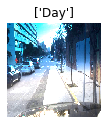

In [146]:
def show_batch(fn, image_batch, label_batch):
  plt.figure(figsize=(10,10))
  for n in range(1):
      label = CLASS_NAMES[label_batch[n]==1]
      ax = plt.subplot(5,5,n+1)
      print(image_batch[n])
      plt.imshow(fn(255*(image_batch[n]+0.5), label))
        
      plt.title(label)
      plt.axis('off')

image_batch, label_batch = next(_train_day_generator)
show_batch(preprocess_image_train, image_batch, label_batch)

#image_batch, label_batch = next(_train_night_generator)
#show_batch(image_batch, label_batch)

#_train_day_ds = tf.data.Dataset.from_generator(lambda: next(_train_day_generator) ,(tf.float32, tf.float32))

#train_day = _train_day_ds.map(
#    preprocess_image_train, num_parallel_calls=AUTOTUNE).cache().shuffle(
#    BUFFER_SIZE).batch(1)


In [136]:
import numpy as np 
day = df3.loc[df3['lighting'] == 'Day']
night = df3.loc[df3['lighting'] == 'Night']

msk = np.random.rand(len(day)) < 0.8
_train_day = day[msk]
_test_day = day[~msk]

msk = np.random.rand(len(night)) < 0.8
_train_night = night[msk]
_test_night = night[~msk]


In [49]:
image_generator = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255)

def make_train_day():
    return image_generator.flow_from_dataframe(
    dataframe=_train_day,
    directory=str('/data/road-scanner/networks/.data/nexet/nexet/nexet_2017_1/'),
    x_col="image_filename",
    y_col="lighting",
    batch_size=BATCH_SIZE,
    target_size=(IMG_HEIGHT, IMG_WIDTH))

def make_test_day():
    return image_generator.flow_from_dataframe(
    dataframe=_test_day,
    directory=str('/data/road-scanner/networks/.data/nexet/nexet/nexet_2017_1/'),
    x_col="image_filename",
    y_col="lighting",
    batch_size=BATCH_SIZE,
    target_size=(IMG_HEIGHT, IMG_WIDTH))

def make_train_night():
    return image_generator.flow_from_dataframe(
    dataframe=_train_night,
    directory=str('/data/road-scanner/networks/.data/nexet/nexet/nexet_2017_1/'),
    x_col="image_filename",
    y_col="lighting",
    batch_size=BATCH_SIZE,
    target_size=(IMG_HEIGHT, IMG_WIDTH))

def make_test_night():
    return image_generator.flow_from_dataframe(
    dataframe=_test_night,
    directory=str('/data/road-scanner/networks/.data/nexet/nexet/nexet_2017_1/'),
    x_col="image_filename",
    y_col="lighting",
    batch_size=BATCH_SIZE,
    target_size=(IMG_HEIGHT, IMG_WIDTH))


In [79]:

_train_day = tf.data.Dataset.from_generator(make_train_day,(tf.float32, tf.float32))
_test_day = tf.data.Dataset.from_generator(make_test_day,(tf.float32, tf.float32))
_train_night = tf.data.Dataset.from_generator(make_train_night,(tf.float32, tf.float32))
_test_night = tf.data.Dataset.from_generator(make_test_night,(tf.float32, tf.float32))

type(_train_day)

tensorflow.python.data.ops.dataset_ops.FlatMapDataset

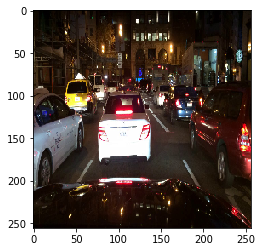

In [24]:
#!apt-get -y install python-scipy
#!pip install scipy
import IPython.display as display
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

x,y = train_night.next()
image = x[0]
plt.imshow(image)
plt.show()

In [34]:
dataset, metadata = tfds.load('cycle_gan/summer2winter_yosemite',
                              with_info=True, as_supervised=True)

# downloaded in /root/tensorflow_datasets/cycle_gan/summer2winter_yosemite/0.1.0

train_summer, train_winter = dataset['trainA'], dataset['trainB']
test_summer, test_winter = dataset['testA'], dataset['testB']

In [52]:
type(train_summer)
type(train_day)


tensorflow.python.data.ops.dataset_ops._OptionsDataset

In [85]:
#!ls /root/tensorflow_datasets/cycle_gan/summer2winter_yosemite/0.1.0
#sample_summer = next(iter(train_summer))
#sample_summer
#!ls /data/road-scanner/networks/.data/scenic/newpictures

import pathlib


data_dir = pathlib.Path('/data/road-scanner/networks/.data')
image_count = len(list(data_dir.glob('**/*.jpg')))
print(f'All images {image_count}')

scenic = list(data_dir.glob('scenic/**/*.jpg'))


All images 59188


51938

In [94]:
image_generator = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255)
scenic_data_gen  = image_generator.flow_from_directory(directory=str('/data/road-scanner/networks/.data/scenic'),
                                                     batch_size=BATCH_SIZE,
#                                                     shuffle=True,
                                                     target_size=(IMG_HEIGHT, IMG_WIDTH))


Found 51938 images belonging to 3 classes.


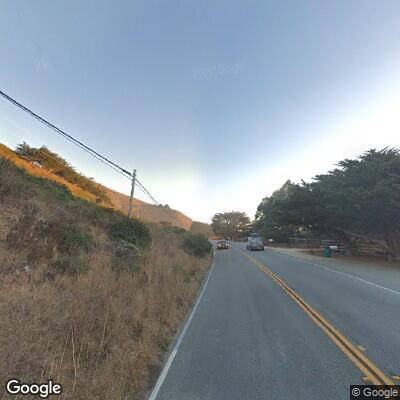

In [86]:
import IPython.display as display
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

for image_path in scenic[:1]:
    display.display(Image.open(str(image_path)))

In [8]:
BUFFER_SIZE = 1000
BATCH_SIZE = 1
IMG_WIDTH = 256
IMG_HEIGHT = 256

In [25]:
def random_crop(image):
  cropped_image = tf.image.random_crop(
      image, size=[IMG_HEIGHT, IMG_WIDTH, 3])

  return cropped_image

In [26]:
# normalizing the images to [-1, 1]
def normalize(image):
  image = tf.cast(image, tf.float32)
  image = (image / 127.5) - 1
  return image

In [121]:
def random_jitter(image):
  # resizing to 286 x 286 x 3
  image = tf.image.resize(image, [286, 286],
                          method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

  # randomly cropping to 256 x 256 x 3
  image = random_crop(image)

  # random mirroring
  image = tf.image.random_flip_left_right(image)

  return image

In [133]:
def preprocess_image_train(image, label):
    image = random_jitter(image)
    image = normalize(image)
    return image

In [123]:
def preprocess_image_test(image, label):
  image = normalize(image)
  return image

In [87]:
train_day = next(iter(_train_day)).map(
    preprocess_image_train, num_parallel_calls=AUTOTUNE).cache().shuffle(
    BUFFER_SIZE).batch(1)

#train_night = train_night.map(
#    preprocess_image_train, num_parallel_calls=AUTOTUNE).cache().shuffle(
#    BUFFER_SIZE).batch(1)

#test_day = test_day.map(
#    preprocess_image_test, num_parallel_calls=AUTOTUNE).cache().shuffle(
#    BUFFER_SIZE).batch(1)

#test_night = test_night.map(
#    preprocess_image_test, num_parallel_calls=AUTOTUNE).cache().shuffle(
#    BUFFER_SIZE).batch(1)

UnknownError: AttributeError: 'FlatMapDataset' object has no attribute 'copy'
Traceback (most recent call last):

  File "/usr/local/lib/python3.6/dist-packages/tensorflow_core/python/data/ops/dataset_ops.py", line 603, in get_iterator
    return self._iterators[iterator_id]

KeyError: 1


During handling of the above exception, another exception occurred:


Traceback (most recent call last):

  File "/usr/local/lib/python3.6/dist-packages/tensorflow_core/python/ops/script_ops.py", line 235, in __call__
    ret = func(*args)

  File "/usr/local/lib/python3.6/dist-packages/tensorflow_core/python/data/ops/dataset_ops.py", line 724, in generator_py_func
    values = next(generator_state.get_iterator(iterator_id))

  File "/usr/local/lib/python3.6/dist-packages/tensorflow_core/python/data/ops/dataset_ops.py", line 605, in get_iterator
    iterator = iter(self._generator(*self._args.pop(iterator_id)))

  File "<ipython-input-49-0478d8535fbc>", line 10, in make_train_day
    target_size=(IMG_HEIGHT, IMG_WIDTH))

  File "/usr/local/lib/python3.6/dist-packages/keras_preprocessing/image/image_data_generator.py", line 683, in flow_from_dataframe
    validate_filenames=validate_filenames

  File "/usr/local/lib/python3.6/dist-packages/keras_preprocessing/image/dataframe_iterator.py", line 124, in __init__
    df = dataframe.copy()

AttributeError: 'FlatMapDataset' object has no attribute 'copy'


	 [[{{node PyFunc}}]]

In [66]:
sample_summer = next(iter(train_summer))

sample_winter = next(iter(train_winter))
type(train_winter)

tensorflow.python.data.ops.dataset_ops._OptionsDataset

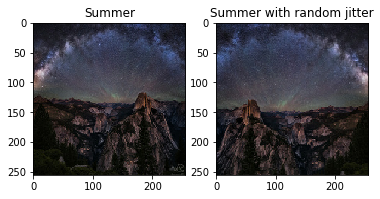

In [16]:
plt.subplot(121)
plt.title('Summer')
plt.imshow(sample_summer[0] * 0.5 + 0.5)

plt.subplot(122)
plt.title('Summer with random jitter')
plt.imshow(random_jitter(sample_summer[0]) * 0.5 + 0.5)

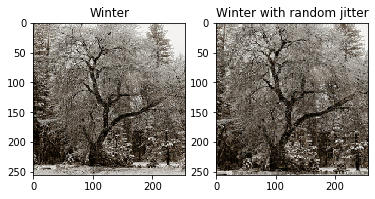

In [17]:
plt.subplot(121)
plt.title('Winter')
plt.imshow(sample_winter[0] * 0.5 + 0.5)

plt.subplot(122)
plt.title('Winter with random jitter')
plt.imshow(random_jitter(sample_winter[0]) * 0.5 + 0.5)

## Import and reuse the Pix2Pix models

Import the generator and the discriminator used in [Pix2Pix](https://github.com/tensorflow/examples/blob/master/tensorflow_examples/models/pix2pix/pix2pix.py) via the installed [tensorflow_examples](https://github.com/tensorflow/examples) package.

The model architecture used in this tutorial is very similar to what was used in [pix2pix](https://github.com/tensorflow/examples/blob/master/tensorflow_examples/models/pix2pix/pix2pix.py). Some of the differences are:

* Cyclegan uses [instance normalization](https://arxiv.org/abs/1607.08022) instead of [batch normalization](https://arxiv.org/abs/1502.03167).
* The [CycleGAN paper](https://arxiv.org/abs/1703.10593) uses a modified `resnet` based generator. This tutorial is using a modified `unet` generator for simplicity.

There are 2 generators (G and F) and 2 discriminators (X and Y) being trained here. 

* Generator `G` learns to transform image `X` to image `Y`. $(G: X -> Y)$
* Generator `F` learns to transform image `Y` to image `X`. $(F: Y -> X)$
* Discriminator `D_X` learns to differentiate between image `X` and generated image `X` (`F(Y)`).
* Discriminator `D_Y` learns to differentiate between image `Y` and generated image `Y` (`G(X)`).

![Cyclegan model](images/cyclegan_model.png)

In [19]:
OUTPUT_CHANNELS = 3

generator_g = pix2pix.unet_generator(OUTPUT_CHANNELS, norm_type='instancenorm')
generator_f = pix2pix.unet_generator(OUTPUT_CHANNELS, norm_type='instancenorm')

discriminator_x = pix2pix.discriminator(norm_type='instancenorm', target=False)
discriminator_y = pix2pix.discriminator(norm_type='instancenorm', target=False)

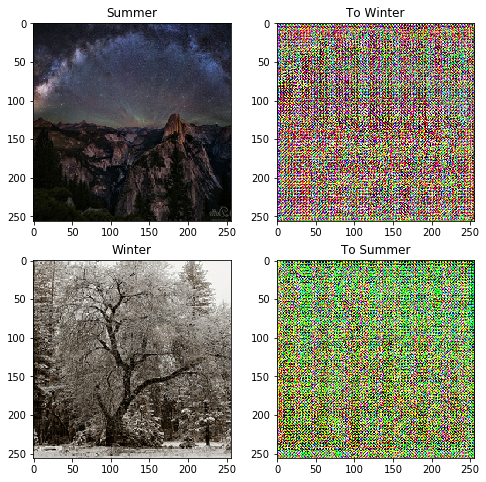

In [20]:
to_winter = generator_g(sample_summer)
to_summer = generator_f(sample_winter)
plt.figure(figsize=(8, 8))
contrast = 8

imgs = [sample_summer, to_winter, sample_winter, to_summer]
title = ['Summer', 'To Winter', 'Winter', 'To Summer']

for i in range(len(imgs)):
  plt.subplot(2, 2, i+1)
  plt.title(title[i])
  if i % 2 == 0:
    plt.imshow(imgs[i][0] * 0.5 + 0.5)
  else:
    plt.imshow(imgs[i][0] * 0.5 * contrast + 0.5)
plt.show()

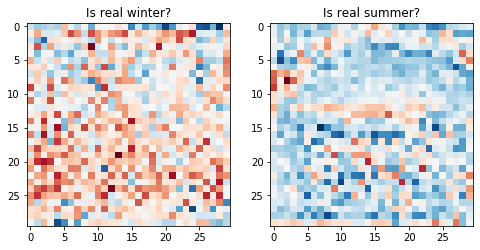

In [22]:
plt.figure(figsize=(8, 8))

plt.subplot(121)
plt.title('Is real winter?')
plt.imshow(discriminator_y(sample_winter)[0, ..., -1], cmap='RdBu_r')

plt.subplot(122)
plt.title('Is real summer?')
plt.imshow(discriminator_x(sample_summer)[0, ..., -1], cmap='RdBu_r')

plt.show()

## Loss functions

In CycleGAN, there is no paired data to train on, hence there is no guarantee that the input `x` and the target `y` pair are meaningful during training. Thus in order to enforce that the network learns the correct mapping, the authors propose the cycle consistency loss.

The discriminator loss and the generator loss are similar to the ones used in [pix2pix](https://www.tensorflow.org/tutorials/generative/pix2pix#define_the_loss_functions_and_the_optimizer).

In [23]:
LAMBDA = 10

In [24]:
loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [25]:
def discriminator_loss(real, generated):
  real_loss = loss_obj(tf.ones_like(real), real)

  generated_loss = loss_obj(tf.zeros_like(generated), generated)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss * 0.5

In [26]:
def generator_loss(generated):
  return loss_obj(tf.ones_like(generated), generated)

Cycle consistency means the result should be close to the original input. For example, if one translates a sentence from English to French, and then translates it back from French to English, then the resulting sentence should be the same as the  original sentence.

In cycle consistency loss, 

* Image $X$ is passed via generator $G$ that yields generated image $\hat{Y}$.
* Generated image $\hat{Y}$ is passed via generator $F$ that yields cycled image $\hat{X}$.
* Mean absolute error is calculated between $X$ and $\hat{X}$.

$$forward\ cycle\ consistency\ loss: X -> G(X) -> F(G(X)) \sim \hat{X}$$

$$backward\ cycle\ consistency\ loss: Y -> F(Y) -> G(F(Y)) \sim \hat{Y}$$


![Cycle loss](images/cycle_loss.png)

In [27]:
def calc_cycle_loss(real_image, cycled_image):
  loss1 = tf.reduce_mean(tf.abs(real_image - cycled_image))
  
  return LAMBDA * loss1

As shown above, generator $G$ is responsible for translating image $X$ to image $Y$. Identity loss says that, if you fed image $Y$ to generator $G$, it should yield the real image $Y$ or something close to image $Y$.

$$Identity\ loss = |G(Y) - Y| + |F(X) - X|$$

In [28]:
def identity_loss(real_image, same_image):
  loss = tf.reduce_mean(tf.abs(real_image - same_image))
  return LAMBDA * 0.5 * loss

Initialize the optimizers for all the generators and the discriminators.

In [29]:
generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

## Checkpoints

In [30]:
checkpoint_path = "./checkpoints/train"

ckpt = tf.train.Checkpoint(generator_g=generator_g,
                           generator_f=generator_f,
                           discriminator_x=discriminator_x,
                           discriminator_y=discriminator_y,
                           generator_g_optimizer=generator_g_optimizer,
                           generator_f_optimizer=generator_f_optimizer,
                           discriminator_x_optimizer=discriminator_x_optimizer,
                           discriminator_y_optimizer=discriminator_y_optimizer)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=5)

# if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
  ckpt.restore(ckpt_manager.latest_checkpoint)
  print ('Latest checkpoint restored!!')

## Training

Note: This example model is trained for fewer epochs (40) than the paper (200) to keep training time reasonable for this tutorial. Predictions may be less accurate. 

In [31]:
EPOCHS = 40

In [177]:
def generate_images(model, test_input, index = None):
  prediction = model(test_input)
    
  plt.figure(figsize=(12, 12))

  display_list = [test_input[0], prediction[0]]
  title = ['Input Image', 'Predicted Image']
  if index:
        title = [f'Input Image {index}', f'Predicted Image {index}']

  for i in range(2):
    plt.subplot(1, 2, i+1)
    plt.title(title[i])
    # getting the pixel values between [0, 1] to plot it.
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

Even though the training loop looks complicated, it consists of four basic steps:

* Get the predictions.
* Calculate the loss.
* Calculate the gradients using backpropagation.
* Apply the gradients to the optimizer.

In [33]:
@tf.function
def train_step(real_x, real_y):
  # persistent is set to True because the tape is used more than
  # once to calculate the gradients.
  with tf.GradientTape(persistent=True) as tape:
    # Generator G translates X -> Y
    # Generator F translates Y -> X.
    
    fake_y = generator_g(real_x, training=True)
    cycled_x = generator_f(fake_y, training=True)

    fake_x = generator_f(real_y, training=True)
    cycled_y = generator_g(fake_x, training=True)

    # same_x and same_y are used for identity loss.
    same_x = generator_f(real_x, training=True)
    same_y = generator_g(real_y, training=True)

    disc_real_x = discriminator_x(real_x, training=True)
    disc_real_y = discriminator_y(real_y, training=True)

    disc_fake_x = discriminator_x(fake_x, training=True)
    disc_fake_y = discriminator_y(fake_y, training=True)

    # calculate the loss
    gen_g_loss = generator_loss(disc_fake_y)
    gen_f_loss = generator_loss(disc_fake_x)
    
    total_cycle_loss = calc_cycle_loss(real_x, cycled_x) + calc_cycle_loss(real_y, cycled_y)
    
    # Total generator loss = adversarial loss + cycle loss
    total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
    total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)

    disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
    disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)
  
  # Calculate the gradients for generator and discriminator
  generator_g_gradients = tape.gradient(total_gen_g_loss, 
                                        generator_g.trainable_variables)
  generator_f_gradients = tape.gradient(total_gen_f_loss, 
                                        generator_f.trainable_variables)
  
  discriminator_x_gradients = tape.gradient(disc_x_loss, 
                                            discriminator_x.trainable_variables)
  discriminator_y_gradients = tape.gradient(disc_y_loss, 
                                            discriminator_y.trainable_variables)
  
  # Apply the gradients to the optimizer
  generator_g_optimizer.apply_gradients(zip(generator_g_gradients, 
                                            generator_g.trainable_variables))

  generator_f_optimizer.apply_gradients(zip(generator_f_gradients, 
                                            generator_f.trainable_variables))
  
  discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients,
                                                discriminator_x.trainable_variables))
  
  discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients,
                                                discriminator_y.trainable_variables))

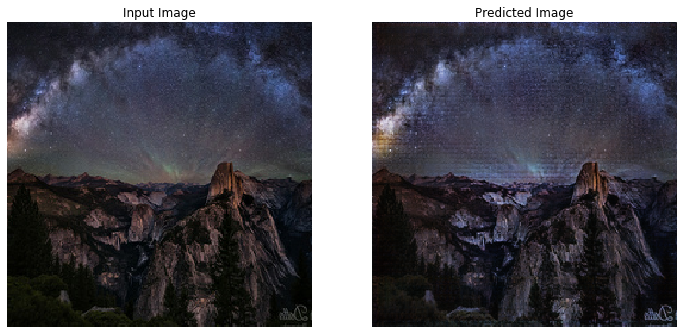

Saving checkpoint for epoch 40 at ./checkpoints/train/ckpt-8
Time taken for epoch 40 is 166.68694043159485 sec



In [34]:
for epoch in range(EPOCHS):
  start = time.time()
    
  n = 0
  for image_x, image_y in tf.data.Dataset.zip((train_summer, train_winter)):
    train_step(image_x, image_y)
    if n % 10 == 0:
      print ('.', end='')
    n+=1

  clear_output(wait=True)
  # Using a consistent image (sample_horse) so that the progress of the model
  # is clearly visible.
  generate_images(generator_g, sample_summer)

  if (epoch + 1) % 5 == 0:
    ckpt_save_path = ckpt_manager.save()
    print ('Saving checkpoint for epoch {} at {}'.format(epoch+1,
                                                         ckpt_save_path))

  print ('Time taken for epoch {} is {} sec\n'.format(epoch + 1,
                                                      time.time()-start))

In [190]:
#tf.saved_model.save(generator_g, "../.results/summer2winter")
#_generator_g = generator_g
generator_g = tf.saved_model.load("../.results/summer2winter")

['serving_default']


## Generate using test dataset

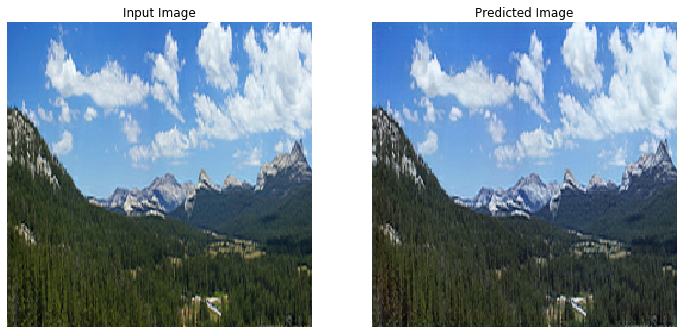

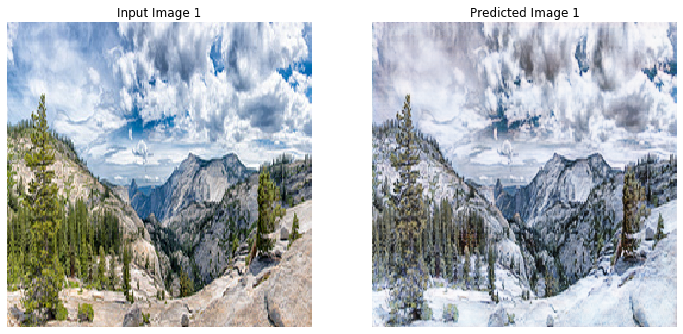

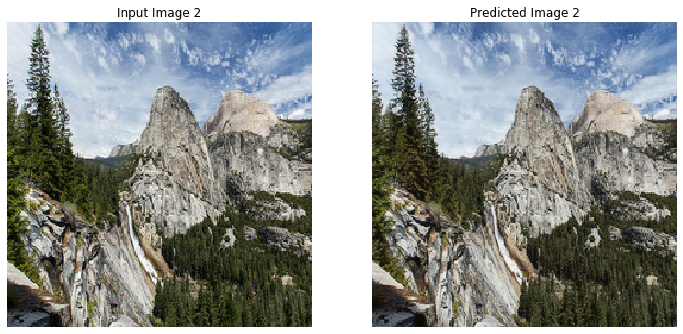

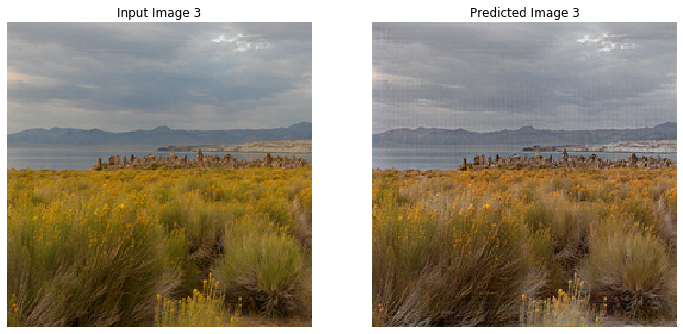

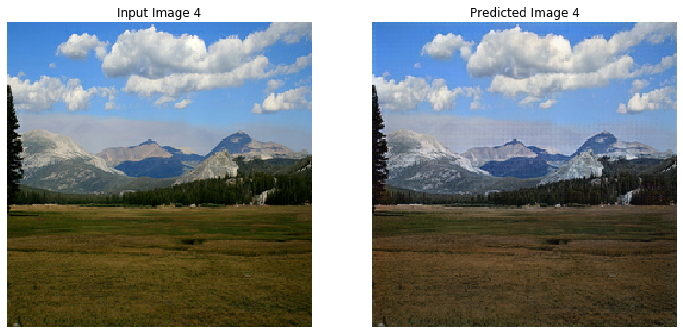

...

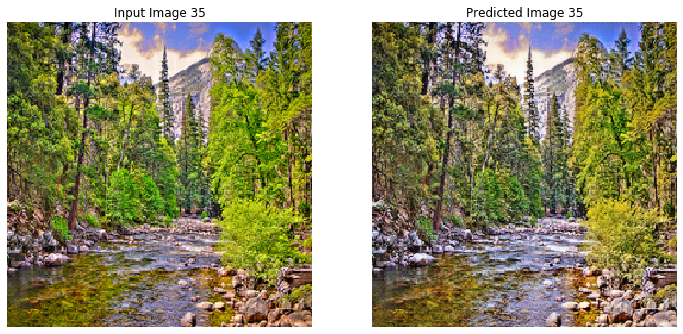

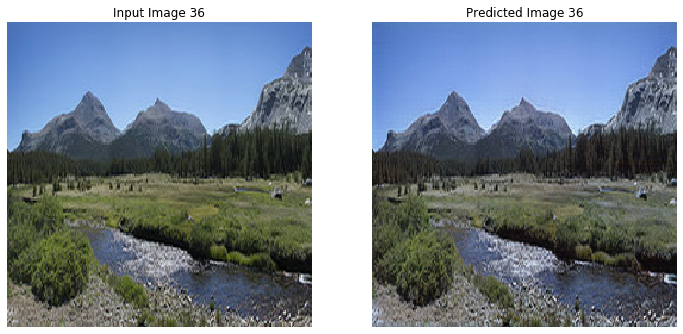

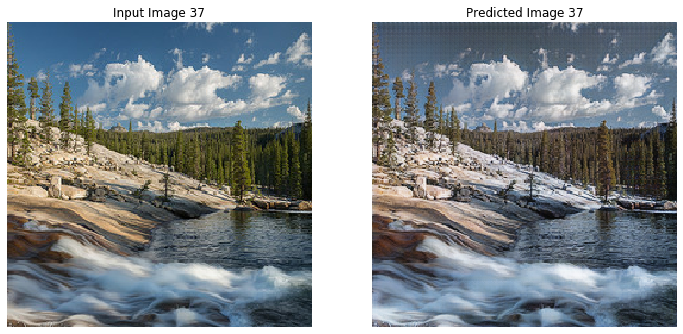

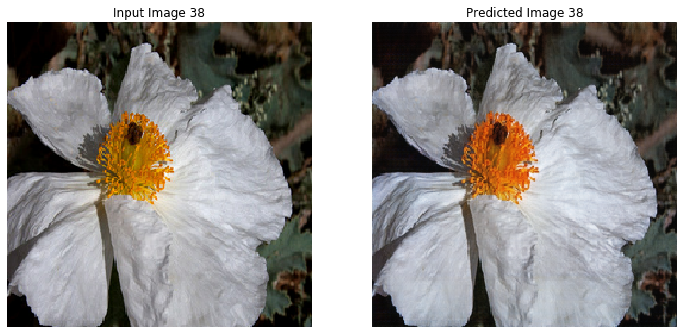

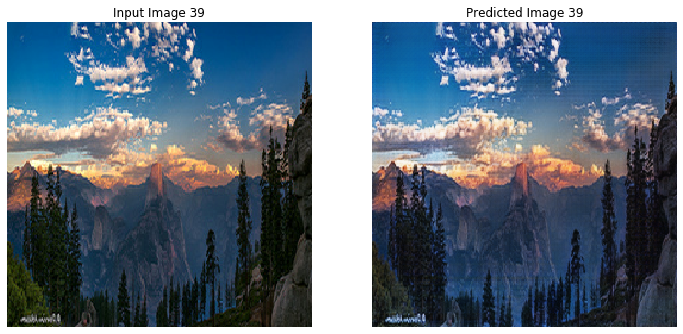

In [191]:
# Run the trained model on the test dataset
for index, inp in enumerate(train_summer.take(40)):
  generate_images(generator_g, inp, index)

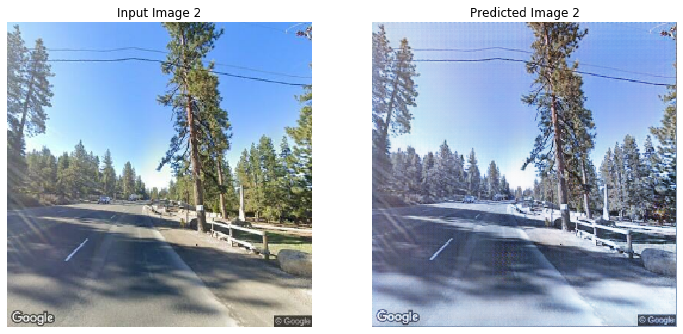

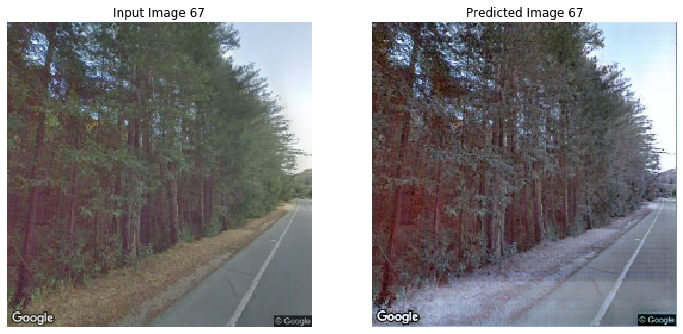

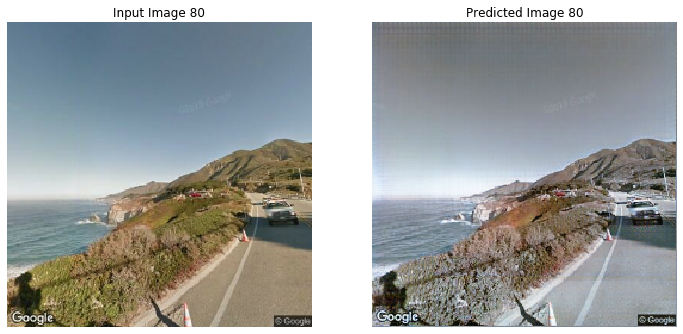

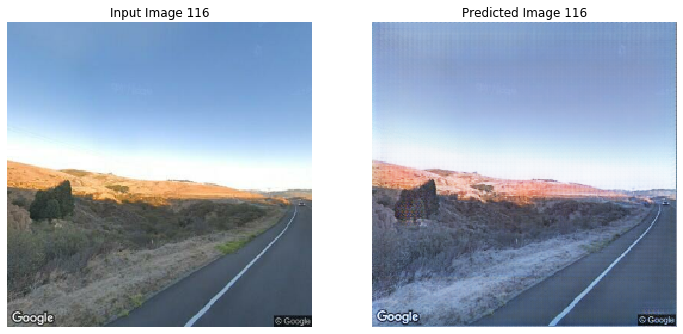

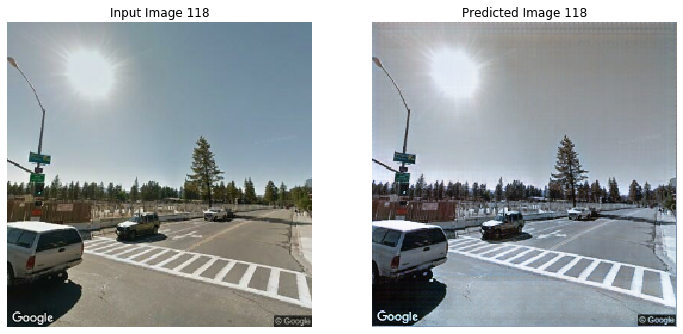

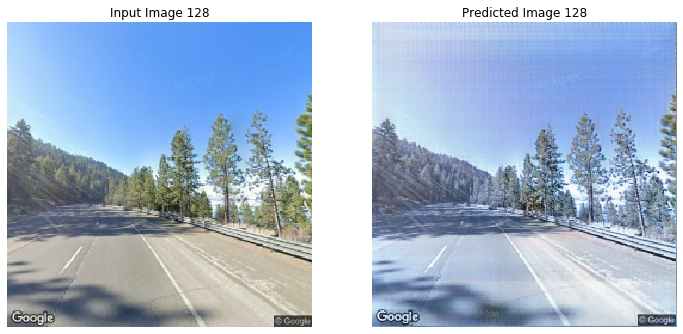

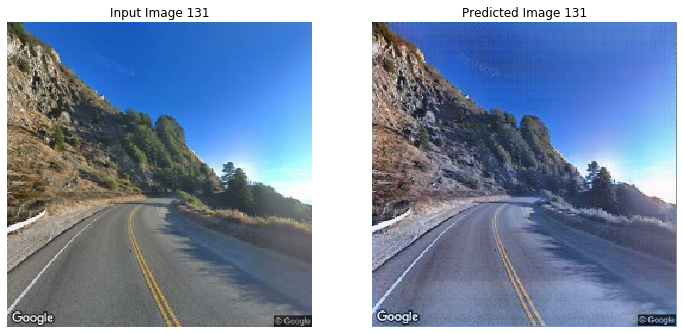

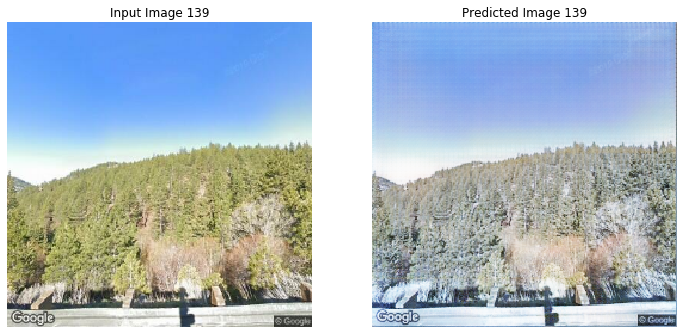

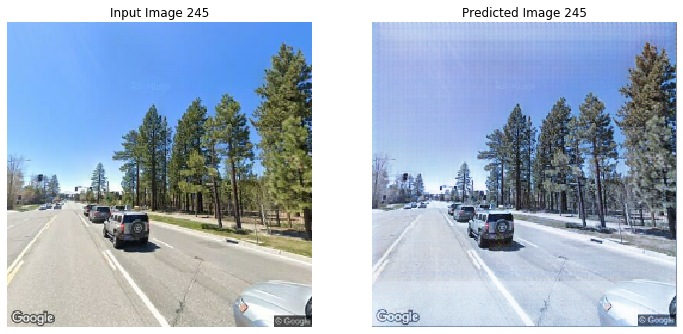

In [192]:
good_examples = [2, 67, 80, 116, 118, 128, 131, 139, 245]
for i in range(0, 250):
    if i not in good_examples:
        continue
    image_path=scenic[i]
    image_file = str(image_path)
    image = tf.io.read_file(image_file)

    image = tf.image.decode_jpeg(image)
    if image.shape[2] > 3:
        continue
    image = tf.image.resize(image,[255, 255])
    image=image/255.0
    image = tf.cast(image, tf.float32)

    image = tf.reshape(image, [1, 255, 255, 3])

    generate_images(generator_g, (image-0.5)*2, i)


In [121]:
print(train_summer.take(1))

<TakeDataset shapes: (None, 256, 256, 3), types: tf.float32>


## Next steps

This tutorial has shown how to implement CycleGAN starting from the generator and discriminator implemented in the [Pix2Pix](https://www.tensorflow.org/tutorials/generative/pix2pix) tutorial. As a next step, you could try using a different dataset from [TensorFlow Datasets](https://www.tensorflow.org/datasets/datasets#cycle_gan). 

You could also train for a larger number of epochs to improve the results, or you could implement the modified ResNet generator used in the [paper](https://arxiv.org/abs/1703.10593) instead of the U-Net generator used here.